In [1]:
import ast
import json
import gzip
from tqdm import tqdm_notebook as jdt

In [2]:
def parse(path):
  g = gzip.open(path, 'r')
  for l in g:
    yield eval(l)

### load data from gz file

In [ ]:
data_user = []
for l in parse("users.clean.json.gz"):
    data_user.append(l)

In [ ]:
data_review = []
for l in parse("reviews.clean.json.gz"):
    data_review.append(l)

In [ ]:
data_place = []
for l in parse("places.clean.json.gz"):
    data_place.append(l)

### select data by states

In [ ]:
States = ['AL','AK','AZ','AR','CA','CO','CT','DE','FL','GA','HI','ID','IL','IN','IA','KS','KY','LA','ME'
         ,'MD','MA','MI','MN','MS','MO','MT','NE','NV','NH','NJ','NM','NY','NC','ND','OH','OK','OR','PA'
         ,'RI','SC','SD','TN','TX','UT','VT','VA','WA','WV','WI','WY']

In [ ]:
selected_States = ['CA']

In [ ]:
def getState(sLits):
    s = sLits[-1][-8:-6]
    if s in selected_States:
        return True
    else: return False

In [ ]:
reduced_data_place = []
for d in data_place:
    Slist = d['address']
    if getState(Slist):
        reduced_data_place.append(d)

In [ ]:
reduced_data_place[0]

In [ ]:
reduced_placeId = set()
for d in reduced_data_place:
    reduced_placeId.add(d['gPlusPlaceId'])

In [ ]:
reduced_reviews = []
for d in jdt(data_review):
    if d['gPlusPlaceId'] in reduced_placeId:
        reduced_reviews.append(d)

In [ ]:
len(reduced_reviews)

In [ ]:
reduced_userID = set()
for d in jdt(reduced_reviews):
    reduced_userID.add(d['gPlusUserId'])

In [ ]:
reduced_users = []
for d in jdt(data_user):
    if d['gPlusUserId'] in reduced_userID:
        reduced_users.append(d)

In [ ]:
with open("reduced_place.json", "w") as write_file:
    json.dump(reduced_data_place, write_file)

In [ ]:
with open("reduced_review.json", "w") as write_file:
    json.dump(reduced_reviews, write_file)

# Finished Pre-process data, outputed as .josn file

In [3]:
import ast
import json
import gzip
import numpy as np
from collections import defaultdict
from tqdm import tqdm_notebook as jdt
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
import operator
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.svm import LinearSVC
from sklearn.ensemble import RandomForestClassifier
from imblearn.over_sampling import SMOTE
from sklearn.metrics import fbeta_score

In [4]:
def stats(pred,truth):
    TP_ = np.logical_and(pred, truth)
    FP_ = np.logical_and(pred, np.logical_not(truth))
    TN_ = np.logical_and(np.logical_not(pred), np.logical_not(truth))
    FN_ = np.logical_and(np.logical_not(pred), truth)

    TP = sum(TP_)
    FP = sum(FP_)
    TN = sum(TN_)
    FN = sum(FN_)

    FPR = FP / (FP + TN)
    FNR = FN / (FN + TP)
    Precision = TP/(TP+FP)
    Recall = TP/(TP+FN)
    print('TP: ', TP,'FP: ', FP, 'TN: ',TN,'FN: ',FN)
    print('Precision: ', Precision)
    print('Recall: ', Recall)
    print('pos:',TP+FP)
    print('neg:',TN+FN)
    print('FPR:', FPR)
    print('FNR:', FNR)
    # print('accuracy:', (TP + TN) / (TP+FP+TN+FN))
    print('Accuarcy:', accuracy_score(truth,pred))
    print('BER: ', 1 - 0.5 * (TP / (TP + FN) + TN / (TN + FP)))
#     print('F2: ', 1.25*(Precision*Recall/(0.25*Precision+Recall)))
    print('F2" ', fbe)
#     print('错的错有多少：', FN/(FP+FN))
#     print('错的对有多少：', FP/(FP+FN))

In [5]:
with open('reduced_place.json') as f:
    data_places = json.load(f)

In [6]:
with open('reduced_review.json') as f:
    data_reviews = json.load(f)

In [7]:
users = set()
for d in jdt(data_reviews):
    users.add(d['gPlusUserId'])

In [14]:
data_places[0]['gPlusPlaceId']

'104699454385822125632'

In [21]:
data_reviews[3]

{'rating': 4.0,
 'reviewerName': 'william spindler',
 'reviewText': "Truly a Red Bluff standard. Great old fashioned drive in with everything you could want from one. I see people say they been coming for 15 years but have an off day and I'll teach them by writing a review. Well I've been going there far longer than that and I have no complaints. Where else are you going to get a good root beer shake in this town?",
 'categories': ['Restaurant'],
 'gPlusPlaceId': '113854191152597312098',
 'unixReviewTime': 1394670357,
 'reviewTime': 'Mar 12, 2014',
 'gPlusUserId': '100000032416892623125'}

In [ ]:
for i in data_reviews:
    print(i['categories'])

['Asian Restaurant', 'Chinese Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Barbecue Restaurant']
['Restaurant']
['Mexican Restaurant']
['Chinese Restaurant']
['College']
['Espresso Bar', 'Coffee Shop']
['Fast Food Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Latin American Restaurant', 'Mexican Restaurant', 'Seafood Restaurant']
['Chicken Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant']
['American Restaurant', 'Dessert Restaurant']
['Hotel']
['Mexican Restaurant']
['Vegetarian Restaurant', 'Eclectic Restaurant', 'Cafe']
['Latin American Restaurant', 'Mexican Restaurant']
['Transmission Shop']
['Tree Service']
['American Restaurant', 'Bakery']
['Nightlife']
['Mexican Restaurant', 'Latin American Restaurant']
['Cable Company', 'Internet Service Provider', 'Telecommunications Service...']
['Shredding Service']
['Pediatrician']
['American Restaurant', 'Deli', 'Food Products Supplier

['Computer Repair Service', 'Data Recovery Service']
['Car Repair and Maintenance']
['Catholic Church']
['Grocery Store']
['Cell Phone Store']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Personal Injury Attorney', 'Real Estate Attorney']
['Physical Therapy Clinic']
['Hardware Store', 'Lumber Store', 'Woodworking Supply Store']
['Plant Nursery']
['Dental Clinic']
['Insurance Agency', 'Auto Insurance Agency']
['Mexican Restaurant', 'Latin American Restaurant']
['Medical Spa']
['Personal Trainer', 'Gym', 'Pilates Studio']
['Vacation Home Rental Agency', 'Guest House', 'Lodge']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Acupuncture Clinic']
['Latin American Restaurant', 'Mexican Restaurant']
['American Restaurant', 'Butcher Shop', 'Fine Dining Restaurant']
['Alcoholism Treatment Program']
['Surf Shop']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Commercial Real Estate Agency', 'Real Estate Consultant']
['Bakery', 'Sup

['Mexican Restaurant', 'Latin American Restaurant']
['Cabinet Maker', 'Tile Contractor', 'Bathroom Remodeler']
['Glass & Mirror Shop']
['Animal Shelter', 'Animal Protection Organization']
['Dog Day Care Center', 'Pet Groomer', 'Dog Trainer']
['Toyota Dealer', 'Tire Shop', 'Truck Dealer']
['Resume Service']
['Brake Shop', 'Oil Change Service', 'Truck Repair Shop']
['Italian Restaurant']
['Obstetrics & Gynecology']
['Cosmetic Dentist']
None
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Hair Salon', 'Beauty Salon']
['Ford Dealer', 'Used Car Dealer']
['Clothing Store', 'Pharmacy', 'Supermarket']
['Party Store', 'Candy Store']
['Subaru Dealer']
['Restaurant']
['Commercial Printer']
None
['Department of Motor Vehicles']
['Latin American Restaurant', 'Mexican Restaurant']
['Park']
['Italian Restaurant', 'Takeout Restaurant', 'Pizza Delivery']
['Dentist']
['Bar']
['Cocktail Bar', 'Restaurant or Cafe']
['Piano Bar', 'Night Club', 'Party Store']
['Software Company']
['Auto 

['Pizza Restaurant', 'Gluten-Free Restaurant', 'Catering']
['Fine Dining Restaurant', 'Italian Restaurant']
['Extended Stay Hotel']
['Japanese Restaurant', 'Tapas Restaurant']
['French Restaurant', 'American Restaurant', 'Californian Restaurant']
['Hotel']
['Cosmetic Dentist', 'Endodontist', 'Dental Implants Periodontist']
['Auto Repair Shop', 'Auto Body Shop', 'Mechanic']
['Builders Hardware (whls)']
['Bus Line Company', 'Bus Station']
['Park', 'RV Park', 'Fishing Pier']
['Park']
['Chinese Restaurant', 'Asian Restaurant']
['Observatory', 'Science Museum', 'Planetarium']
['Bar']
['Apartment Building']
['Park']
['Gift Shop', 'Tattoo Shop', 'Sporting Goods Store']
['Park']
['Train Station', 'Public Transit Route', 'Railroad Company']
['Mexican Restaurant', 'Latin American Restaurant']
["Women's Clothing Store", "Men's Clothing Store", 'Used Clothing Store']
['Dentist']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Book Dealers-Retail']
['Sushi Restaurant', 'Asian Re

['Pub', 'American Restaurant', 'European Restaurant']
['Luxury Hotel']
['Japanese Restaurant', 'Sushi Restaurant']
['Restaurant', 'Breakfast Restaurant', 'Brunch Restaurant']
['American Restaurant']
['Dairy Store']
['Supermarket']
['Wine Store', 'Beer Store']
['Pizza Restaurant', 'Hamburger Restaurant', 'Sports Bar']
['Brewpub', 'Brewery', 'Family Restaurant']
['French Restaurant', 'Bakery']
['Cuban Restaurant']
['Bar']
['Italian Restaurant', 'Brunch Restaurant', 'Fine Dining Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Californian Restaurant']
['American Restaurant']
['Restaurant', 'Beer Store', 'Deli']
['Californian Restaurant', 'Cafe', 'American Restaurant']
['Bakery', 'Caterer', 'Coffee Shop']
['French Restaurant', 'Bistro']
['Wine Bar', 'Restaurant']
['Wine Store']
['Restaurant', 'Mediterranean Restaurant']
['Organic Restaurant']
['Steak House', 'Seafood Restaurant', 'American Restaurant']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Pe

['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Movie Theater']
['Grocery Store']
['Coffee Shop', 'Store']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['American Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Housing Authority']
['American Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Delivery Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Delivery Restaurant']
['Restaurant', 'Steak House']
['Stereo Store', 'Window Tinting Service']
['American Restaurant', 'Espresso Bar', 'Cocktail Bar']
['Spa', 'Day Spa', 'Waxing Hair Removal Service']
['Vietnamese Restaurant']
['Entertainment and Recreation', 'Art Center', 'Art Gallery']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Jamaican Restaurant']
['Baby Store', "Children's Furniture Store", 'Bedroom Furniture Store']

['Steak House']
['Brewpub', 'Bar & Grill', 'American Restaurant']
['Steak House']
['Car Wash']
['Movie Theater']
['Bar & Grill']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Restaurant', 'French Restaurant', 'Japanese Restaurant']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Pharmacy']
['Breakfast Restaurant']
['Boutique']
['Organic Restaurant', 'Latin American Restaurant', 'Vegan Restaurant']
['Animal Hospital', 'Pet Groomer', 'Veterinarian']
['Craft Store']
['Hotel']
['American Restaurant']
['Sushi Restaurant', 'Asian Restaurant']
['American Restaurant', 'Gastropub']
['Sandwich Shop', 'Food Service']
['Diner', 'American Restaurant']
['Cafe', 'Latin American Restaurant', 'Salvadoran Restaurant']
['American Restaurant', 'Organic Restaurant']
['Sandwich Shop', 'Deli']
['Korean Barbecue Restaurant']
['American Restaurant', 'Brewpub', 'Bar & Grill']
['Sushi Restaurant', 'Asi

['American Restaurant', 'Banquet Hall', 'Meeting Room']
['Seafood Restaurant']
['Italian Restaurant', 'European Restaurant', 'Bar']
['American Restaurant', 'Steak House']
['Pizza Restaurant', 'Italian Restaurant']
['Italian Restaurant', 'European Restaurant', 'Sandwich Shop']
['Gym', 'Personal Trainer', 'Weight Loss Service']
['Restaurant']
['Cafe']
['Community College', 'College']
['Dessert Shop', 'Ice Cream Shop']
['Skateboard Shop', 'Skate Shop']
['Barber Shop']
['Tourist Attraction']
['Bar', 'Event Venue']
['Cocktail Bar']
['Aquarium']
['American Restaurant', 'Bar', 'Brewery']
['Nightlife']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Mechanic', 'Muffler Shop', 'Racing Car Parts Store']
['Cafe', 'Breakfast Restaurant', 'Organic Restaurant']
['Hotel', 'Historical Landmark']
['Irish Restaurant', 'European Restaurant', 'Irish Pub']
['Tea House', 'Asian Restaurant']
['Hotel']
['Chicken Wings Restaurant', 'European Restaurant', 'Italian Restaurant']
['American Resta

['Cell Phone Store']
['Auto Repair Shop']
None
None
['Grocery Store', 'Deli', 'Convenience Store']
['Pediatrician']
['Vietnamese Restaurant']
['Bicycle Shop', 'Bicycle Repair Shop']
['Bicycle Shop']
['Game Store', 'Video Game Store']
None
['Airsoft Supply Store']
['Mexican Restaurant', 'Latin American Restaurant']
['Department Store', 'Discount Store', 'Supermarket']
['Irish Pub', 'European Restaurant']
['Takeout Restaurant', 'Pizza Delivery']
['Delivery Restaurant', 'Mediterranean Restaurant', 'Middle Eastern Restaurant']
['Gas Station']
['Thrift Store']
['Coffee Shop', 'Tea House']
['Bar']
['Supermarket']
['Mexican Restaurant', 'Latin American Restaurant']
['Pet Supply Store', 'Pet Groomer']
['Seafood Restaurant']
['Seafood Restaurant']
['Freight Forwarding Service', 'Trucking Company', 'Warehousing Service']
['Importer']
['Hardware Store', 'Wholesaler']
['Hostel']
None
['Mexican Restaurant', 'Latin American Restaurant']
['Steak House']
['Musical Instrument Store']
['Animal Hospital'

['Federal Government Contractors']
['Bicycle Shop', 'Bicycle Repair Shop']
['Italian Restaurant', 'European Restaurant']
['Science Museum', 'Army Facility', 'Educational Institution']
['Event Venue']
['Cafe']
['Coffee Shop']
['Californian Restaurant', 'American Restaurant', 'Cafe']
['French Restaurant']
['Bicycle Shop', 'Bicycle Repair Shop']
['Coffee Shop']
['American Restaurant', 'Cafe', 'Dessert Shop']
['Night Club', 'Wedding Venue', 'Live Music Venue']
['Hardware Store']
['Bar', 'European Restaurant', 'Spanish Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Sandwich Shop', 'Fast Food Restaurant', 'Catering']
['Clothing Store', "Women's Clothing Store", "Men's Clothing Store"]
['American Restaurant']
['American Restaurant', 'Cocktail Bar']
['Boutique']
['Night Club', 'Bar', 'Dinner Theater']
['Night Club', 'Live Music Venue', 'Pub']
['Night Club', 'Art Gallery', 'Live Music Venue']
['Bicycle Shop', 'Bicycle Repair Shop']
['Car Rental Agency

['Chocolate Shop', 'Vegetarian Restaurant', 'Vegan Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Department Store', 'Discount Store']
['Chevrolet Dealer', 'Auto Parts Store', 'Auto Body Shop']
['American Restaurant', 'Seafood Restaurant', 'Steak House']
['Mexican Restaurant', 'Latin American Restaurant', 'Bar']
['Pest Control Service', 'Insulation Contractor']
['Entertainment', 'Amusement Center']
['Tours', 'Bus Tour Agency', 'Bus Charter']
['Nursing School', 'College', 'Medical School']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['American Restaurant']
['Bar', 'Night Club', 'Live Music Venue']
['Sports Bar', 'American Restaurant']
['Hotel']
['Brazilian Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Bar']
['Car Dealer', 'Jeep Dealer', 'Dodge Dealer']
['Hotel']
['Hair Salon', 'Beauty Salon']
['Coffee Shop']
['Cocktail Bar']
['Hotel', 'Luxury Hotel']
['Win

['Private School', 'Technical School']
['Episcopal Church', 'Religious Organization', 'Food Bank']
['Park']
['Performing Arts Theater']
['French Restaurant', 'Dessert Restaurant', 'Brunch Restaurant']
['Tire Shop']
['Nightlife', 'Brewery']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Mediterranean Restaurant']
['Restaurant']
['Pizza Restaurant']
['Transmission Shop', 'Truck Repair Shop']
['Muffler Shop']
None
['Copy Shop', 'Process Server', 'County Courthouse']
['Self-Storage Facility']
['Restaurants']
['Plastic Surgeon', 'Medical Center']
['Motorcycle Dealer', 'Motor Scooter Dealer', 'Boat Dealer']
['Self-Storage Facility']
['Cuban Restaurant', 'Caribbean Restaurant', 'Latin American Restaurant']
['Park']
['Chinese Restaurant', 'Asian Restaurant', 'Fast Food Restaurant']
None
None
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Barbecue Restaurant', 'Takeout Restaurant', 'Bar & Grill']
['Boutique', 'Western Apparel Store', "Women's Clothing Sto

['Beauty Salon']
['American Restaurant']
['Chiropractor', 'Sports Medicine Physician']
['Latin American Restaurant', 'Mexican Restaurant']
['American Restaurant', 'Brewery', 'Vegetarian Restaurant']
['Moving & Storage Service', 'Mover', 'Self-Storage Facility']
['Sports Club', 'Personal Trainer', 'Gym']
['Restaurant']
['Persian Restaurant', 'Fine Dining Restaurant', 'Family Restaurant']
['Campground']
['Mexican Restaurant', 'Latin American Restaurant']
['Moving Supply Store', 'Self-Storage Facility']
['Mexican Restaurant', 'Latin American Restaurant']
['Department Store']
['American Restaurant', 'New American Restaurant']
['Gun Shop']
['American Restaurant']
['Chicken Restaurant']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
None
['Print Shop']
['Business Related']
['Entertainer']
None
['Auto Repair Shop']
None
None
['Resort']
['Corporate Campus', 'Non-Profit Organization']
['Auto Glass Shop', 'Car Stereo Store']
['Barber Shop']
['Sports Bar']
['Asian Restaurant', 'Ch

['Hamburger Restaurant', 'American Restaurant', 'Catering']
['Filipino Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Nail Salon']
['Beauty']
['Medical Center', 'Emergency Room', "Children's Hospital"]
['Movie Theater']
['Outdoor Sports Store', 'Sportswear Store', 'Bicycle Shop']
['Aquarium']
['Bakery', 'Soup Restaurant', 'Salad Shop']
['Pet Store', 'Pet Supply Store']
['Ice Cream Shop', 'Dessert Shop']
['Theme Park', 'Water Park']
['Craft Store', 'Art Supply Store']
['European Restaurant', 'Italian Restaurant']
['Party Equipment Rental Service', 'Florist', 'Audio Visual Equipment Rental...']
['Department Store', 'Clothing Store']
['Department Store']
['Beauty Supply Store', 'Nail Salon', 'Hair Salon']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Community College']
['Bar & Grill', 'Sports Bar', 'Hamburger Restaurant']
['Bowling Alley', 'Sports Bar', 'Stadium']
['Dinner Theater', 'Family Re

['American Restaurant', 'Steak House']
["Children's Clothing Store", 'Electronics Store', 'Gift Shop']
['Bakery']
['Asian Restaurant', 'Chinese Restaurant', 'Fast Food Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Mediterranean Restaurant', 'Greek Restaurant', 'Health Food Restaurant']
['Fast Food Restaurant', 'Sandwich Shop', 'Chicken Restaurant']
['Shopping Mall']
['Fingerprinting Service', 'Notary Public', 'Passport Photo Processor']
None
None
['Mexican Restaurant', 'Latin American Restaurant']
['Dentist']
['Cafe']
None
['Seafood Restaurant']
None
None
None
None
['Sheet Metal Contractor']
None
['Coffee Shop']
['Vegan Restaurant', 'Organic Restaurant', 'Vegetarian Restaurant']
['Japanese Grocery Store']
['Nutritionist']
['French Restaurant', 'Fine Dining Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Restaurant', 'Caribbean Restaurant', 'Latin American Restaurant']
['Carpet Cleaning Service']
['Pediatrician']
['Data Recovery Service

['Restaurant', 'Fast Food Restaurant', 'American Restaurant']
['Park']
['Fast Food Restaurant', 'Sandwich Shop']
['Hospital', 'Nursing Home']
['Window Treatment Store']
['Coffee Shop']
['Self-Storage Facility']
['Cafe', 'Restaurant']
['Seafood Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['American Restaurant']
['Clothing Store', 'Outlet Store']
['Pet Supply Store']
['Restaurant', 'Barbecue Restaurant']
['Pharmacy']
['Garbage Collection Service', 'Garbage Dump Service', 'Waste Management Service']
['Auto Parts Store', 'BMW Dealer', 'Buick Dealer']
['Train Station']
['Latin American Restaurant', 'Mexican Restaurant']
['Emergency Dental Service']
['Auto Repair Shop']
['Car Dealer', 'Chevrolet Dealer', 'Used Car Dealer']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Shooting Range']
['Dentist']
['Movie Theater']
['Asian Restaurant', 'Chinese Restaurant']
['Insurance Agency']
['Department Store', 'Discount Store', 'Furniture Store']
['Natural Histor

['Piano Instructor']
['Asian Restaurant', 'Chinese Restaurant']
['Toyota Dealer', 'Auto Parts Store', 'Auto Repair Shop']
['Banquet Hall']
['Car Racing Track']
['Bar']
['Comedy Club']
['Barbecue Restaurant', 'Sandwich Shop', 'Pie Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Sandwich Shop', 'Fast Food Restaurant']
['Cafe']
['Barbecue Restaurant', 'American Restaurant']
['Donut Shop', 'Dessert Shop']
['Dental Clinic']
['Video Production Service']
['Chiropractor', 'Physical Therapy Clinic']
['Campground', 'RV Park']
['Toyota Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Night Club', 'Lounge']
['Nepalese Restaurant']
['Computer Repair Service', 'Data Recovery Service', 'Computer Store']
['Bakery', 'Wedding Bakery']
['American Restaurant', 'Steak House']
None
None
['Mexican Restaurant', 'Latin American Restaurant', 'Bar & Grill']
['Store']
['Italian Restaurant', 'Europ

['Fast Food Restaurant', 'Takeout Restaurant', 'Hamburger Restaurant']
['Driving School']
['Money Transfer Service']
['Hotel']
None
['Gift Shop', 'Florist']
['Jewelry Store', 'Jewelry Buyer', 'Jewelry Designer']
None
['Luxury Hotel', 'Wedding Venue', 'Meeting Room']
['Wedding Photographer', 'Portrait Studio']
None
['Vacation Home Rental Agency', 'Lodge', 'Gift Shop']
['Tire Shop']
['Elementary School', 'Public School']
['Insurance Agency']
["Children's Museum"]
['Bank']
['Bar & Grill']
['Museum']
['Family Practice Physician']
['Physician']
['Physician', 'Medical Clinic']
['Financial Consultant']
['Mexican Restaurant', 'Latin American Restaurant', 'Bar']
['Hobby Shop', 'Toy Store']
['Barber Shop']
['Calvary Chapel Church']
['Shipping Service']
['Car Dealer', 'Auto Parts Store', 'Mazda Dealer']
['Movie Theater']
['High School', 'Public School']
['Bar & Grill', 'Italian Restaurant', 'Sports Bar']
['Animal Hospital', 'Emergency Veterinarian Service']
['Florist']
['Court Reporter']
['Museum

['Oil Change Service']
['Church of Jesus Christ of...']
['Alternative Medicine']
['Video Game Store']
['Department of Social Services', 'Social Services Organization']
['Non-Profit Organization']
['Aquarium', 'Tropical Fish Store']
['Diner', 'American Restaurant']
['Pizza Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Pet Supply Store', 'Tropical Fish Store', 'Bird Shop']
['Ice Cream Shop', 'Dessert Shop', 'Frozen Yogurt Shop']
['Sandwich Shop']
['American Restaurant']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Auto Parts Store', 'Honda Dealer', 'Auto Tune Up Service']
['Shooting Range', 'Gun Shop', 'Hobby Shop']
['Motel', 'Hotel']
['Cafe', 'Restaurant', 'Internet Cafe']
['Beauty Salon', 'Hair Salon']
['Bead Store']
['After School Program', 'Learning Center', 'Preschool']
['Appliance Store', 'Mattress Store', 'Washer & Dryer Store']
['Dental Clinic', 'Pediatric Dentist', 'Emergency Dental Service']
['Pediatrician']
['Bridal S

['Fingerprinting Service', 'Notary Public', 'Passport Photo Processor']
["Men's Clothing Store", 'Tuxedo Shop']
['Lounge']
['Self-Storage Facility']
['Cell Phone Store']
['Medical Center', 'Physician', 'Medical Clinic']
['Breakfast Restaurant', 'American Restaurant']
['Beach Resort']
['Event Venue', 'Meeting Room', 'Hotel']
['Korean Restaurant']
['Hotel', 'Banquet Hall', 'Conference Center']
['Restaurant', 'Chinese Restaurant']
['Pest Control Service']
['Auto Glass Shop']
['Bar', 'Cocktail Bar', 'Night Club']
['Car Wash', 'Car Detailing Service']
['Locksmith']
['Latin American Restaurant', 'Mexican Restaurant']
['Car Rental Agency']
['Diner', 'American Restaurant', 'Fast Food Restaurant']
['Bar & Grill', 'Karaoke Bar', 'European Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Thrift Store', 'Vintage Clothing Store', 'Used Clothing Store']
None
['Coffee Shop']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['National Park']
['American Restaurant

['Gastropub', 'American Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Restaurant']
['Gym', 'Health Club', 'Physical Fitness Program']
['Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Movie Theater']
['Mexican Restaurant', 'Latin American Restaurant']
['Japanese Restaurant', 'Sushi Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Mattress Store', 'Bedroom Furniture Store', 'Bedding Store']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Caribbean Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Smog Inspection Station']
['Custom T-shirt Store', 'Screen Printer', 'T-shirt Company']
['Mexican Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['French Restaurant', 'Bistro', 'Crêperie']
['Ice Cream Shop', 'Dessert Shop']
['Restaurant', 'American Re

['Shopping Mall']
['Used Car Dealer']
['Boutique', "Women's Clothing Store"]
['Resort', 'Theme Park']
['Entertainment']
['Amusement Places']
["Sheriff's Department"]
['Bankruptcy Attorney', 'Family Law Attorney']
['Marketing Consultant']
['Department Store']
['Barbecue Restaurant', 'Wedding Venue', 'Meeting Room']
['Mexican Restaurant', 'Bar & Grill']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['American Restaurant', 'Office']
['Steak House', 'American Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Bistro']
['Castle', 'Monument', 'State Park']
['Seafood Restaurant']
['Bar & Grill', 'Hamburger Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Beer Store']
['American Restaurant', 'Brewpub', 'Brewery']
['Hawaiian Restaurant', 'American Restaurant', 'Asian

['Hamburger Restaurant']
['Seafood Restaurant']
['Japanese Grocery Store', 'Supermarket']
['Coffee Shop', 'Store']
['Mexican Restaurant', 'Latin American Restaurant']
['Pipe Supplier']
['Cocktail Bar']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Movie Theater']
['Post Office']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Grocery Store']
['Middle School', 'Public School']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Storage Facility', 'Mover', 'Professional Services']
['Hospital', 'Medical Laboratory', 'Physical Therapist']
['Dental Clinic', 'Cosmetic Dentist', 'Pediatric Dentist']
None
['Mexican Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Toyota Dealer', 'Used Car Dealer', 'Auto Parts Store']
None
['Kindergarten', 'Private School']
['Cell Phone Store', 'Telecommunications Service...']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Coffee Shop']
['Brunch Restaurant', 'Breakfas

['Community College', 'College', 'Trade School']
['Park']
['Pizza Restaurant', 'Italian Restaurant']
['Cable Company']
['Mediterranean Restaurant', 'Chicken Restaurant', 'Middle Eastern Restaurant']
['Truck Stop', 'Service Station']
['Japanese Grocery Store', 'Korean Grocery Store']
['Tire Shop']
['Personal Injury Attorney']
None
None
None
None
None
['Bar & Grill', 'Live Music Venue', 'American Restaurant']
['Spa', 'Beauty Salon', 'Hair Salon']
['Cocktail Bar']
['Pet Supply Store']
['Health', 'Waxing Hair Removal Service', 'Spa']
['Family Practice Physician']
['Resort']
['Amusement Center', 'Recreation Center', 'Rock Climbing Gym']
['Cosmetic Dentist', 'Pediatric Dentist', 'Dental Implants Periodontist']
['Coffee Shop', 'Lounge', 'Live Music Venue']
['Hotel']
None
['Electronics Repair Shop', 'Computer Repair Service', 'Cell Phone Store']
['Winery']
['Yoga Studio']
['Animal Hospital', 'Veterinarian']
['Car Dealer', 'Auto Parts Store', 'Chevrolet Dealer']
['Acupuncture Clinic']
['Health 

['Vietnamese Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Ramen Restaurant']
['Chocolate Shop', 'Dessert Shop']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Park', 'Museum']
['Supermarket']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Movie Theater']
['Restaurant']
['Photo Lab', 'Professional Services']
['Baptist Church']
['Self-Storage Facility']
['Coffee Shop']
['Martial Arts School', 'Jujitsu School', 'Gym']
['Middle School', 'Public School']
['Movie Theater']
['Eye Care Center', 'Optometrist']
['Restaurant', 'Seafood Restaurant', 'Cafe']
['Sandwich Shop', 'Middle Eastern Restaurant', 'Coffee Shop']
['Coffee Shop']
['Indian Restaurant']
['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['Bar & Grill']
['Candy Store']
['Donut Shop', 'Dessert Shop']
['Hawaiian Restaurant', 'Organic Restaurant']
['Grocery Store']
['Mediterranean Restaurant', 'Israeli Restaurant']
['Restaurant']
['Latin American Restaurant',

['Lexus Dealer', 'Auto Tune Up Service', 'Used Car Dealer']
['Coffee Shop']
['Bar & Grill']
['Indian Restaurant', 'Asian Restaurant', 'European Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Wine Bar']
['Florist']
['Moroccan Restaurant', 'African Restaurant', 'North African Restaurant']
['Creole Restaurant', 'Soul Food Restaurant', 'Seafood Restaurant']
['Clothing Store', "Men's Clothing Store"]
['Caribbean Restaurant']
['European Restaurant', 'Mediterranean Restaurant', 'Greek Restaurant']
['Dessert Shop', 'Ice Cream Shop']
['Pakistani Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Organic Restaurant', 'Latin American Restaurant', 'Vegan Restaurant']
['Ice Cream Shop', 'Dessert Shop', 'Cafe']
['Sushi Restaurant', 'Japanese Restaurant']
['American Restaurant', 'Caterer', 'Bar']
['Beauty Salon', 'Hair Salon', 'Nail Salon']
['Cafe', 'Bakery']
['Pie Shop', 'Fast Food Restaurant', 'Cafe']
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant']
[

['Toyota Dealer', 'Auto Body Parts Supplier', 'Auto Body Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Physician']
['Mexican Restaurant', 'Latin American Restaurant']
['Mazda Dealer', 'Used Car Dealer', 'Oil Change Service']
['Mexican Restaurant', 'Latin American Restaurant', 'Family Restaurant']
None
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Hotel', 'Motel']
['Entertainment']
['Pest Control Service']
['American Restaurant']
['Veterinarian']
['Auto Repair Shop', 'Oil Change Service', 'Transmission Shop']
['Bicycle Shop']
['Cell Phone Store', 'Electronics Repair Shop', 'Electronics Store']
['Comic Book Store', 'Hobby Shop', 'Game Store']
['Stereo Store']
['Apartment Building', 'Apartment Rental Agency']
['Electronics Store']
['American Restaurant', 'Pub', 'Italian Restaurant']
['Pie Shop', 'Breakfast Restaurant', 'Coffee Shop']
['Coffee Shop', 'Dessert Restaurant', 'Dessert Shop']
['Dessert Restau

['Thai Restaurant', 'Vegan Restaurant', 'Vegetarian Restaurant']
['Movie Rental']
['Home Theater Store', 'Stereo Store']
['Storage Facility']
['Hardware Store']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Medical Group', 'Physician']
['Music School']
['Car Wash']
['Plumber']
['Hospital', 'Medical Center', 'Emergency Room']
['Mexican Restaurant', 'Latin American Restaurant']
['Live Music Venue']
['Smog Inspection Station']
None
['French Restaurant', 'Continental Restaurant', 'Fine Dining Restaurant']
['Mediterranean Restaurant', 'Bar & Grill', 'Wine Bar']
['Latin American Restaurant', 'Mexican Restaurant']
['Bar & Grill']
['Frozen Yogurt Shop']
['Endocrinologist', 'Internist']
['Chicken Restaurant']
['Mediterranean Restaurant', 'Middle Eastern Restaurant', 'Lebanese Restaurant']
['Auto Repair Shop', 'Tire Shop']
['ATM Location', 'Service Station']
['Process Server']
['Transmission Shop']
['Apartment Rental Agency', 'Property Management Company', 'Condominium Rent

['Extended Stay Hotel']
['Theme Park', 'Roller Coaster', 'Amusement Park Ride']
['Restaurant']
['American Restaurant']
['Japanese Restaurant', 'Ramen Restaurant']
['Coffee Shop', 'Latin American Restaurant', 'Espresso Bar']
['Coffee Shop', 'Dessert Shop', 'Internet Cafe']
['Winery']
['Dry Cleaner']
['Chicken Wings Restaurant', 'Chicken Restaurant', 'Family Restaurant']
['Car Dealer', 'Audi Dealer', 'BMW Dealer']
['Japanese Restaurant', 'Asian Restaurant', 'Barbecue Restaurant']
None
['Yoga Studio']
['Pediatrician']
['Auto Tag Agency', 'Department of Motor Vehicles', 'Smog Inspection Station']
['Park']
['Asian Restaurant', 'Chinese Restaurant']
['Park']
['Mexican Restaurant']
['Theme Park']
['Tire Shop']
['Tea House']
['Motel']
['Mexican Restaurant', 'Latin American Restaurant']
['Lodge', 'Hotel', 'Motel']
['Motel', 'Hotel']
['Latin American Restaurant', 'Mexican Restaurant']
['Motel']
['Auto Electrical Service', 'Brake Shop', 'Auto Tune Up Service']
['Pizza Restaurant']
['Department St

['Italian Restaurant', 'European Restaurant']
['American Restaurant', 'Jazz Club']
['Night Club', 'Cocktail Bar']
['Mexican Restaurant', 'Latin American Restaurant']
['French Restaurant']
['American Restaurant', 'Bar']
['Breakfast Restaurant', 'Deli', 'Takeout Restaurant']
['Caribbean Restaurant', 'Latin American Restaurant']
['American Restaurant', 'Steak House']
['Restaurant', 'Eclectic Restaurant']
['Seafood Restaurant']
['American Restaurant']
['French Restaurant', 'Cafe', 'Wine Bar']
['American Restaurant']
['Spanish Restaurant', 'European Restaurant', 'Wine Bar']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Vietnamese Restaurant']
['American Restaurant', 'Brunch Restaurant', 'Cocktail Bar']
['Steak House']
['American Restaurant', 'Fine Dining Restaurant', 'Lounge']
['Italian Restaurant', 'European Restaurant']
['Californian Restaurant', 'American Restaurant', 'Fine Dining Restaurant']
['Diner', 'American Restaurant', 'Hamburger Restaurant']
['Californian Restaurant', 'Amer

['Gay Bar', 'Night Club', 'American Restaurant']
['Bar', 'Cocktail Bar', 'Lounge']
['Lounge', 'Pub', 'Pool Hall']
['Mexican Restaurant', 'Cocktail Bar', 'Gay Bar']
['Bakery']
['Pizza Restaurant']
['American Restaurant']
['Pizza Delivery', 'Takeout Restaurant', 'Italian Restaurant']
['Japanese Restaurant']
['Asian Restaurant', 'Japanese Restaurant', 'Seafood Restaurant']
['Grocery Store', 'Supermarket']
['Chinese Restaurant', 'Asian Restaurant', 'Soup Restaurant']
['American Restaurant', 'Cafe', 'Vegetarian Restaurant']
['Department Store', 'Clothing Store']
['Hypnotherapy Service']
['Auto Repair Shop', 'Auto Parts Store', 'Wheel Alignment Service']
['Latin American Restaurant', 'Mexican Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Takeout Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']


['Shoe Store']
['Shipping and Mailing', 'Mailing Service', 'Shipping Service']
['Car Rental Agency', 'Used Car Dealer', 'Used Truck Dealer']
['Coffee Shops']
['Moving & Storage Service', 'Moving Supply Store', 'Record Storage Facility']
['Bank', 'ATM Location', 'Mortgage Lender']
['Cars', 'Insurance Agency']
['Night Club', 'Lounge', 'Live Music Venue']
['Bar', 'Lounge', 'Cocktail Bar']
['Auto Body Shop', 'Auto Restoration Service', 'Auto Dent Removal Service']
['Mexican Restaurant', 'Latin American Restaurant']
['Airsoft Supply Store']
None
['Vietnamese Restaurant']
['Seafood', 'Steak House']
['Italian Restaurant', 'Pizza Restaurant', 'European Restaurant']
['Gift Shop', 'Incense Supplier']
['Health Food Store', 'Supermarket', 'Gourmet Grocery Store']
['Hotel', 'General Store', 'Gas Station']
['Mattress Store']
['Mexican Restaurant', 'Latin American Restaurant']
None
['Shoe Repair Shop']
['Wedding Photographer', 'Portrait Studio']
['Self-Storage Facility']
['Restaurant', 'Asian Restaur

['Hotel']
['Frozen Yogurt Shop']
['Coffee Shop']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Bar', 'Steak House']
['Hamburger Restaurant', 'American Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Bakery']
['Steak House']
['Italian Restaurant', 'European Restaurant']
['Tea House']
['Chevrolet Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Vegetarian Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Italian Restaurant', 'European Restaurant']
['Québécois Restaurant', 'Bistro', 'French Restaurant']
['Dessert Restaurant', 'Dessert Shop', 'European Restaurant']
['Barbecue Restaurant']
['Tea House', 'Coffee Shop']
['Chinese Restaurant', 'Asian Restaurant']
['Restaurant', 'Live Music Venue', 'Karaoke']
['British Restaurant', 'Pub', 'Fish & Chips Restaurant']
['Asian Restaurant', 'Seafood Restaurant', 'Japanese Restaurant']
['Sandwich Shop', 'Fast Food Rest

['Delivery Restaurant', 'Restaurant or Cafe']
['Middle School', 'Public School']
['Shopping Mall']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Dessert Shop', 'Donut Shop']
['Coffee Shop']
['Deli', 'Sandwich Shop']
['Restaurant']
['Car Dealer', 'Lexus Dealer', 'Used Car Dealer']
['Storage Facility']
['Boutique Hotel', 'Wedding Venue']
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Beauty Supply Store']
['Internet Marketing Service', 'Website Designer']
['Mexican Restaurant', 'Latin American Restaurant', 'Bar & Grill']
['Money Transfer Service']
['Executive Suite Rental Agency', 'School']
['Kinesio Taping']
['Dentist', 'Emergency Dental Service']
['Restaurant']
['Hardware Store', 'Lumber Store', 'Woodworking Supply Store']
['Restaurant', 'Fast Food Restaurant', 'Chicken Restaurant']
['Seafood Restaurant']
['Mexican Restaurant', 'Latin

None
['Supermarket']
['Auto Repair Shop', 'Tire Shop', 'Auto Tune Up Service']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Night Club', 'Latin American Restaurant', 'American Restaurant']
['American Restaurant', 'Dessert Restaurant', 'Breakfast Restaurant']
['Hotel']
None
['Boat Cover Supplier']
['Burmese Restaurant', 'Southeast Asian Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Californian Restaurant', 'American Restaurant', 'Bistro']
['Batting Cage Center']
['Convenience Store']
['Cabin Rental Agency', 'Hotel']
['American Restaurant', 'Cafe']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Tea House']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Wine Bar']
['Chinese Restaurant', 

['Chinese Restaurant', 'Asian Restaurant', 'Sports Bar']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Japanese Restaurant', 'Noodle Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Vegan Restaurant', 'Vegetarian Restaurant']
['Pan-Latin Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Sushi Restaurant', 'Japanese Restaurant', 'Asian Restaurant']
['Japanese Restaurant', 'Seafood Restaurant', 'Sushi Restaurant']
['Sushi Restaurant', 'Japanese Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Vietnamese Restaurant', 'Wine Bar', 'American Restaurant']
['Brunch Restaurant', 'Breakfast Restaurant',

None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
['Coffee Shop', 'Dessert Shop', 'Ice Cream Shop']
['Lingerie Store']
['Latin American Restaurant', 'Mexican Restaurant']
['Dessert Shop', 'Ice Cream Shop']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Swimming Pool Contractor']
['Pet Care Service', 'Pet Groomer', 'Kennel']
['Fast Food Restaurant', 'American Restaurant', 'Hamburger Restaurant']
['Dermatologist', 'Plastic Surgeon', 'Skin Care Clinic']
['Car Rental Agency']
['Italian Restaurant']
['Takeout Restaurant']
None
['National Reserve', 'Hiking Area', 'Nature Preserve']
['Dance School', 'Gymnastics Center', 'Party Planner']
['Chicken Restaurant', 'Fast Food Restaurant']
['Service Station', 'ATM Location']
['Electronics Store', 'Cell Phone Store', 'Computer Store']
['Game Store', 'Trading Card Store']
['Insurance', 'Auto Insurance Agency', 'Home Insurance Agency']
['Mexican Restaurant']
['Mover', 'Storage Facility',

['Badminton Court', 'Sporting Goods Store', 'Recreation Center']
['Bicycle Shop', 'Bicycle Repair Shop']
['Sporting Goods Store', 'Sportswear Store']
['Hot Dog Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Bakery', 'Chinese Restaurant', 'Cafe']
['Brewpub', 'Mediterranean Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Fast Food Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Delivery Restaurant']
['Restaurant', 'Hamburger Restaurant', 'Bar']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Takeout Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Cocktail Bar', 'Seafood Restaurant', 'Steak House']
['Fast Food Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Takeout Restaurant']
['Apartment Building']
['Auto Tune Up Service', 'Oil Change Service']
['Resta

['Ford Dealer', 'Used Car Dealer']
['American Restaurant']
['Dentist', 'Dental Clinic', 'Orthodontist']
['Electrician', 'Plumber', 'HVAC Contractor']
['Restaurant']
['Sandwich Shop', 'Caterer', 'American Restaurant']
['Hardware Store']
None
['Credit Union']
['Art Gallery', 'Wine Bar', 'Winery']
['Mexican Restaurant', 'Latin American Restaurant']
['Wedding Bakery']
['Sushi Restaurant', 'Seafood Restaurant', 'Japanese Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
None
None
None
['Assisted Living Facility', 'Retirement Community', 'Hospice']
['Kia Dealer', 'Used Car Dealer']
['Hiking Area', 'Fishing Area', 'Lodging']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Liquor Store']
['Grocery Store']
['Jeweler', 'Jewelry Engraver', 'Jewelry Repair Service']
['Parking Lot', 'Parking Garage', 'Valet Parking Service']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Self-Storage Facility']
['Dermatologist', 'Medical Spa'

['American Restaurant']
['Shipping Service', 'Commercial Printer', 'Copy Shop']
['Window Cleaning Service', 'Window Tinting Service', 'Window Treatment Store']
['Italian Restaurant', 'European Restaurant']
['Toyota Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Toyota Dealer', 'Used Car Dealer']
['Barbecue Restaurant']
['Coffee Shop']
['Sandwich Shop']
['Window Tinting Service']
['Real Estate Agency']
['Mexican Restaurant', 'Latin American Restaurant']
['Mercedes Benz Dealer']
['American Restaurant']
['Public Beach']
['Barbecue Restaurant', 'Korean Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant', 'Italian Restaurant', 'Korean Restaurant']
['Hospital', 'Physical Therapist', 'Physician']
['Chinese Restaurant', 'Asian Restaurant']
['Storage Facility', 'Mover']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Grocery Store']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Shopping Mall']
['Hamburger Restaurant',

['Brunch Restaurant']
['Restaurant']
['Cocktail Bar']
['Hotel']
['Bar']
['Bakery']
['Gay Bar']
['Hotel', 'Luxury Hotel', 'Meeting Room']
['Steak House', 'Brunch Restaurant', 'Dessert Restaurant']
['Bar']
['Night Club', 'Lounge', 'Gay Bar']
['American Restaurant', 'New American Restaurant']
['Corporate Campus']
['Night Club', 'Bar']
['French Restaurant', 'Cafe', 'Bakery']
['Coffee Shop']
['Park']
['Dessert Shop', 'Ice Cream Shop', 'Cafe']
['Italian Restaurant', 'European Restaurant', 'American Restaurant']
['Seafood Restaurant']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Bar', 'Lounge']
['Home Goods Store', 'Linens Store', 'Kitchen Supply Store']
['Pizza Restaurant', 'Pizza Delivery', 'Pizza Takeout']
['American Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Fashion Designer', 'Clothing Store']
['Service Station']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
None
['Golf Club', 'Golf Shop', 'Attraction']
['Bar', 'Gay Bar'

['Restaurant', 'Bar']
['Asian Restaurant', 'Chinese Restaurant']
['Breakfast Restaurant']
['Nail Salon']
['Sandwich Shop', 'Fast Food Restaurant']
['Fire Station']
['European Restaurant', 'Pizza Restaurant']
['Bakery']
['Food Products Supplier', 'Gift Shop', 'Nut Store']
['Asian Restaurant', 'Japanese Restaurant', 'Seafood Restaurant']
['Japanese Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Hotel']
['Physician', 'Medical Clinic']
['Auto Body Shop', 'Car Detailing Service', 'Auto Dent Removal Service']
['Dentist']
['Restaurant']
['Tire Shop']
['European Restaurant', 'Italian Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Apartment Building']
['Jewelry Appraiser', 'Jewelry Designer', 'Jewelry Buyer']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Restaurant', 'Breakfast Restaurant']
['Dentist']
['Auto Repair Shop', 'Auto Electrical Service', 'Smog Inspection Station']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Re

['Spa']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['British Restaurant', 'European Restaurant', 'Pub']
['Restaurant']
['Florist', 'Gift Shop', 'Interior Plant Service']
['Cell Phone Store']
['Restaurant']
['Tobacco Shop']
['Italian Restaurant', 'European Restaurant']
['Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Coffee Shop']
['Car Dealer', 'Chevrolet Dealer', 'Used Car Dealer']
['Sandwich Shop']
['Deli', 'Fast Food Restaurant', 'Chinese Restaurant']
['Tea House']
['Vegan Restaurant', 'Organic Restaurant', 'Vegetarian Restaurant']
['Hamburger Restaurant']
['Bank']
None
['American Restaurant', 'Hamburger Restaurant', 'Breakfast Restaurant']
['Asian Restaurant', 'South Asian Restaurant', 'Indian Restaurant']
['Motel', 'Hotel']
['Hostel']
['Seafood Restaurant']
['Pawn Shop']
['Pawn Shop', 'Loan Agency']
['Fondue Restaurant', 'European Restaurant', 'Swiss Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Chinese Restaurant']
['Bankru

['Dental Clinic', 'Emergency Dental Service']
['Architect', 'Interior Designer', 'Custom Home Builder']
['Office Space Rental Agency']
['Coffee Shop']
['Hotel']
['Beauty Salon', 'Hair Salon']
None
['Porsche Dealer', 'Auto Parts Store', 'Used Car Dealer']
None
['Department Store', 'Discount Store', 'Video Store']
None
None
None
None
None
None
['Swimming Instructor', 'Swimwear Store']
['Radio Broadcaster', 'Video Production Service']
None
['Condominium Complex']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Hospital']
['Hotel', 'Spa']
['French Restaurant']
['Gym']
['Peruvian Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Bicycle Rental Service', 'Tourist Information Center', 'Sightseeing Tour Agency']
['Auto Glass Shop', 'Window Tinting Service']
['Animal Hospital', 'Veterinarian', 'Emergency Veterinarian Service']
['Beauty Salon', 'Hair Salon']
['Movie Theater']
['Tack Shop']
['Hotel']
['Restaurant']
['Pub', 'Store']
['Health Club']
['Mover']
['Hotel']
['Bar', 'C

['Adult Entertainment Club']
['Stadium', 'Baseball Club']
['Hotel', 'Motel']
['Self-Storage Facility', 'Mover', 'Professional Services']
['Auto Repair Shop']
['Non-Profit Organization']
['Immigration Attorney']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['American Restaurant', 'Bar']
['Alternative Medicine', 'Chiropractor', 'Medical Clinic']
['Restaurant']
['Hamburger Restaurant', 'Diner']
['Gym', 'Physical Fitness Program']
['Massage Therapist']
['Family Practice Physician', 'Medical Clinic']
['Chinese Restaurant', 'Asian Restaurant']
['Locksmith', 'Key Duplication Service']
['Book Store']
['Art Supply Store', 'Craft Store']
['College', 'Performing Arts Theater', 'Community College']
['Gun Shop']
None
['Travel Agency', 'Bus Line Company']
['Italian Restaurant', 'Banquet Hall', 'Pizza Restaurant']
['Motel', 'Hotel']
['Auto Repair Shop']
['Raft Trip Outfitter', 'Tourist Attraction', 'Tours']
['Restaurant', 'Buffet Restaurant', 'Soup Restaurant']
['Outlet Mall'

['Night Club', 'Bar']
['Supermarket']
['Ice Cream Shop', 'Dessert Shop']
['American Restaurant', 'Fast Food Restaurant', 'Sandwich Shop']
['Restaurant', 'Chicken Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Tea House']
None
['Animal Hospital', 'Veterinarian']
['Bar']
['Social Services Organization', 'Non-Profit Organization', 'County Government Office']
['Pharmacy']
['Supermarket']
['Portrait Studio']
['Toyota Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Luxury Hotel']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Portrait Studio', 'Wedding Photographer']
['BMW Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Park']
['Shopping Mall']
['Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['American Restaurant', 'Bar & Grill', 'Asian Restaurant']
['Apartment Building']
['Coffee Shop', 'Espresso Bar', 'Sandwich Shop']
['Latin American Restaurant', 'Mexican Restaurant']
['Lexus Dealer', 'Auto Parts S

['Coffee Shop']
['Mongolian Barbecue Restaurant', 'Barbecue Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Motel', 'Hotel']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
None
['Animal Hospital', 'Veterinarian']
['Nail Salon']
['Department of Motor Vehicles']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Freight Forwarding Service', 'Trucking Company', 'Warehousing Service']
['Piano Store']
['Kite Surfing Lessons']
['Marketing Consultant', 'Advertising Agency', 'Website Designer']
['Computer Store', 'Computer Repair Service']
['Gun Shop']
['Motorcycle Repair Shop']
['Animal Hospital']
['Tea House']
['Muay Thai Boxing Gym']
['Boxing Gym', 'Muay Thai Box

['French Restaurant', 'Mediterranean Restaurant']
['Californian Restaurant', 'Cafe', 'American Restaurant']
['Cafe', 'French Restaurant']
['Golf Course', 'Golf Club', 'Golf Driving Range']
['Cafe', 'Coffee Shop', 'Wine Bar']
['Restaurant', 'Mediterranean Restaurant']
['Organic Restaurant']
['Coffee Shop']
['Italian Restaurant', 'European Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant', 'American Restaurant']
['Seafood Restaurant']
['French Restaurant']
['French Restaurant', 'European Restaurant']
['Cosmetic Dentist']
['Motel']
['Auto Body Parts Supplier', 'Oil Change Service', 'Brake Shop']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Dentist', 'Orthodontist', 'Emergency Dental Service']
['Dentist', 'Teeth Whitening Service', 'Emergency Dental Service']
['Electrician']
['Bridal Shop']
['Auto Repair Shop', 'Brake Shop', 'Transmission Shop']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Cell Phone Store', 'Electronics Store']
None
['P

['American Restaurant']
['Hotel']
['American Restaurant', 'Cocktail Bar']
['American Restaurant']
['Winery']
['Coffee Shop']
['Cocktail Bar']
['Restaurant']
['Apartment Building']
['Coffee Shop']
['Korean Restaurant']
['Movie Theater']
['Cafe', 'Coffee Shop']
['Mexican Restaurant']
['Cookie Shop']
['Tours', 'Tourist Attraction']
['Awning Supplier']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Coffee Shop', 'Tea House']
['Mover', 'Moving & Storage Service']
['Buffet Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Shopping Mall']
['Movie Theater']
['Roofing Contractor', 'Window Installation Service', 'Siding Contractor']
['Car Dealer', 'Ford Dealer', 'Used Car Dealer']
['Camera Store', 'Photo Shop']
['Animal Shelter', 'Animal Protection Organization']
['Dentist', 'Dental Clinic', 'Orthodontist']
None
['Massage Spa', 'Day Spa', 'Beauty Salon']
None
['Audi Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Bar & Grill', 'European Restaurant', 'Italian Restau

['Park']
['Cocktail Bar']
None
None
['Ice Cream Shop', 'Dessert Shop']
['Frozen Yogurt Shop', 'Dessert Shop', 'Ice Cream Shop']
['Pest Control Service']
['Restaurant', 'American Restaurant', 'Hot Dog Restaurant']
['Breakfast Restaurant', 'Cafe', 'Deli']
['Ophthalmologist', 'Optometrist']
['Comic Book Store', 'Record Store', 'Toy Store']
['American Restaurant', 'Mexican Restaurant']
['Computer Consultant', 'Computer Repair Service', 'Computer Support and Services']
['Church']
['Hookah Bar']
['Restaurant']
['Cell Phone Store']
['Apartment Building']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Bank', 'ATM Location', 'Mortgage Lender']
['Seafood Restaurant', 'Italian Restaurant', 'Family Restaurant']
['Restaurant', 'American Restaurant']
['Restaurant', 'Breakfast Restaurant', 'Cafe']
['Auto Parts Store', 'Chevrolet Dealer', 'Used Car Dealer']
['Urgent Care Facility', 'Physician', 'Medical Center']
['Barber Shop', 'Beauty Salon', 'Hair Salon']
['Auto Glass Shop', 'Glas

['Holistic Medicine Practitioner']
['Mexican Restaurant', 'Latin American Restaurant']
['Wildlife Refuge']
['Wedding Photographer', 'Portrait Studio', 'Wedding Planner']
['American Restaurant', 'Fast Food Restaurant', 'Sandwich Shop']
['Cars', 'Railroad Company', 'Train Station']
['Mexican Restaurant', 'Latin American Restaurant', 'Caterer']
['Self-Storage Facility', 'Mover']
['Conference Center', 'Banquet Hall']
['Nissan Dealer', 'Used Car Dealer']
['Internist']
['Employment Agency']
['Mexican Restaurant', 'Latin American Restaurant']
['Audi Dealer', 'Used Car Dealer', 'Auto Tune Up Service']
['Hotel']
['Advertising Agency']
['Ice Cream Shop', 'Dessert Shop']
['Hotel']
['Movie Theater', 'Historical Landmark']
['Restaurant']
['Screen Printer', 'Store']
['Medical Clinic']
['Movie Theater']
['HVAC Contractor', 'Stores and Shopping']
['Chimney Sweep', 'Wood Stove Shop', 'Fireplace Store']
['Sculpture Museum']
['Smog Inspection Station']
['Restaurant', 'American Restaurant', 'Fast Food Res

['Portrait Studio']
['Medical Center', 'Pain Control Clinic', 'Occupational Medical Physician']
['Alternative Medicine...', 'Medical Clinic', 'Holistic Medicine Practitioner']
['Lexus Dealer', 'Auto Repair Shop', 'Auto Parts Store']
['Hotel', 'Meeting Planning Service']
['Hotel', 'Inn']
['Hotel']
['Indoor Lodging', 'Bed & Breakfast', 'Hotel']
['Medical Center', 'Emergency Room', 'Medical Clinic']
['Wedding Chapel']
['High School']
['Church', 'Lutheran Church']
['Pest Control Service']
['Grocery Store', 'Gift Basket Store']
['Store', 'Hydroponics Equipment Supplier', 'Farm Equipment Supplier']
['Cocktail Bar', 'Sports Bar', 'Night Club']
None
['Hotel', 'Day Spa']
['Dump Truck Service', 'Garbage Collection Service', 'Trucking Company']
['Hotel']
['Pizza Restaurant', 'American Restaurant', 'European Restaurant']
['Obstetrician-Gynecologist']
['Dentist']
['Insurance Agency', 'Auto Insurance Agency', 'Home Insurance Agency']
['Caribbean Restaurant', 'Cuban Restaurant']
['Department Store', 

['Alternator Supplier', 'Car Repair and Maintenance']
['Chinese Restaurant', 'Asian Restaurant']
['Smog Inspection Station']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Bicycle Shop']
['Movie Theater', 'Art Gallery', 'Live Music Venue']
['Automated Teller Machines']
['Bicycle Shop', 'Clothing Store']
['Bicycle Shop', 'Bicycle Repair Shop', 'Used Bicycle Shop']
['Video Game Store']
['Asian Restaurant', 'South Asian Restaurant', 'Indian Restaurant']
['Auto Repair Shop', 'Auto Radiator Repair Service', 'Transmission Shop']
['Auto Body Shop']
['Auto Repair Shop', 'Tire Shop', 'Wheel Alignment Service']
['Auto Repair Shop', 'Chevrolet Dealer', 'Used Car Dealer']
['Car Dealer', 'Auto Parts Store', 'Toyota Dealer']
['Property Management Company']
['Coffee Shop']
['American Restaurant', 'Brunch Restaurant', 'Steak House']
['Beach Resort', 'Banquet Hall']
['American Restaurant', 'Lounge']
['Restaurant', 'Pizza Restaurant', 'Brewpub']
['Department Store', 'Garden Center', '

['American Restaurant']
['American Restaurant', 'Bistro']
['Motel', 'Hotel']
['French Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Bar & Grill', 'American Restaurant']
['French Restaurant', 'Caterer', 'American Restaurant']
['Greek Restaurant', 'Takeout Restaurant', 'Pizza Delivery']
['Adult Education School', 'Ballet School']
None
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Prison']
['Animal Hospital', 'Veterinarian']
['Latin American Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Home Improvement Store', 'Hardware Store', 'Lumber Store']
['Self-Storage Facility']
['Cell Phone Store', 'Electronics Store']
['Sports Bar']
['Dental Clinic', 'Cosmetic Dentist']
['Towing Service', 'Car Detailing Service', 'Auto Body Shop']
['Bar', 'Lounge']
['Chinese Restaurant', 'Asian Restaurant', 'Takeout Restaurant']
['Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Asian Restaurant', 'Persian Restaurant', 'Middle Eastern Restaurant

['Restaurant', 'European Restaurant', 'Chicken Restaurant']
['Honda Dealer', 'Auto Parts Store']
['Seafood Restaurant', 'Takeout Restaurant', 'Bar']
['Mexican Restaurant']
['Internet Cafe']
['Barbecue Restaurant', 'Korean Restaurant']
['Motorcycle Repair Shop', 'Motorcycle Shop', 'Motorcycle Parts Store']
['Smog Inspection Station']
['Property Management Company', 'Real Estate Agency']
['Auto Repair Shop', 'Auto Parts Store']
['Brewery']
['Coffee Shop', 'Store']
['History Museum']
['RV Storage Facility']
['Public School', 'High School']
['Auto Repair Shop', 'Tire Shop']
None
['Vegetarian Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Toyota Dealer']
['Tire Shop']
['Skateboard Shop']
['Live Music Venue', 'Performing Arts Theater', 'Performing Arts Group']
['Honda Dealer']
['Hotel']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Notary Public']
['Harley-Davidson Dealer']
['Moving & Storage Service', 'Mover']
['Thai Restaurant', 'Asian Restaurant', 'Sout

['Pub']
['Diner', 'American Restaurant']
['Asian Restaurant', 'Chinese Restaurant', 'Mongolian Barbecue Restaurant']
['Buffet Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Luxury Hotel', 'Golf Course', 'Spa']
['American Restaurant', 'Fast Food Restaurant', 'Eclectic Restaurant']
['Mexican Restaurant']
['Irish Pub']
['Tobacco Shop']
['Restaurant']
['Deli', 'Sandwich Shop']
['Asian Restaurant', 'Chinese Restaurant']
['Diner']
['Casino', 'Resort']
['Asian Restaurant', 'Chinese Restaurant']
['Delicatessens']
['Sandwich Shop', 'Fast Food Restaurant']
None
['Landscape Designer', 'Lawn Care Service', 'Landscape Lighting Designer']
['Cosmetic Dentist', 'Dental Clinic', 'Emergency Dental Service']
['Towing Service', 'Shipping Company', 'Shipping Service']
['Auto Parts Store', 'Used Car Dealer', 'Oil Change Service']
None
['Wellness Program', 'Social Services Organization']
['Chinese Restaurant']
['Gym', 'Gymnastics Center', 'Pilates Studio']
['Japanese Restaurant', 'Sushi Restaurant

['Dentist']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Home Health Care Service']
['American Restaurant', 'Bar']
['Pizza Restaurant', 'European Restaurant']
['Bowling Alley', 'Video Arcade']
['American Restaurant']
['Computer Repair Service', 'Used Computer Store']
['Electrician']
['Seafood Restaurant']
['Stadium', 'Tourist Attraction', 'Baseball Field']
['Frozen Yogurt Shop', 'Dessert Shop', 'Ice Cream Shop']
['Insurance Agency']
['Restaurant', 'Brunch Restaurant', 'Breakfast Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Shopping Mall', 'Outlet Mall']
['Bowling Alley', 'Sports Complex']
['Cafe', 'Bakery', 'Fast Food Restaurant']
['Buffet Restaurant', 'American Restaurant']
['Seafood Restaurant']
['Pharmacy']
['Advertising Agency', 'Internet Marketing Service', 'E-commerce Service']
['Auto Insurance Agency']
['Public School', 'High School']
['Japanese Restaurant', 'Asian R

['Seafood Restaurant']
['Car Stereo Store']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Motorcycle Repair Shop']
['Latin American Restaurant', 'Mexican Restaurant']
['Motorcycle Parts Store', 'Motorcycle Shop', 'Motorcycle Repair Shop']
['Tattoo Shop']
['Cell Phone Store', 'Telephone Company', 'Electronics Store']
['Clothing Store', 'Sportswear Store']
['Pharmacy', 'Photo Shop']
['Family Counselor', 'Psychic', 'Marriage Counselor']
['Gun Shop']
['Chiropractor', 'Sports Medicine Physician']
None
['Chinese Restaurant', 'Asian Restaurant']
['Italian Restaurant', 'Pizza Restaurant']
['Aquarium']
['Chinese Restaurant', 'Asian Restaurant']
['American Restaurant', 'Brewpub', 'Bar & Grill']
['Coffee Shop', 'Store']
['Latin American Restaurant', 'Mexican Restaurant']
['Modern Art Museum', 'Art Gallery']
['Physician']
['International Airport', 'Airport']
['Porsche Dealer', 'Auto Parts Store', 'Auto Repair Shop']
['Barbecue

None
None
['Pawn Shop', 'Gold Dealer', 'Jewelry Appraiser']
['Restaurant', 'Mexican Restaurant']
['Dog Park']
None
['Chinese Restaurant', 'Asian Restaurant', 'Fast Food Restaurant']
None
['Dentist']
['Cell Phone Store', 'Electronics Store']
['Car Stereo Store', 'Window Tinting Service', 'Wheel Store']
['Restaurant', 'Chinese Restaurant']
['Auto Tune Up Service', 'Tire Shop', 'Brake Shop']
['Hotel', 'Meeting Planning Service', 'Meeting Room']
['Brake Shop']
['American Restaurant', 'Bakery']
['Game Store', 'Trading Card Store']
['Self-Storage Facility', 'Transportation Service']
['Steak House']
['Bar & Grill', 'American Restaurant']
['Hotel']
['Hotel']
['Mover', 'Professional Services']
['Sandwich Shop']
['Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Restaurant', 'Pizza Restaurant']
['Ballroom', 'Dance Hall', 'Dance School']
['Dance School', 'Dance Hall', 'Entertainment']
['Breakfast Restaurant']
['Dentist', 'Orthodontist']
['Barbecue Restaurant']
['Day Care Center']
['C

['Optometrist']
['Recording Studio']
['Zoo']
['Restaurant', 'Sandwich Shop']
['American Restaurant']
['Buffet Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Movie Theater']
['University']
['Coffee Shop']
['Fast Food Restaurant', 'Takeout Restaurant', 'Hamburger Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Pizza Restaurant']
['Ice Cream Freezers (whls)']
['Chinese Restaurant', 'Asian Restaurant', 'Delivery Restaurant']
['Chicken Restaurant', 'American Restaurant']
['Cookie Shop', 'Dessert Shop']
['Dessert Shop', 'Ice Cream Shop', 'Frozen Yogurt Shop']
['Japanese Restaurant', 'Asian Restaurant', 'Ramen Restaurant']
['American Restaurant', 'Dessert Shop', 'Breakfast Restaurant']
['American Restaurant', 'Bar']
['European Restaurant', 'German Restaurant']
['Spa', 'Massage Therapist', 'Spa and Health Club']
['Auto Repair Shop']
['Vegan Restaurant', 'Vegetarian Restaurant']
None
None
None
None
None
None
None
['Italian Restaurant', 'European Restaurant']
['Takeout 

None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
['Auto Electrical Service', 'Auto Tune Up Service', 'Mechanic']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Plumber']
['Plumber']
['Vietnamese Restaurant', 'Wine Bar', 'American Restaurant']
['Tea House']
['Sushi Restaurant', 'Japanese Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Architect', 'Custom Home Builder', 'Graphic Designer']
['Used Car Dealer']
['Used Tire Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Tutoring Service']
['Dance School', 'Gymnastics Center', 'Karate School']
['Furniture Store', 'Home Improvement Store']
['Eclectic Restaurant', 'Wine Bar']
['Preschool']
['Thai Restaurant', 'A

['Bakery']
['Car Wash', 'Car Detailing Service']
['Car Dealer', 'Auto Parts Store', 'Auto Repair Shop']
None
['Computer Repair Service', 'Data Recovery Service']
['Carpet Cleaning Service', 'Upholstery Cleaning Service']
['Night Club', 'Dance Hall']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Magic Store']
['Ice Cream Shop']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Fast Food Restaurant', 'American Restaurant', 'Hamburger Restaurant']
['Movie Theater']
['Japanese Restaurant', 'Asian Restaurant', 'Korean Restaurant']
['Seafood Restaurant', 'Steak House']
['Restaurants - Steakhouses', 'American Restaurant', 'Steak House']
['Restaurant', 'Deli', 'Mediterranean Restaurant']
['Breakfast Restaurant', 'Cafe', 'Pizza Restaurant']
['Stores and Shopping', 'Bakery', 'Coffee Shop']
['Southern Restaurant (US)', 'American Restaurant', 'Brewery']
['Italian Restaurant']
['Seafood Restaurant']
['H

None
['History Museum']
['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['Seafood Restaurant']
['Japanese Restaurant', 'Noodle Shop']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['American Restaurant']
['Bedroom Furniture Store', 'Mattress Store']
['Restaurant', 'Austrian Restaurant', 'German Restaurant']
['Californian Restaurant', 'New American Restaurant']
['Winery', 'Brewery']
['Pan-Latin Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Liquor Store', 'Vineyard', 'Winery']
['Pizza Restaurant']
['Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Winery']
['American Restaurant', 'Winery']
['Winery', 'Wine Bar']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Fine Dining Restaurant']
['Cafe']
['Butcher Shop', 'Gourmet Grocery Store', 'Deli']
['Californian Restaurant']
['Thai Restaur

['Restaurant']
['Culinary School']
None
['Child Care Agency', 'Translator', 'Employment Agency']
['Clothing Store']
['Ski Resort', 'Resort']
['Animal Hospital', 'Veterinarian', 'Emergency Veterinarian Service']
['Divorce Attorney', 'Divorce Service', 'Family Law Attorney']
['Day Spa', 'Massage Therapist', 'Facial Spa']
['Trucking Company']
['Animal Hospital', 'Veterinarian']
['Medical Spa', 'Skin Care Clinic', 'Plastic Surgeon']
['Photographer']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Cuban Restaurant', 'Caribbean Restaurant', 'Latin American Restaurant']
['Auto Repair Shop', 'Oil Change Service', 'Auto Radiator Repair Service']
['Hotel']
['Hotel', 'Event Venue', 'Luxury Hotel']
['Hotel']
['Luxury Hotel']
['Night Club', 'Live Music Venue', 'Lounge']
['Mexican Restaurant', 'Latin American Restaurant']
['Hotel', 'Extended Stay Hotel']
['Latin American Restaurant', 'Mexican Restaurant']
['Californian Restaurant', 'American Restaurant']
['Tire Shop', 'Used T

None
None
None
None
None
None
None
None
None
None
None
None
None
None
['Pest Control Service']
['Self-Storage Facility']
['Hotel']
['Sports Bar', 'American Restaurant', 'Seafood Restaurant']
['Coffee Shop']
['Coffee Shop']
['Ethiopian Restaurant', 'African Restaurant', 'East African Restaurant']
['Coffee Shop', 'Tea Store', 'Tea House']
['Self-Storage Facility']
['Tire Shop']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['American Restaurant']
['Steak House', 'American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['American Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Optometrist']
['Medical Clinic']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Internist']
['Internist']
['Dessert Shop', 'Ice Cream Shop']
['Television Station']
['American Restaurant']
['Breakfast Restaurant', 'American Restaurant', 'Caterer']
['Gun Club', 'Gu

['Employment Agency', 'Recruiter']
['Bridal Shop', 'Wedding Store', 'Dress Shop']
['Lodge', 'Live Music Venue', 'Sandwich Shop']
['Car Stereo Store', 'Window Tinting Service']
['Pool Cleaning Service', 'Swimming Pool Repair Service', 'Swimming Pool Contractor']
['Pet Groomer', 'Pet Sitter']
['Obstetrician-Gynecologist']
['Museum']
['Dermatologist', 'Medical Group', 'Skin Care Clinic']
['Toyota Dealer', 'Auto Body Parts Supplier', 'Used Car Dealer']
['House Cleaning Service']
['Hotel']
['Ford Dealer']
['Harley-Davidson Dealer']
['Plumber']
None
['Real Estate Consultant']
['Automobile Storage Facility']
['Mexican Restaurant']
['Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Electronics Store', 'Department Store', 'Computer Store']
['Pizza Restaurant']
['Motel', 'Hotel']
['Cookie Shop', 'Dessert Shop', 'Ice Cream Shop']
None
['Chinese Restaurant', 'Asian Restaurant']
['Cleaning Service', 'Air Duct Cleaning Service', 'Water Damage Restoration...']
['Park']
['Dessert Shop', 'Ice 

['Delivery Restaurant']
['Japanese Restaurant', 'Sushi Restaurant']
['Japanese Restaurant', 'Sushi Restaurant']
['Elementary School', 'Kindergarten', 'Public School']
['Grocery Store']
['Attraction', 'Association or Organization', 'Market']
['American Restaurant']
['Sandwich Shop', 'Fast Food Restaurant']
['Roman Restaurant', 'Mediterranean Restaurant']
['Restaurant', 'Wine Bar', 'Dessert Restaurant']
['Restaurant']
['Asian Restaurant', 'Chinese Restaurant']
['Motel']
['Photographer', 'Portrait Studio']
None
['Cuban Restaurant', 'Caribbean Restaurant', 'Latin American Restaurant']
['Window Tinting Service', 'Window Treatment Store', 'Graffiti Removal Service']
['Car Stereo Store', 'Stereo Store']
['Park']
['Historical Landmark', 'Winery', 'Wedding Venue']
['Beauty School', 'College', 'Day Spa']
None
None
None
None
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Restaurant', 'American Restaurant', 'Buffet Restaurant']


['American Restaurant', 'Breakfast Restaurant', 'Bar']
['Soup Restaurant']
['Computer Store']
["Sheriff's Department"]
['Tire Shop', 'Hub Cap Supplier', 'Wheel Store']
['Auto Parts Store', 'Auto Repair Shop']
['Automobile Dealers-Used Cars']
['Restaurant', 'American Restaurant']
['Bakery', 'Dessert Shop', 'Coffee Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Fast Food Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Dry Cleaner']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Event Venue', 'Concert Hall', 'Stadium']
['Day Spa', 'Facial Spa']
None
['Chicken Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Thai Restaurant', 'Southeast Asian Restaurant', 'Asian Restaurant']
['Plumber', 'HVAC Contractor']
['Dentist', 'Orthodontist', 'Dental Implants Periodontist']
['Smog Inspection Station']
['Auto Electrical Service', 'Oil Change Service', 'Mechanic']
['Ford Dealer', 'Used Car Dealer', 'Used Truck Dealer']
['Self-

['ATM Location']
['Hotel']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Delivery Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant']
None
['Restaurant']
None
['Restaurant']
['Self-Storage Facility']
['Post Office']
['Pizza Restaurant', 'European Restaurant']
['Mediterranean Restaurant', 'Middle Eastern Restaurant']
['Chiropractor', 'Sports Massage Therapist', 'Sports Medicine Physician']
['Mexican Restaurant', 'Latin American Restaurant']
['Dry Cleaner']
['Chinese Restaurant', 'Asian Restaurant', 'Dim Sum Restaurant']
['Steak House']
['Charity']
['Chinese Restaurant', 'Asian Restaurant']
['Money Order Service']
['Department Store']
['Medical Center', 'Medical Clinic']
['Spa', 'Yoga Studio', 'Day Spa']
None
['Hotel', 'Luxury Hotel']
['Fast Food Restaurant', 'Dessert Shop', 'Donut Shop']
['Chicken Restaurant', 'Chicken Wings Restaurant', 'American Restaurant']
['Bar & Grill']
['Beauty Salon']
['Bar', 'Lounge', '

['Vineyard', 'Winery']
['Association or Organization', 'Non-Profit Organization']
['American Restaurant']
['Winery', 'Wine Store']
['Oyster Bar Restaurant', 'Seafood Restaurant', 'Bar']
['Outdoor Furniture Store']
['Spa Resort', 'Golf Resort', 'Banquet Hall']
['Historical Landmark']
['Hotel']
['French Restaurant']
['American Restaurant', 'Bar']
['Hardware Store', 'Lumber Store']
['Luxury Hotel']
['American Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Grocery Store', 'Supermarket', 'Bakery']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Ghost Town', 'Historical Landmark', 'American Restaurant']
['Wine Store', 'Wine Bar']
['Wedding Bakery', 'Fast Food Restaurant']
['Vineyard', 'Wine Store', 'Winery']
['Pizza Restaurant']
['Lake']
['Gourmet Grocery Store', 'Wine Store', 'Caterer']
['Resort', 'Spa Resort']
['Wine Bar', 'Wine Store', 'Food Service']
['American Restaurant', 'Fine Dining Restaurant', 'Lounge']
['Apartment Buildin

['American Restaurant', 'Traditional American...']
['Italian Restaurant', 'European Restaurant']
['Pizza Restaurant', 'European Restaurant', 'American Restaurant']
['Hamburger Restaurant', 'American Restaurant']
['Coffee Shop', 'Bakery', 'Diner']
['Hotel']
['Sandwich Shop', 'Bakery', 'Cafe']
['Hamburger Restaurant', 'American Restaurant', 'European Restaurant']
['American Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Dessert Shop']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Diner', 'European Restaurant', 'American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Delivery Restaurant']
['Sandwich Shop', 'American Restaurant']
['Pub', 'Wine Bar', 'Bar & Grill']
['Pizza Restaurant', 'European Restaurant', 'American Restaurant']
['American Restaurant', 'Takeout Restaurant', 'Hamburger Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant', 'Takeout Restaurant']
['Sandwich Shop', 'American Restaurant', 'Deli']
['Vegan Rest

['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Donut Shop', 'Dessert Shop', 'Coffee Shop']
['Amphitheater', 'Concert Hall']
['Restaurant', 'American Restaurant', 'Chicken Restaurant']
['Jeweler']
['Bakery', 'Fast Food Restaurant', 'Sandwich Shop']
['Restaurant', 'American Restaurant', 'Chicken Restaurant']
['Malaysian Restaurant']
['American Restaurant', 'Steak House']
['Mediterranean Restaurant']
['Restaurants']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Coffee Shop']
['Bathroom Remodeler', 'Scooter Rental Service', 'Wheelchair Store']
['Volkswagen Dealer', 'Auto Repair Shop', 'Auto Parts Store']
['Hamburger Restaurant']
['Dance Company']
['Auto Parts Store', 'Muffler Shop']
['Smog Inspection Station']
['Amusement Park', 'Zoo', 'Aquarium']
['Park']
['Computer Store']
['Chinese Restaurant', 'Asian Restaurant']
['Auto Body Shop', 'Auto Glass Shop', 'Auto Dent Removal S

['Beauty Salon', 'Beauty Supply Store']
['School', 'Public School', 'High School']
['Restaurant']
['College', 'Community College']
['Restaurant', 'Californian Restaurant', 'American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Brewery']
['Beauty Salon', 'Day Spa', 'Massage Therapist']
['BMW Dealer', 'Used Car Dealer']
['Chevrolet Dealer', 'Used Car Dealer', 'Honda Dealer']
['Hotel']
['Nissan Dealer', 'Used Car Dealer', 'Used Truck Dealer']
['Seafood Restaurant', 'European Restaurant', 'Italian Restaurant']
['Car Dealer', 'Car Service']
['Chiropractor']
['Animal Hospital', 'Veterinarian']
['Cars', 'Internet Service Provider']
['Bicycle Repair Shop', 'Bicycle Shop']
['Liquor Store', 'Vineyard', 'Winery']
['Dental Clinic', 'Pediatric Dentist', 'Cosmetic Dentist']
['Sports Activity Location', 'Yacht Club']
['Mover', 'Professional Services']
['Seafood Restaurant']
['Grocery Store']
['Tobacco Shop']
['Dog Day Care Center', 'Kennel']
['Beauty Salon', 'Day Spa', 'Beauty S

['Restaurant', 'American Restaurant', 'Lounge']
['Restaurant', 'Asian Restaurant', 'Bar & Grill']
['Tourist Attraction']
['Coffee Shop']
['Hotel', 'Event Venue']
['Latin American Restaurant', 'Mexican Restaurant']
['Deli', 'Latin American Restaurant', 'Mexican Restaurant']
['Cafe']
['Mexican Restaurant', 'Latin American Restaurant']
['Juice Shop']
['Toyota Dealer', 'Used Car Dealer']
['Volkswagen Dealer', 'Used Car Dealer', 'Auto Repair Shop']
None
['Fashion Accessories Store', 'Clothing Store', 'Luggage Store']
['Moving & Storage Service', 'Mover', 'Piano Moving Service']
['Coffee Shop', 'Tea Store']
['Health Club', 'Physical Fitness Program', 'Personal Trainer']
['Auto Body Shop']
['Ice Cream Shop', 'Dessert Shop']
['Mover', 'Moving & Storage Service', 'Piano Moving Service']
['Property Management Company']
['Carpet Cleaning Service']
['Conference Center', 'Office Space Rental Agency', 'Executive Suite Rental Agency']
['American Restaurant', 'Bar & Grill']
['Pizza Restaurant', 'Bar']

['Airport']
['Campground']
['National Park']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Cell Phone Store', 'Electronics Store']
['American Restaurant', 'Hamburger Restaurant']
['Bar & Grill', 'American Restaurant', 'Fast Food Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Brewpub']
['Bakery']
['Catholic Church']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Hospital', "Children's Hospital", 'Emergency Room']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Japanese Restaurant', 'Ramen Restaurant', 'Sushi Restaurant']
['Italian Restaurant', 'European Restaurant']
['Hotel', 'Restaurant', 'Meeting Room']
['Hotel', 'Luxury Hotel']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Physician', 'Physical Therapy Clinic']
['Toy Store', 'Comic Book Store']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Musical Instrument Rental

['Accountant']
['Divorce Attorney', 'Mediation Service', 'Family Law Attorney']
['Landmark']
['American Restaurant', 'Steak House']
['Italian Restaurant', 'European Restaurant']
['Oil Change Service']
['Attorney', 'Title Company']
['Barbecue Restaurant']
['Auto Glass Shop']
['Urgent Care Facility', 'Medical Center', 'Physician']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Dentist']
['Pizza Restaurant', 'European Restaurant']
['Dental Clinic']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['School']
['Dry Cleaner']
None
['American Restaurant', 'Wine Bar', 'Bakery']
None
['Lingerie Store']
['Clothing Store', "Men's Clothing Store"]
['Clothing Store']
['Clothing Store', 'Watch Store', 'Perfume Store']
['Home Builder', 'Kitchen Remodeler', 'Bathroom Remodeler']
['Adult Education School', 'Educational Consultant']
['Machine Shop', 'Auto Machine Shop', 'Tire Shop']
['Piano Instructor', 'Piano Store']
['Post Office']
['Mover']
['Movie Th

['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Cafe']
['Pizza Restaurant', 'European Restaurant', 'Bar']
['Takeout Restaurant', 'Pizza Delivery', 'Pizza Restaurant']
['Crêperie']
['Japanese Restaurant', 'Sushi Restaurant']
['Bakery', 'Dessert Shop', 'Wedding Bakery']
['Dessert Restaurant']
['Japanese Restaurant']
['Seafood Restaurant']
['Pizza Restaurant', 'Italian Restaurant', 'Fast Food Restaurant']
['Restaurant', 'Italian Restaurant', 'Korean Restaurant']
['Seafood Restaurant']
['Cocktail Bar', 'Food', 'Lounge']
['Chinese Restaurant', 'Asian Restaurant']
['Supermarket']
['Mediterranean Restaurant', 'Turkish Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Bar', 'Attraction']
['Vietnamese Restaurant', 'Chinese Restaurant']
['Social Security Office', 'Federal Government Office']
None
None
None
None
None
None
None
['Mexican Restaurant', 'Latin American Restaurant']
['Coffee Shop']
['American Restaurant', 'Takeout Restaurant']
['Nail Sal

['Sandwich Shop', 'Cafe', 'Bakery']
['Night Club', 'Live Music Venue']
['Californian Restaurant', 'Bar', 'American Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Smog Inspection Station']
['Modern French Restaurant', 'French Restaurant']
['Cafe']
['Bakery', 'Candy Store']
["Women's Clothing Store"]
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Bar', 'Cocktail Bar', 'Lounge']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
["Women's Clothing Store"]
['Italian Restaurant', 'European Restaurant']
['Cheese Shop', 'Wine Store']
['Japanese Restaurant', 'Asian Restaurant', 'Takeout Restaurant']
['Bakery', 'Restaurant']
['Cafe', 'Deli', 'Sandwich Shop']
['Wedding Venue', 'Wedding Chapel']
['Animal Hospital', 'Veterinarian']
['Self-Storage Facility', 'Moving & Storage Service', 'Mover']
['Coffee Shop', 'Dessert Shop']
['Variety Store', 'Clothing Store']
['Japanese Restaurant', 'Asian Restaurant', 'Bar']
['Korean Restaurant'

['Night Club', 'Concert Hall', 'Comedy Club']
['Dry Cleaner']
['Motel']
['Self-Storage Facility']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Eye Care Center', 'Optometrist']
['Hotel', 'Banquet Hall', 'Wedding Venue']
['Restaurant']
['Moving Supply Store', 'Mover']
['Clothing Store', "Men's Clothing Store"]
['Self-Storage Facility']
['Resort', 'Theme Park']
['Theme Park', 'Water Park']
['Roller Coaster', 'Amusement Park Ride']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Check Cashing Service', 'Loan Agency']
['Amusement Center', 'Recreation Center', 'Miniature Golf Course']
['Cell Phone Store']
['Weight Loss Service']
['Auto Glass Shop', 'Car Dealer']
['Auto Wrecker', 'Towing Service']
['Auto Parts Store']
['Car Dealer']
['ATM']
['Department Store', 'Shoe Store', 'Beauty Supply Store']
['ATM Location', 'Bank']
['Restaurant', 'Fast Food Restaurant']
['Brewery']
['Bar & Grill', 'Pub', 'American Restaurant']
['Post Office']
['Mexican Restauran

['Rock Climbing Gym', 'Health Club', 'Rock Climbing Instructor']
['American Restaurant']
['Californian Restaurant', 'American Restaurant', 'Art Gallery']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Music Store', 'Video Store', 'Record Store']
['Shopping Mall']
['Hotel']
['Restaurant or Cafe', 'Sandwich Shop', 'Cafe']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Restaurant', 'Japanese Restaurant', 'Vegan Restaurant']
['Coffee Shop']
['Gym', 'Physical Fitness Program']
['Vegetarian Restaurant']
['Japanese Restaurant', 'Sushi Restaurant']
['Pizza Restaurant']
['Burmese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Diner', 'American Restaurant', 'Ice Cream Shop']
['Coffee Shop', 'Restaurant']
['Japanese Restaurant']
['Breakfast Restaurant', 'Coffee Shop', 'Salad Shop']
['Bar']
['Burmese Restaurant', 'Southeast Asian Restaurant', 'Chinese Restaurant']
['Indian Restaurant', 'South Asian Restaurant', 'Catering']
['C

['Synagogue']
['Hotel']
['Ford Dealer', 'Truck Repair Shop', 'Auto Electrical Service']
['Coffee Shop']
['Coffee Shop']
['American Restaurant', 'Sandwich Shop']
['Book Store']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Restaurant', 'French Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Latin American Restaurant', 'Chilean Restaurant', 'Catering']
['Mexican Restaurant']
['American Restaurant', 'Chicken Restaurant']
['Vietnamese Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Supermarket', 'Natural Foods Store', 'Seafood Market']
['Diner']
['American Restaurant', 'Bar', 'Pizza Restaurant']
['Coffee Shop', 'Tea House']
['Adult Entertainment Store', 'Used Book Store', 'Newsstand']
['Hotel']
['Nightlife', 'Comedy Club', 'Brunch Restaurant']
['Hotel']
['Ballroom', 'Wedding Venue']
['Coffee Shop', 'Wi-Fi Spot']
['Collectibles Store', '

['Shopping Mall']
None
None
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Bicycle Shop', 'Bicycle Repair Shop']
['Nightlife', 'Performing Arts Theater']
['High School', 'Public School', 'Adult Education School']
['Restaurant', 'Dessert Shop']
['Movie Theater']
['Tattoo Shop']
['Movie Theater']
['Swimming Pool Contractor']
['Gun Shop', 'Safe & Vault Shop']
['Seafood Restaurant', 'European Restaurant', 'Italian Restaurant']
['Car Dealer', 'Used Car Dealer', 'Car Service']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Apartment Rental Agency', 'Vacation Home Rental Agency', 'Property Management Company']
['Hyundai Dealer', 'Used Car Dealer']
['Formal Wear Store']
['Cosmetic Dentist', 'Denture Care Center', 'Teeth Whitening Service']
['Sushi Restaurant', 'Japanese Restaurant']
['Organic Foods & Services']
['Taqueria Mexican Food...']
['Shopping Mall', 'Caterer', 'Clothing Store']
['Baker

['Automobile Storage Facility', 'RV Storage Facility', 'Moving Supply Store']
['Non-Profit Organization', 'Homeless Service', 'Drug Addiction Treatment...']
['Corporate Campus', 'Software Company']
['Bridge', 'Historical Landmark']
['Amphitheater', 'Concert Hall']
['Corporate Campus']
['Research Foundation', 'Aviation']
['Tourist Attraction', 'Amusement Center', 'Shopping Mall']
['Video Production Service']
['Barbecue Restaurant', 'American Restaurant']
['Private Golf Course', 'Banquet Hall']
['Oil Change Service']
['Yoga Studio']
['Real Estate Agency', 'Foreclosure Service', 'Real Estate Consultant']
['Harley-Davidson Dealer']
['Digital Printer']
['Insurance Agency', 'Home Insurance Agency', 'Auto Insurance Agency']
['HVAC Contractor', 'Appliance Repair Service', 'Plumber']
['Hostel']
['Orchard']
['American Restaurant', 'Breakfast Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Nail Salon']
['Latin American R

['Italian Restaurant', 'European Restaurant', 'Health Food Restaurant']
['Pizza Restaurant', 'European Restaurant', 'American Restaurant']
['American Restaurant', 'Takeout Restaurant', 'Hamburger Restaurant']
['Barbecue Restaurant']
['Sandwich Shop', 'Bagel Shop', 'Fast Food Restaurant']
['Spanish Restaurant', 'European Restaurant', 'Wine Bar']
['Attractions']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Steak House', 'Wine Bar']
['Theme Park']
['Hamburger Restaurant', 'American Restaurant']
['Italian Restaurant', 'Catering', 'Health Food Restaurant']
['Seafood Restaurant', 'Steak House', 'Bar & Grill']
['Italian Restaurant', 'European Restaurant']
['Entertainment and Recreation']
['Steak House', 'Wine Bar']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Haunted House']
['Hamburger Restaurant', 'American Restaurant']
['Attraction']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Hamburger Restaurant', 'American Restaurant']
['A

['Pest Control Service']
['Pest Control Service']
['Animal Hospital', 'Veterinarian']
['Computer Repair Service']
['Audi Dealer', 'Used Car Dealer']
['Transmission Shop']
['Website Designer']
['Bowling Alley', 'Sports Complex']
['Deli', 'European Restaurant', 'Pizza Restaurant']
['Bowling Alley', 'Video Arcade', 'Karaoke Bar']
['Nail Salon']
['Event Venue', 'Meeting Room', 'Hotel']
['Restaurant', 'Hamburger Restaurant', 'Takeout Restaurant']
['Bookkeeping Service', 'Notary Public', 'Tax Preparation Service']
['Bookkeeping Service', 'Notary Public', 'Tax Preparation Service']
['Diesel Fuel Supplier', 'Gas Company']
['Butcher Shop', 'Restaurant', 'Deli']
['Butcher Shop']
['Honda Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Apartment Complex', 'Apartment Rental Agency', 'Apartment Building']
['Bowling Alley', 'Sports Complex', 'Lounge']
['Christian Church']
['Association or Organization']
['Delivery Restaurant']
['Calvary Chapel Church']
['Computer Repair Service']
['Beauty', 'Health

['Restaurant']
['Hotel', 'Spa', 'Bed & Breakfast']
['Hotel']
['Auto Repair Shop', 'Auto Tune Up Service', 'Oil Change Service']
['Boutique', 'Optometrist', 'Optician']
['Department Store', 'Shoe Store', 'Toy Store']
['Coffee Shop']
['Thrift Store']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
None
['Pizza Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Vegetarian Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Barbecue Restaurant']
['Vacation Home Rental Agency', 'Lodge', 'Gift Shop']
['Restaurant', 'American Restaurant', 'Diner']
['Commercial Printer', 'Professional Services']
['Hotel']
['Antique Store', 'Vintage Clothing Store', 'Used Clothing Store']
['French Restaurant']
None
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant']
['Vietnamese Restaurant']
['Restaurant', 'American Restaurant']
['Sushi Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Cafe']
['Organic Restaurant']
['Home Go

['Grocery Store']
['Hamburger Restaurant', 'Fast Food Restaurant']
['American Restaurant']
['Pest Control Service']
['Guitar Store', 'Drum Store']
['Picture Frame Shop']
['Bicycle Shop', 'Bicycle Rental Service', 'Bicycle Repair Shop']
["Children's Hospital", 'Orthodontist', 'Pediatrician']
['Cafe']
['Indian Restaurant', 'Asian Restaurant', 'European Restaurant']
['Mexican Restaurant', 'Fast Food Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
None
['Chinese Restaurant', 'Asian Restaurant']
['Mover', 'Professional Services']
['Grill Store']
['Bar']
['Asian Massage Therapist', 'Holistic Medicine Practitioner', 'Thai Massage Therapist']
['Interior Designer']
['Interior Designer']
['Dentist']
['Chevrolet Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Mailing Service', 'Shipping Service', 'Freight Forwarding Service']
['Cafe', 'Restaurant']
['Medical Group', 'Urologist']
['American Restaurant', 'Family Restaurant', 'Bar & Grill']
['Grocery Store']
['Tours', 'Bus Tour Agenc

['Hotel']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Gun Shop']
['Local Government Office', 'Train Station', 'Public Transit Route']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Mover']
['Asian Restaurant', 'Chinese Restaurant']
['Park', 'Dog Park', 'Hiking Area']
['Mexican Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Pizza Restaurant']
['Sushi Restaurant', 'Japanese Restaurant']
['Supermarket']
['Medical Center', 'Birth Center', 'Emergency Room']
['Filipino Restaurant']
['Supermarket']
['International Airport', 'Airport']
['Restaurant', 'Deli']
['American Restaurant', 'Hamburger Restaurant']
['Motel', 'Hotel']
['Corporate Campus']
['Pet Store', 'Tropical Fish Store', 'Aquarium']
None
None
None
None
['Convenience Store', 'Service Station']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restau

['Restaurant']
['Historical Place', 'Museum']
['Bakery', 'Wedding Bakery', 'Pie Shop']
['Sandwich Shop', 'Fast Food Restaurant']
['Physical Fitness Program', 'Health Club', 'Personal Trainer']
['Bakery', 'Cafe']
['Barber Shop', 'Nail Salon', 'Massage']
['Park']
['Latin American Restaurant', 'Mexican Restaurant']
['Grocery Store', 'Bakery']
['Bakery']
['Mexican Restaurant', 'Latin American Restaurant']
['Botanical Garden']
['Self-Storage Facility', 'Mover']
['Restaurant', 'Hamburger Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Mandarin Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['American Restaurant', 'Hamburger Restaurant']
['Park']
['Deli', 'Sandwich Shop']
['Restaurant or Cafe', 'American Restaurant']
['Musical Instrument Store']
['Seafood Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Construction', 'Professional Services', 'Store']
None
['Park']
['Hotel']
['Park']
['Socks']
['Hamburger Restaurant', 'American Res

['Chiropractor']
['Internet Service Provider', 'Website Designer']
['Japanese Restaurant', 'Asian Restaurant']
['Bakery']
['Air Conditioning Contractor']
['Korean Barbecue Restaurant', 'Korean Restaurant']
['Bakery']
['Car Battery Store', 'Tire Shop']
['Korean Restaurant']
['Deli', 'Sandwich Shop']
['Cafe', 'American Restaurant']
['Eclectic Restaurant']
['Bakery']
['Hot Dog Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Californian Restaurant', 'Vegetarian Restaurant', 'American Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Taiwanese Restaurant', 'Asian Restaurant']
['American Restaurant']
['Bank', 'ATM Location']
['Ocean']
['Party Equipment Rental Service', 'Wedding Photographer', 'Video Production Service']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Japanese Restaurant', 'Asian Restaurant']
['Steak House', 'Fine Dining Restaurant']
['Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Ame

['Gastropub']
['Ford Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Auto Repair Shop', 'Auto Restoration Service', 'Auto Body Shop']
['Cosmetic Dentist', 'Pediatric Dentist', 'Dental Clinic']
['Tire Shop', 'Wheel Alignment Service', 'Used Tire Shop']
['Hot Tub Store']
['Zoo', 'Museum', 'Conservation Department']
['Social Security Office', 'Federal Government Office']
['American Restaurant']
['Hotel']
None
['Archery Store']
['Japanese Restaurant', 'Sushi Restaurant']
['Californian Restaurant', 'American Restaurant']
['Cosmetics Store']
['Leather Goods Store', 'Leather Repair Service', 'Leather Cleaning Service']
['Barbecue Restaurant', 'Sandwich Shop', 'Pie Shop']
['French Restaurant']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['American Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Seafood Restaurant', 'Lobster Restaurant', 'Bar & Grill']
['Pizza Restaurant', 

['Chinese Restaurant', 'Catering']
['Resort', 'Theme Park']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['European Restaurant', 'Italian Restaurant']
['Creole Restaurant', 'American Restaurant', 'Southern Restaurant (US)']
['Japanese Steakhouse', 'Asian Restaurant', 'Banquet Hall']
['Sandwich Shop', 'Fast Food Restaurant', 'Deli']
['Austrian Restaurant', 'European Restaurant', 'Italian Restaurant']
['American Restaurant', 'Gastropub', 'Cocktail Bar']
['Cafe', 'Vegetarian Restaurant']
['Candy Store', 'Dessert Shop', 'Chocolate Shop']
['Irish Pub', 'European Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Sandwich Shop']
['Coffee Shop', 'Pizza Restaurant']
['Comic Book Store', 'Hobby Shop', 'Game Store']
['Japanese Restaurant', 'Seafood Restaurant', 'Sushi Restaurant']
['American Restaurant', 'Bar', 'Breakfast Restaurant']
['American Restaurant', 'Breakfast Restaurant', 'Hamburger Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Sandwich Shop'

['Barbecue Restaurant']
['Mover', 'Professional Services']
['Cell Phone Store', 'Telecommunications Service...', 'Telephone Company']
['Delivery Restaurant']
['Auto Parts Store', 'Transmission Shop', 'Chevrolet Dealer']
['Auto Broker']
['Motel']
['Self-Storage Facility']
['Apartment Building', 'Apartment Complex']
['Public School', 'Elementary School']
['Hotel']
['Animal Hospital']
['Park']
['Bakery']
['Pharmacy']
['Movie Rental']
['Asian Restaurant', 'Chinese Restaurant']
['Apartment Rental Agency', 'Property Management Company', 'Condominium Rental Agency']
None
['Game Store', 'Toy Store']
['Armenian Restaurant', 'Asian Restaurant', 'Middle Eastern Restaurant']
['Appliance Store', 'Home Improvement Store']
['Art School']
['Veterinarian']
['Latin American Restaurant', 'Mexican Restaurant']
['Restaurant']
['Brewery', 'Brewpub', 'American Restaurant']
['Pizza Restaurant', 'Italian Restaurant']
['Motel', 'Extended Stay Hotel']
['American Restaurant', 'Seafood Restaurant']
['Hawaiian Rest

['Cafe', 'Cocktail Bar', 'Coffee Shop']
['Coffee Shop']
['Cafe', 'Bakery']
['American Restaurant', 'Steak House']
['Electronics Store', 'Cell Phone Store', 'Computer Store']
['Coffee Shop']
['Coffee Shop']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Apartment Building', 'Apartment Rental Agency']
['Californian Restaurant', 'American Restaurant', 'Mediterranean Restaurant']
['Gastropub', 'Pub']
None
['Hotel']
['Motel', 'Hotel']
['Hotel']
['Hotel']
['Butcher Shop', 'Mexican Grocery Store']
['Self-Storage Facility']
['Corporate Campus', 'Software Company']
['Motel', 'Hotel']
['Bar']
['Comedy Club']
['Airport', 'Regional Airport']
['Airport Parking Lot', 'Valet Parking Service', 'Parking Garage']
['Car Wash']
['Variety Store']
['RV Park', 'Resort']
['Pediatric Dentist']
['Portrait Studio', 'Wedding Photographer']
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
['Photographer']
['Dental Clinic', 'Cosmetic Dentist', 'Emergency Dent

['Adult Entertainment Club', 'Night Club']
['Italian Restaurant', 'European Restaurant']
['Beauty Salon', 'Massage']
['Cocktail Bar', 'Lounge']
['Hamburger Restaurant', 'Fast Food Restaurant', 'American Restaurant']
['Chinese Restaurant']
['Facial Spa', 'Skin Care Clinic', 'Sports Massage Therapist']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Seafood Restaurant', 'European Restaurant', 'Italian Restaurant']
['Italian Restaurant', 'European Restaurant', 'American Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Adult Entertainment Club', 'Bar', 'Night Club']
['Day Spa', 'Massage']
['Day Spa', 'Facial Spa', 'Nail Salon']
['Bakery']
['Electronic Parts Supplier', 'Electronics Store']
['Restaurant', 'Vegetarian Restaurant']
['Laundromat']
['Hotel']
['Swimwear Store']
['Day Spa', 'Acupuncture Clinic', 'Nail Salon']
['Bar', 'Ranch']
['Bar', 'Live Music Venue', 'Cocktail Bar']
['Martial Arts School', 'Self Defense School', 'Gym']
['Eye Care Center', 'Optometri

['Sporting Goods Store']
['Spa Resort', 'Hot Spring']
['Thai Restaurant']
['Moroccan Restaurant']
['Japanese Restaurant', 'Ramen Restaurant', 'Sushi Restaurant']
['Department Store']
['Parking Lot']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Sushi Restaurant', 'Japanese Restaurant', 'Caterer']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Airport', 'International Airport']
['Hotel', 'Wedding Venue', 'Meeting Room']
['Indian Restaurant', 'Vegetarian Restaurant']
['Mercedes Benz Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Clothing Store', 'Discount Store', 'Department Store']
['American Restaurant', 'Breakfast Restaurant', 'Brunch Restaurant']
['Restaurant', 'Bar', 'Historical Landmark']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Firewood Supplier']
['Hotel']
['High School', 'Public School']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Me

['Motel']
['Locksmith', 'Security System Supplier', 'Safe & Vault Shop']
['Deli', 'Coffee Shop', 'Sandwich Shop']
['Appliance Store']
['Property Management Company', 'Real Estate Rental Agency']
['Bar', 'European Restaurant', 'Italian Restaurant']
['Website Designer', 'Marketing Agency', 'Graphic Designer']
['Corporate Campus']
['Boarding House']
['French Restaurant']
['Bar']
['Californian Restaurant', 'European Restaurant', 'Italian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['American Restaurant', 'Jazz Club']
['New American Restaurant']
['Californian Restaurant', 'American Restaurant', 'Fine Dining Restaurant']
['Spa', 'Yoga Studio', 'Day Spa']
['Acupuncture Clinic', 'Alternative Medicine...', 'Pain Management Physician']
['French Restaurant', 'Lounge']
['Californian Restaurant', 'American Restaurant', 'Bar']
['Yoga Studio', 'Gym', 'Pilates Studio']
['Wellness Program', 'Alternative Medicine...', 'Beauty Salon']
['Day Spa', 'Massage']
['Fine Dining Restaurant', 'Seafood

['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Nonclassified Establishments']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Asian Restaurant', 'South Asian Restaurant', 'Chinese Restaurant']
['Spanish Restaurant', 'European Restaurant']
['Mexican Restaurant', 'Seafood Restaurant']
['Italian Restaurant', 'European Restaurant']
['American Restaurant', 'Diner']
['Restaurant']
['Brazilian Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Seafood Restaurant']
['American Restaurant', 'Breakfast Restaurant', 'Dessert Shop']
['Mexican Restaurant']
['Sushi Restaurant', 'Seafood Restaurant', 'Japanese Restaurant']
['Cafe']
['Auto Repair Shop']
['Californian Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Restaurant',

['French Restaurant', 'Bistro']
['Cafe', 'Fast Food Restaurant', 'Sandwich Shop']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Californian Restaurant', 'American Restaurant', 'Fine Dining Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant', 'Takeout Restaurant']
['Coffee Shop']
['Californian Restaurant', 'American Restaurant', 'Mediterranean Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Californian Restaurant', 'American Restaurant', 'Bistro']
['American Restaurant']
['American Restaurant', 'Seafood']
['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Vietnamese Restaurant']
['Steak House']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Steak House']
['Californian Restaurant']
['American Restaurant', 'Dessert Restaurant']
['Californian Restaurant', 'American Restaurant', 'Caterer']
['Steak House', 'American Restaurant

['Pizza Restaurant']
['Barbecue Restaurant']
['Bicycle Shop']
['Casino', 'Hotel', 'RV Park']
['Restaurant', 'Mediterranean Restaurant', 'Barbecue Restaurant']
['Seafood Restaurant', 'American Restaurant', 'Californian Restaurant']
['Stores and Shopping', 'Butcher Shop']
['Sports Bar', 'American Restaurant', 'Family Restaurant']
['Teeth Whitening Service', 'Pediatric Dentist', 'Cosmetic Dentist']
['Bar', 'Pub']
None
None
['Hotel']
['Volkswagen Dealer', 'Oil Change Service', 'Auto Repair Shop']
['Gym', 'Personal Trainer', 'Health Club']
['Auto Repair Shop', 'Engine Rebuilding Service', 'Auto Electrical Service']
['Event Venue']
['Restaurant', 'American Restaurant', 'Diner']
['Japanese Restaurant', 'Asian Restaurant', 'Jazz Club']
['Southern Restaurant (US)', 'Chicken Restaurant']
['Cocktail Bar']
['Soul Food Restaurant', 'American Restaurant']
['Asian Restaurant', 'Chinese Restaurant']
['Pizza Restaurant']
['Island']
['Pharmacy', 'Cosmetics Store']
['Pizza Restaurant', 'European Restaura

['Resort']
['National Park']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Self-Storage Facility']
['Chiropractor']
['Game Store']
['Auto Body Parts Supplier', 'Chevrolet Dealer', 'Used Car Dealer']
['Art', 'Environmental Program', 'Non-Profit Organization']
['Resort', 'Day Spa', 'Spa Resort']
['Apartment Building']
['Weight Loss Service', 'Personal Trainer', 'Physical Fitness Program']
['Auto Parts Store', 'Honda Dealer', 'Used Car Dealer']
['Park']
['Mexican Restaurant', 'Latin American Restaurant']
['Self-Storage Facility']
['Clothing Store']
['Cell Phone Store']
['Acupuncture Clinic']
['Park']
['Hookah Bar']
['Repairs']
['Electronics Store']
['Public Library']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Coffee Shop']
['Electronics Store']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Coffee Shop']
['Museum', 'Collectibles Store', 'Amusement Center']
['Chinese Restaurant', 'Asian Restaurant']
['Auto Parts Stor

['Buffet Restaurant', 'Japanese Restaurant']
['Extended Stay Hotel']
['Auto Repair Shop', 'Auto Electrical Service', 'Car Inspection Station']
['Toyota Dealer', 'Used Car Dealer', 'Truck Dealer']
['Restaurant']
['Personal Trainer']
['Motel', 'Hotel']
['Tours', 'Tourist Attraction']
['Physician', 'Medical Clinic', 'Medical Group']
['Used Car Dealer']
['Hotel']
['Airport', 'International Airport']
['Restaurant']
['Coffee Shop', 'Restaurant']
['American Restaurant', 'Cafe', 'Family Restaurant']
['Apartment Building']
['Physician']
['Auto Electrical Service', 'Mechanic', 'Brake Shop']
['Tobacco Shop', 'Cigar Shop']
['Plant Nursery']
['Brazilian Restaurant', 'Steak House']
['Lounge', 'Cocktail Bar']
['Pizza Delivery']
['Hospital', 'Health']
['Department Store']
['Restaurant']
None
None
['Middle School', 'Public School']
['Night Club', 'Adult Entertainment Club']
['Chocolate Shop', 'Dessert Shop', 'Ice Cream Shop']
['American Restaurant']
['Italian Restaurant', 'Seafood Restaurant', 'Family 

None
['Florist', 'Gift Basket Store', 'Wedding Planner']
['Motel', 'Hotel']
['Chinese Restaurant', 'Asian Restaurant']
['Supermarket', 'Bakery', 'Deli']
['Hotel']
['Sporting Goods Store']
['Californian Restaurant', 'American Restaurant']
['Motel']
['Cuban Restaurant', 'Caribbean Restaurant', 'Latin American Restaurant']
['Motel']
['Australian Restaurant']
['Business Center', 'Computer Store', 'Business to Business Service']
['Hotel']
['Electronics Store', 'Computer Store']
['American Restaurant', 'Bar']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['German Restaurant', 'European Restaurant', 'Live Music Venue']
['Campground']
['Burmese Restaurant', 'Asian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Mexican Restaurant', 'Bar & Grill', 'Latin American Restaurant']
['Hamburger Restaurant']
['Voter Registration Office', 'County Government Office']
['Steak House', 'Seafood Restaurant', 'American Res

['Campground', 'Conference Center', 'Lodge']
['Jewelry Buyer', 'Diamond Dealer', 'Jewelry Appraiser']
['Self-Storage Facility']
['Seafood Restaurant']
['Hotel']
['Clothing Store', 'Department Store']
None
['Paralegal Services Provider']
['Restaurant']
['Auto Repair Shop']
['American Restaurant', 'French Restaurant', 'Fine Dining Restaurant']
['American Restaurant', 'Sandwich Shop', 'Vegetarian Restaurant']
['American Restaurant', 'Steak House']
['Self-Storage Facility']
['Restaurant', 'Asian Restaurant', 'Buffet Restaurant']
['Barbecue Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Grocery Store']
['American Restaurant', 'Fondue Restaurant', 'Steak House']
['Asian Restaurant', 'Japanese Restaurant', 'Seafood Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Cafe', 'Caterer', 'Restaurant']
['Japanese Restaurant', 'Seafood Restaurant', 'Sushi Restaurant']
['Restaurant', 'Bakery', 'Deli']
['Coffee Shop']
['Mexican Restaurant',

None
None
None
None
None
None
None
['Window Supplier', 'Door Supplier', 'Stores and Shopping']
['Pizza Restaurant', 'European Restaurant', 'Banquet Hall']
['Car Battery Store', 'Electronics Store']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Day Spa', 'Massage Therapist', 'Facial Spa']
['Beauty Salon', 'Spa']
['Chicken Restaurant', 'Chicken Wings Restaurant', 'Fast Food Restaurant']
['Auto Repair Shop']
['Mediterranean Restaurant', 'European Restaurant', 'Delivery Restaurant']
['Auto Body Shop', 'Auto Glass Shop', 'Auto Restoration Service']
['Car Dealer', 'Auto Parts Store', 'Chevrolet Dealer']
['Coffee Shop', 'Book Store', 'Art Gallery']
['Wedding Venue', 'Event Planner']
['Chocolate Shop', 'Bistro', 'Bar']
['Family Practice Physician', 'Homeopath', 'Medical Clinic']
['Property Management Company', 'Real Estate Consultant', 'Real Estate Rental Agency']
['Real Estate Agent']
['Dentist', 'Cosmetic Dentist', 'Dental Implants Periodontist']
['Tapas Restaurant', 'S

['Tea House']
['Bank', 'ATM Location', 'Mortgage Lender']
['Lingerie Store']
['Mexican Restaurant', 'Latin American Restaurant', 'Catering']
['Oil Change Service']
['Irish Pub']
['American Restaurant', 'Family Restaurant']
['Buick Dealer', 'Cadillac Dealer', 'GMC Dealer']
['Mover', 'Professional Services']
['Bridal Shop']
['Art Museum']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Seafood Restaurant', 'European Restaurant', 'Italian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['American Restaurant']
['Auto Body Shop', 'Auto Restoration Service', 'Auto Dent Removal Service']
['Vietnamese Restaurant']
['Truck Stop']
None
['Honda Dealer', 'Used Car Dealer']
['Hotel']
['Mexican Restaurant', 'Latin American Restaurant']
['Laundromat']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Family Restaurant']
['French Restaurant']
['Weight Loss Service']
['Weight Loss Service']
['Trade School', 'School

['Cafe', 'American Restaurant', 'Sandwich Shop']
['Hospital', 'Emergency Room']
['Auto Repair Shop', 'Used Car Dealer']
['Vegan Restaurant', 'Vegetarian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Sports Bar']
['Brewery']
['American Restaurant']
['Brunch Restaurant', 'Cafe', 'Family Restaurant']
['Bed & Breakfast', 'Historical Society', 'Vacation Home Rental Agency']
['American Restaurant', 'Seafood Restaurant', 'Steak House']
['Computer Store', 'Computer Repair Service', 'Computer Support and Services']
['Car Dealer']
['Mexican Restaurant', 'Latin American Restaurant', 'Live Music Venue']
['Community College', 'College']
['Sporting Goods Store', 'Luggage Store', 'Sportswear Store']
['Dental Clinic', 'Orthodontist']
['Criminal Justice Attorney']
['Electronics Store', 'Cell Phone Store']
['Animal Hospital', 'Veterinarian']
['Campground', 'RV Park']
['Park']
None
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Chiropractor', 'Pain Management Ph

['Japanese Restaurant', 'Asian Restaurant', 'Steak House']
['Bar', 'Caterer', 'Sports Bar']
['American Restaurant', 'Bar']
['Mexican Restaurant']
['Seafood Restaurant']
['American Restaurant', 'Bar']
['Sandwich Shop', 'Fast Food Restaurant']
['Barbecue Restaurant', 'Steak House']
['Mexican Restaurant', 'Latin American Restaurant', 'Catering']
['Restaurant']
['Construction Company']
['Cove', 'Marina']
['Californian Restaurant', 'Seafood Restaurant', 'Italian Restaurant']
['Acupuncture Clinic', 'Alternative Medicine...']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
None
['Banner Store', 'Neon Sign Shop', 'Graphic Designer']
['Eclectic Restaurant', 'American Restaurant', 'Hamburger Restaurant']
['Department Store', 'Discount Store', 'Cell Phone Store']
['Asian Restaurant', 'Japanese Restaurant']
['Software Company']
['New American Restaurant', 'American Restaurant']
['Vitamin & Supplements Store']
['Gym', 'Yoga Studio', 'Personal Trainer']
None
['Restaurant', 'Latin

['Non-Profit Organization']
['Landmark', 'Architect', 'Entertainment and Recreation']
['Brake Shop', 'Wheel Alignment Service', 'Used Tire Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Airport', 'International Airport']
['Event Venue', 'Entertainment', 'Performing Arts']
['Delivery Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Lounge']
['Sandwich Shop']
['Resort']
['Kia Dealer', 'Used Car Dealer']
['Asian Restaurant', 'Chinese Restaurant', 'Japanese Restaurant']
['Department Store', 'Electronics Store', 'Toy Store']
['Dessert Shop', 'Ice Cream Shop']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
None
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
None
None
['Event Venue', 'Winery']
['Barber Shop']
['Mexican Restaurant']
['Computer Store']
['American Restaurant', 'Hamburger Restaurant']
['Audi Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Rest

['Eclectic Restaurant', 'Seafood Restaurant', 'Fine Dining Restaurant']
None
['Toyota Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Building Materials Store', 'Flooring Store', 'Fence Supply Store']
['Marketing Consultant', 'Website Designer', 'Internet Marketing Service']
['Deli', 'Sandwich Shop']
['Property Management Company']
None
['Japanese Restaurant', 'Sushi Restaurant']
['Sandwich Shop', 'Fast Food Restaurant']
['Chevrolet Dealer', 'Auto Parts Store']
['Resort', 'Theme Park']
['Cafe', 'Cocktail Bar', 'Coffee Shop']
['Californian Restaurant', 'Brewery', 'Brewpub']
['Bagel Shop']
['Hotel', 'Banquet Hall', 'Luxury Hotel']
['Laser Hair Removal Service', 'Medical Spa', 'Medical Center']
['Real Estate Attorney']
['Park']
['Baking Supply Store']
['Mexican Restaurant', 'Latin American Restaurant', 'Live Music Venue']
['Apartment Building']
['Self-Storage Facility', 'Professional Services']
['Seafood Restaurant']
['Stores and Shopping', 'Grocery Store']
['Fast Food Restaurant', 'Ham

['Self-Storage Facility']
['Motel']
['Pizza Restaurant', 'European Restaurant']
['Storage Facility']
['Bistro', 'European Restaurant']
['Grocery Store']
['Fish & Chips Restaurant', 'Fast Food Restaurant', 'Seafood Restaurant']
['Breakfast Restaurant']
['Rock Climbing Gym', 'Yoga Studio', 'Youth Center']
['Coffee Shop']
['Mexican Restaurant']
['Apartment Complex', 'Apartment Rental Agency']
['Sandwich Shop', 'Fast Food Restaurant', 'Deli']
['Indian Restaurant', 'Banquet Hall', 'Buffet Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Coffee Shop']
['Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Toyota Dealer']
['Steak House', 'Seafood Restaurant']
['Corporate Campus', 'Refrigerator Repair Service', 'Washer & Dryer Repair Service']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Sports Bar', 'Bar & Grill']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Cars', 'Professional Services', 'Store']


['American Restaurant', 'Steak House']
['Restaurant']
None
['Self-Storage Facility', 'Moving Supply Store']
['Self-Storage Facility']
['Car Dealer', 'Chrysler Dealer', 'Dodge Dealer']
['Wine Bar', 'European Restaurant', 'Italian Restaurant']
['Dentist']
['Wedding Venue']
['Bathroom Remodeler', 'Kitchen Remodeler', 'Tile Store']
None
['Car Rental Agency']
['Motel', 'Hotel']
['Asian Restaurant', 'Chinese Restaurant']
['Deck Builder']
['Dental Clinic']
['Pizza Restaurant', 'European Restaurant', 'Takeout Restaurant']
['Medical Clinic']
['Winery']
['Mediterranean Restaurant', 'Latin American Restaurant', 'Diner']
['Restaurant', 'Brewpub', 'Brewery']
['Business School']
['American Restaurant']
['Tours', 'Tourist Attraction', 'Restaurant']
['Seafood Restaurant', 'Banquet Hall']
['Restaurant', 'Hamburger Restaurant']
['Park', 'Public Swimming Pool', 'Playground']
['Gymnastics Center']
['Hotel']
['Apartment Building', 'Property Management Company', 'Apartment Rental Agency']
['Safety Equipment

['Insurance Agency', 'Auto Insurance Agency']
['Indian Restaurant']
['Indian Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Movie Theater']
['Park']
['Gas Station']
['Auditorium']
['Bar & Grill', 'Lounge', 'Latin American Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Steak House', 'Seafood Restaurant', 'American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant', 'Hamburger Restaurant']
['Hotel']
['Chiropractor', 'Massage Therapist', 'Personal Trainer']
None
['Indoor Lodging', 'Resort', 'Club']
['Boat Storage Facility', 'RV Storage Facility']
['Self-Storage Facility', 'Moving & Storage Service', 'Record Storage Facility']
['Californian Restaurant', 'Breakfast Restaurant']
['Frozen Yogurt Shop', 'Dessert Restaurant']
['Japanese Restaurant', 'Sushi Restaurant']
['Hoagie Restaurant', 'Cheesesteak Restaurant', 'Sandwich Shop']
['Mediterranea

['Fast Food Restaurant', 'Hamburger Restaurant']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Bar']
['Ice Cream Shop', 'Dessert Shop']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Massage Therapist']
['Dentist']
['Winery', 'Wedding Venue']
['Latin American Restaurant', 'Mexican Restaurant']
['Car Wash']
['Golf Club', 'Golf Driving Range', 'Public Golf Course']
['Pharmacy']
['Gift Shop', 'Record Store']
['Food Store', 'Gift Shop', 'Chocolate Shop']
['Golf Course', 'Golf Club', 'Food']
['Car Dealer', 'Auto Body Parts Supplier', 'Auto Repair Shop']
['Supermarket']
['Bakery']
["Women's Clothing Store"]
['High School', 'Public School']
['Dog Day Care Center', 'Kennel']
['Cake Shop', 'Dessert Shop', 'Cookie Shop']
['Plumber', 'HVAC Contractor']
['Auto Parts Store', 'Auto Repair Shop', 'Chrysler Dealer']
['Art Supply Store', 'Arts Organization', 'Non-Profit Organization']
['Self-Storage Facility']
['American Restaurant', 'Seafood Restaurant', 'Steak H

['Cafe']
['Wine Bar', 'Wine Store']
['Insurance Agency']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Pub', 'Store']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Restaurant']
['Bar & Grill']
['Italian Restaurant', 'Pizza Restaurant']
['High School', 'Public School']
['Bed & Breakfast', 'Hotel']
['Animal Hospital', 'Emergency Dental Service', 'Emergency Veterinarian Service']
['Restaurant']
['Dry Cleaner']
['American Restaurant', 'Brewpub']
['Hotel']
['Bar']
['Brewery']
['Restaurant']
['Amusement Center', 'Video Arcade']
['Liquor Store', 'Wine Store']
['Mediterranean Restaurant', 'American Restaurant', 'Californian Restaurant']
['Luxury Hotel']
['Extended Stay Hotel']
['Mexican Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant', 'Takeout Restaurant']
['Bar & Grill', 'Latin American Restaurant', 'Mexican Restaurant']
['Wine Store', 'B

['Fast Food Restaurant', 'Hamburger Restaurant']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Boat Tour Agency', 'Tourist Attraction', 'Whale Watching Tour Agency']
['Wedding Photographer']
['Porsche Dealer', 'Used Car Dealer', 'Auto Body Shop']
['Restaurant', 'Thai Restaurant']
['Hotel']
['Gym', 'Physical Fitness Program', 'Personal Trainer']
['Truck Stop']
['Convenience Store']
['Coffee Shop']
['Coffee Shop']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Auto Parts Store', 'Used Car Dealer']
['Coffee Shop']
['Hamburger Restaurant', 'Fast Food Restaurant', 'Deli']
['Dessert Shop', 'Donut Shop']
['Toyota Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Resort']
['Pizza Restaurant']
['Auto Tune Up Service', 'Mechanic', 'Car Inspection Station']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Honda Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Auto Parts Store', 'Honda Dealer', 'Auto Repair Shop']
['Self-Storage Fa

['French Restaurant', 'Bistro', 'American Restaurant']
['Pizza Restaurant', 'European Restaurant']
['American Restaurant']
['Dessert Restaurant', 'Wedding Bakery', 'Cafe']
['French Restaurant']
['Asian Fusion Restaurant', 'French Restaurant', 'Bar']
['Italian Restaurant', 'European Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Cuban Restaurant', 'Caribbean Restaurant', 'Latin American Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Italian Restaurant', 'European Restaurant', 'Fine Dining Restaurant']
['Mediterranean Restaurant', 'French Restaurant', 'Wine Bar']
['Mediterranean Restaurant', 'French Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['French Restaurant']
['Italian Restaurant']
['Cuban Restaurant', 'Caribbean Restaurant', 'Latin American Restaurant']
['Argentinian Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['Californian Restaurant', 'American

['Hotel']
['Airport']
['Tourist Attraction', 'Amusement Center', 'Shopping Mall']
['Weight Loss Service']
None
['Carpet Cleaning Service']
['Video Game Store', 'Electronics']
['Latin American Restaurant', 'Mexican Restaurant']
['Apartments']
['Family Restaurant']
['Sandwich Shop']
['Bistro', 'Latin American Restaurant', 'Mexican Restaurant']
['Bakery', 'American Restaurant', 'Takeout Restaurant']
['Hotel']
['Pharmacy', 'Department Store', 'Photo Shop']
['Hotel', 'Banquet Hall', 'Luxury Hotel']
['Car Dealer']
['Hamburger Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Pub']
['Bar', 'Cocktail Bar']
['Coffee Shop']
['Bar & Grill', 'Lounge', 'Banquet Hall']
['Department Store', 'Discount Store', 'Photo Lab']
['Latin American Restaurant', 'Mexican Restaurant']
['Religious Goods Store']
['Mexican Restaurant', 'Fast Food Restaurant']
['Buffet Restaurant']
['Restaurant', 'American Restaurant']
['Buffet Restaurant']
['Chinese Restaur

['Pharmacy', 'Photo Shop']
['Medical Center', 'Health']
['University']
['Private School']
['Medical Center']
['Mexican Restaurant', 'Latin American Restaurant']
None
['Delivery Restaurant']
['Conference Center']
['ATM Location', 'Mortgage Lender', 'Credit Union']
['Park']
['Florist']
['Spa Resort', 'Winery']
['Winery']
['Winery', 'Tourist Attraction']
['Winery', 'Vineyard', 'Banquet Hall']
['Hotel']
['Italian Restaurant', 'European Restaurant']
['Thrift Store', 'Non-Profit Organization', 'Charity']
['Coffee Shop']
['Car Dealer', 'Dodge Dealer', 'Auto Repair Shop']
None
None
['ATM Location']
['Property Management Company', 'Real Estate Agency']
['Condominium Rental Agency', 'Property Management Company', 'Real Estate Consultant']
['Swimming Pool Supply Store']
['American Restaurant', 'Wine Bar']
['Restaurant', 'American Restaurant']
['BMW Dealer', 'Auto Parts Store', 'Used Car Dealer']
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
No

None
['Bank']
['Restaurant', 'Bar']
['Hobby Shop']
['Dental Clinic', 'Pediatric Dentist']
['Brewpub']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Italian Restaurant', 'European Restaurant']
['Barbecue Restaurant']
['Motel']
['Seafood Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Pizza Restaurant']
['Service Station']
['Furniture Store']
['Gym', 'Personal Trainer', 'Physical Fitness Program']
['Massage Therapist']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Car Rental Agency']
['Tourist Attraction', 'Amusement Park', 'Railroad Company']
['Auto Repair Shop', 'Brake Shop', 'Smog Inspection Station']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Self-Storage Facility', 'Moving & Storage Service']
['Asian Restaurant', 'Japanese Restaurant']
['Mexican Restaurant']
['Restaurant', 'Steak House']
['Health Consultant']
['Beauty Salon']
['Bank', 'ATM Location']
['American Restaurant']
['Mexican Restaurant', 

['Chinese Restaurant', 'Asian Restaurant']
['Indian Restaurant', 'South Asian Restaurant', 'Asian Restaurant']
['HVAC Contractor', 'Furnace Repair Service', 'Air Conditioning Repair...']
['Bar', 'Spanish Restaurant', 'Tapas Restaurant']
['Bookkeeping Service', 'Financial Planner', 'Tax Preparation Service']
['Smog Inspection Station']
None
['Internet Marketing Service', 'Website Designer']
['Drug Addiction Treatment...', 'Alcoholism Treatment Program']
['Bakery', 'Caterer', 'Wedding Bakery']
['Hot Dog Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['American Restaurant', 'Bar & Grill']
['Gourmet Grocery Store', 'Cafe', 'American Restaurant']
['Takeout Restaurant']
['Hotel']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Chinese Restaurant', 'Seafood Restaurant']
['Photographer']
['Club', 'Lounge']
['Cosmetic Dentist', 'Dental Implants Periodontist']
['Airsoft Supply Store']
['Attorney', 'Criminal Justice Attorney']
['Storage Facility']
['Laser Hair Remov

['Auto Electrical Service', 'Brake Shop', 'Wheel Alignment Service']
['Auto Repair Shop', 'Auto Body Shop', 'Towing Service']
['Electronics Store', 'Cell Phone Store']
['Pawn Shop', 'Mortgage Broker']
['Restaurant', 'French Restaurant', 'Mediterranean Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Used Car Dealer']
['Abortion Clinic', "Women's Health Clinic", 'Walk-In Clinic']
None
['Elementary School', 'Public School', 'Kindergarten']
['Millwork Shop', 'Cabinet Maker']
['Professional Services']
['Boat Dealer', 'Boat Repair Shop']
['Car Dealer', 'Subaru Dealer', 'Used Car Dealer']
['Steak House']
['Coffee Shop']
['American Restaurant', 'Fast Food Restaurant', 'Sandwich Shop']
['Grocery Store', 'Market']
['Cafe', 'Deli']
['Bagel Shop']
['Restaurant', 'Eclectic Restaurant']
['Mexican Restaurant', 'American Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Chinese Restaurant']
['Italian Restaurant', 'European Restaurant', '

['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['French Restaurant']
['French Restaurant', 'Brunch Restaurant', 'Bistro']
['French Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Sushi Restaurant', 'Japanese Restaurant']
['Italian Restaurant', 'European Restaurant']
['Northern Italian Restaurant', 'Italian Restaurant']
['Seafood Restaurant']
['Insurance Agency']
['Florist', 'Interior Decoration', 'Event Management Company']
['Tire Shop']
['Plumber']
['Park']
['Auto Insurance Agency', 'Home Insurance Agency', 'Motorcycle Insurance Agency']
['Car Repair and Maintenance']
['Used Car Dealer', 'Auto Repair Shop']
['Mexican Restaurant', 'Latin American Restaurant', 'Banquet Hall']
['Sandwich Shop']
['Sushi Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Department Store']
['Juice Shop']
['Church']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Smog Inspection Station']
['Fast Food Restaur

['Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Auto Body Shop', 'Auto Restoration Service', 'Auto Dent Removal Service']
['Gun Shop', 'Shooting Range']
['Self-Storage Facility']
None
['Hamburger Restaurant', 'American Restaurant']
['Bicycle Repair Shop', 'Entertainment and Recreation']
['American Restaurant']
['Hotel']
['Used Car Dealer', 'Used Truck Dealer']
['Insurance Agency', 'Auto Insurance Agency', 'Home Insurance Agency']
['Medical Group', 'Herb Shop']
['Asian Restaurant', 'Chinese Restaurant']
['Auto Repair Shop', 'Towing Service', 'Auto Parts Store']
['Tourist Attraction']
['Toy Store']
['Painter', 'Tourist Attraction']
['Resort', 'Aquarium', 'Amusement Center']
['Resort', 'Theme Park']
['Amusement Park']
['Amusement Park', 'Theme Park']
['Toy Store', 'Game Store']
['Hotel']
['Entertainment and Recreation', 'Sporting Goods Store', 'Shipping Service']
['Hotel', 'Inn']
['Haunted House']
['French Restaurant']
['Hotel']
['Amusement Park']
['Asian Restaurant', 'Chinese

['Insurance Agency', 'Travel Agency']
['Brewpub', 'American Restaurant', 'Pizza Restaurant']
['Zoo', 'Botanical Garden', 'Non-Profit Organization']
['Sushi Restaurant', 'Seafood Restaurant', 'Japanese Restaurant']
['Post Office']
['Restaurant', 'American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
None
['Medical Center', 'Emergency Room']
['Laundromat']
['Grocery Store']
['National Park']
None
['Juice Shop']
['Mexican Restaurant', 'Bar & Grill', 'Catering']
['Latin American Restaurant', 'Mexican Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Sandwich Shop']
['Commercial Real Estate Agency']
['Hotel']
['Ford Dealer', 'Used Car Dealer']
['Landscaper', 'Lawn Sprinkler System...', 'Tree Service']
['Beauty Salon', 'Day Spa', 'Hair Removal Service']
None
['Air Conditioning Repair...', 'Wheel Alignment Service', 'Auto Spring Shop']
['Department Store', 'Shoe Store', 'Toy Store']
['Seafood Restaurant']
['Coffee Shop']
['Internet Marketing Service']
['Grocery

['Coffee Shop', 'Store']
['Department Store']
['Takeout Restaurant', 'European Restaurant', 'Pizza Restaurant']
['BMW Dealer']
None
None
None
None
None
None
None
None
['Honda Dealer']
['Home Improvement Store', 'Hardware Store']
['Oyster Bar Restaurant', 'Seafood Restaurant', 'Steak House']
['Travel Agency', 'Tourist Information Center']
['Used Car Dealer']
['Antique Furniture Restoration...']
['Honda Dealer', 'Used Car Dealer']
['Hotel']
['Winery', 'Weddings']
['Hotel']
['Park']
['Grocery Store']
['National Park']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Forest', 'Park']
['State Park']
['State Park']
['Bar', 'Cocktail Bar', 'Lounge']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Convenience Store']
['American Restaurant', 'Gastropub', 'Hamburger Restaurant']
['Extended Stay Hotel']
['Porsche Dealer', 'Auto Repair Shop']
['Bar & Grill']
['Services NEC']
['Auto Repair Shop']
['Martial Arts School', 'Physical Fitness Program', 'Jujitsu Sch

['Diner', 'American Restaurant']
['RV Park', 'Campground']
['Auto Repair Shop', 'Used Car Dealer', 'GMC Dealer']
['Bicycle Shop', 'Entertainment and Recreation']
['Art Gallery']
['Sandwich Shop', 'Fast Food Restaurant', 'Hamburger Restaurant']
['American Restaurant', 'Sandwich Shop']
['Indian Restaurant', 'South Asian Restaurant']
['Pizza Restaurant', 'Italian Restaurant', 'Bar']
['Austrian Restaurant', 'European Restaurant', 'Italian Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Seafood Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
None
['Gift Shop']
['Aquarium', 'Gift Shop']
['Caribbean Restaurant', 'Seafood Restaurant', 'Karaoke Bar']
['Pet Store', 'Pet Groomer', 'Veterinarian']
['Auto Body Shop']
['Auto Body Shop']
['Auto Body Shop']
['Photographer', 'Video Production Service']
['Restaurant']
['Self-Storage Facility']
['Computer Security Service']
['Post Office']


['Bar & Grill', 'Irish Pub', 'Sports Bar']
['Resort', 'Spa Resort', 'Casino']
['Commercial Printer']
None
None
None
None
None
None
None
None
None
['Honda Dealer', 'Used Car Dealer']
['Yarn Store']
['Passport Office']
['Pretzels-retail']
['Computer Repair Service']
['Science Museum']
['Ice Cream Shop', 'Dessert Shop', 'Catering']
['Dentist']
['American Restaurant', 'Cafe', 'Soul Food Restaurant']
['Chicken Restaurant']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['Chinese Restaurant']
['Day Spa', 'Laser Hair Removal Service', 'Medical Spa']
['Limousine Service', 'Bus Charter', 'Airport Shuttle Service']
['Mexican Restaurant', 'Latin American Restaurant']
['Bakery']
['Fast Food Restaurant']
['Mexican Restaurant']
['Pizza Restaurant', 'European Restaurant']
['ATM Location', 'Convenience Store']
['Restaurant']
['Supermarket']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Restaurant']
None
['Winery', 'Wine

['Mortgage Lender', 'Mortgage Broker']
['Toyota Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Wine Bar']
['Peruvian Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['Californian Restaurant', 'American Restaurant', 'Food Store']
['Mexican Restaurant', 'Latin American Restaurant']
['Cocktail Bar']
['Sandwich Shop', 'Fast Food Restaurant']
['Coffee Shop']
['Restaurant', 'Bar', 'Seafood Restaurant']
['American Restaurant', 'Cafe', 'Dessert Shop']
['Cocktail Bar', 'American Restaurant', 'Italian Restaurant']
['Extended Stay Hotel']
['European Restaurant', 'Italian Restaurant', 'Sandwich Shop']
None
['Deli', 'Sandwich Shop']
['Tropical Fish Store']
['Electronics Store', 'Computer Store', 'Cell Phone Store']
['Storage Facility', 'Moving & Storage Service', 'Mover']
['Solar Energy Equipment...', 'Stores and Shopping']
['Pizza Restaurant']
None
None
["Women's Shelter"]
['Hotel']
['Porsche Dealer', 'Auto R

['Mosque']
['Hotel']
['Oil Change Service']
['Hardware Store']
['Park']
['American Restaurant', 'Latin American Restaurant', 'Coffee Shop']
['Movie Rental']
['HVAC Contractor']
['Motel', 'Hotel']
['Audi Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Auto Parts Store', 'Smog Inspection Station', 'Wheel Alignment Service']
['Crab House', 'Bar', 'Seafood Restaurant']
None
None
None
None
None
None
['Auto Wrecker']
['Auto Repair Shop']
['Mortgage Broker', 'Real Estate Agency']
None
['Animal Shelter']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Deli', 'Sandwich Shop']
['Animal Shelter', 'Car Repair and Maintenance']
['Dental Clinic', 'Orthodontist']
['Antique Furniture Store', 'Interior Designer']
['Landscaper']
['Entertainer']
['American Restaurant', 'Steak House']
['Mercedes Benz Dealer', 'Used Car Dealer', 'Auto Glass Shop']
['Mercedes Benz Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Supermarket']
['Clothing Alteration Service', 'Tailor', 'Tuxedo Shop']
None

['Chinese Restaurant', 'Asian Restaurant', 'Bakery']
['Campground']
['Brunch Restaurant', 'Catering', 'Italian Restaurant']
['Japanese Restaurant', 'Lounge']
['Stores and Shopping', 'Grocery Store']
['Korean Restaurant', 'Karaoke Bar']
['Seafood Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['American Restaurant', 'Brewery', 'Chicken Restaurant']
['Dessert Shop', 'Ice Cream Shop']
['Coffee Shops']
['Frozen Yogurt Shop']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Live Music Venue', 'Bar']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Barbecue Restaurant']
['Kitchen Supply Store', 'Gift Shop', 'Food Store']
['Sandwich Shop', 'Fast Food Restaurant', 'Deli']
['Radio Broadcaster']
['Italian Restaurant', 'European Restaurant', 'Pasta Shop']
['Service Station']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['American Restaurant', 'Steak House']
['Coffee Shop']
['Chinese Restaurant', 'Asian Restaurant', 'Fast Foo

['American Restaurant', 'Barbecue Restaurant']
['American Restaurant', 'Seafood Restaurant', 'Steak House']
['French Restaurant', 'European Restaurant']
['Italian Restaurant', 'European Restaurant']
None
['Diner', 'American Restaurant', 'Fast Food Restaurant']
['Italian Restaurant', 'European Restaurant', 'Takeout Restaurant']
['Italian Restaurant']
['Clothing Store']
['American Restaurant', 'Brewpub', 'Pizza Restaurant']
['Barbecue Restaurant']
['American Restaurant', 'Bar', 'Cafe']
['Ice Cream Shop', 'Dessert Shop', 'Frozen Yogurt Shop']
['Health Food Restaurant', 'Vegetarian Restaurant']
['Barbecue Restaurant', 'American Restaurant']
['Pizza Restaurant', 'European Restaurant', 'American Restaurant']
['Californian Restaurant']
['Attractions']
['Bistro']
['American Restaurant', 'Seafood Restaurant', 'Steak House']
['American Restaurant']
['Theme Park']
['French Restaurant', 'Delivery Restaurant']
['Toy Store']
['American Restaurant', 'Steak House']
['Mexican Restaurant', 'Latin Americ

['Dry Cleaner', 'Clothing Alteration Service']
['Apartment Building', 'Apartment Rental Agency', 'Apartment Complex']
['Cafe', 'Restaurant']
['Variety Store', 'Dollar Store', 'Department Store']
['Winery', 'Wine Store']
['Movie Theater']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Apartment Building', 'Apartment Complex', 'Apartment Rental Agency']
['Personal Injury Attorney', 'Trial Attorney', 'Insurance Attorney']
['Bowling Alley', 'Pool Hall', 'Bowling Supply Shop']
['Amusement Center', 'Recreation Center']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Self-Storage Facility', 'Mover', 'Professional Services']
['Bank']
['National Park']
['Mexican Restaurant', 'Latin American Restaurant']
['Microwave Oven Repair Service', 'Refrigerator Repair Service', 'Washer & Dryer Repair Service']
['Animal Hospital', 'Veterinarian', 'Pet Supply Store']
['Auto Body Shop']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Hotel']
['Electronics Store', 'A

['Country Club', 'Golf Course', 'Event Venue']
['Dental Clinic', 'Emergency Dental Service', 'Cosmetic Dentist']
['Motorcycle Dealer', 'Motor Scooter Dealer', 'Boat Dealer']
['Golf Shop']
['Golf Course', 'Public Golf Course']
['Shopping Mall']
["Children's Hospital", 'Medical Clinic', 'Pediatrician']
['Moroccan Restaurant', 'Mediterranean Restaurant']
['Ford Dealer', 'Mechanic', 'Auto Body Shop']
['Chinese Restaurant', 'Asian Restaurant']
['Stores and Shopping', 'Grocery Store']
['Restaurant', 'American Restaurant']
['Hamburger Restaurant']
['Hamburger Restaurant']
['American Restaurant', 'Gastropub', 'Hamburger Restaurant']
['Cookie Shop', 'Dessert Shop', 'Ice Cream Shop']
['Movie Theater']
['Korean Restaurant']
['Cosmetic Dentist']
['Auto Electrical Service', 'Brake Shop']
['Airport Parking Lot']
['Cell Phone Store', 'Electronics Store', 'Telecommunications Service...']
['Gas Station', 'Service Station']
['Tobacco Shop']
['Cigar Shop']
['Hotel']
['Video Game Store']
['Urologist']
['B

['Animal Hospital', 'Veterinarian']
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Barber Shop', 'Beauty Salon']
['Kawasaki Motorcycle Dealer', 'Motorcycle Repair Shop', 'Motorcycle Parts Store']
['BMW Dealer', 'Used Car Dealer']
['Hair Replacement Service', 'Wig Shop']
['Property Management Company', 'Apartment Rental Agency', 'Condominium Rental Agency']
['Window Treatment Store']
['Museum']
['Hotel']
['Property Management Company']
['Hyundai Dealer', 'Used Car Dealer']
['Animal Hospital', 'Emergency Veterinarian Service', 'Pet Groomer']
['Formal Wear Store']
['Animal Hospital', 'Veterinarian']
None
['Car Dealer', 'Used Car Dealer', 'Volkswagen Dealer']
['Sporting Goods Store']
['School', 'Private School']
['Beauty Salon', 'Hair Care']
['Mexican Restaurant', 'Latin American Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaur

['Bar', 'Latin American Restaurant', 'Mexican Restaurant']
['Corporate Campus', 'Commercial Printer', 'Professional Services']
['Church']
['Car Stereo Store']
['Puerto Rican Restaurant', 'Caribbean Restaurant', 'Latin American Restaurant']
['Japanese Restaurant']
['Campground']
['Bakery']
['Zoo']
['Pest Control Service']
['Japanese Curry Restaurant', 'Asian Restaurant', 'Fast Food Restaurant']
['Coffee Shop', 'Dessert Shop']
['American Restaurant', 'Fast Food Restaurant', 'Breakfast Restaurant']
['Cafe', 'Sandwich Shop']
['Fast Food Restaurant', 'American Restaurant', 'Hamburger Restaurant']
['Coffee Shop', 'Store']
['Tea House', 'Taiwanese Restaurant']
['Coffee Shop']
['Barbecue Restaurant', 'Hamburger Restaurant']
['Korean Barbecue Restaurant', 'Korean Restaurant']
['Dessert Shop', 'Tea House', 'Coffee Shop']
['Tea House']
['Barbecue Restaurant', 'Hawaiian Restaurant']
['Ice Cream Shop', 'Dessert Shop']
['Dessert Shop', 'Ice Cream Shop', 'Cafe']
['Restaurant', 'Asian Restaurant']
['K

['Pizza Restaurant']
['Breakfast Restaurant', 'American Restaurant']
['Restaurant', 'American Restaurant']
['Californian Restaurant', 'American Restaurant', 'Fine Dining Restaurant']
['Bar & Grill']
['Chinese Restaurant', 'Asian Restaurant']
['Event Venue', 'Non-Profit Organization']
['Book Store', 'Used Book Store']
['Bar']
['Cafe']
['Dim Sum Restaurant', 'Bakery', 'Takeout Restaurant']
['Ice Cream Shop', 'Dessert Shop']
['Lounge', 'Restaurant']
None
["Farmers' Market"]
['Seafood Restaurant', 'Lobster Restaurant']
['Mexican Restaurant', 'Sports Bar']
['Seafood Restaurant']
['Cafe', 'Family Restaurant']
['Golf Club', 'Private Golf Course']
['Cigar Shop', 'Tobacco Shop']
['Persian Restaurant', 'Asian Restaurant', 'Middle Eastern Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Italian Restaurant', 'European Restaurant']
['Bankruptcy Attorney', 'Bankruptcy Service']
['Urgent Care Facility']
['Obstetrician-Gynecologist']
['Auto Electrical Service', 'Mechani

['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant', 'Cafe', 'Banquet Hall']
['Park']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['RV Park', 'Campground']
['RV Park', 'Campground']
['Archery Store', 'Entertainment and Recreation']
['Hair Salon']
['Construction Company']
['Vegetarian Restaurant', 'Organic Restaurant', 'Culinary School']
['Business Management Consultant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Cosmetic Dentist', 'Teeth Whitening Service']
['Grocery Store']
['Storage Facility']
['Lexus Dealer', 'Auto Repair Shop', 'Auto Parts Store']
None
None
['Hamburger Restaurant']
['Auto Body Shop', 'Auto Glass Shop', 'Auto Dent Removal Service']
['Italian Restaurant', 'European Restaurant']
['French Restaurant', 'Wine Bar', 'Salad Shop']
['Seafood Restaurant', 'Bar & Grill', 'Steak House']
['French Restaurant', 'Bistro']
['Italian Restaurant', 'European Restaurant']
['Restaurant', 'European Restaurant', 'French Restauran

['Property Management Company', 'Real Estate Rental Agency']
['Luggage Store']
['Park']
None
['Diner', 'American Restaurant', 'Hamburger Restaurant']
['Californian Restaurant', 'American Restaurant', 'Cafe']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['American Restaurant', 'Entertainment and Recreation']
['Italian Restaurant', 'European Restaurant']
['Hamburger Restaurant']
['Sandwich Shop', 'Chicken Wings Restaurant', 'Bar']
['Auto Body Shop']
['Auto Repair Shop', 'Mechanic', 'Oil Change Service']
['Park']
['Chevrolet Dealer', 'Auto Parts Store']
['Cosmetic Dentist', 'Periodontist', 'Oral Surgeon']
['Restaurant']
['Public Golf Course', 'Park']
['Bank']
['Dessert Shop', 'Donut Shop']
['Chicken Restaurant']
['Barbecue Restaurant']
['Chevrolet Dealer', 'Used Car Dealer', 'Auto Parts Store']
['French Restaurant', 'Dessert Restaurant', 'Family Restaurant']
['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['Restaurant']
['Auto Repair Shop', 'To

['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Surfboards-wholesale']
['Post Office']
['Medical Clinic', 'Pharmacy']
['Pharmacy']
['Hardware Store', 'Home Builder']
['Coffee Shop', 'Wi-Fi Spot']
['Silver Buyer']
['Cell Phone Store', 'Electronics Store']
['Seafood Restaurant', 'American Restaurant', 'Californian Restaurant']
['Bed & Breakfast', 'Lodge']
['Library', 'Botanical Garden', 'Art Gallery']
['Hotel']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Mexican Restaurant']
['Restaurant', 'Hamburger Restaurant', 'Fast Food Restaurant']
['Optometrist']
['Dental Clinic']
['Movie Theater']
['Airport', 'International Airport']
None
['Mediterranean Restaurant']
['Hotel']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Hawaiian Restaurant', 'American Restaurant', 'Seafood Restaurant']
['French Restaurant', 'Fine Dining Restaurant']
['Hamburger Restaurant']
['Ch

['University', 'Adult Education School', 'College']
['Non-Profit Organization', 'Gym', 'Youth Organization']
['Church']
['Tours', 'Bus Tour Agency']
['Pet Groomer']
['Self-Storage Facility']
['New American Restaurant', 'Fine Dining Restaurant', 'French Restaurant']
['Auto Parts Store', 'Honda Dealer', 'Auto Repair Shop']
['Pest Control Service']
['Barbecue Restaurant']
['Dairy Products-retail']
['Animal Shelter', 'Pet Adoption Service']
['Restaurant']
['Public School', 'High School']
['Massage Therapist']
['Police Supply Store', 'Uniform Store']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['BMW Dealer', 'Used Car Dealer', 'Land Rover Dealer']
['Mexican Restaurant']
['Night Club', 'Event Venue', 'Gay Bar']
['Night Club']
['Camera Repair Shop', 'Camera Store', 'Photo Shop']
['Credit Union']
['Car Stereo Store', 'Car Alarm Supplier', 'Tire Shop']
['Bar & Grill', 'American Restaurant']
['Motorcycle Dealer', 'Kawasaki Motorcycle Dealer', 'Ducati Dealer']
['Colombian Re

['Mexican Restaurant', 'Latin American Restaurant']
['Thai Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Steak House']
['Greek Restaurant', 'Bar & Grill', 'Buffet Restaurant']
['Bakery']
['Auto Repair Shop']
['Wine Store', 'Wine Bar', 'Party Planner']
['Seafood Restaurant', 'Steak House']
['Smog Inspection Station']
['Entertainment and Recreation', 'Sporting Goods Store']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['Seafood Restaurant']
['Stores and Shopping', 'Grocery Store']
['Bakery', 'Cafe', 'Fast Food Restaurant']
['American Restaurant', 'Hamburger Restaurant', 'Sports Bar']
['Hotel', 'Meeting Room']
['Restaurant', 'American Restaurant', 'Brunch Restaurant']
['Gym']
['Hotel']
['Gym', 'Health Club', 'Basketball Court']
['Cafe', 'Day Spa', 'Physical Therapy Clinic']
['Metal Fabricator', 'Welder', 'Machine Shop']
['Entertainment and Recreation', 'Sporting Goods Store']
['Medical Supply Store']
['Barbecue Restaurant']
None
None
['Mexican Restauran

['Bar & Grill', 'Latin American Restaurant', 'Caterer']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Steak House', 'American Restaurant']
['New American Restaurant', 'French Restaurant']
['American Restaurant']
['Restaurant', 'French Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Italian Restaurant']
['American Restaurant', 'Californian Restaurant', 'Wine Store']
['American Restaurant', 'Diner', 'Family Restaurant']
['Dentist']
['Japanese Restaurant', 'Sushi Restaurant']
['Barbecue Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Italian Restaurant', 'European Restaurant']
['Winery']
['Restaurant']
['Winery']
['Winery', 'Castle']
['Restaurant', 'American Restaurant', 'Asian Restaurant']
['Wine Bar', 'Winery', 'Wine Store']
['Biotechnology Company']
['Horseback Riding Service', 'Stable']
['Language School']
['Hotel']
['Shopping Mall']
['Graphic Designer', 'Store']
['Landscaper']
['Wedding Photogra

['American Restaurant', 'Bakery']
['Mexican Restaurant', 'Latin American Restaurant']
['American Restaurant', 'Brewpub', 'Pizza Restaurant']
['Steak House', 'Fine Dining Restaurant']
['Barbecue Restaurant']
['Restaurant', 'Caterer', 'American Restaurant']
['American Restaurant', 'Bar', 'Cafe']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['American Restaurant', 'Brunch Restaurant']
['Steak House', 'Wine Bar']
['Californian Restaurant', 'American Restaurant']
['American Restaurant', 'Hawaiian Restaurant', 'Asian Restaurant']
['European Restaurant', 'Italian Restaurant']
['American Restaurant', 'Cafe', 'Caterer']
['Steak House', 'European Restaurant', 'Italian Restaurant']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['Steak House']
['Californian Restaurant', 'American Restaurant', 'Cafe']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['American Restaurant']
['Italian Restaurant', 'European Restaurant']
['Pizza Restaurant'

['Leather Repair Service', 'Western Apparel Store', 'Tack Shop']
['Restaurant', 'American Restaurant', 'Pizza Restaurant']
['Coffee Shop']
['Church']
['Park']
['Mexican Restaurant', 'Latin American Restaurant']
['Sandwich Shop', 'Fast Food Restaurant', 'Store']
['Wine Bar', 'Wine Store']
['Construction Company']
['Italian Restaurant', 'Pizza Restaurant']
['Coffee Shop']
['Coffee Shop']
['Grocery Store', 'Supermarket']
['Dessert Restaurant', 'Pie Shop']
['Live Music Venue', 'Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Winery']
['French Restaurant', 'Californian Restaurant']
['Restaurant', 'Pub']
['Winery', 'Wine Bar']
['Hotel']
['Clothing Store', "Men's Clothing Store", 'Costume Store']
['Breakfast Restaurant', 'Hamburger Restaurant', 'Sandwich Shop']
['Brewery']
['Movie Theater']
['Winery']
['Post Office']
['Barbecue Restaurant']
['School']
['Auditorium']
['Cocktail Bar']
['Public Beach']
['Restaurant', 'Latin American Restaurant']
['Dance Hall']
['Shipping and M

['Irish Pub', 'European Restaurant']
['American Restaurant', 'Bar & Grill', 'Barbecue Restaurant']
['Cleaning Service', 'Upholstery Cleaning Service', 'Dry Cleaner']
['Real Estate Attorney', 'Bankruptcy Attorney', 'Estate Planning Attorney']
['Massage Therapist', 'Psychic']
['Painter']
['Auto Body Shop', 'Auto Glass Shop']
['Shoe Repair Shop']
['Feed Store', 'Plant Nursery']
['Electric Motors-dlrs/repairing...']
['Optometrist']
['Health Club', 'Yoga Studio', 'Physical Fitness Program']
['Coffee Shop']
['Hotel', 'Luxury Hotel', 'Meeting Room']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant']
['Day Spa', 'Facial Spa', 'Sports Massage Therapist']
['Health Club', 'Personal Trainer']
['Non-Profit Organization', 'Business Development Service']
["Men's Clothing Store", 'Tuxedo Shop']
['Christmas Store', 'Christmas Tree Farm', 'Professional Services']
['American Restaurant']
['European Restaurant', 'Steak House']
['Restaurant', 'Fine Dining Restaurant', 'American Restaur

['Computer Store']
['Bagel Shop']
['Property Management Company']
['Cable Company', 'Telecommunications Service...', 'Internet Service Provider']
['Hamburger Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Chiropractor']
["Farmers' Market"]
None
['Auto Electrical Service', 'Transmission Shop', 'Diagnostic Center']
['Painter']
['Chiropractor']
['Beach Resort']
['Health Club']
['Dentist']
['Hardware Store', 'Kitchen Remodeler', 'Tile Store']
['Honda Dealer', 'Auto Parts Store', 'Auto Repair Shop']
['Electrical Supply Store', 'Lighting Store', 'Hardware Store']
['Hotel', 'Lodge']
['Shipping Service', 'Moving Supply Store', 'Gas and Automotive']
['Latin American Restaurant', 'Mexican Restaurant']
['Toyota Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Animal Hospital', 'Veterinarian', 'Emergency Veterinarian Service']
['Auto Repair Shop', 'Oil Change Service', 'Diagnostic Center']
None
['Auto Repair Shop', 'Tire Shop', 'Oil Change Service']
['P

['Steak House']
['Pilates Studio', 'Yoga Studio', 'Health']
['Self-Storage Facility']
['Tire Shop']
['Day Spa', 'Massage Therapist', 'Facial Spa']
['Fingerprinting Service', 'Notary Public', 'Passport Photo Processor']
['Tattoo Shop']
['Italian Restaurant', 'Pizza Restaurant']
['Asian Restaurant', 'Chinese Restaurant']
['Park']
['Storage Facility', 'Mover', 'Professional Services']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Go Kart Track']
['Security System Supplier', 'Telecommunications Contractor', 'Burglar Alarm Store']
['Day Spa', 'Sports Massage Therapist', 'Reflexologist']
['Pizza Restaurant', 'Takeout Restaurant', 'Pizza Delivery']
['Cafe', 'Coffee Shop', 'Restaurant']
['Airport', 'International Airport']
['American Restaurant', 'Bistro', 'Bar']
['Movie Rental', 'Used CD Store', 'Music Store']
['Pan-Asian Restaurant', 'Barbecue Restaurant', 'Korean Restaurant']
['Chocolate Shop', 'Dessert Shop']
['Bar', 'Italian Restaurant']
['Luxury Hotel']
['Histor

['Restaurant', 'American Restaurant']
['Restaurant']
['Seafood Restaurant', 'Steak House', 'American Restaurant']
['Art Center', 'Art Museum']
['Seafood Restaurant', 'Seafood Market']
['American Restaurant']
['Fencing School', 'Gym', 'Party Planner']
['French Restaurant', 'Cafe']
['Service Station']
['Cafe', 'Seafood Restaurant']
['Cafe', 'Restaurant', 'Wi-Fi Spot']
['Resort', 'Spa Resort']
['Cell Phone Store', 'Electronics Store']
None
None
['Gym', 'Racquetball Club']
['Amusement Center', 'Video Arcade']
['Cosmetic Dentist', 'Dental Implants Periodontist', 'Teeth Whitening Service']
['Grocery Store', 'Bakery', 'Florist']
['Car Rental Agency']
['Latin American Restaurant', 'Mexican Restaurant']
['Assisted Living Facility']
['Vineyard', 'Winery', 'Wine Bar']
['Convenience Store', 'Gas Station']
['Animal Hospital', 'Pet Groomer', 'Veterinarian']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Cuban Restaurant', 'Caribbean Restaurant', 'Latin American Restaurant']
['Chin

['Corporate Campus', 'HVAC Contractor', 'Solar Energy Equipment...']
['Wine Bar', 'Wine Store']
['Mexican Restaurant', 'Latin American Restaurant']
['Bar', 'Cocktail Bar', 'Lounge']
['American Restaurant', 'Cocktail Bar', 'Brunch Restaurant']
['Wine Bar', 'Liquor Store', 'French Restaurant']
['Delivery Restaurant']
['Cosmetic Dentist', 'Dental Clinic', 'Dental Implants Periodontist']
['Cell Phone Store', 'Telephone Company', 'Electronics Store']
['Appliances-household-major...']
['Fast Food Restaurant', 'American Restaurant', 'Chicken Restaurant']
None
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Restaurant']
['Auto Repair Shop', 'Used Car Dealer', 'Ford Dealer']
['Shipping and Mailing', 'Print Shop', 'Shipping Service']
['Animal Hospital', 'Pet Groomer', 'Emergency Veterinarian Service']
['Fast Food Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Cosmetic Dentist', 'Orthodontist', 'Dental Clinic']
['American Restaurant', 'Espresso Bar', 'Coffee

['American Restaurant', 'Cocktail Bar', 'Art Gallery']
['Casino', 'Live Music Venue', 'Spa Resort']
['Electronic Cigarette...']
['Mercedes Benz Dealer', 'Used Car Dealer', 'Auto Glass Shop']
['Auto Body Shop']
['Department Store', 'Supermarket']
['Futon Store', 'Mattress Store']
['Restaurant', 'American Restaurant']
['Bail Bonds Service']
['Coffee Shop', 'Tea Store']
['European Restaurant', 'Pizza Restaurant']
['Bankruptcy Attorney', 'Personal Injury Attorney']
['Restaurant']
['Christian Church']
['Castle', 'Monument', 'State Park']
['Tattoo Shop']
['Garbage Collection Service']
['Day Spa', 'Nail Salon', 'Facial Spa']
['Coffee Shop']
['Restaurant', 'Vietnamese Restaurant', 'Coffee Shop']
None
['Chiropractor', 'Wellness Program', 'Pain Management Physician']
['Boutique']
['Gas Station', 'Car Wash', 'Convenience Store']
['Bathroom Remodeler', 'Cabinet Maker', 'Kitchen Remodeler']
['American Restaurant', 'Seafood Restaurant', 'Brunch Restaurant']
['Carpet Store', 'Professional Services']


['Cafe', 'Wholesale Bakery']
['Vegetarian Restaurant']
['Volkswagen Dealer', 'Auto Repair Shop', 'Auto Parts Store']
['Seafood Restaurant', 'Seafood Market']
['Professional Services', 'Software Company']
['Car Dealer', 'Mazda Dealer', 'Subaru Dealer']
['Auto Insurance Agency']
['Condominium Complex']
['Supermarket', 'Pharmacy']
['Internet Service Provider']
['Corporate Campus']
['Cafe', 'Restaurant']
['Stores and Shopping', 'Caterer']
['Hyundai Dealer', 'Used Car Dealer']
['Self-Storage Facility']
['Breakfast Restaurant']
['Chiropractor', 'Massage Therapist', 'Nutritionist']
['Central American Restaurant', 'Fine Dining Restaurant']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Cocktail Bar', 'Lounge', 'Sports Bar']
['Cafe']
['Health Club', 'Massage']
['Restaurant Mexican']
['Service Station']
['Lodge', 'Hotel', 'Motel']
['Amazon Locker']
['Bicycle Repair Shop', 'Bicycle Shop']
['Bicycle Rack', 'Bicycle Shop', 'Bicycle Repair Shop']
['Bicycle Shop', 'Bicycle Repair S

['Church of Jesus Christ of...']
['Electronics Store', 'Computers']
['Computer Store']
['Apartments']
['Transportation Service']
None
['Cell Phone Store']
['Volkswagen Dealer', 'Used Car Dealer']
['Event Planner', 'Wedding Store', 'Party Equipment Rental Service']
['Restaurant']
['Italian Restaurant']
['Italian Restaurant', 'European Restaurant']
['Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Veterinarian']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Cafe']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['American Restaurant', 'Breakfast Restaurant']
['Conference Center', 'Extended Stay Hotel', 'Meeting Room']
['Restaurant', 'Deli', 'Sandwich Shop']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Tire Shop']
['Painter', 'Tourist Attraction']
['Dessert Shop', 'Ice Cream Shop']
['Attraction', 'Amusement Park']
['Self-Storage Facility']
['Convenience Store']
None
['Subaru Dealer']
['Car Rental

['Jazz Club']
['Talent Agency']
['Moving & Storage Service', 'Self-Storage Facility', 'Packaging Supply Store']
['Entertainment Agency']
['Advertising Agency', 'Public Relations Firm', 'Marketing Agency']
['Auto Repair Shop', 'Infiniti Dealer', 'Car Leasing Service']
['Hearing Aid Store']
['Latin American Restaurant', 'Mexican Restaurant']
['Honda Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Pie Shop', 'American Restaurant', 'Hamburger Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Takeout Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Frozen Yogurt Shop']
['Bakery', 'Deli', 'Grocery Store']
['Motel']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Coffee Shop']
['Garage Builder', 'Garage Door Supplier']
['Auto Tune Up Service', 'Tire Shop', 'Smog Inspection Station']
['Observatory', 'Science Museum', 'Planetarium']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Thai Restaurant', 'Asian Restaura

None
None
['Hamburger Restaurant']
['Hotel']
['Clothing Store']
['Auto Parts Store', 'Auto Repair Shop', 'Ford Dealer']
['Coffee Shop']
['Craft Store', 'Fabric Store', 'Scrapbooking Store']
['Florist']
['Property Management Company', 'Real Estate Rental Agency']
['Auto Repair Shop', 'Oil Change Service']
['Auto Parts Store', 'Auto Repair Shop', 'Used Car Dealer']
['Car Dealer', 'Used Car Dealer', 'Auto Auction']
['Hotel']
['Christian Church', 'Evangelical Church', 'Community Center']
['Mexican Restaurant']
['Car Dealer', 'Used Car Dealer', 'Used Truck Dealer']
['Performing Arts Theater']
['Day Care Center', 'Preschool', 'Elementary School']
['Restaurant']
['Pizza Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Pizza Restaurant']
['American Restaurant', 'Bar & Grill']
None
['Takeout Restaurant']
['Self-Storage Facility', 'Packaging Supply Store']
['Boxing Gym', 'Muay Thai Boxing Gym', 'Physical Fitness Program']
['Shooting Range', 'Gun Club']
['Gun Shop', 

['Luxury Hotel']
['Mexican Restaurant', 'Latin American Restaurant', 'Catering']
['Clothing Alteration Service', 'Tailor']
['American Restaurant', 'Delivery Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Barbecue Restaurant']
['Brewery', 'Brewpub', 'Beer Store']
['Ice Skating Rink', 'Roller Skating Rink']
['Dry Cleaner']
['Indian Restaurant', 'Asian Restaurant', 'European Restaurant']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Used Furniture Store']
['American Restaurant', 'Cafe', 'Sandwich Shop']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Seafood Restaurant', 'American Restaurant', 'Cocktail Bar']
['Car Dealer', 'Ford Dealer', 'Lincoln Mercury Dealer']
['Breakfast Restaurant', 'Coffee Shop', 'Salad Shop']
['Grocery Store or Supermarket', 'Catering']
['Coffee Shop']
['Bakery', 'Restaurant']
['Peruvian Restaurant']
['Entertainment and Recreation', 'Sporting Goods Sto

['American Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Mexican Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Pizza Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Tattoo Shop']
['Restaurants']
['Mexican Restaurant', 'Fast Food Restaurant']
['Park']
['Acupuncture Clinic', 'Physical Therapy Clinic', 'Chiropractor']
None
['Restaurant', 'Bar']
['Florist']
['General Contractor', 'Plumber', 'Mechanical Contractor']
['Italian Restaurant', 'European Restaurant']
['Steak House', 'American Restaurant', 'Family Restaurant']
['Auto Parts Store']
['Auto Glass Shop']
['Motel', 'Hotel']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Vietnamese Restaurant']
['Furniture Store']
['Asian Restaurant', 'Chinese Restaurant']
['Italian Restaurant', 'European Restaur

['Limousine Service']
['French Restaurant', 'Mediterranean Restaurant']
['Restaurant', 'Irish Pub', 'Bar & Grill']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Lexus Dealer', 'Auto Tune Up Service', 'Used Car Dealer']
['Mexican Restaurant', 'Latin American Restaurant', 'Sports Bar']
['Car Dealer']
['Hyundai Dealer', 'Used Car Dealer']
['Volkswagen Dealer', 'Oil Change Service', 'Auto Repair Shop']
['Chinese Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Bartending School']
['Auto Parts Store']
['Restaurant', 'Bar', 'American Restaurant']
['Brazilian Restaurant', 'Steak House', 'Lounge']
['Mover']
['Cell Phone Store', 'Telephone Company']
['Dentist', 'Emergency Dental Service', 'Cosmetic Dentist']
['Resort', 'Beach Resort']
['Hotel']
['Forest', 'National Park']
['Pizza Restaurant', 'European Restaurant']
['Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Vietnamese Restaurant']
['Barbecue Restaurant', 'Bist

['Beauty Salon', 'Tanning Salon', 'Pain Control Clinic']
['American Restaurant']
['Coffee Shop']
['Luxury Hotel', 'Caterer']
['Italian Restaurant', 'European Restaurant', 'Caterer']
['Auto Parts Store']
['Auto Repair Shop', 'Transmission Shop', 'Brake Shop']
['Pakistani Restaurant', 'Indian Restaurant', 'Barbecue Restaurant']
['Personal Injury Attorney', 'Employment Attorney', 'Real Estate Attorney']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Motor Scooter Dealer', 'Motorcycle Rental Agency', 'Scooter Rental Service']
['Pet Groomer']
['Restaurant']
['Shipping Service']
['Sandwich Shop', 'Caterer']
['Pizza Restaurant', 'European Restaurant']
['Restaurant']
['Auto Parts Store', 'Auto Repair Shop']
['Pizza Restaurant']
['Italian Restaurant', 'European Restaurant']
['American Restaurant', 'Mediterranean Restaurant', 'Bar & Grill']
['Mexican Restaurant', 'Latin American Restaurant']
['Italian Restaurant', 'European Restaurant']
['Motel']
['Theme Park', 'Roller Coaster

['Gym', 'Physical Fitness Program']
['Steak House']
['Pool Cleaning Service']
['Bank']
['Convenience Store', 'Gas Station', 'Grocery Store']
['Boutique Hotel']
['Barbecue Restaurant']
['Stadium']
['Chinese Restaurant', 'Asian Restaurant']
['Fish & Chips Restaurant', 'Seafood Market', 'Seafood Restaurant']
['Lounge', 'Cocktail Bar']
['Coffee Shop']
['Restaurant', 'Italian Restaurant']
['Restaurant', 'Sandwich Shop']
['Chinese Restaurant', 'Asian Restaurant']
['Seafood Restaurant', 'European Restaurant', 'Italian Restaurant']
['Auto Repair Shop', 'Infiniti Dealer', 'Car Leasing Service']
['Restaurant']
['Californian Restaurant', 'American Restaurant']
['Variety Store', 'Clothing Store']
['Planetarium', 'Museum']
['Aquarium', 'Entertainment', 'Non-Profit Organization']
['Latin American Restaurant', 'Mexican Restaurant']
['Science Museum']
['Chinese Restaurant', 'Asian Restaurant']
['Hookah Bar', 'Lounge', 'Wine Bar']
['Dollar Store', 'Variety Store']
['Variety Store']
['Dentist']
['Jewelr

['Diner', 'American Restaurant', 'Bar']
['French Restaurant']
['American Restaurant', 'Steak House', 'Bar']
['American Restaurant', 'Bakery']
['Pan-Latin Restaurant']
['American Restaurant', 'Bar']
['Fine Dining Restaurant', 'Lounge', 'Seafood Restaurant']
['Seafood Restaurant', 'Lobster Restaurant', 'Bar & Grill']
['German Restaurant']
['Chinese Restaurant']
['Modern French Restaurant', 'French Restaurant']
['French Restaurant']
['Vietnamese Restaurant', 'Wine Bar', 'American Restaurant']
['Cafe', 'American Restaurant', 'Bar']
['American Restaurant']
['American Restaurant']
['Cable Company']
['Movie Theater']
['Animal Hospital', 'Veterinarian', 'Emergency Veterinarian Service']
None
['Restaurant', 'Sandwich Shop']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Thrift Store']
['Coffee Shop', 'Latin American Restaurant', 'Cuban Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Re

['Honda Dealer', 'Used Car Dealer', 'Oil Change Service']
['Diner', 'American Restaurant']
['Shopping Mall']
['Catholic Church']
['Bar & Grill']
['Mediterranean Restaurant', 'Asian Restaurant', 'European Restaurant']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['Bar', 'Cafe', 'Pub']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Electronics Store', 'Computer Store', 'Cell Phone Store']
['Bakery', 'Deli', 'Wine Store']
['French Restaurant']
['Sandwich Shop', 'Fast Food Restaurant']
['Luxury Hotel']
['Cocktail Bar', 'Sports Bar', 'Night Club']
['Drug Addiction Treatment...', 'Counselor', 'Physical Therapist']
['Insurance']
['Insurance Agency', 'Auto Insurance Agency']
['Portrait Studio']
['Latin American Restaurant', 'Mexican Restaurant']
['Afghani Restaurant', 'Asian Restaurant', 'Middle Eastern Restaurant']
['Restaurant', 'Hamburger Restaurant']
['Athletic Organizations']
['Airp

['Liquor Store', 'Wine Store', 'Beer Store']
['Hotel']
['Chiropractor', 'Day Spa', 'Skin Care Clinic']
['Cosmetic Dentist', 'Oral Surgeon', 'Endodontist']
['Educational Consultant', 'Tutoring Service']
['Apartment Rental Agency', 'Property Management Company', 'Real Estate Consultant']
['Takeout Restaurant', 'Pizza Delivery']
['Video Game Store']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['Restaurant', 'Bar']
['Mover', 'Moving & Storage Service']
['Dental Clinic']
['Company', 'Hyundai Dealer', 'Used Car Dealer']
['Italian Restaurant', 'European Restaurant', 'Health Food Restaurant']
['Supermarket']
['Plumber']
['Plumber']
None
['Plumber']
['Plumber']
['Auto Repair Shop']
['Auto Repair Shop', 'Smog Inspection Station']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Vegetarian Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Pizza Restaurant']
['Fast Food Restaurant']
['Self-Storage Facility']
['Steak House', 'Takeout Restaurant']
['

['Southeast Asian Restaurant', 'Asian Restaurant']
['Ethiopian Restaurant', 'African Restaurant', 'Vegetarian Restaurant']
['Mediterranean Restaurant']
['International Airport', 'Airport']
['Hospital']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Department Store', 'Discount Store']
['Insurance Agency']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Movie Theater']
['Mosque', 'Religious Organization']
['Clothing Store', 'Martial Arts Supply Store']
['College', 'Community College', 'University']
['Breakfast Restaurant', 'Organic Restaurant', 'Coffee Shop']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Cafe', 'Dessert Shop', 'Fast Food Restaurant']
['Pharmacy']
['Prison']
['Apartment Building']
['Bar']
['Corporate Campus']
['Cocktail Bar']
['Restaurant']
['Sandwich Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Bar']
['Beer Store']
['Thai Restaurant', 'Asian Rest

['Cell Phone Store', 'Department Store', 'Eye Care Center']
['Non-Profit Organization', 'Employment Center', 'Foundation']
['Restaurant', 'Fine Dining Restaurant', 'Cocktail Bar']
['Auto Parts Store']
None
['Seafood Restaurant']
['Mover', 'Professional Services']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Mediterranean Restaurant', 'European Restaurant', 'Cafe']
['RV Storage Facility']
['Wood Floor Installation...']
['Winery', 'Wine Bar', 'Vineyard']
['Middle School', 'Public School']
['Mexican Restaurant', 'Latin American Restaurant']
['Consignment Shop']
['Chinese Restaurant', 'Asian Restaurant']
['Vegan Restaurant', 'Vegetarian Restaurant']
None
None
['Cosmetic Dentist', 'Orthodontist']
['Dog Day Care Center', 'Dog Trainer', 'Kennel']
['Audi Dealer', 'Auto Body Shop', 'Used Car Dealer']
['Hotel']
['Skateboard Park']
None
['Resort', 'Theme Park']
['Amusement Park', 'Theme Park']
['Department Store']
['Contact Lenses Supplier', 'Optometrist', 'Sunglasses Store']

['Aerobics Instructor', 'Sports Club', 'Gym']
['Barber Shop']
['Restaurant']
['Bakery', 'Cafe']
['Eclectic Restaurant', 'Wine Bar', 'American Restaurant']
None
None
['Bar & Grill', 'American Restaurant']
['Caribbean Restaurant']
['Italian Restaurant', 'European Restaurant', 'American Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Vietnamese Restaurant']
['Fast Food Restaurant', 'American Restaurant']
['Wedding Photographer']
['Park']
['American Restaurant', 'Brewery', 'Vegetarian Restaurant']
['Park']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Executive Suite Rental Agency', 'Office Space Rental Agency']
['Storage Facility']
['Hospital', 'Physician', 'Medical Clinic']
['Cell Phone Store', 'Telecommunications Service...']
['Hotel']
None
['Japanese Restaurant', 'Noodle Shop']
['Japanese Restaurant', 'Seafood Restaurant', 'Sushi Restaurant']
['Coffee Shop']
['Extended Stay Hotel']
['Coffee Shop']
['Self-Storage Facility', 'Automobile Storage Facili

['Amusement Center', 'Water Park']
['Auto Radiator Repair Service']
['Clothing Store']
['American Restaurant', 'Gastropub', 'Cocktail Bar']
['Hotel', 'Wedding Venue', 'Bar']
None
['Orthodontist']
['Breakfast Restaurant', 'Brunch Restaurant']
['Delivery Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Restaurant']
['Californian Restaurant', 'American Restaurant']
['Californian Restaurant', 'American Restaurant']
['Seafood Restaurant', 'Seafood Market']
['Californian Restaurant', 'Coffee Shop']
['Italian Restaurant']
['Dermatologist', 'Skin Care Clinic', 'Laser Hair Removal Service']
['Vietnamese Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Airsoft Supply Store']
None
['Italian Restaurant', 'European Restaurant', 'Cafe']
['Pizza Restaurant', 'Delivery Restaurant']
['Orthodontist']
['Optician']
['Latin American Restaurant', 'Mexican Restaurant']
['Consignment Shop', "Women's Clothing Store", 'Thrift Store']
['Self-Storage F

['American Restaurant', 'Pizza Restaurant']
['Home Improvement Store', 'Kitchen Supply Store', 'Rug Store']
['Real Estate Agency']
['Car Rental Agency']
['Lounge']
['Cell Phone Store', 'Computer Store']
['Cafe']
['Fast Food Restaurant', 'Hamburger Restaurant']
['School']
['Bank', 'ATM Location']
['Beauty Salon']
['Computer Repair Service', 'Computer Security Service']
None
['Bistro', 'Car Wash', 'Dessert Shop']
['Auto Glass Shop', 'Glass & Mirror Shop', 'Glass Repair Service']
['Delivery Restaurant']
['Hospital', 'Physician', 'Medical Clinic']
['Fast Food Restaurant', 'American Restaurant', 'Hamburger Restaurant']
['Service Station']
['Grocery Store']
['Restaurant', 'French Restaurant']
['Amusement Park Ride', 'Amusement Ride Supplier']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['College', 'Community College']
['Attraction', 'Historical Landmark']
['Hotel']
['Coffee Shop']
['Industrial Equipment Supplier', 'Farm Equipment Repair Service', 'Diesel Engine Repair

['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Arena', 'Stadium']
['Department Store', 'Grocery Store', 'Discount Store']
['Bakery', 'Pharmacy', 'Deli']
['Cell Phone Store', 'Electronics Store']
['Bank']
['Event Ticket Seller', 'Sporting Goods Store']
['Machine Shop']
['Tattoo Shop']
['Railroad Company', 'Train Station', 'Bus Station']
['Animal Hospital', 'Veterinarian']
['Self-Storage Facility', 'Moving & Storage Service', 'Moving Supply Store']
['Pizza Restaurant', 'European Restaurant']
['American Restaurant', 'Bakery']
['Nissan Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Used Clothing Store', 'Vintage Clothing Store']
['Restaurant', 'Vegetarian Restaurant']
['Motel', 'Hotel']
['Motel', 'Hotel']
['Mexican Restaurant', 'Latin American Restaurant']
['Appliance Repair Service', 'Appliance Store', 'Appliance Parts Supplier']
['Bar & Grill', 'American Restaurant']
['Fast Food Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Park']
['Hotel']
['D

['Clothing Store', 'Shoe Store']
['Plastics-reinforced (whls)']
None
['Chinese Restaurant']
['Middle School']
['Amusement Park', 'Amusement Center', 'Aquarium']
['Greek Restaurant']
None
None
['Moving Supply Store', 'Mover']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Locksmith']
['Car Dealer', 'Lexus Dealer', 'Used Car Dealer']
['Smog Inspection Station']
['Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Shooting Range', 'Gun Shop', 'Hobby Shop']
None
['Credit Counseling Service']
['American Restaurant']
['Cafe', 'Coffee Shop']
['Restaurant', 'Steak House']
['Mexican Restaurant', 'Latin American Restaurant']
['Locksmith']
['Tire Shop']
['Service Station']
['Restaurant', 'Cafe', 'Bakery']
['Italian Restaurant', 'European Restaurant']
['Electronics Store', 'Department Store', 'Computer Store']
['Shopping Mall']
['American Restaurant']
['Service Station']
['Bar & Grill', 'Seafood Rest

None
['Buffet Restaurant', 'Seafood Restaurant']
['Convention Center']
['Pakistani Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Mexican Restaurant', 'Takeout Restaurant']
['Coffee Shop']
['Coffee Shop', 'Boutique', 'Art Gallery']
['Retreat Center', 'Yoga Studio']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Restaurant', 'Banquet Hall', 'Bar']
['Restaurant']
['Family Practice Physician']
None
['Pest Control Service']
['Car Wash']
['Seafood Restaurant']
['Accountant']
['Seafood Restaurant']
['Motel', 'Hotel', 'Fishing']
['Hotel']
['Dentist']
['Website Designer', 'Internet Service Provider', 'Internet Marketing Service']
None
['Restaurant']
['Pet Adoption Service', 'Pet Supply Store', 'Pet Store']
['Granite Supplier']
['Bridal Shop', 'Lingerie Store', 'Clothing Alteration Service']
['Massage', 'Massage Therapist']
['Photo Lab', 'Photo Shop', 'Photo Restoration Service']
['Fast Food

['Dentist']
['Orthodontist']
['Pizza Restaurant', 'Pizza Takeout', 'Pizza Delivery']
['Public Library']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Restaurant']
['Gym', 'Kickboxing School', 'Jujitsu School']
['Bar', 'Mediterranean Restaurant']
['American Restaurant', 'Breakfast Restaurant', 'Brunch Restaurant']
['Charter School', 'Public School', 'Elementary School']
['Korean Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Japanese Restaurant', 'Asian Restaurant']
['Beauty Salon']
None
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['European Restaurant', 'Italian Restaurant']
['Barbecue Restaurant']
['Hardware Store', 'Plumbing Supply Store']
['National Park']
['Bridge', 'Historical Landmark']
['Shopping Mall']
['Restaurant', 'Coffee Shop', 'Catering']
['Cold Storage Facility', 'Sel

['National Park']
['Airport', 'International Airport']
['Waterfall']
['Hotel']
['Clothing Store', "Men's Clothing Store"]
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Barbecue Restaurant', 'Caterer']
['Diner', 'American Restaurant']
['Swimming Pool Repair Service', 'Spa', 'Pool Cleaning Service']
['Alternative Medicine', 'Medical Supply Store', 'Holistic Medicine Practitioner']
['Employment Agency', 'Temp Agency']
['Medical Clinic']
['Barber Shop']
['Motel', 'Hotel']
['Tire Shop']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Volkswagen Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Hawaiian Restaurant', 'American Restaurant', 'Seafood Restaurant']
['Bar', 'Restaurant']
['Grocery Store']
['American Restaurant', 'Bar']
['Entertainment and Recreation', 'Sporting Goods Store']
['Steak House']
['Veterinarian']
['Movie Theater']
['Motel', 'Hotel']
['Infiniti Dealer', 'Used Car Dealer']
['Brewing Supply Store

['Massage Therapist']
['International Airport', 'Airport']
['Smog Inspection Station']
['Department of Motor Vehicles']
['Apartment Building']
['Car Dealer', 'Used Car Dealer', 'Toyota Dealer']
['Coin Dealer', 'Gold Dealer', 'Currency Exchange Service']
['Chinese Restaurant', 'Asian Restaurant']
['European Restaurant', 'Pizza Restaurant']
None
['Medical Clinic', 'Medical Spa', 'Skin Care Clinic']
['Dentist', 'Pediatric Dentist', 'Orthodontist']
['Driving School']
['Animal Hospital', 'Veterinarian']
['Orthodontist']
['Antique Store', 'Gold Dealer', 'Jewelry Buyer']
None
['Bagel Shop', 'Catering']
None
['American Restaurant']
None
None
None
['Tire Shop']
['Lounge', 'Tobacco Shop', 'Cigar Shop']
None
['Crab House', 'Seafood Restaurant']
['Grocery Store', 'Dollar Store']
['Auto Electrical Service', 'Auto Parts Store', 'Auto Radiator Repair Service']
['Real Estate Agent']
['Conference Center', 'Entertainment and Recreation', 'Wedding Venue']
['Business Management Consultant', 'Financial Con

['Italian Restaurant', 'European Restaurant']
['Department Store', 'Grocery Store']
['Self-Storage Facility']
['Cafe', 'Coffee Shop', 'Restaurant']
['Auto Repair Shop', 'Used Car Dealer']
['Irish Pub', 'European Restaurant', 'Cocktail Bar']
['Mexican Restaurant', 'Latin American Restaurant']
['Carpet Cleaning Service', 'Upholstery Cleaning Service']
['Used Car Dealer']
['Acura Dealer', 'Auto Parts Store', 'Auto Repair Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Stores and Shopping', 'Audio Visual Equipment...', 'Guitar Store']
['Truck Stop']
['Park']
['Park']
['Park']
['Greeting Card Shop']
['Lexus Dealer', 'Auto Repair Shop', 'Auto Parts Store']
['Chicken Restaurant']
['American Restaurant', 'Cocktail Bar', 'Gastropub']
None
['Self-Storage Facility']
['Cell Phone Store', 'Cable Company', 'Telecommunications Service...']
['Bar']
['Mexican Restaurant']
['Electric Utility Company', 'Electric Vehicle Charging...']
['Asia

['American Restaurant']
['Health Insurance Agency']
['Mediterranean Restaurant']
['Dry Cleaner']
['Bookkeeping Service', 'Tax Preparation Service', 'Notary Public']
['Self-Storage Facility']
['Bicycle Repair Shop', 'Entertainment and Recreation']
['Car Dealer']
['Graphic Designer']
['Auto Glass Shop', 'Auto Parts Store', 'Window Tinting Service']
['Cafe']
['Breakfast Restaurant']
['Seafood Restaurant']
['Lawn Mower Store']
['Bakery']
['Car Detailing Service', 'Car Wash']
['Restaurant Supply Store']
['Landscaper', 'Landscape Designer', 'Lawn Care Service']
['Chevrolet Dealer', 'Used Car Dealer', 'Auto Parts Store']
None
None
['Physician', 'Optometrist', 'Optician']
['Car Dealer']
['Transmission Shop']
['Website Designer']
['Movie Rental', 'Video Store']
['Restaurant', 'Irish Pub', 'Bar & Grill']
['Park']
['Motel']
['Adult Entertainment Club']
['Sushi Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Bar & Grills']


['Hamburger Restaurant', 'Fast Food Restaurant']
['Historical Place']
['Website Designer']
['Self-Storage Facility']
['Mexican Restaurant', 'Latin American Restaurant']
['Animal Hospital', 'Kennel', 'Veterinarian']
['Medical Clinic']
['Medical Clinic']
['Fast Food Restaurant', 'Food Store', 'Sandwich Shop']
['Auto Body Shop', 'Sign Shop', 'Window Tinting Service']
['Mexican Restaurant', 'Latin American Restaurant', 'Live Music Venue']
['Latin American Restaurant', 'Mexican Restaurant']
['Cafe', 'Bakery']
['Electronic Parts Supplier', 'Electronics Store', 'Plumber']
['ATM Location', 'Service Station', 'Bank']
['Family Restaurant', 'Fast Food Restaurant', 'Sandwich Shop']
['Comic Book Store']
['Seafood Restaurant']
['Park']
['Restaurant']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Variety Store']
['Border Crossing Station', 'Federal Government Office', 'Embassy']
['American Restaurant']
['Mover', 'Piano Moving Service', 'Moving & Storage Service']
['Beauty Salon', '

['Professional Services']
['Pizza Restaurant']
['Candy & Confectionery-retail']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Grocers-Retail']
['Japanese Restaurant', 'Barbecue Restaurant', 'Bar & Grill']
['Restaurant Supply Store', 'Food Products Supplier', 'Gourmet Grocery Store']
['Brazilian Restaurant']
['American Restaurant', 'Sandwich Shop', 'Catering']
['Electronics Store']
['Corporate Campus']
['Lebanese Restaurant', 'Asian Restaurant', 'Mediterranean Restaurant']
['Italian Restaurant', 'Pizza Restaurant']
['Restaurant', 'Pizza Restaurant']
['Recording Studio']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Movie Theater']
['Dry Cleaner']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Dentist']
['Sandwich Shop', 'Fast Food Restaurant', 'Deli']
['Video Production Service']
['Bakery', 'Caterer', 'Wedding Bakery']
['Mexican Restaurant', 'Latin American Restaurant']
['Coffee Shop']
['Restaurant', 'Seafood Restaurant']
['

['Radio Broadcaster', 'Video Production Service']
['Dentist', 'Cosmetic Dentist']
['Cell Phone Store']
['Cell Phone Store']
['Fast Food Restaurant', 'Takeout Restaurant']
['Cell Phone Store', 'Telecommunications Service...']
['Cell Phone Store']
['Dry Cleaner']
['Movie Theater']
None
['Chinese Restaurant', 'Asian Restaurant']
['Bakery']
['Restaurant']
['Zoo', 'Museum', 'Conservation Department']
['Breakfast Restaurant', 'Seafood Restaurant', 'Cocktail Bar']
['Vegan Restaurant', 'Vegetarian Restaurant', 'Gluten-Free Restaurant']
['Kitchen Remodeler']
['Pediatric Dentist']
['Gymnastics Center']
['Oil Change Service']
['Massage Spa', 'Massage Therapist']
['Supermarket']
['Gymnastics Center']
['Tax Preparation Service']
['Deli']
['Buffet Restaurant', 'Barbecue Restaurant', 'Korean Restaurant']
['Chinese Restaurant']
None
None
None
None
None
None
None
['Parking Lot']
None
None
['Restaurant', 'Bar']
None
None
None
None
None
None
None
['Chinese Restaurant', 'Seafood Restaurant']
None
['Hambur

['Performing Arts Theater']
['Restaurant', 'Brewpub', 'Brewery']
['Arena', 'Stadium']
None
None
None
['City Hall']
['Auto Upholsterer', 'Furniture Repair Shop', 'Upholstery Shop']
['Boat Repair Shop']
['Animal Hospital', 'Veterinarian']
['Ford Dealer', 'Used Car Dealer']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Chinese Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Tattoo Shop']
['Sports Bar', 'Lounge', 'Cocktail Bar']
None
['Chiropractor']
['Legal Services', 'Personal Injury Attorney']
['Legal Services', 'Personal Injury Attorney']
['Day Care Center', 'Preschool']
None
['Middle School']
['Balloon Store']
['Night Club']
['Truck Rental Agency', 'Trucking Company', 'Trailer Rental Service']
['Bar & Grill', 'American Restaurant']
['Physician']
['Dentist']
['Day Spa', 'Waxing Hair Removal Service', 'Massage Therapist']
['Auto Repair Shop']
['Chinese Restaurant', 'Asian Restaurant']
['Restaurant', 'Breakfast Restaurant', 'American Restaurant'

['Hamburger Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant']
['American Restaurant', 'Brewpub']
['Language School', 'Adult Education School']
['High School', 'Public School']
['Jewelry-manufacturers']
['Mexican Restaurant', 'Latin American Restaurant', 'Caterer']
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant', 'Mexican Restaurant']
['Coffee Shop', 'Wine Bar', 'Breakfast Restaurant']
['Laser Hair Removal Service', 'Tattoo Removal Service', 'Medical Spa']
['Aquarium']
['Hotel', 'Meeting Room', 'Wedding Venue']
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
['Coffee Shop']
['Chicken Restaurant']
['Auto Repair Shop', 'Brake Shop', 'Oil Change Service']
['Car Wash', 'Gas Station', 'Car Detailing Service']
['Thai Massage Therapist']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Asian Restaurant

['Californian Restaurant', 'American Restaurant']
['Custom T-shirt Store', 'Screen Printer', 'T-shirt Company']
['Pizza Restaurant']
['Southern Restaurant (US)', 'Sandwich Shop', 'Chicken Restaurant']
['Italian Restaurant', 'Pizza Restaurant']
['Bakery']
['Ice Cream Shop', 'Dessert Shop']
['Bakery', 'Cheese Shop']
['Korean Restaurant']
['Southeast Asian Restaurant', 'Asian Restaurant']
['Ice Cream Shop', 'Dessert Shop']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['American Restaurant']
['Bar']
['Ice Cream Shop', 'Dessert Shop', 'Caterer']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Brewpub', 'Lounge']
['American Restaurant', 'Wine Bar']
['Bakery', 'Dessert Shop', 'Cookie Shop']
['Mexican Restaurant']
['Restaurant', 'American Restaurant', 'Bar']
['Restaurant']
['Sandwich Shop', 'Fast Food Restaurant', 'Deli']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
None
['Fast Food Restaurant', 'Latin American Restaurant', 'Mex

['Wine Store']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['American Restaurant']
['Seafood Restaurant', 'Historical Landmark', 'American Restaurant']
['Orthopedic Shoe Store', 'Shoe Repair Shop']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Wine Bar', 'Liquor Store', 'French Restaurant']
['Animal Hospital', 'Veterinarian', 'Emergency Veterinarian Service']
['Ford Dealer', 'Auto Repair Shop', 'Auto Parts Store']
None
['Television Station']
['Bill Payment Center']
['Health Club', 'Physical Fitness Program', 'Kickboxing School']
['Lodge']
['Dry Cleaner']
['Chinese Restaurant']
['Dessert Shop', 'Donut Shop']
['Furniture Store', 'Mattress Store']
['American Restaurant']
['Stores and Shopping', 'Skateboard Shop']
['Music Store', 'Video Store']
['Harley-Davidson Dealer']
['Motel', 'Hotel']
['Bakery', 'Deli', 'Wine Store']
['Shipping and Mailing', 'Passport Photo Processor', 'Mailbox Rental Service

['Volkswagen Dealer', 'Auto Repair Shop', 'Auto Parts Store']
['Restaurant']
['Peruvian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Deli', 'European Restaurant', 'Bistro']
['European Restaurant', 'Pizza Restaurant']
None
['Wedding Bakery']
['Extended Stay Hotel']
['Restaurant', 'Fast Food Restaurant', 'American Restaurant']
['Hotel']
['Condominium Complex', 'Residential Area']
['Pharmacy']
['Californian Restaurant', 'American Restaurant', 'French Restaurant']
['Tire Shop']
['Mechanic', 'Tire Shop', 'Wheel Alignment Service']
['Gas Station', 'Service Station']
['Gift Shop']
['Asian Restaurant', 'Japanese Restaurant']
['Machine Shop']
['American Restaurant', 'Bakery']
["Children's Clothing Store", "Men's Clothing Store", "Women's Clothing Store"]
['Car Dealer', 'Chevrolet Dealer', 'Used Car Dealer']
['Park', 'Recreation Center']
['Eclectic Restaurant', 'Italian Restaurant']
['Mediterranean Restaurant', 'Asian R

None
None
['Flight School', 'Training Centre', 'Aircraft Rental Service']
['Mexican Restaurant', 'Latin American Restaurant']
['Pizza Restaurant', 'European Restaurant', 'American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Seafood Restaurant']
['Seafood Restaurant']
['Brazilian Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['Restaurant']
['Self-Storage Facility']
['Physician']
['Bank', 'ATM Location', 'Mortgage Lender']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['School']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Pizza Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Fast Food Restaurant', 'American Restaurant', 'Hamburger Restaurant']
['Park']
['Bakery']
['Hotel', 'Spa']
['Air Conditioning Repair...', 'Auto Tune Up Service', 'Auto Electrical Service']
['Corporate Campus']
['Juice Shop', 'Spa', 'Nutritionist']
['Pest Control Service']
['Auto Repair Shop']
['Department 

['Diner', 'Vegetarian Restaurant']
['Liquor Store']
['Barbecue Restaurant', 'Wine Store', 'Wine Bar']
['Park']
['Japanese Restaurant']
['Asian Restaurant', 'South Asian Restaurant', 'Fine Dining Restaurant']
['Sandwich Shop', 'Deli']
['Hardware Store']
['Italian Restaurant', 'European Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Cocktail Bar']
['American Restaurant', 'Bar']
['Sandwich Shop', 'American Restaurant', 'Deli']
['Mexican Restaurant', 'Latin American Restaurant']
['Pet Adoption Service']
['Italian Restaurant', 'Wine Bar']
['Chocolate Shop', 'Dessert Shop']
['Mediterranean Restaurant', 'Middle Eastern Restaurant', 'Greek Restaurant']
['Electronics Store', 'Computer Store', 'Appliance Store']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Cheesesteak Restaurant', 'American Restaurant', 'Sandwich Shop']
['Lounge', 'Piano Bar']
['Mexican Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['

['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Car Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Boat Rental Service', 'Yacht Broker']
['Latin American Restaurant', 'Supermarket']
['Night Club']
['Bicycle Shop']
['Veterans Organization']
['Motel', 'Hotel']
['Notary Public', 'Real Estate Agency']
['Guest House']
['Auto Repair Shop', 'Auto Tune Up Service', 'Brake Shop']
['Fiberglass Supplier', 'Plastic Fabrication Company']
['Shopping Mall']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Italian Restaurant', 'European Restaurant']
['Steak House', 'Cocktail Bar']
['Hotel', 'Banquet Hall', 'Boutique Hotel']
['Print Shop', 'Commercial Printer']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Hamburger Restaurant']
['Cookie Shop', 'Dessert Shop', 'Wedding Bakery']
['American Restaurant', 'New American Restaurant', 'French Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']


['Steak House', 'American Restaurant', 'Crab House']
['Nissan Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Californian Restaurant', 'American Restaurant', 'Caterer']
['Hair Salon', 'Beauty Salon']
['Barber Shop', 'Hair Salon', 'Barber Supply Store']
['Garage Builder', 'Garage Door Supplier']
['Animal Hospital']
None
None
None
None
None
None
None
None
None
None
None
['Bar', 'European Restaurant', 'Italian Restaurant']
['Tattoo Removal Service', 'Laser Hair Removal Service', 'Medical Spa']
['Self-Storage Facility']
['Art Museum']
['Fast Food Restaurant', 'American Restaurant', 'Hamburger Restaurant']
['Vegan Restaurant', 'Fast Food Restaurant', 'Vegetarian Restaurant']
['Movie Theater']
['Car Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Music Instructor']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Truck Accessories Store', 'Truck Repair Shop', 'Truck Dealer']
['Bar & Grill', 'American Restaurant']
['Pizza Restaurant', 'Italian Restaurant']
['RV Storage Facility']
['Hamb

['ATM Location', 'Laundromat']
['Tropical Fish Store', 'Aquarium']
['Bakery', 'Supermarket']
['Bicycle Repair Shop', 'Bicycle Shop']
['Museum', 'History Museum', 'Natural History Museum']
['School']
['Department Store']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Hospital', "Children's Hospital", 'Emergency Room']
['High School']
['Golf Club', 'Golf Driving Range', 'Public Golf Course']
['Mexican Restaurant', 'Latin American Restaurant']
['Asian Restaurant', 'Chinese Restaurant']
['Restaurant', 'Bakery', 'American Restaurant']
['Restaurant']
['Mexican Restaurant']
['Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Wholesale Plant Nursery']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Barber Shop']
['Grocery Store']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Dessert Shop', 'Donut Shop']
['Hotel', 'Spa']
['Store']
['Chicken Restaurant', 'Fast Food Restaurant', 'Mexican Re

['Parking']
['Air Force Base']
['Auto Repair Shop', 'Oil Change Service']
['Cocktail Bar', 'Sports Bar', 'Pub']
['Apartment Building']
['Casino', 'Hotel', 'RV Park']
['Self-Storage Facility']
['Physical Fitness Program', 'Sports Massage Therapist', 'Pilates Studio']
['Barber Shop']
['Carpet Installer', 'Professional Services']
['Auto Parts Store', 'Honda Dealer', 'Auto Tune Up Service']
['Computer Repair Service', 'Cell Phone Store', 'Data Recovery Service']
['Florist', 'Gift Shop']
['Thrift Store']
['Auto Repair Shop', 'Tire Shop']
['Ethiopian Restaurant', 'African Restaurant', 'East African Restaurant']
['Diner', 'American Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Fast Food Restaurant']
['Donut Shop', 'Dessert Shop']
['Motel', 'Hotel']
['Volkswagen Dealer']
['Department Store', 'Pharmacy', 'Discount Store']
['Office Supply Store']
['European Restaurant

['Argentinian Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['Italian Restaurant', 'European Restaurant', 'Banquet Hall']
['Seafood Restaurant', 'Bar']
['Japanese Restaurant', 'Asian Restaurant', 'Fine Dining Restaurant']
['American Restaurant']
['Brazilian Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['American Restaurant', 'Bar']
['Italian Restaurant', 'European Restaurant', 'French Restaurant']
['European Restaurant', 'Wine Bar', 'American Restaurant']
['French Restaurant', 'American Restaurant']
['Seafood Restaurant']
['Italian Restaurant', 'European Restaurant']
['Californian Restaurant', 'American Restaurant', 'Caterer']
['Caribbean Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Spanish Restaurant', 'European Restaurant', 'Cocktail Bar']
['British Restaurant', 'European Restaurant', 'Pub']
['Seafood Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Japanese Restaurant', 'Sushi Restaurant', 'Asi

['Bar', 'Live Music Venue', 'Seafood Restaurant']
['Pool Cleaning Service']
['Latin American Restaurant', 'Mexican Restaurant']
['Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Storage Facility', 'Mover']
['Used Car Dealer', 'Auto Repair Shop']
['American Restaurant']
None
['Toy Store']
['Hotel', 'Historical Landmark']
['Hotel']
['Restaurant']
['Toyota Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Counselor']
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Audi Dealer', 'Used Car Dealer', 'Car Leasing Service']
['Mexican Restaurant', 'Latin American Restaurant', 'Bar']
['Beauty Supply Store']
['Beauty Supply Store']
['Used Car Dealer']
['Automobile Storage Facility', 'Boat Storage Facility', 'Moving & Storage Service']
['Used Tire Shop', 'Wheel Store', 'Wheel Alignment Service']
['Mexican Restaurant']
['Auto Repair Shop', 'Used Car Dealer', 'Volkswagen Dealer']
['Toy Store']
['Animal Hospital', 'Veterinarian']
['P

['Seafood Market']
['Apartment Building']
['Barbecue Restaurant', 'Bar']
['Pizza Restaurant', 'European Restaurant']
['Park']
['Lexus Dealer', 'Used Car Dealer', 'Auto Body Parts Supplier']
['Park', 'Playground', 'Tennis Court']
['Animal Hospital', 'Veterinarian']
None
['Bakery', 'Breakfast Restaurant', 'Coffee Shop']
['Italian Restaurant', 'European Restaurant']
['French Restaurant', 'Bakery']
['Seafood Restaurant']
['Coffee Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Bar', 'Wine Bar']
['Veterinarian', 'Animal Hospital', 'Dog Day Care Center']
['Japanese Restaurant', 'Asian Restaurant', 'Fine Dining Restaurant']
['Sandwich Shop', 'Fast Food Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Chicken Restaurant']
['Steak House', 'Seafood Restaurant']
['Websit

['American Restaurant']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Diner', 'Bar']
['American Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Eclectic Restaurant', 'American Restaurant', 'Deli']
['Sushi Restaurant', 'Californian Restaurant', 'Eclectic Restaurant']
['American Restaurant', 'Bakery', 'Caterer']
['Vegan Restaurant', 'Vegetarian Restaurant', 'American Restaurant']
['Northern Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['American Restaurant', 'Chicken Restaurant', 'Bar & Grill']
['American Restaurant', 'Breakfast Restaurant', 'Brunch Restaurant']
['American Restaurant', 'Bakery', 'Cafe']
['Hawaiian Restaurant', 'American Restaurant', 'Seafood Restaurant']
['Italian Restaurant', 'European Restauran

None
None
['Cabin Rental Agency', 'Vacation Home Rental Agency', 'Indoor Lodging']
['Bank', 'ATM Location', 'Mortgage Lender']
['Supermarket', 'Pharmacy']
['Shoe Repair Shop']
['Graphic Designer', 'Website Designer', 'Internet Cafe']
['Cosmetic Dentist', 'Dental Implants Periodontist', 'Pediatric Dentist']
['Video Game Store']
['Department of Motor Vehicles']
['Restaurant']
['Clothing Store', 'Tobacco Shop', 'Tattoo Shop']
['Florist', 'Gift Basket Store']
['Alcoholism Treatment Program', 'Drug Addiction Treatment...']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Police Department', 'City Government Office']
['Bank']
['Computer Store']
['Animal Hospital', 'Veterinarian']
None
['Hotel']
['Italian Restaurant', 'European Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Foreign Consulate']
['Event Venue', 'Winery']
['Repairs']
['Hotel', 'Extended Stay Hotel']
['Hotel', 'G

None
['Toyota Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Toyota Dealer']
['Mexican Restaurant']
['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['Park']
['Portrait Studio']
['Property Management Company']
['Auto Tune Up Service', 'Transmission Shop', 'Towing Service']
['Property Management Company']
['Supermarket']
['Park']
['Steak House', 'American Restaurant', 'Lounge']
['Skate Shop']
['Self-Storage Facility']
['Cable Company', 'Telecommunications Service...']
['Park']
['Pet Groomer']
['Movie Theater']
['Mexican Restaurant', 'Latin American Restaurant']
['Italian Restaurant', 'European Restaurant', 'Cocktail Bar']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['ATM Location', 'Bank']
['Grocery Store', 'Herb Shop', 'Health Food Store']
['HVAC Contractor', 'Air Conditioning Repair...', 'Furnace Repair Service']
['Storage Facility', 'Self-Storage Facility']
['Tanning Salon']
['Science Museum', "Children's Museum"]
['Korean Barbecue Rest

['Toyota Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Auto Parts Store', 'Used Car Dealer', 'Honda Dealer']
['Moving & Storage Service', 'Moving Supply Store', 'Self-Storage Facility']
['Computer Consultant', 'Computer Store', 'Computer Repair Service']
None
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
None
['Social Services Organization']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Medical Center', "Children's Hospital", 'Dentist']
['Police Department']
['Restaurant']
['Breakfast Restaurant', 'Cafe']
['Zoo']
['Seafood Restaurant']
['Legal Services', 'Attorney']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Door Supplier', 'Screen Repair Service', 'Screen Store']
['Chiropractor', 'Massage']
['Hotel']
['Seafood Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Sandwich Shop']
['Self-Storage Facility']
['General Contractor', 'Manufacturing, Mining...']
['Mexican Restaurant', 'Latin American Restaurant']
['Chinese Resta

['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Asian Restaurant', 'Chinese Restaurant', 'Bistro']
['Chinese Restaurant']
['Orthodontist']
['Seafood Restaurant', 'Seafood Market']
['Restaurant']
['Pizza Restaurant', 'Italian Restaurant', 'Pasta Shop']
['Latin American Restaurant', 'Mexican Restaurant']
None
['Mosque', 'Religious Organization']
['American Restaurant']
['Junkyard', 'Salvage Yard', 'Used Auto Parts Store']
['American Restaurant', 'Seafood Restaurant']
['Hotel']
['Courthouse', 'Local Government Office']
None
None
['Chiropractor']
['Hotel']
['Garage Door Supplier']
['Marketing Agency', 'Internet Marketing Service']
['Auto Parts Store', 'Ford Dealer', 'Used Car Dealer']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['American Restaurant', 'Bar & Grill']
['Coffee Shop']
['Sports Bar', 'Cocktail Bar']
['High School']
['Auto Repair Shop', 'Auto Electrical Service', 'Brake S

['Hotel']
['Boutique Hotel']
['Tourist Attraction', 'Train Station']
['Audio Visual Equipment...', 'Car Stereo Store', 'Window Tinting Service']
['Nissan Dealer']
['Deli', 'Sandwich Shop']
['Alternative Medicine...', 'Pharmacy']
['Middle Eastern Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['Cabinet Maker', 'Woodworker', 'Manufacturer']
['Acura Dealer', 'Used Car Dealer', 'Car Leasing Service']
['Cell Phone Store', 'Electronics Store', 'Recycling Center']
['Mercedes Benz Dealer']
['Drug Addiction Treatment...', 'Alcoholism Treatment Program']
['Home Improvement Store']
['Car Stereo Store']
['Auto Repair Shop', 'Wheel Alignment Service', 'Oil Change Service']
['Florist', 'Gift Basket Store']
['Bicycle Repair Shop']
['Italian Restaurant', 'Bistro']
['Vietnamese Restaurant', 'Bistro', 'Delivery Restaurant']
['Auto Repair Shop', 'Auto Electrical Service', 'Brake Shop']
['Vegetarian Restaurant', 'Organic Restaurant', 'Health Food Restaurant']
['Department Store', 'Electri

['Museum']
['Non-Profit Organization', 'Retreat Center']
['Park']
['Book Store', 'Gift Shop']
['Discount Store']
['Coffee Shop']
['Coffee Shop']
['American Restaurant']
['Sandwich Shop', 'Fast Food Restaurant']
['Restaurant or Cafe']
['Park', 'Playground']
['Apartments']
['Chicken Wings Restaurant', 'American Restaurant', 'Bar & Grill']
['Latin American Restaurant', 'Mexican Restaurant']
['Non-Profit Organization', 'Youth Center']
['Drive-in Movie Theater']
['Auto Repair Shop', 'Air Conditioning Repair...', 'Brake Shop']
['Gymnastics Center']
['Frozen Yogurt Shop', 'Dessert Shop', 'Ice Cream Shop']
['Spa Resort', 'Facial Spa', 'Waxing Hair Removal Service']
['Music Instruction']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Used Car Dealer', 'Volkswagen Dealer']
['Sandwich Shop', 'Fast Food Restaurant', 'Deli']
['Drive-in Movie Theater']
['Insurance Agency', 'Home Insurance Agency', 'Auto Insurance Agency']
['Workers Compensation Insurance']
['Modeling Agency']
['Ba

['Mexican Restaurant', 'Latin American Restaurant']
['Californian Restaurant', 'Cafe']
['Italian Restaurant', 'European Restaurant']
['American Restaurant', 'Brewpub']
['Bed & Breakfast']
['French Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Bar']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Coffee Shop', 'Restaurant']
['Asian Restaurant', 'Asian Fusion Restaurant']
['Obstetrician-Gynecologist']
['Latin American Restaurant', 'South American Restaurant', 'Peruvian Restaurant']
['Cafe', 'Californian Restaurant', 'New American Restaurant']
['Pizza Restaurant']
['German Restaurant', 'Bar & Grill', 'Hot Dog Restaurant']
['Coffee Shop', 'Sandwich Shop']
['Southern Restaurant (US)', 'American Restaurant']
['Coffee Houses & Cafes']
['Auto Glass Shop', 'Window Tinting Service']
['Self-Storage Facility']
['Heating Equipment Supplier']
['Public Beach', 'Park']
['Granite Supplier']
['Latin American Restaurant', 'Mexican Restaurant']
['Bar & Grill', 'American Restauran

['Cocktail Bar', 'Lounge']
['Cocktail Bar', 'Pub']
['Bar']
['Hotel']
['Irish Pub', 'European Restaurant']
['Bar']
['Restaurant']
['Cocktail Bar', 'Night Club', 'Live Music Venue']
['Sandwich Shop', 'Cafe', 'Breakfast Restaurant']
['Fast Food Restaurant', 'Sandwich Shop']
['Bar', 'Caterer', 'Sports Bar']
['Bar', 'Restaurant']
['Dentist', 'Emergency Dental Service', 'Cosmetic Dentist']
['Dental Clinic', 'Endodontist']
['Park']
['Airport', 'International Airport']
['Stadium', 'Baseball Field']
['Modern Art Museum', 'Art Gallery']
['Aquarium', 'Entertainment', 'Non-Profit Organization']
['Toyota Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Middle School', 'Public School']
['American Restaurant', 'European Restaurant', 'Pizza Restaurant']
['American Restaurant', 'Barbecue Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Shopping Mall', 'Outlet Mall']
['Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Bridge', 'Tourist Attraction']
['Clothing Store', 'Shoe Store'

['Garden', 'Electrical Supply Store', 'Hardware Store']
['Restaurant']
['Dental Clinic', 'Cosmetic Dentist']
['Cosmetic Dentist']
None
['Shooting Range']
['Outdoor Sports Store']
['Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Golf Shop']
['Hotel']
['Honda Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Plumber']
['Dessert Shop', 'Donut Shop']
['Art School', 'Guitar Instructor', 'Musical Instrument Store']
['Juice Shop']
['Sandwich Shop', 'Deli', 'Fast Food Restaurant']
['Moving & Storage Service', 'Mover', 'Professional Services']
['Spa', 'Day Spa', 'Waxing Hair Removal Service']
None
['Hamburger Restaurant']
['Muffler Shop', 'Auto Parts Store', 'Auto Machine Shop']
['Massage Therapist']
['Honda Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Auto Repair Shop', 'Hyundai Dealer', 'Used Car Dealer']
['Restaurant', 'Brewpub']
['BMW Dealer']
['Tire Shop']
['DJ', 'Video Production Service', 'Video Editing Service']
['Parking', 'Parking Garage']
['Hotel', 'Meeting Room']

['Fair']
['Self-Storage Facility', 'Professional Services']
['Nature Preserve']
['Golf Driving Range', 'Golf Shop']
['Country Club', 'Private Golf Course', 'Meeting Room']
['Golf Course', 'Golf Club']
['Banquet Hall', 'Golf Club', 'Golf Course']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Self-Storage Facility', 'Boat Storage Facility', 'Automobile Storage Facility']
['Dentist']
['Bicycle Shop', 'Sportswear Store']
['Coin Dealer', 'Gold Dealer', 'Currency Exchange Service']
['Caribbean Restaurant', 'American Restaurant', 'Chicken Restaurant']
['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['Auto Repair Shop']
['Motel']
['Extended Stay Hotel']
['Radio Broadcaster', 'Video Production Service']
['Shipping and Mailing', 'Shipping Service', 'Commercial Printer']
['Coffee Shop']
['Eclectic Restaurant', 'Cafe']
['Mexican Restaurant', 'Fast Food Restaurant']
['Juice Shop']
['Coffee Shop']
['Cafe']
['Coffee Shop']
['Cafe', 'Caterer']
['Restaurant

['Asian Restaurant', 'Chinese Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Seafood Restaurant', 'Chinese Restaurant']
['Asian Restaurant', 'Chinese Restaurant', 'Bistro']
['Seafood Restaurant']
['Californian Restaurant', 'American Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant', 'Takeout Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Sandwich Shop', 'Fast Food Restaurant', 'Deli']
['Post Office']
['Tire Shop']
['Restaurant']
['Foam Rubber Supplier']
['Honda Dealer', 'Used Motorcycle Dealer', 'ATV Dealer']
['Entertainment and Recreation', 'Sporting Goods Store']
['Smog Inspection Station']
['Motorcycle Repair Shop']
['Auto Repair Shop', 'Tire Shop']
['Bakery', 'European Restaurant', 'Bistro']
['RV Park']
['Repairs']
['Check Cashing Service', 'Notary Public', 'Gold Dealer']
['Delivery Restaurant']
['Campground']
['Hotel']
['Beauty Salon']
['Orthodontist']
['Pediatric Dentist']
['Mexican Restaurant', 'Latin American Restaurant']
[

['Physician']
['Physician']
['Beauty School', 'College', 'Day Spa']
['Boat Repair Shop']
['Book Store']
['Infiniti Dealer', 'Used Car Dealer']
['Latin American Restaurant', 'Mexican Restaurant']
['Supermarket']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Vietnamese Restaurant']
['Cafe', 'Bakery']
['Florist']
['Motorcycle Parts Store', 'Sportswear Store', 'Tool Store']
['Vegetarian Restaurant', 'Vegan Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Italian Restaurant', 'European Restaurant', 'Cafe']
['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['University']
['Restaurant']
['Plaza', 'Market']
['Latin American Restaurant', 'Fast Food Restaurant', 'Mexican Restaurant']
['Restaurant', 'Asian Resta

['Italian Restaurant', 'European Restaurant']
['Fabric Store', 'Upholstery Shop']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Gift Shop', 'Winery']
['Hotel']
['Hotel']
['Cafe', 'Coffee Shop']
['Self-Storage Facility']
['Entertainment', 'Lighting Store']
['Auto Repair Shop']
['Eye Care Center', 'Optometrist']
['Electronics Store', 'Camera Store']
['Employment Agency']
['Employment Agency', 'Recruiter']
['Employment Agency', 'Recruiter', 'Temp Agency']
['Employment Agency', 'Recruiter']
['Bicycle Shop', 'Bicycle Rental Service', 'Bicycle Repair Shop']
['Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
None
['Nissan Dealer', 'Used Car Dealer']
['Italian Restaurant']
['Hotel', 'Meeting Planning Service', 'Wedding Venue']
['Car Rental Agency']
['Sandwich Shop']
['Fast Food Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Italian Restaurant', 'European Restaurant', 'Family Restaurant']
['Auto Parts Store', 'Toyota Dealer']
['Medica

['Motel']
['Cocktail Bar', 'Restaurant or Cafe']
['Italian Restaurant', 'European Restaurant']
['Art Museum']
['Lounge', 'Brazilian Restaurant', 'Latin American Restaurant']
['Bar & Grill', 'Irish Pub', 'Sports Bar']
['Movie Theater']
['Mexican Restaurant', 'Latin American Restaurant', 'Bistro']
['Hotel', 'Wedding Venue', 'Meeting Room']
['Cafe']
['Sushi Restaurant', 'Japanese Restaurant', 'Pub']
['Mexican Restaurant', 'Latin American Restaurant']
['Software Company']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Vietnamese Restaurant']
['Coffee Shop']
['Bakery', 'Cafe']
['Church']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Fine Dining Restaurant', 'Steak House', 'Bar & Grill']
None
['Carpet Cleaning Service', 'Upholstery Cleaning Service']
['Personal Injury Attorney', 'Employment Attorney', 'Real Estate Attorney']
['Pharmacy']
['Trucking Company']
['Mexican Restaurant']
['Deli', 'Fast Food Restaurant', 'Catering']
['Apartment Building']
['Dental Clinic',

['Coffee Shop']
['Breakfast Restaurant', 'Catering', 'Pastry Shop']
['Coffee Shop']
['Car Alarm Supplier', 'Car Stereo Store', 'GPS Supplier']
['Clothing Store', 'Tailor']
['Garage Door Supplier']
['Farm']
['Mexican Restaurant']
['Restaurant']
['Cold Storage Facility']
['Corporate Campus', 'Software Company']
['Dog Walker', 'Pet Sitter']
['Self-Storage Facility']
['Californian Restaurant']
['Sports Bar']
['Convention Center', 'Non-Profit Organization']
['American Restaurant', 'Brunch Restaurant', 'Seafood Restaurant']
['State Liquor Store', 'Cigar Shop', 'Wine Store']
['Self-Storage Facility', 'Moving Supply Store']
['Hyundai Dealer', 'Used Car Dealer']
['Parking Lot', 'Parking Garage', 'Valet Parking Service']
['Hotel']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Locksmith', 'Seminary', 'Stores and Shopping']
['Employment Attorney', 'Personal Injury Attorney']
['Restaurant', 'Seafood Restaurant']
['Chicken Restaurant']
['Physician']
['Motel']
['Alcoholism Treat

['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Airport']
['Convenience Store']
['Liquor Store']
['Liquor Store']
['Cemetery', 'Funeral Home']
['Liquor Store']
['International Airport', 'Airport']
['Church']
['County Government Office']
['Park']
['Wildlife Refuge']
['Deli']
['Bottle & Can Redemption Center']
['Driving School']
['Park']
['Park']
['Clothing Store']
['Shopping Mall']
['Hotel']
['Book Store', 'Entertainment']
['Park']
['Fast Food Restaurant', 'Mexican Restaurant']
['Gas Company']
['Delivery Restaurant']
['Liquor Store']
['Convenience Store']
['Motel', 'Hotel']
['Cemetery']
['Fast Food Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Grocery Store']
['Financial Consultant']
['Eye Care Center', 'Optometrist', 'Optician']
['Outlet Mall']
['Hotel']
['Motel']
['Truck Stop', 'Service Station']
['Hotel']
['Hotel']
['Coffee Shop']
['Self-Storage Facility']
['Bank', 'ATM Location']
['ATM Location', 'Mortgage Lender', 'Bank']
['Pediatri

['Computer Repair Service']
['Mexican Restaurant', 'Latin American Restaurant']
['Extended Stay Hotel']
['Seafood Restaurant']
['Beauty School', 'College', 'Day Spa']
['Medical Center', 'Medical Clinic', 'Family Practice Physician']
None
None
None
None
None
['Chicken Restaurant', 'Fast Food Restaurant']
['Ice Cream Shop']
['Real Estate Rental Agency']
['Auto Body Shop']
['Ford Dealer', 'Used Car Dealer']
['Latin American Restaurant', 'Mexican Restaurant']
['Hotel']
['Car Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Self-Storage Facility']
['Hotel', 'Motel']
['American Restaurant']
['Store']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Barber Shop']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Hair Salon

['Services - Tax Preparation']
['Commercial Printer', 'Mailing Service']
['Computer Store', 'Computer Repair Service']
['Pawn Shop']
['Resort']
['Leather Goods Store', 'Luggage Store']
['Aerobics Instructor', 'Gym', 'Physical Fitness Program']
['Restaurant', 'Pizza Restaurant', 'Barbecue Restaurant']
['Health Club', 'Physical Fitness Program']
['Mexican Restaurant', 'Latin American Restaurant']
['Cell Phone Store', 'Telephone Company']
['Truck Dealer']
['Truck Dealer']
['Truck Accessories Store', 'Truck Repair Shop']
['Accounting', 'Federal Government Office', 'Embassy']
['Fast Food Restaurant', 'American Restaurant', 'Hamburger Restaurant']
['Hotel']
['Massage Therapist']
['Hotel']
['American Restaurant', 'Bar']
['Self-Storage Facility']
['Jewelry Appraiser', 'Jewelry Repair Service', 'Jewelry Buyer']
['Italian Restaurant']
['European Restaurant', 'Mediterranean Restaurant', 'Greek Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Chinese Restaurant', 'A

['Go Kart Track', 'Amusement Center']
["Farmers' Market"]
['Cosmetic Dentist', 'Pediatric Dentist', 'Orthodontist']
['Italian Restaurant', 'European Restaurant']
['Wine Bar', 'Winery']
['Restaurant', 'Coffee Shop', 'Espresso Bar']
['Bar']
['Nightlife', 'Comedy Club', 'Brunch Restaurant']
['Bar']
['Cocktail Bar']
['Restaurant', 'Cafe', 'Fine Dining Restaurant']
['Vegetarian Restaurant', 'European Restaurant', 'Vegan Restaurant']
['Mexican Restaurant']
['Mexican Restaurant']
['Cocktail Bar']
['Hotel']
['Cafe', 'Bakery', 'Fast Food Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Shopping Mall', 'Outlet Mall']
['Mexican Restaurant']
['Motel', 'Extended Stay Hotel']
['Pizza Delivery']
['Motel', 'Hotel']
['Home Improvement Store', 'Hardware Store', 'Lumber Store']
['Hotel']
['American Restaurant', 'Seafood Restaurant', 'Lounge']
None
None
None
None
None
['Garden Center']
['Department Store']
['Beauty Supply Store', 'Skin Care Clinic']
['Art Museum']
['Motel']
['Campground'

['Car Dealer', 'Used Car Dealer']
['Comedy Club', 'Night Club']
None
['Apartment Complex', 'Student Housing Center']
['Italian Restaurant', 'Fine Dining Restaurant']
['Italian Restaurant', 'European Restaurant']
['Restaurant', 'Bar', 'French Restaurant']
['Steak House', 'American Restaurant']
['Italian Restaurant', 'European Restaurant', 'Fine Dining Restaurant']
['Belgian Restaurant', 'European Restaurant', 'Breakfast Restaurant']
['Italian Restaurant', 'European Restaurant', 'Lounge']
['Steak House']
['American Restaurant', 'Brewpub', 'Pizza Restaurant']
['Californian Restaurant', 'American Restaurant', 'Bistro']
['Health Food Restaurant', 'Vegetarian Restaurant']
['Coffee Shop', 'Diner']
['American Restaurant', 'Fine Dining Restaurant', 'Bar & Grill']
['Italian Restaurant', 'European Restaurant']
['Fine Dining Restaurant', 'Lounge', 'Seafood Restaurant']
['Seafood Restaurant', 'Steak House']
['Chinese Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['American Restaurant', 'C

['Business Related', 'Jewelry Designer', 'Jewelry Repair Service']
['Hotel']
['Psychologist']
['ATV Dealer', 'Sporting Goods Store', 'Used Motorcycle Dealer']
['Car Dealer', 'Car Service']
['Animal Hospital', 'Emergency Veterinarian Service', 'Veterinarian']
['Honda Dealer', 'Auto Repair Shop', 'Auto Parts Store']
['Legal Services']
['Bed & Breakfast']
['Hotel', 'Meeting Planning Service', 'Meeting Room']
['House Cleaning Service']
['Hotel']
['Orthodontist']
['Animal Hospital']
['Electronics Store', 'Department Store', 'Home Goods Store']
['Mexican Restaurant']
['Public Library']
['Restaurant', 'Brewery', 'Brewpub']
None
['Coffee Shop']
['Coffee Shop']
['Steak House', 'Seafood Restaurant']
['Massage Therapist', 'Sports Massage Therapist']
['Sports Bar', 'Cocktail Bar']
['Bar & Grill', 'Sports Bar', 'Live Music Venue']
['American Restaurant', 'Pottery Store', 'Gift Shop']
['Cocktail Bar']
['American Restaurant', 'Fine Dining Restaurant', 'Wine Bar']
['American Restaurant']
['American Re

['Auto Parts Store', 'Car Dealer', 'Car Service']
['Hostel', 'Guest House']
['Motel']
['Pediatric Dentist']
['Hotel']
['Auto Body Shop', 'Auto Glass Shop', 'Car Detailing Service']
['American Restaurant']
['Optician']
None
['Car Rental Agency']
['College', 'Beauty School', 'Community College']
['Mexican Restaurant', 'Latin American Restaurant']
['Sandwich Shop', 'Fast Food Restaurant']
['Chicken Wings Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Deli']
['Self-Storage Facility']
['Boat Cover Supplier']
['Banquet Hall', 'Sports Bar', 'Bowling Alley']
['Parking Garage']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Asian Restaurant', 'Chinese Restaurant']
['Korean Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Coffee Shop']
None
['American Restaurant', 'Bar']
['Hyundai Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Auto Parts Store', 'Transmission Shop']
['Bee

['New American Restaurant', 'Fine Dining Restaurant']
['American Restaurant']
['Mediterranean Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Bakery', 'Cafe']
['French Restaurant', 'Wine Bar', 'Salad Shop']
['Restaurant', 'American Restaurant']
['Asian Restaurant', 'Japanese Restaurant', 'Seafood Restaurant']
['Hamburger Restaurant']
['Bistro', 'Mediterranean Restaurant']
['Seafood Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Restaurant', 'Indoor Lodging', 'American Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Steak House']
['Vegetarian Restaurant']
['Hotel']
['Notary Public']
['Shipping Service', 'Copy Shop', 'Notary Public']
['Live Music Venue', 'Bar']
['Chinese Restaurant', 'Asian Restaurant']
['Bakery', 'Cafe']
['Mexican Restaurant', 'Latin American Restaurant']
['Korean Restaurant']
['Kore

['Pediatric Dentist']
['Animal Hospital']
['Pawn Shop']
['Auto Parts Store', 'Truck Accessories Store']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Nail Salon']
['Preschool']
['Bakery', 'Supermarket', 'Florist']
['Animal Hospital', 'Veterinarian', 'Emergency Veterinarian Service']
['Animal Hospital', 'Veterinarian']
['Wedding Planner', 'Wedding Chapel', 'Justice of the Peace']
['Dance School']
['American Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Self-Storage Facility']
['Hotel']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Amphitheater', 'Concert Hall', 'Non-Profit Organization']
['Beauty Salon']
['Outdoor Sports Store', 'Ski Shop']
['Park']
['Park']
['Store']
['Museum', 'History Museum']
['American Restaurant', 'Brewpub', 'Brewery']
['Craft Store']
['Department Store']
['Coffee Shop', 'Pizza Restaurant']
['Park', 'Bird Watching Area']
['Club', 'Education']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restauran

['Steak House', 'Family Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Steak House', 'American Restaurant', 'Family Restaurant']
['Korean Restaurant']
['Self-Storage Facility']
['Animal Hospital', 'Veterinarian']
['Vacuum Cleaner Store']
['Hotel', 'Wedding Venue']
['Hotel']
['Latin American Restaurant', 'Mexican Restaurant']
['Electronics Store', 'Department Store', 'Computer Store']
['Modern Art Museum', 'Art Gallery']
['Hotel', 'Lodge']
['Auto Repair Shop']
['Auto Parts Store']
['Self-Storage Facility']
['Movie Theater']
['Coffee Shop', 'Wine Bar', 'Espresso Bar']
['Mover', 'Professional Services']
['Latin American Restaurant', 'Mexican Restaurant']
['Cosmetic Dentist', 'Dental Clinic', 'Denture Care Center']
['Auto Auction', 'Auto Tune Up Service', 'Auto Body Parts Supplier']
['Auto Repair Shop', 'Car Battery Store', 'Diesel Engine Repair Service']
['Car Dealer', 'Auto Parts Store', 'Car Service']
['Mexican Restaurant', 'Latin American Restaur

['Supermarket']
['Grocery Store']
['Grocery Store', 'Supermarket']
['Grocery Store']
['Grocery Store']
None
None
None
None
None
['Auto Body Shop', 'Car Detailing Service', 'Auto Dent Removal Service']
['Mexican Restaurant', 'Latin American Restaurant']
['Electrician']
None
['Moving & Storage Service', 'Moving Supply Store', 'Record Storage Facility']
['Furniture Store', 'Mattress Store']
['Sushi Restaurant', 'Japanese Restaurant']
None
None
['Mexican Restaurant', 'Latin American Restaurant']
['Car Rental Agency', 'Toyota Dealer', 'Used Car Dealer']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Lexus Dealer', 'Auto Repair Shop', 'Car Service']
['Oil Change Service', 'Transmission Shop']
['Restaurant', 'European Restaurant', 'Cocktail Bar']
["Children's Museum", 'Exhibit', 'Imax Theater']
['Bar', 'Cocktail Bar', 'Pub']
['American Restaurant']
['Pizza Restaurant', 'American Restaurant']
['Coffee Shop']
['Coffee Shop', 'Bakery', 'Restaurant']
['Bar & Grill', 'American Restaurant', 'St

['Park']
['Mexican Restaurant', 'Latin American Restaurant', 'Vegetarian Restaurant']
['Health Food Store']
['Dessert Shop', 'Donut Shop']
['Bagel Shop', 'Restaurant']
['Movie Theater']
['American Restaurant', 'Banquet Hall', 'Conference Center']
['Restaurant']
['Physicians & Surgeons']
['Italian Restaurant', 'European Restaurant']
['American Restaurant']
['Fast Food Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Dentist']
['Ice Cream Shop', 'Dessert Shop']
['Health Food Store', 'Vitamin & Supplements Store', 'Natural Foods Store']
['Car Detailing Service']
['Medical Laboratory']
['Restaurants']
['Chicken Restaurant', 'Fast Food Restaurant']
['Electronics Store', 'Electronic Parts Supplier']
['Convenience Store']
['Optician', 'Optometrist', 'Sunglasses Store']
['Restaurant', 'Fast Food Restaurant', 'Sandwich Shop']
['Restaurant']
['Department Store', 'Vitamin & Supplements Store']
['Grocery Store or Supermarket', 'Convenience Store', 'Wholesale Grocer']
['Car Wash']


['Religious Goods Store']
['Restaurant']
['Restaurant', 'Casino']
['Mexican Restaurant']
['Restaurant', 'Seafood Restaurant', 'Bar']
['Apartment Building', 'Apartment Rental Agency', 'Apartment Complex']
['Mexican Restaurant', 'Latin American Restaurant']
['Medical Spa', 'Weight Loss Service']
['Florist', 'Supermarket', 'Liquor Store']
None
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Bedroom Furniture Store', "Children's Furniture Store", 'Mattress Store']
['Sports Massage Therapist', 'Skin Care Clinic', 'Facial Spa']
None
['Marketing Agency', 'Marketing Consultant', 'Internet Marketing Service']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Car Rental Agency']
['Chiropractor']
['Dentist']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Lumber Store', 'Hardware Store']
['Camera Store', 'Camera Repair Shop', 'Photo Lab']
['Oil Change Service', 'Auto Tune Up Service']
['Chinese Restaurant', 'Buffet Restaurant', 'Asian Restau

['Fish & Chips Restaurant', 'Seafood Market', 'Seafood Restaurant']
['Shoe Store']
['Gas Station', 'Convenience Store', 'Brake Shop']
['Chinese Restaurant', 'Asian Restaurant']
None
['Nissan Dealer', 'Used Car Dealer', 'Auto Parts Store']
['RV Park', 'Campground']
['Italian Restaurant', 'European Restaurant']
['Store']
['Subaru Dealer']
['Computer Consultant']
['Day Spa']
['Ham Shop', 'Deli']
['Asian Restaurant', 'Chinese Restaurant']
['Coffee Shop', 'Sandwich Shop', 'Espresso Bar']
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Seafood Restaurant']
['Barber Shop']
['Latin American Restaurant', 'Mexican Restaurant']
['American Restaurant', 'Steak House']
['Restaurant', 'Seafood Restaurant']
['Volkswagen Dealer', 'Used Car Dealer']
['Ice Cream Shop', 'Dessert Shop']
None
None
None
None
['Restaurant']
['Wheel Store', 'Used Tire Shop']
None
['Mover', 'Professional Services']
['Coffee Shop', 'Tea House']
['Bakery']
['Car Dealer', '

['Barber Shop']
['Seafood Restaurant', 'American Restaurant', 'Salad Shop']
['Bakery', 'Cafe']
['Park']
['Foreign Consulate', 'Federal Government Office', 'Passport Office']
['High School']
['Religious Organization', 'Church']
['American Restaurant', 'European Restaurant', 'Pizza Restaurant']
['College', 'Learning Center', 'Technical School']
['Coffee Shop']
['Stadium', 'Auditorium']
['Park', 'Recreation Center']
['Kindergarten', 'Public School']
['Church']
['High School', 'Public School']
['Sandwich Shop', 'Fast Food Restaurant', 'Deli']
['Park', 'Playground']
['Cosmetic Dentist', 'Teeth Whitening Service', 'Dental Implants Periodontist']
['Cell Phone Store', 'Telephone Company', 'Electronics Store']
['Pet Supply Store']
['Weight Loss Service']
['Coffee Shop']
['Hair Salon', 'Beauty Salon']
['Car Wash']
['Hardware Store', 'Tool Store']
['Gas Station', 'Service Station']
['Hotel', 'Meeting Room', 'Wedding Venue']
['Auto Repair Shop', 'Infiniti Dealer', 'Car Leasing Service']
['Camera S

['Steak House']
None
['Apartment Complex']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Bar', 'Latin American Restaurant', 'Caterer']
['Liquor Store']
['Supermarket']
['Convenience Store', 'Service Station']
['Diner', 'American Restaurant']
['Delivery Restaurant']
['Toy Store']
['Latin American Restaurant', 'Mexican Restaurant']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['American Restaurant']
['Delivery Restaurant']
['Buffet Restaurant', 'American Restaurant']
['Laundromat']
['Department Store', 'Clothing Store']
['Sandwich Shop', 'Fast Food Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Software Company', 'Marketing Consultant']
['Country Club', 'Golf Club', 'Private Golf Course']
['Kung Fu School']
['Martial Arts School']
['Monument']
['Jujitsu School']
['Karate School']
['Karate School']
['Martial Arts School']
['Kung Fu School']
['Corporate Campus', 'Computers']
['Contractor', 'Gutter C

['American Restaurant']
['Casino']
['Mexican Restaurant', 'Latin American Restaurant']
['Mover', 'Professional Services']
['Personal Injury Attorney']
['Software Company']
['Park', 'Bird Watching Area']
['Hospital', 'Mental Health Service']
["Children's Museum"]
['Auto Broker', 'Auto Parts Store', 'Auto Tune Up Service']
['Property Management Company', 'Real Estate Rental Agency']
['Book Publisher', 'Fax Service', 'Print Shop']
['Dental Clinic', 'Cosmetic Dentist', 'Teeth Whitening Service']
['Shopping Mall']
['Theme Park', 'Roller Coaster', 'Amusement Park Ride']
['Mailbox Rental Service', 'Notary Public', 'Shipping Service']
['Tobacco Shop']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Barbecue Restaurant']
['Seafood Restaurant', 'Seafood Market']
['Latin American Restaurant', 'Mexican Restaurant']
['Restaurant', 'Mexican Restaurant']
['Pet Store', 'Research Foundation']
['Asian Restaurant', 'Chinese Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi

['Hamburger Restaurant', 'American Restaurant', 'Barbecue Restaurant']
['Liquor Store', 'Wine Store', 'Beer Store']
['Architect', 'Business Related']
['Motel']
['Restaurant']
['Credit Union', 'ATM Location']
['Dessert Shop', 'Ice Cream Shop']
['Steak House']
['Mediterranean Restaurant', 'Middle Eastern Restaurant']
['Brewery', 'Winery']
['Custom Bike Build']
['Coffee Shop']
['Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Supermarket']
['Latin American Restaurant', 'Mexican Restaurant']
['Hotel']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Breakfast Restaurant', 'Cafe', 'French Restaurant']
['Steak House']
['Coffee Shop', 'Tea House', 'Health Food Store']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Mexican Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Fast Food Restaurant']
['Coffee Shop', 'Tea House', 'Store']
['Performing Arts Theater', 'Movie Theater', 'Concert Hall']
['Japanese Restaurant', 'A

['Takeout Restaurant', 'Pizza Delivery', 'Pizza Restaurant']
['Car Racing Track']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Italian Restaurant', 'European Restaurant']
['Banner Store', 'Sign Shop']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Seafood Restaurant']
['Restaurants - Bars, Pubs...']
['Bar']
['Surplus Store', 'Army & Navy Store']
['Department Store']
['Restaurant', 'Fine Dining Restaurant', 'Organic Restaurant']
['Entertainment and Recreation', 'Sporting Goods Store', 'Swimwear Store']
['Home Improvement Store', 'Lumber Store']
['Mailbox Rental Service', 'Post Office', 'Manufacturing, Mining...']
['Historical Landmark', 'Museum']
['Hotel']
['Car Rental Agency']
['Winery', 'Vineyard']
['Bar & Grill', 'Sports Bar', 'Pub']
['Bridge', 'Historical Landmark']
['Self-Storage Facility']
['Shopping Mall']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Auto Radiator Repair

['Steak House', 'Seafood Restaurant']
['Medical Clinic', 'Pain Management Physician']
['Chiropractor']
['City Government Office']
['Gift Shop', 'Florist']
['Bank', 'ATM Location', 'Mortgage Lender']
['Acupuncture Clinic', 'Wellness Program', 'Pain Management Physician']
['American Restaurant', 'Brunch Restaurant', 'Diner']
['Fireplace Store', 'Chimney Sweep']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Dentist']
['Grocery Store', 'Gift Basket Store']
['American Restaurant', 'Cafe', 'Deli']
['Non-Profit Organization']
['Advertising-agencies...']
['American Restaurant', 'Bar']
['Barbecue Restaurant']
['Restaurant', 'Cabin Rental Agency', 'Camping Store']
['Gas Station']
['Barbecue Restaurant']
['Clothing Store', "Men's Clothing Store", 'Art Gallery']
['Guitar Store', 'Musical Instrument Repair Shop', 'Used Musical Instrument Store']
['Stores and Shopping', 'Thrift Store']
['Clothing Store']
['Furniture Store', 'Interior Designer']
['Home Goods Store', 'Rustic Furnitu

['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Cocktail Bar']
['Restaurant', 'Latin American Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Buffet Restaurant', 'Casino', 'Lobster Restaurant']
['Restaurant']
['Wine Bar', 'Wine Store']
['Restaurant', 'Barbecue Restaurant']
['Restaurant', 'Steak House', 'Live Music Venue']
['Asian Restaurant', 'Mediterranean Restaurant', 'Middle Eastern Restaurant']
['Restaurant']
['Photo Lab', 'Photo Shop', 'Photo Restoration Service']
['Fishing Store']
['Barbecue Restaurant']
['Animal Hospital', 'Kennel', 'Veterinarian']
['County Government Office', 'Courthouse', 'Divorce Attorney']
['Event Venue', 'Auditorium', 'Stadium']
['Live Music Venue']
['Book Store']
['Park']
['Chinese Restaurant', 'American Restaurant']
['Golf Course', 'Historical Landmark', 'Golf Instructor']
['Cafe', 'Coffee Shop']
['Cigar Shop', 'Tobacco Shop']
['Portrait Studio']
['Corporate Campus', 'HVAC Contractor', 'Solar Energy Equ

['Toyota Dealer', 'Used Car Dealer']
['Wedding Bakery']
['Car Dealer', 'Nissan Dealer', 'Infiniti Dealer']
['Mexican Restaurant']
['Fast Food Restaurant', 'American Restaurant', 'Hamburger Restaurant']
['Cell Phone Store', 'Telecommunications Service...']
['Gym']
['Cocktail Bar']
['Latin American Restaurant', 'Mexican Restaurant']
['Electronics Store', 'Cell Phone Store', 'Computer Store']
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Coffee Shop', 'Tea House']
['Noodle Shop', 'Asian Restaurant']
None
None
['Archery Store', 'Entertainment and Recreation']
['Linens Store', 'Furniture Store', 'Department Store']
['Bank', 'ATM Location']
['Laser Hair Removal Service', 'Spa', 'Hair Salon']
['Bail Bonds Service']
['Hotel']
None
['Asian Restaurant', 'Chinese Restaurant']
['Plumber']
['Mexican Restaurant', 'Latin American Restaurant']
['Hamburger Restaurant']
['Department of Motor Vehicles']
['Latin American Restaurant', 'Mexican Res

['Cocktail Bar']
['Restaurant']
['German Restaurant', 'Bar']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Clothing Store', 'Art Gallery', "Women's Clothing Store"]
['Wine Store', 'Winery', 'Wine Bar']
['Fast Food Restaurant', 'Hamburger Restaurant']
['American Restaurant']
['Cafe', 'Coffee Shop', 'Bar']
['Italian Restaurant', 'European Restaurant']
['Bar', 'Sports Bar']
['American Restaurant', 'Lounge']
['Cafe', 'Crêperie', 'Sandwich Shop']
['Park']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Soul Food Restaurant']
['Wine Bar', 'Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant', 'American Restaurant', 'Seafood Restaurant']
['Electronics Store', 'Cell Phone Store', 'Computer Store']
['Seafood Restaurant']
['American Restaurant', 'Californian Restaurant', 'Cocktail Bar']
['Clothing Store', 'Western Apparel Store', "Men's Clothing Store"]
['Hotel', 'Lux

["Children's Clothing Store"]
['Restaurant']
['Used Car Dealer']
['Volkswagen Dealer']
['Shipping and Mailing']
['Used Car Dealer', 'Used Truck Dealer', 'Auto Broker']
['Art School', 'Technical School', 'Non-Profit Organization']
['Computer Training School']
['Dentist']
['Non-Profit Organization']
['Internet Marketing Service', 'Website Designer']
['Cosmetic Dentist', 'Pediatric Dentist']
['Banquet Hall']
['Criminal Justice Attorney', 'Family Law Attorney', 'Divorce Attorney']
['Appliance Repair Service']
['Fire Protection Equipment...']
['Alcoholism Treatment Program', 'Drug Addiction Treatment...']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Event Planner', 'Wedding Photographer', 'Wedding Planner']
['Post Office']
['Clothing Store', "Women's Clothing Store"]
['Ford Dealer']
['Brunch Restaurant', 'Breakfast Restaurant']
['Body Piercing Shop', 'Tattoo Removal Service', 'Tattoo Shop']
['Episcopal Church', 'Religious Organization']
['Propane Supplier', 'Truck

['Restaurant', 'American Restaurant']
['International Airport', 'Airport']
['Steak House', 'American Restaurant']
['Car Stereo Store', 'Window Tinting Service']
['Barbecue Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Hotel']
None
['Beach Resort']
['Japanese Restaurant', 'Sushi Restaurant']
['Restaurant']
['Restaurant', 'Bar & Grill', 'Live Music Venue']
['Latin American Restaurant']
['Seafood Restaurant']
['Acura Dealer', 'Auto Glass Shop', 'Auto Parts Store']
['Power Station']
['Dry Cleaner']
['Chicken Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Electronics Store', 'Cell Phone Store', 'Computer Store']
None
None
None
['Marketing Consultant']
['Pregnancy Care Center']
['Restaurant']
['American Restaurant', 'Steak House', 'Fine Dining Restaurant']
['Auto Parts Store', 'Metal Fabricator']
['Mover', 'Self-Storage Facility', 'Moving Supply Store']
['Hotel']
['Cruise Line Company']
['Honda Dealer', 'Used Car Dealer']
['Marketing Agency

['Ice Cream Shop', 'Dessert Shop']
['Restaurant', 'American Restaurant', 'Chicken Restaurant']
['Pharmacy']
['Vegetarian Restaurant', 'Health Food Restaurant']
['Asian Restaurant', 'South Asian Restaurant', 'Indian Restaurant']
['Tax Preparation Service']
['Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Malaysian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Chevrolet Dealer', 'Auto Parts Store', 'Auto Repair Shop']
['Chinese Restaurant']
['Park']
['Barber Shop']
['Book Store', 'Used Book Store']
['Barber Shop']
['Hair Salon', 'Barber Shop']
['Pizza Delivery', 'Takeout Restaurant']
['Sandwich Shop', 'Asian Restaurant', 'Fast Food Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Sandwich Shop', 'Fast Foo

['Pawn Shop', 'Jeweler']
['Sign Shop', 'Banner Store', 'Graphic Designer']
['Cosmetic Dentist', 'Pediatric Dentist', 'Dental Clinic']
['Video Duplication Service', 'Graphic Designer', 'Video Production Service']
['Hospital']
['Restaurant', 'American Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Airsoft Supply Store', 'Hobby Shop']
['Shooting Range', 'Gun Shop', 'Hobby Shop']
['Airsoft Supply Store', 'Athletic Field']
['American Restaurant']
['Barbecue Restaurant']
['Luxury Hotel']
['Dentist']
['Bar', 'Lounge', 'Cocktail Bar']
['Extended Stay Hotel']
['Hotel']
['Supermarket', 'Produce Market']
['Italian Restaurant', 'European Restaurant']
['Honda Dealer', 'Used Car Dealer']
['Banquet Hall']
['Grocery Store']
['Garden Center']
['Bakery']
['Thrift Store']
['Thrift Store']
['Seafood Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Vintage Clothing Store']
['Movie Rental']
['Grocery Store']
['Bakery']
['Hotel']
['Asian Restaurant', 'C

['Criminal Justice Attorney', 'Divorce Attorney', 'Family Law Attorney']
['Auto Repair Shop', 'Oil Change Service', 'Tire Shop']
['Auto Parts Store']
['Auto Wrecker', 'Towing Service', 'Snow Removal Service']
['Cafe', 'Sandwich Shop', 'Salad Shop']
['Restaurant', 'Tea House', 'Coffee Shop']
['Cabinet Maker', 'Cabinet Store', 'Woodworker']
['Tax Preparation Service', 'Financial Consultant', 'Tax Preparation']
['Electronics Store']
['Carpet Cleaning Service']
['Self-Storage Facility']
['Pizza Restaurant', 'European Restaurant', 'Family Restaurant']
['Preschool', 'Private School']
['Brewpub', 'American Restaurant', 'Pizza Restaurant']
['Cell Phone Store', 'Electronics Store']
['Golf Club']
['Pizza Restaurant', 'European Restaurant']
['Self-Storage Facility']
['Gold Dealer', 'Jewelry Buyer', 'Diamond Buyer']
['Mandarin Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Cosmetic Dentist']
None
['Self-Storage Facility']
['Real Estate Agency']
['Barber Shop']
['Tobacco Shop']
['Laser Ha

['Bakery', 'Food Products Supplier']
['Vietnamese Restaurant', 'Asian Restaurant']
None
['Toyota Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Auto Repair Shop']
['Cocktail Bar']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Steak House', 'Seafood Restaurant', 'American Restaurant']
['Hamburger Restaurant']
['Ford Dealer', 'Used Car Dealer']
['Chinese Restaurant', 'Asian Restaurant', 'Fast Food Restaurant']
['Skin Care Clinic', 'Dermatologist']
['Self-Storage Facility']
['Cell Phone Store', 'Electronics Repair Shop', 'Screen Repair Service']
['Insurance']
['Animal Hospital', 'Veterinarian', 'Kennel']
['Stadium', 'Tourist Attraction', 'Baseball Field']
['Hotel']
['Entertainment', 'Entertainer']
['Water Damage Restoration...']
['Electronics Repair Shop', 'Electronics Store']
['Mercedes Benz Dealer', 'Used Car Dealer', 'Auto Glass Shop']
['Cocktail Bar', 'Live Music Venue', 'Lounge']
None
['Department Store', 'Clothing Store']
['Japanese Restaurant']
['Fast Food Restaurant', 'San

['Pet Groomer']
['State Park']
['Dentist', 'Orthodontist', 'Dental Implants Periodontist']
['Police Department']
['Weight Loss Service']
['Self-Storage Facility']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Volkswagen Dealer', 'Auto Parts Store', 'Auto Repair Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Dental Clinic', 'Orthodontist', 'Emergency Dental Service']
['Sports Club', 'Gym', 'Sports Complex']
['Entertainment', 'Tack Shop', 'Hay Supplier']
['American Restaurant', 'Diner', 'Breakfast Restaurant']
['Moving & Storage Service', 'Mover', 'Propane Supplier']
None
['Stadium', 'Baseball Field']
['Hospital']
['Motel']
['Animal Hospital']
['Auto Body Parts Supplier', 'Car Service', 'Chevrolet Dealer']
['Florist', 'Wholesale Florist', 'Greeting Card Shop']
['Denture Care Center']
['Auto Repair Shop', 'Tire Shop']
['Auto Repair Shop', 'Transmission Shop']
['Belgian Restaurant', 'American Restaurant']
['French Restaurant']
['Amusement & Recreatio

['Gun Shop']
['Business Management Consultant']
None
['Hotel']
['Hotel']
['Coffee Shop']
['Hotel', 'Luxury Hotel']
['Bakery']
['Book Store', 'Book Publisher']
['Dim Sum Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Restaurant', 'Czech Restaurant', 'Eastern European Restaurant']
['Steak House', 'Bar']
['Sandwich Shop', 'Asian Restaurant', 'Fast Food Restaurant']
['Sports Bar']
['Car Sharing Location', 'Car Rental Agency']
['Vietnamese Restaurant']
None
['Asian Restaurant', 'Southeast Asian Restaurant', 'Lounge']
['Italian Restaurant', 'European Restaurant', 'Bar']
['Stores and Shopping', 'Wedding Bakery']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['German Restaurant', 'European Restaurant', 'Banquet Hall']
['Cafe']
['Chinese Restaurant', 'Caterer']
['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['Night Club', 'Bar']
["Farmers' Market"]
['French Restaurant', 'Lounge']
['Deli']
['Chinese Restaurant', 'Asian Restaurant']
['Pizza

['Optometrist']
['Caterer', 'Pizza Restaurant', 'Vegetarian Restaurant']
['Optician']
['Banquet Hall', 'Wedding Bakery', 'Dessert Shop']
None
['Cafe']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Barber Shop']
['Supermarket']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Casino', 'Family Restaurant']
['Cocktail Bar']
['Bar & Grill', 'Karaoke Bar']
['Bar']
['Cocktail Bar']
['Dentist']
['Transportation - Bicycling']
['Gun Shop']
['Investment Service']
['Electronic Parts Supplier', 'Electronics Store']
['Electronics Store', 'Appliance Store', 'Auto Parts Store']
['Coffee Shop']
['Outdoor Sports Store']
['Land Rover Dealer', 'Used Car Dealer']
['Italian Restaurant', 'Wine Bar']
['Coffee Shop', 'Tea House']
['American Restaurant', 'Diner']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Bakery']
['Italian Restaurant', 'European Restaurant']
['Chinese Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Filipino Restaurant']
['Res

['Restaurant', 'American Restaurant', 'Seafood Restaurant']
['American Restaurant', 'Hamburger Restaurant']
['Restaurant']
['Korean Barbecue Restaurant', 'Korean Restaurant', 'Barbecue Restaurant']
['Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant', 'Sandwich Shop']
['American Restaurant']
['Hamburger Restaurant']
['Sandwich Shop']
['Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Grocery Store']
['Hamburger Restaurant', 'Fast Food Restaurant', 'American Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Restaurant', 'American Restaurant', 'Hot Dog Restaurant']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Breakfast Restaurant', 'Cafe', 'Deli']
['Latin American Restaurant', 'Mexican Restaurant']
['Pizza Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['European

['Diner', 'American Restaurant', 'Family Restaurant']
['Banking and Finance']
['Bicycles-dealers']
['Mexican Restaurant', 'Latin American Restaurant', 'Bar']
['Zoo']
['American Restaurant', 'Brewpub', 'Banquet Hall']
['Resort', 'Aquarium', 'Amusement Center']
['Movie Theater']
['Airport', 'International Airport']
['Asian Restaurant']
['Shopping Mall']
['Seafood Restaurant']
['Used Book Store']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Hotel']
['Market', 'Supermarket', 'Restaurant']
['Beauty Salon', 'Spa']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Restaurant']
['Grocery Store']
['American Restaurant', 'Brunch Restaurant']
['American Restaurant']
['Parking Garage']
['History Museum']
['Sports Activity Location', 'Winery']
['Museum', 'Collectibles Store', 'Amusement Center']
['Department Store', 'Warehouse', 'Wholesaler']
['American Restaurant', 'Breakfast Restaurant']
['Park']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Ameri

['French Restaurant']
['Californian Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Cafe', 'Modern French Restaurant']
['American Restaurant', 'Family Restaurant', 'Seafood Restaurant']
['Californian Restaurant', 'American Restaurant', 'Mediterranean Restaurant']
['Auto Insurance Agency', 'Life Insurance Agency', 'Home Insurance Agency']
['Electronics Store', 'Appliance Store', 'Cell Phone Store']
['Used Car Dealer', 'Used Truck Dealer']
['Hotel']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Association or Organization']
['Pet Adoption Service', 'Animal Protection Organization', 'Volunteer Organization']
['Asian Restaurant', 'Chinese Restaurant']
['Animal Hospital', 'Veterinarian', 'Emergency Veterinarian Service']
['Hair Salon', 'Beauty Salon']
['Barbecue Restaurant', 'Catering']
['Animal Shelter']
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['BMW Dealer', 'Aut

['Truck Rental Agency', 'Moving Supply Store', 'Trailer Hitch Supplier']
['Car Detailing Service']
['American Restaurant']
['Public Library']
['Bar', 'Brewery']
['Bar & Grill', 'Latin American Restaurant', 'Takeout Restaurant']
['Elementary School', 'Private School', 'Preschool']
['American Restaurant']
['Apartment Building', 'Lodging', 'Apartment Complex']
['Steak House']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Stores and Shopping', 'Dessert Shop', 'Donut Shop']
['Extended Stay Hotel']
None
['Self-Storage Facility']
['Bar & Grill']
['Bed & Breakfast', 'Meeting Room', 'Wedding Venue']
None
['Motel', 'Hotel', 'Lodge']
['Boat Rental Service', 'Boat Tour Agency', 'Wedding Venue']
['Mexican Restaurant', 'Latin American Restaurant']
None
None
['ATV Dealer', 'Kawasaki Motorcycle Dealer', 'Suzuki Motorcycle Dealer']
['National Park', 'State Government Office']
['Hotel']
['Chevrolet Dealer', 'Auto Parts Store', 'Auto Repair Shop']
['Furniture Store']
['Adult Educati

['Mexican Restaurant', 'Latin American Restaurant']
None
['Self-Storage Facility']
['Barbecue Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Jewelry Store', 'Jewelry Buyer', 'Jewelry Designer']
['Movie Theater']
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant', 'Fast Food Restaurant', 'Takeout Restaurant']
['Mexican Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Vegetarian Restaurant']
['Day Spa']
['Camera Store', 'Camera Repair Shop']
['Electronics Store']
['Camera Store', 'Camera Repair Shop', 'Photo Lab']
['Restaurant', 'Seafood Restaurant', 'Bar & Grill']
['Car Dealer', 'Auto Parts Store', 'Subaru Dealer']
['American Restaurant', 'European Restaurant', 'Brewpub']
['Hair Salon', 'Nail Salon']
['Criminal Justice Attorney']
['Bar']
['Live Music Venue', 'Concert Hall']
['Chiropractor']
['American Restaurant']
['Hotel']
['Sports Bar', 'American Restaurant', 'Bar & Grill']
['Ice Cream Shop', 'Dessert Shop', 'Bakery']
['D

None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
['Dentist']
['Service Station']
['Health Food Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant', 'Lounge', 'Latin American Restaurant']
['Electronics Store', 'Computer Store']
['Office Supply Store', 'Print Shop', 'Office Servic

['Restaurant', 'European Restaurant', 'Coffee Shop']
['Department Store', 'Pharmacy', 'Clothing']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Mediterranean Restaurant', 'European Restaurant', 'Cafe']
['Asian Restaurant', 'Seafood Restaurant', 'Bar']
["Farmers' Market", 'Produce Market', 'Natural Foods Store']
['Stores and Shopping', 'Supermarket']
['Grocery Store or Supermarket', 'Grocery Store']
['Amphitheater', 'Concert Hall']
['Cocktail Bar']
['Coffee Shop']
['Restaurant']
['Seafood Restaurant', 'American Restaurant', 'Steak House']
['Park']
['Indian Restaurant']
['Ice Cream Shop', 'Dessert Shop']
['Winery']
['Coffee Shop']
['Lounge', 'Tapas Bar']
None
['Lounge', 'Pub']
['Grocery Store']
['Winery']
['Park']
['Brewpub']
['Coffee Shop', 'Dessert Shop', 'Donut Shop']
['Catholic Church', 'Museum']
['Coffee Shop', 'Espresso Bar']
['Electronics Store', 'Department Store', 'Computer Store']
['Pharmacy']
['Seafood Restaurant', 'Cocktail Bar']
['Wine Bar', 'Restaurant

['Used Car Dealer', 'Used Truck Dealer', 'Subaru Dealer']
['Self-Storage Facility']
['Optometrist']
['Motorcycle Dealer', 'ATV Dealer', 'Motorcycle Parts Store']
['Auto Repair Shop', 'Car Service', 'Smog Inspection Station']
['Auto Insurance Agency', 'Home Insurance Agency']
['ATM Location']
['Spa Resort', 'Day Spa', 'Facial Spa']
['American Restaurant']
['Motorcycle Dealer']
['Plumber', 'HVAC Contractor']
['Hotel']
['Auto Repair Shop']
['American Restaurant', 'Banquet Hall', 'Meeting Room']
['Californian Restaurant', 'American Restaurant', 'Cafe']
['Cosmetic Dentist', 'Dental Clinic', 'Dental Implants Periodontist']
['Coffee Shop', 'Store']
['Seafood Restaurant', 'Fine Dining Restaurant', 'Caterer']
['Car Dealer', 'Auto Parts Store', 'Subaru Dealer']
['Tax Preparation Service']
['Latin American Restaurant', 'Mexican Restaurant']
['Wedding Photographer', 'Portrait Studio']
['Restaurant', 'Sandwich Shop', 'Cafe']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Barber S

['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Mediterranean Restaurant', 'Middle Eastern Restaurant', 'Lebanese Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Toyota Dealer', 'Tire Shop', 'Truck Dealer']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['Chocolate Shop', 'Bistro', 'Bar']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Brewpub']
['Italian Restaurant', 'European Restaurant']
['Greek Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Bar']
['Warehouse']
None
['Hotel']
['Mexican Restaurant', 'Fast Food Restaurant']
['Gourmet Grocery Store', 'Deli']
['Sunglasses Store', 'Swimwear Store']
['Amusement Park', 'Zoo', 'Aquarium']
['Vineyard', 'Winery']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Park']
['Retirement Communities & Homes']
['Public Library']
['Park']
['Gift Shop', 'Honey Farm']
['Hotel']
['National Park']
[

['Appliance Repair Service', 'Small Appliance Repair Service', 'Washer & Dryer Repair Service']
['Florist']
['Toyota Dealer']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Bridal Shop', 'Lingerie Store', 'Clothing Alteration Service']
['American Restaurant']
['Restaurant']
['Motel']
['American Restaurant', 'Diner', 'Family Restaurant']
['Auto Repair Shop']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Italian Restaurant', 'Takeout Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Diner', 'American Restaurant', 'Breakfast Restaurant']
['American Restaurant']
['Stadium', 'Baseball Field']
['Cafe', 'Sandwich Shop', 'Book Store']
['Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Automobile Storage Facility']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Brewery']
['Furniture Store', 'Bedroom Furniture Store', 'Office Furniture Store']
None
['Jewelry Store', 'Jewelry Designer', 'Diamond Buyer']
['Real Estate Consultant']


['Restaurant', 'Deli']
['Motorcycle Dealer']
['Website Designer', 'Internet Marketing Service', 'Advertising Agency']
['Mexican Restaurant', 'Latin American Restaurant', 'Brunch Restaurant']
['Stadium', 'Football Field']
['Apartment Building']
['High School', 'Public School']
['Custom Home Builder', 'Bathroom Remodeler', 'Shed Builder']
['Park']
['Mexican Restaurant']
['Auto Repair Shop']
['Restaurant', 'Bar', 'French Restaurant']
['Fast Food Restaurant', 'Food Store']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Diner', 'American Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Restaurant', 'Brewpub', 'American Restaurant']
['Marketing Agency', 'Marketing Consultant', 'Internet Marketing Service']
['Washer & Dryer Repair Service', 'Refrigerator Repair Service', 'Microwave Oven Repair Service']
['Family Planning Center', 'Free Clinic', 'Pregnancy Care Center']
['Apartment Building', 'Apartment Rental Agency']
['Hair Salon', 'Beaut

['Nail Salon']
['Mediterranean Restaurant', 'Fast Food Restaurant', 'Catering']
['Budget Hotel', 'Extended Stay Hotel', 'Hostel']
['Painter', 'Painting']
['Beauty Salon']
['Electrician', 'Plumber', 'HVAC Contractor']
['Community College', 'College']
['Latin American Restaurant', 'Mexican Restaurant']
['Auto Electrical Service', 'Mechanic', 'Auto Radiator Repair Service']
['European Restaurant', 'Italian Restaurant']
['Vegan Restaurant', 'Vegetarian Restaurant', 'Cafe']
['Steak House']
['Ice Cream Shop', 'American Restaurant', 'Dessert Shop']
['Car Stereo Store', 'Tire Shop', 'Auto Upholsterer']
['Coffee Shop']
['Indian Restaurant', 'South Asian Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Campground']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Singaporean Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Bakery', 'Cafe', 'Dessert Restaurant']
['Malaysian Restaurant']
['Steak House']
['Grocery Store']
['

['Furniture Rental Service']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['Auto Repair Shop']
['Electronics Repair Shop', 'Cell Phone Store', 'Computer Repair Service']
['Restaurant', 'American Restaurant', 'Family Restaurant']
None
['Fast Food Restaurant', 'Hamburger Restaurant']
['Movie Theater']
['Chinese Restaurant', 'Asian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Commercial Printer', 'Graphic Designer']
['Pastry Shop']
['Fast Food Restaurant', 'Hamburger Restaurant', 'Takeout Restaurant']
['Pet Supply Store']
['European Restaurant', 'Italian Restaurant']
['City Government Office', 'Parking']
['Latin American Restaurant', 'Mexican Restaurant']
['Restaurant', 'Mexican Restaurant']
['Church']
['Furniture Store', 'Mattress Store']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Mexican Restaurant', 'Fast Food Restaurant', 'Latin American Restaurant']
['Fingerprinting Service', 'Notary Public', 'Passport Photo Processor']
['Fa

['Personal Injury Attorney']
['Steak House']
['Department Store']
['Bank', 'ATM Location']
['Home Improvement Store', 'Appliance Store', 'Department Store']
['Barber Shop', 'Beauty Salon', 'Hair Salon']
['Acupuncture Clinic', 'Physical Therapy Clinic', 'Chiropractor']
['Hotel']
['Family Practice Physician']
['Auto Repair Shop', 'Brake Shop', 'Transmission Shop']
['Auto Repair Shop', 'Car Rental Agency']
['Cosmetic Dentist']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Asian Restaurant', 'South Asian Restaurant', 'Indian Restaurant']
['Coffee Roasting (whls)']
['Cafe', 'Bakery', 'Sandwich Shop']
['Italian Restaurant', 'European Restaurant']
['Coffee Shop', 'Tea House']
['Restaurant', 'Cafe']
['Coffee Shop']
['French Restaurant', 'Cafe', 'Bar']
['Pizza Restaurant', 'Italian Restaurant', 'Wine Bar']
['Auto Body Shop', 'Auto Restoration Service']
['Castle', 'Monument', 'State Park']
['American Restaurant', 'Brewpub', 'Live Music Venue']
['Cafe', 'General Store']


['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['American Restaurant', 'Diner']
['Sandwich Shop']
['Mexican Restaurant', 'Fast Food Restaurant']
['Bar & Grill', 'Seafood Restaurant', 'Hamburger Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Bar']
['Sandwich Shop', 'Fast Food Restaurant', 'Store']
['Dentist']
['Hotel']
['Cosmetic Dentist', 'Pediatric Dentist', 'Dental Clinic']
['Orthodontist']
['Musical Instrument Store']
['Seafood Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Bed & Breakfast', 'Lodge']
['American Restaurant', 'Brunch Restaurant', 'Diner']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Irish Pub', 'Bar & Grill']
['Calvary Chapel Church']
['Home Health Care Service', 'Medical Supply Store']
['Sports Medicine Clinic', 'Chiropractor']
['Pizza Restaurant', 'European Restaurant', 'Sports Bar']
['Dry Wall Contractor', 'Painter', 'Handyman']
['Chinese Restaurant']
['Flight School']
['Day Ca

['Air Conditioning Contractor', 'Cars']
['Coffee Shop']
['Florist']
['Fishing Store', 'Gun Shop', 'Sporting Goods Store']
['Auto Insurance Agency']
['Travel Agency']
['Recreation Center', 'Banquet Hall']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Hyundai Dealer']
['Latin American Restaurant', 'Mexican Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant']
None
None
None
['Hotel']
['Medical Center', 'Medical Group', 'Dentist']
['High School', 'Public School']
['City Government Office', 'Sewage Treatment Plant', 'Water Treatment Plant']
['Home Improvement Store', 'Appliance Store', 'Hardware Store']
['Mitsubishi Dealer', 'Used Car Dealer', 'Hyundai Dealer']
['Restaurant', 'American Restaurant']
['Office Supply Store']
['Assisted Living Facility']
['Mexican Restaurant', 'Latin American Restaurant']
['Restaurant', 'Banquet Hall']
['Apartment Rental Agency', 'Apartments']
['Towing Service']
['Fast Food Re

['Asian Fusion Restaurant', 'Asian Restaurant']
['Wine Bar', 'Italian Restaurant', 'Tapas Restaurant']
['Hungarian Restaurant', 'Wine Bar', 'Pub']
['Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Ice Cream Shop', 'Coffee Shop', 'Dessert Shop']
['Japanese Restaurant', 'Asian Restaurant']
['Japanese Restaurant', 'Sushi Restaurant']
['Steak House']
['Restaurant', 'Asian Restaurant', 'Dim Sum Restaurant']
['Restaurant', 'Bar', 'French Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['French Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Restaurant']
['Brewpub', 'Brewery']
['Coffee Shop']
['Seafood Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Korean Restaurant']
['American Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant', 'American Restaurant']
['Sandwich Shop', 'Fast Food Restaurant']
['Caribbean Restaurant', 'Jamaican Restaurant', 'Cuban 

['Car Alarm Supplier', 'Car Stereo Store']
['Restaurant']
['Wine Bar', 'Wine Store']
['Bar']
['Nursing Home', 'Professional Services', 'Hospital']
['Assisted Living Facility', 'Physical Therapy Clinic', 'Nursing Home']
['Weight Loss Service', 'Plastic Surgeon', 'Skin Care Clinic']
['Auto Repair Shop', 'Oil Change Service']
['Lighting Store']
['Florist', 'Gift Shop']
['Amusement Center']
['Restaurant']
['Motel']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Bar & Grill', 'Live Music Venue']
['Seafood Restaurant']
['Deli', 'Sandwich Shop']
['Gym', 'Personal Trainer', 'Physical Fitness Program']
['Resort', 'Aquarium', 'Amusement Center']
['Mover']
['Bus Line Company']
['Italian Restaurant', 'European Restaurant']
['Seafood Restaurant', 'Wine Bar', 'Steak House']
['Coffee Shop', 'Lounge', 'Live Music Venue']
['Mailbox Rental Service', 'Mailing Service', 'Notary Public']
['Music School', 'Musical Instrument Store', 'Music Instructor']
['Pizza Restaurant', 'European Resta

['Coffee Shop']
['Marina', 'Harbor', 'Dock']
['Seafood Restaurant', 'European Restaurant', 'Italian Restaurant']
['French Restaurant', 'Crêperie', 'Cafe']
['Seafood Restaurant', 'Fast Food Restaurant']
['Dessert Shop', 'Ice Cream Shop']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Donut Shop', 'Restaurant', 'Dessert Shop']
['Tourist Attraction', 'Amusement Center', 'Shopping Mall']
['Seafood Restaurant', 'Banquet Hall', 'American Restaurant']
['Chocolate Shop']
['Tire Shop', 'Used Tire Shop']
None
None
None
['Seafood Restaurant']
['Apartments', 'Property Management Company']
['Veterans Hospital', 'Veterinarian', 'Animal Hospital']
['Veterinarian']
None
['Vegan Restaurant', 'Asian Restaurant', 'Vegetarian Restaurant']
['Library', 'Botanical Garden', 'Art Gallery']
['Restaurant', 'Sports Bar', 'American Restaurant']
['Luggage Repair Service']
['Hotel']
['Frozen Yogurt Shop', 'Ice Cream Shop']
['Medical Center', 'Physician', 'Emergency Room']
['Auto Glass Shop']
['G

['Restaurant', 'American Restaurant', 'Brewery']
['Department of Motor Vehicles', "Driver's License Office"]
['Market', 'Grocery Store', 'Deli']
['Chinese Restaurant', 'Asian Restaurant']
['Italian Restaurant', 'European Restaurant']
['Delivery Restaurant']
['Oil Change Service']
['Hotel']
['Theme Park']
['Mexican Restaurant', 'Latin American Restaurant']
['Non-Profit Organization', 'Thrift Store']
['Restaurant']
['Korean Restaurant']
['Currency Exchange Service']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Barbecue Restaurant']
['Chevrolet Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['BMW Dealer', 'Used Car Dealer']
['Auto Repair Shop', 'Brake Shop', 'Auto Electrical Service']
['Digital Printer']
['Wine Store']
['Truck Stop', 'Gas Station']
['Coffee Shop']
['Electronics Store']
['Frozen Yogurt Shop']
['Produce Market']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Korean Restaurant']
['Barbecue Restaurant', 'A

['Nail Salon']
['Bar', 'Steak House']
['Latin American Restaurant', 'Mexican Restaurant']
['Sandwich Shop', 'Fast Food Restaurant']
['Community College', 'University', 'Computer Training School']
['Dentist']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Animal Hospital', 'Veterinarian', 'Pet Groomer']
['Motel']
['Barber Shop']
['Laundromat']
['Supermarket']
['Barber Shop']
['American Restaurant', 'Bar']
['Department Store', 'Pharmacy', 'Discount Store']
['Computer Store']
['Self-Storage Facility', 'Mover', 'Boat Storage Facility']
['Hospital', 'Physician', 'Medical Clinic']
['Tree cutting']
['Skydiving Center']
['Self-Storage Facility']
['Yogurt']
['Non-Profit Organization']
['Chocolate Shop', 'Dessert Shop', 'Ice Cream Shop']
['American Restaurant', 'Vegetarian Restaurant', 'Hamburger Restaurant']
['General Store', 'Fast Food Restaurant']
['Ice Cream Shop', 'Dessert Shop', 'Frozen Yogurt Shop']
['Bar']
['Cafe', 'Cocktail Bar', 'Coffee Shop']
['Sandwich Shop', '

['Mexican Restaurant', 'Bar']
['Southwestern Restaurant (US)', 'American Restaurant', 'Latin American Restaurant']
['Vietnamese Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Japanese Restaurant', 'Ramen Restaurant', 'Sushi Restaurant']
['Italian Restaurant', 'European Restaurant', 'Wine Bar']
['Mexican Restaurant', 'Latin American Restaurant']
['Bicycle Rental Service', 'Bicycle Repair Shop', 'Bicycle Shop']
['Vegan Restaurant', 'Organic Restaurant', 'Vegetarian Restaurant']
['American Restaurant', 'Cocktail Bar']
['Chinese Restaurant', 'Asian Restaurant']
['Asian Restaurant', 'South Asian Restaurant', 'Indian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Bistro']
['Bar & Grill', 'American Restaurant']
['Hotel', 'Wedding Venue', 'Meeting Room']
['Coffee Shop']
['Californian Restaurant', 'American Restaurant', 'Mediterranean Restaurant']
['Tax Preparation Service', 'Tax Preparation', 'Tax Assessor']
['American Restaurant', 'Ital

['Screen Printer', 'Custom T-shirt Store', 'Banner Store']
['Family Law Attorney', 'Divorce Attorney']
['Honda Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['High School']
['Hotel', 'Luxury Hotel']
None
['Mortgage Lender']
['Honda Dealer', 'Auto Parts Store', 'Auto Tune Up Service']
['Hotel']
['Auto Parts Store', 'BMW Dealer', 'Buick Dealer']
['Restaurant']
['Notary Public', 'Print Shop', 'Packaging Supply Store']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Pharmacy']
['Tire Shop']
['Mexican Restaurant', 'Fast Food Restaurant']
['Fast Food Restaurant', 'Mexican Restaurant']
['Hockey Club', 'Ice Skating Rink', 'Ice Skating Instructor']
['Beauty School', 'College', 'Day Spa']
['Seafood Restaurant']
['Dental Insurance Agency', 'Health Insurance Agency']
['Physical Fitness Program', 'Gym']
['Auto Repair Shop', 'Auto Parts Store']
['Learning Center', 'Painter']
['Self-Storage Facility']
['Barber

['Pizza Restaurant']
['Auto Parts Store']
['Car Wash', 'Car Detailing Service', 'Smog Inspection Station']
['Moving Supply Store', 'Self-Storage Facility', 'Truck Rental Agency']
None
['Steak House', 'Takeout Restaurant']
['Bed & Breakfast', 'Meeting Room', 'Wedding Venue']
['Truck Stop', 'Gas Station']
['Clothing Store', 'Martial Arts Supply Store']
['Dry Cleaner']
['Transmission Shop', 'Auto Radiator Repair Service', 'Tire Shop']
['Painter']
['Fingerprinting Service', 'Notary Public', 'Passport Photo Processor']
['Resort', 'Day Spa']
['Home Improvement Store', 'Window Treatment Store']
['Michael Jackson Memorial...']
['Amusement Park', 'Amusement Center']
['Bakery']
['Coffee Shop', 'Restaurant']
['Asian Restaurant', 'Cafe']
['Sportswear Store']
['Cosmetic Dentist', 'Orthodontist']
None
['RV Rental Agency', 'RV Storage Facility', 'RV Repair Shop']
['Car Dealer', 'Auto Parts Store', 'Chevrolet Dealer']
['Ford Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Cosmetic Dentist', 'Dental 

['Security Guard Service', 'Firearms Academy']
['Hotel']
['Massage Therapist']
['Bar & Grill', 'Latin American Restaurant', 'Mexican Restaurant']
['Hobby Shop']
['Day Spa']
['Coffee Shop']
['Portrait Studio', 'Photo Restoration Service', 'Wedding Photographer']
None
None
None
None
None
['Audi Dealer', 'Auto Body Shop', 'Auto Parts Store']
['Self-Storage Facility']
['Self-Storage Facility']
['Extended Stay Hotel']
['Bowling Alley', 'Sports Bar', 'Pool Hall']
['Auto Radiator Repair Service', 'Transmission Shop', 'Auto Tune Up Service']
['Data Recovery Service']
['Mover']
['Christian Church', 'Non-Denominational Church']
['Day Spa', 'Nail Salon', 'Massage Therapist']
['Toyota Dealer']
['Shredding Service']
['Car Wash']
['Self-Storage Facility', 'Mover']
['Self-Storage Facility']
['Winery']
['Acura Dealer', 'Auto Parts Store', 'Car Rental Agency']
['Property Management Company', 'Real Estate Agency']
['Mercedes Benz Dealer']
['Door Supplier']
['Internet Service']
['Coffee Shop']
['Fast Foo

['American Restaurant']
['Dry Cleaner']
['Mediterranean Restaurant']
['American Restaurant', 'Bar', 'Clothing']
['Italian Restaurant', 'European Restaurant', 'Wine Bar']
['Restaurant', 'Fast Food Restaurant', 'Sandwich Shop']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['French Restaurant', 'Bistro']
['Park']
['Barber Shop']
['Asian Restaurant', 'Japanese Restaurant', 'Caterer']
['Eclectic Restaurant', 'Wine Store', 'Lounge']
['Asian Restaurant', 'South Asian Restaurant', 'Indian Restaurant']
['Italian Restaurant', 'European Restaurant']
['Italian Restaurant', 'European Restaurant', 'American Restaurant']
['Restaurant', 'Mediterranean Restaurant']
['Cafe', 'Modern French Restaurant']
['European Restaurant', 'Pizza Restaurant']
['Stadium', 'Baseball Field']
['Music Store', 'Used Book Store']
['Brunch Restaurant', 'Breakfast Restaurant']
['Modern Art Museum', 'Art Gallery']
['Organic Restaurant']
['Adult Entertainment Club', 'Ame

['Furniture Store']
['Flea Market']
['Fabric Store', 'Upholstery Shop', 'Fabric Wholesaler']
['American Restaurant']
['Californian Restaurant']
['Department Store', 'Outlet Store']
['Holistic Medicine Practitioner']
['Car Repair and Maintenance', 'Mechanic', 'Brake Shop']
['Breakfast Restaurant', 'Organic Restaurant', 'Coffee Shop']
['Organic Restaurant', 'Health Food Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Health Food Restaurant']
['Park']
['Alternative Medicine...', 'Holistic Medicine Practitioner', 'Wellness Program']
['French Restaurant']
['RV Park', 'Resort']
['American Restaurant']
['Fastener Supplier', 'Hardware Store']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Californian Restaurant', 'American Restaurant', 'Seafood Restaurant']
['Hotel', 'Luxury Hotel']
['Hotel', 'Luxury Hotel', 'Meeting Room']
['Paintball Center', 'Amusement Center']
['Hotel']
['Beauty Salon']
['Eclectic Restaurant']
['Park']
['Asian Restaurant', 'Dim Sum Restauran

['Chicken Restaurant']
['Restaurant']
['Korean Restaurant']
['Oil Change Service']
['Oil Change Service']
['Auto Glass Shop', 'Window Tinting Service']
['Animal Hospital', 'Veterinarian']
None
['Bicycle Shop']
['Embroidery Shop']
['Hotel']
['Sandwich Shop', 'Fast Food Restaurant', 'Beer Store']
['Shopping Mall']
['Medical Clinic']
['Hospital', 'Physician', 'Medical Center']
['Pest Control Service']
None
['Restaurant', 'Hamburger Restaurant']
['Art School', 'College', 'Library']
['Car Dealer', 'Used Car Dealer', 'Kia Dealer']
None
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Polynesian Restaurant', 'American Restaurant', 'Hawaiian Restaurant']
['Auto Tune Up Service', 'Smog Inspection Station', 'Oil Change Service']
None
['Dental Clinic', 'Orthodontist']
['Heating Contractor', 'Plumber', 'Pipe Supplier']
['Real Estate Agency']
['American Restaurant']
['Latin American Restaurant', 'Mexican Restaura

None
None
None
None
None
None
None
None
['Mexican Restaurant', 'Latin American Restaurant']
['Plumber']
['Self-Storage Facility']
['Mover']
['Apartment Building', 'Tennis Court', 'Sports Complex']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['African Restaurant', 'East African Restaurant', 'Ethiopian Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Dentist', 'Cosmetic Dentist', 'Dental Clinic']
['Soul Food Restaurant']
['Barber Shop']
['Animal Hospital', 'Veterinarian', 'Emergency Veterinarian Service']
['Lawn Mower Repair Service']
['Brewery', 'Brewpub']
['American Restaurant', 'Brunch Restaurant']
['Dessert Restaurant', 'Health Food Restaurant', 'Wedding Bakery']
['Restaurant']
['Observatory', 'Gift Shop', 'Entertainment']
['Skateboard Park']
['Arena', 'Stadium']
['Cell Phone Store']
['Asian Restaurant', 'Japanese Resta

['Hair Salon']
['Restaurant', 'Cafe', 'Fine Dining Restaurant']
None
['Californian Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Tire Shop']
['Bakery', 'Coffee Shop', 'Wi-Fi Spot']
['Car Alarm Supplier', 'Car Stereo Store', 'Window Tinting Service']
['Auto Repair Shop', 'Auto Parts Store', 'Window Tinting Service']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Bank', 'ATM Location']
['European Restaurant', 'Pizza Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Car Rental Agency']
['Hostel', 'Guest House']
['Hotel']
['Car Dealer', 'Ford Dealer', 'Used Car Dealer']
['Smog Inspection Station']
['Grocery Store']
['Bail Bonds Service']
['Bail Bonds Service']
['Bail Bonds Service']
['Bail Bonds Service']
['Mexican Restaurant', 'Latin American Restaurant']
['Health Club', 'Physical Fitness Program']
['Hyundai Dealer', 'Used Car Dealer', 'Tire Shop']
['American Restaurant']
['Sports Bar', 'Bar & Grill']
['Mexican Restaurant']
['Video

['Mover', 'Moving & Storage Service']
['Dental School', 'Medical School']
None
['Cell Phone Store']
['Sushi Restaurant']
['Shopping Mall']
['Restaurant', 'American Restaurant', 'Bar']
['Juice Shop']
['Restaurant', 'Brewpub']
['Oil Change Service', 'Tire Shop', 'Wheel Alignment Service']
['Department Store']
['Chicken Restaurant', 'Fast Food Restaurant', 'Sandwich Shop']
['Mexican Restaurant']
['Barbecue Restaurant']
['American Restaurant', 'Bakery']
['American Restaurant']
['Steak House']
['Smog Inspection Station']
['Pharmacy']
['Cell Phone Store', 'Electronics Store']
['Heating Equipment Supplier']
['Auto Repair Shop', 'Brake Shop', 'Oil Change Service']
None
['Latin American Restaurant', 'Mexican Restaurant']
['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['Bar & Grill', 'Pub']
['Self-Storage Facility']
['Sporting Goods Store', 'Bicycle Shop', 'Bicycle Repair Shop']
['Italian Restaurant', 'European Restaurant', 'Bakery']
['Indian Restaurant', 'Asian Restaura

['Banquet Hall', 'Golf Club', 'Public Golf Course']
['Chiropractor', 'Sports Medicine Clinic', 'Physical Therapy Clinic']
['Department Store', 'Grocery Store']
['Portrait Studio', 'Wedding Photographer']
['Restaurant']
['Restaurant', 'American Restaurant', 'Sports Bar']
['Restaurant']
['Restaurant', 'Seafood Restaurant']
['Furniture Store']
['Apartment Rental Agency']
['Restaurant', 'Cocktail Bar', 'Seafood Restaurant']
['Coffee Shop']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Department Store', 'Pharmacy']
['Restaurant', 'Seafood Restaurant']
['Bakery', 'Restaurant']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Day Spa', 'Facial Spa', 'Massage Therapist']
['Pakistani Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Pizza Restaurant']
['Hotel', 'Seafood Restaurant']
['American Restaurant', 'Soul Food Restaurant', 'Po’ Boys Restauran

['Park']
['Restaurant', 'American Restaurant', 'Caterer']
['French Restaurant', 'Fine Dining Restaurant']
['Seafood Restaurant', 'American Restaurant', 'Cocktail Bar']
['Japanese Restaurant', 'Asian Restaurant']
['Hotel']
['American Restaurant']
['Chinese Restaurant']
['French Restaurant']
['Seafood Restaurant']
['Italian Restaurant', 'European Restaurant', 'Internet Cafe']
['Chinese Restaurant', 'Asian Restaurant', 'Lounge']
['Hotel', 'Luxury Hotel']
['Hotel', 'Luxury Hotel']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Peruvian Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Brazilian Restaurant', 'Steak House']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Italian Restaurant', 'European Restaurant']
['Luxury Hotel']
['Steak House']
['Dessert Restaurant', 'Bakery']
['Breakfast Restaura

['Cafe', 'Coffee Shop', 'Breakfast Restaurant']
['Computer Repair Service']
['Live Music Venue', 'Concert Hall']
['Television Station']
['Theme Park']
['Hotel', 'Extended Stay Hotel']
['Motel', 'Hotel']
['National Park', 'Stores and Shopping']
['American Restaurant', 'Deli', 'Cocktail Bar']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Honda Dealer', 'Car Service']
['Hardware Store', 'Tool Store', 'Professional Services']
['Used Car Dealer']
['Hamburger Restaurant', 'Fast Food Restaurant']
None
['Bathroom Supply Store', 'Plumbing Supply Store', 'Furniture Store']
['Home Improvement Store', 'Appliance Store', 'Hardware Store']
['Hotel']
['Restaurant', 'Cafe', 'Banquet Hall']
['Restaurant', 'Sandwich Shop']
['Bar', 'Cocktail Bar']
['Motel']
['Volkswagen Dealer', 'Auto Repair Shop']
['Auto Repair Shop', 'Muffler Shop']
['New American Restaurant', 'Fine Dining Restaurant']
['Recreation Center', 'Sailing School', 'Outdoor Sports Store']
['Bar']
['Bicycle Rental Servi

['Pizza Restaurant', 'Italian Restaurant']
['Tire Shop']
['Convenience Store']
['American Restaurant', 'Chicken Restaurant', 'Mediterranean Restaurant']
['Asian Massage Therapist', 'Country Club']
None
['Resort', 'Facial Spa', 'Spa Resort']
None
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Furniture Store', 'Mattress Store']
['Hair Salon', 'Wig Shop', 'Beauty Salon']
['Apartment Complex', 'Apartment Rental Agency', 'Furnished Apartment Building']
['Endodontist', 'Orthodontist', 'Periodontist']
['Air Conditioning Repair...', 'Microwave Oven Repair Service', 'Furnace Repair Service']
['Health Consultant', 'Store']
['Florist', 'Event Planner', 'Garden']
['National Park']
['Hostel']
None
None
None
None
None
None
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Cell Phone Store', 'Electronics Store']
['Californian Restaurant', 'American Restaurant', 'Vegetarian Restaurant']
['Garage Door Supplier']
['Auto Body Shop']
['Gift Shop']
['Thai Resta

['South American Restaurant', 'Latin American Restaurant']
['Arts Organization', 'Convention Center', 'Auditorium']
['Movie Theater']
['Botanical Garden']
['Beauty Salon', 'Hair Salon']
['Dessert Shop', 'Ice Cream Shop', 'Cafe']
['Italian Restaurant', 'European Restaurant', 'American Restaurant']
['Bakery']
['Butcher Shop', 'Deli', 'Caterer']
['Cafe', 'Modern French Restaurant']
['Moroccan Restaurant', 'African Restaurant', 'North African Restaurant']
['Seafood Restaurant', 'Historical Landmark', 'American Restaurant']
['Bakery', 'Cafe']
['Bar']
['Mediterranean Restaurant', 'Israeli Restaurant']
['Lounge']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Steak House']
['Restaurant', 'Chinese Restaurant']
['Limousine Service']
['Limousine Service']
['Coffee Shop']
['Personal Trainer']
['Professional Services']
['Skin Care Clinic', 'Laser Hair Removal Service']
['Carpet Cleaning Service']
['Dentist']
['Car Stereo Store']
['Car Alarm Supplier', 'Car Stereo Store']
[

['Hamburger Restaurant', 'Fast Food Restaurant', 'American Restaurant']
['Pharmacy']
['Bible Church', 'Religious Organization', 'Non-Denominational Church']
['Bicycle Shop', 'Bicycle Repair Shop', 'Used Bicycle Shop']
['Candy Store']
['Car Dealer', 'Used Car Dealer']
['Dentist', 'Cosmetic Dentist', 'Dental Implants Periodontist']
['Mailing Service', 'Post Office', 'Notary Public']
['Bar', 'Cocktail Bar', 'Live Music Venue']
['Muffler Shop']
['Muffler Shop']
['Bar']
['Bar', 'Gay & Lesbian Organization', 'Non-Profit Organization']
['Coffee Shop', 'Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['American Restaurant', 'Catering', 'Sandwich Shop']
['Golf Shop']
['Steak House', 'American Restaurant']
['Breakfast Restaurant']
None
['Lounge']
None
['Car Rental Agency']
['Self-Storage Facility', 'Moving & Storage Service', 'Moving Supply Store']
['American Restaurant', 'Family Restaurant', 'Breakfast Restaurant']
['Restaurant', 'American Restaurant', 'Diner']
['Californian Restaurant'

['Barbecue Restaurant']
['Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Coffee Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Ice Cream Shop', 'Dessert Shop']
['Asian Restaurant', 'Chinese Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Pet Supply Store', 'Pet Groomer', 'Pet Store']
['Gun Shop', 'Sporting Goods Store']
['Tutoring Service']
['Beauty Salon']
['Acupuncture Clinic']
['Chinese Restaurant']
['Nightlife', 'Comedy Club', 'Brunch Restaurant']
['Bar']
['Restaurant', 'Cafe', 'Fine Dining Restaurant']
['New American Restaurant']
['American Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Electronics Repair Shop']
None
['Auto Body Shop', 'Auto Tune Up Service', 'Auto Restoration Service']
['Beauty School', 'College', 'Day Spa']
['Tennis Club', 'Stadium', 'Tennis Court']
['American Restaurant', 'Cocktail Bar', 'Art Gallery']
['Insurance', 'Auto Insurance Agency', 'Home Insurance Agency']
['Hotel']
['Gym']

['Mercedes Benz Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Asian Massage Therapist', 'Reflexologist']
['Massage Therapist']
['Department Store']
['Motorcycle Parts Store']
['Event Venue', 'Winery']
['Historical Landmark', 'Movie Theater', 'Performing Arts Theater']
['Theme Park']
['Resort', 'Aquarium', 'Amusement Center']
['Hotel', 'Extended Stay Hotel']
['Auto Repair Shop']
['Sports Bar', 'Barbecue Restaurant']
['University']
['Ice Cream Shop', 'Dessert Shop', 'Frozen Yogurt Shop']
['Restaurant']
['American Restaurant']
['Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Restaurant']
['Vegetarian Restaurant', 'Eclectic Restaurant', 'Cafe']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Steak House', 'Lobster Restaurant', 'Bar']
['Party Equipment Rental Service']
['Sushi Restaurant']
['Exporter', 'Motorsports Store', 'Motorcycle Parts Store']
['Day Spa']
['Audi Dealer', 'Auto Body Shop', 'Auto Parts Store']
['Chiropractor', 'Weight Loss Service']
[

['Latin American Restaurant', 'Mexican Restaurant']
['Adult Education School']
['BMW Dealer']
['Coffee Shop']
['Shopping Mall']
['Auto Glass Shop', 'Glass & Mirror Shop', 'Window Installation Service']
['Park']
['Restaurant']
['Apartment Building']
['Bar', 'Sports Bar']
['Fabric Store', 'Quilt Shop']
['Nail Salon']
['Coffee Shop']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['American Restaurant', 'Breakfast Restaurant']
['Caribbean Restaurant', 'American Restaurant', 'Diner']
['Mandarin Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Produce Market']
['Restaurant', 'Steak House']
['Buffet Restaurant', 'Bakery', 'Salad Shop']
['Bar', 'Sports Bar', 'Cocktail Bar']
['Medical School', 'Computer Training School', 'Employment Center']
['Korean Barbecue Restaurant', 'Asian Restaurant', 'Korean Restaurant']
['Bar & Grill']
['Caribbean Restaurant', 'Bar']
['Church', 'Non-Denominational Church']
['Auto Repair Shop', 'Auto Dent Removal Service', 'Auto Body Shop']

['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['National Park', 'Tourist Attraction']
['Tourist Attraction', 'Whale Watching Tour Agency']
['Movie Theater', 'Dinner Theater']
['American Restaurant', 'Cocktail Bar', 'Sports Bar']
['Museum']
['Crêperie', 'Dessert Shop', 'French Restaurant']
['Bridge', 'Historical Landmark']
['Chinese Restaurant']
['Entertainment and Recreation', 'Parking Lot']
['Eclectic Restaurant']
['Hotel']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Stores and Shopping', 'Book Store']
['Asian Restaurant', 'Chinese Restaurant', 'Coffee Shop']
['Cajun Restaurant', 'Vietnamese Restaurant', 'Seafood Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Japanese Restaurant', 'Ramen Restaurant', 'Sushi Restaurant']
['Donut Shop', 'Dessert Shop']
['Grocery Store']
['Coffee Shop', 'European Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Bar', 'Sports Bar']
['Sushi

['American Restaurant', 'Dessert Restaurant']
['American Restaurant', 'Diner']
None
None
['Diner', 'American Restaurant', 'Dessert Shop']
['Beauty Supply Store', 'Wig Shop']
['Restaurant', 'Sandwich Shop']
['Restaurant', 'European Restaurant', 'Steak House']
['Campground']
['Mexican Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pasta Shop']
['Plumber']
['Vietnamese Restaurant', 'Southeast Asian Restaurant', 'Asian Restaurant']
['Fast Food Restaurant', 'Sandwich Shop']
['Fast Food Restaurant', 'Hamburger Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Steak House']
['Restaurant', 'Bar & Grill', 'American Restaurant']
['American Restaurant', 'Bar & Grill', 'Steak House']
['Mexican Restaurant', 'Latin American 

['Restaurant', 'Mexican Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Shoe Store']
['Chiropractor', 'Pain Management Physician', 'Massage Therapist']
['Air Conditioning Contractor', 'Plumber', 'HVAC Contractor']
['Video Game Store']
['Dry Cleaner']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Smog Inspection Station']
['Gastropub', 'Bar & Grill', 'Californian Restaurant']
['Winery']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['New American Restaurant', 'Belgian Restaurant', 'Sandwich Shop']
['Bed & Breakfast']
['American Restaurant', 'Steak House']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Balloons-manned']
['Bistro', 'French Restaurant']
['Gun Shop', 'Shooting Range', 'Sporting Goods Store']
['American Restaurant', 'Cocktail Bar', 'Steak House']
['Day Spa', 'Skin Care Clinic', 'Massage Therapist']
['Japanese Restaurant', 'Asian Restaur

['Mover', 'Professional Services']
['Steak House', 'American Restaurant', 'Fine Dining Restaurant']
['Tire Shop']
['Motel', 'Hotel']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Japanese Restaurant']
['Gym', 'Physical Fitness Program']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Attraction', 'Episcopal Church', 'Tourist Attraction']
['Chinese Restaurant']
['Bagel Shop', 'Sandwich Shop']
['Bank', 'ATM Location']
['Hot Spring', 'Campground', 'Yoga Studio']
['Thai Restaurant']
['American Restaurant', 'Sandwich Shop']
['Sporting Goods Store', 'Bicycle Shop', 'Bicycle Repair Shop']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Non-Profit Organization', 'Arts Organization', 'Art']
['Italian Restaurant', 'Catering']
['Thai Res

['Grocery Store', 'Ranch']
['Grocery Store', 'Bakery']
['Pizza Restaurant']
['Park', 'City Government Office', 'Non-Profit Organization']
['Japanese Restaurant', 'Asian Restaurant']
['Science Museum']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Caterer', 'European Restaurant', 'Italian Restaurant']
['Service Station']
['Italian Restaurant', 'Catering']
['Cafe', 'Bakery']
['Entertainment and Recreation', 'Sporting Goods Store']
['Californian Restaurant']
['Public Library']
['Donut Shop', 'Dessert Shop']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Bar', 'Pub']
['Performing Arts Theater', 'Auditorium', 'Movie Theater']
['Pizza Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Tourist Attraction', 'Amusement Center', 'Shopping Mall']
['Shopping Mall']
['Service Station']
['Steak House', 'Bar & Grill', 'Seafood Restaurant']
['Abortion Clinic', 'Family Planning Center', "Women's Health Clinic"]
['Movie 

['Cafe', 'Restaurant']
['Bank', 'ATM Location']
['Ford Dealer', 'Auto Repair Shop', 'Auto Parts Store']
['Hotel']
['Moving & Storage Service', 'Record Storage Facility', 'Moving Supply Store']
['Used Car Dealer']
None
['Beauty Salon', 'Spa']
['Airport Parking Lot', 'Airport Shuttle Service', 'Parking Garage']
['Spa Resort', 'Beach Resort', 'Luxury Hotel']
['Furniture Store']
['Animal Hospital', 'Pet Groomer']
['Self-Storage Facility']
['Day Spa', 'Medical Spa', 'Hair Salon']
['Amphitheater', 'Concert Hall']
['Hotel']
None
['Chinese Restaurant', 'Asian Restaurant']
['Computer Store']
['American Restaurant', 'Brewpub', 'Brewery']
['Sports Bar', 'American Restaurant', 'Fast Food Restaurant']
['Sandwich Shop']
['Bakery']
['Italian Restaurant', 'European Restaurant', 'Seafood Restaurant']
['Seafood Restaurant', 'Pizza Restaurant', 'Italian Restaurant']
['European Restaurant', 'Italian Restaurant']
['Nonclassified Establishments']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaura

['Van Rental Agency']
['Tobacco Shop']
['Game Store', 'Comic Book Store', 'Trading Card Store']
['Hospital', 'Orthopedic Surgeon', 'Cancer Treatment Center']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Restaurant', 'American Restaurant']
['Supermarket']
['Auto Body Shop', 'Auto Electrical Service', 'Mechanic']
['Plumber']
['Deli', 'Sandwich Shop']
['Cell Phone Store']
['Cell Phone Store']
['Cell Phone Store', 'Electronics Store']
['Swimming Pool Supply Store']
['Animal Hospital', 'Pet Groomer', 'Pet Boarding Service']
['Property Management Company', 'Real Estate Rental Agency']
['Self-Storage Facility']
None
None
None
None
None
None
['Hamburger Restaurant', 'Fast Food Restaurant']
['Italian Restaurant', 'Lounge']
['Auto Restoration Service', 'Manufacturer']
['Asian Grocery Store', 'Supermarket']
['Harley-Davidson Dealer']
['Vegetarian Restauran

['Italian Restaurant', 'Catering', 'Takeout Restaurant']
['Laundromat']
['Gay Bar', 'Pub']
['American Restaurant', 'Brunch Restaurant', 'Sandwich Shop']
['Cocktail Bar']
['Corporate Campus']
['Irish Pub', 'European Restaurant', 'Sports Bar']
['French Restaurant']
['Cafe', 'American Restaurant', 'Sandwich Shop']
['Pizza Restaurant']
['Hotel']
['American Restaurant', 'Barbecue Restaurant', 'Sandwich Shop']
['American Restaurant', 'Bar']
['Restaurant', 'Bar', 'Historical Landmark']
['Restaurant', 'Bar & Grill', 'Live Music Venue']
['Asian Restaurant', 'Seafood Restaurant', 'Bar']
['Diner', 'American Restaurant']
['Cafe', 'Seafood Restaurant']
['Frozen Yogurt Shop']
['Wine Bar', 'Wine Store', 'Food Service']
['Brewpub']
['Brewery', 'Lounge']
['Irish Pub']
['Sports Bar', 'Cocktail Bar']
['Theme Park']
['American Restaurant', 'Cafe']
['Coffee Shop', 'Store']
['Science Museum']
['Office Supply Store', 'Copy Shop']
['Sports Bar']
['Chicken Restaurant', 'Latin American Restaurant', 'Mexican Res

['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Hotel']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Seafood Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Natural Foods Store', 'Supermarket', 'Health Food Store']
['Restaurant', 'Central American Restaurant', 'Latin American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Seafood Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Park']
['Vietnamese Restaurant']
['State Park']
['Mexican Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Internist']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Afghani Restaurant', 'Asian Restaurant', 'Middle Eastern Restaurant']
['Indian Restauran

['Jewish Restaurant', 'Deli', 'Breakfast Restaurant']
['Ice Cream Shop', 'Dessert Shop']
['Hamburger Restaurant', 'Fast Food Restaurant', 'Salad Shop']
['Game Store']
['American Restaurant']
['Bar & Grill']
['Bar']
['Mexican Restaurant']
['Pizza Restaurant', 'Italian Restaurant', 'European Restaurant']
['Concert Hall', 'Orchestra']
['Dessert Shop', 'Ice Cream Shop', 'Cafe']
['Latin American Restaurant', 'Peruvian Restaurant']
['American Restaurant']
['Seafood Restaurant', 'American Restaurant', 'Californian Restaurant']
['American Restaurant', 'Bistro', 'Bar']
['Caterer']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Ice Cream Shop', 'Dessert Shop', 'Caterer']
['Italian Restaurant', 'European Restaurant']
['Health Food Restaurant', 'Sandwich Shop']
['Fish & Chips Restaurant']
['Eclectic Restaurant', 'Family Restaurant']
['American Restaurant', 'Wine Bar']
['Coffee Shop']
['Bar', 'Cocktail Bar', 'Lounge']
['Mexican Restaurant']
['Coffee Shop']
['Gourmet Grocery Sto

['Apartment Building', 'Apartment Rental Agency', 'Apartment Complex']
['Garden Center', 'Hydroponics Equipment Supplier', 'Greenhouse']
['Chicken Wings Restaurant', 'Chicken Restaurant']
None
None
None
None
None
None
None
None
['Hotel']
None
['Airport Shuttle Service', 'Taxi Service']
None
None
None
None
None
None
None
None
None
['BMW Dealer']
['Tea House', 'Asian Restaurant']
['Picture Frame Shop']
['European Restaurant', 'Italian Restaurant']
['Auto Parts Store']
['Bar', 'Vegan Restaurant']
['Corporate Campus', 'Software Company']
None
['Ford Dealer', 'Mechanic', 'Auto Body Shop']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Park']
['Music Store', 'Video Store']
['Movie Theater']
['Park', 'Recreation Center']
['Californian Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Dessert Shop', 'Ice Cream Shop', 'Cafe']
["Farmers' Market"]
['Chinese Restaurant', 'Asian Restaurant', 'Live Music Venue']
['European Restaurant', 'Pizza Restaurant']
['Hamburger Restaurant',

['Diner', 'American Restaurant', 'Coffee Shop']
['Coffee Shop']
['Bar', 'American Restaurant', 'Sandwich Shop']
['Restaurant', 'Takeout Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Sandwich Shop', 'Fast Food Restaurant', 'Deli']
['Restaurant', 'American Restaurant']
['Sushi Restaurant']
['Sports Bar', 'Pub']
['Mexican Restaurant', 'Latin American Restaurant']
['Barbecue Restaurant', 'Bar & Grill', 'Live Music Venue']
['Restaurant', 'American Restaurant', 'Sports Bar']
['Dentist', 'Cosmetic Dentist']
['Public Library']
['Manufacturer', 'Metal Polishing Service', 'Plating Service']
['Auto Repair Shop', 'Metal Polishing Service', 'Plating Service']
['Discount Store', 'Department Store', 'Clothing Store']
['Mexican Restaurant']
['Lodge']
['Farm']
['Gym', 'Health Club']
['Theme Park']
['Theme Park']
['Bakery', 'Dessert Shop', 'Ice Cream Shop']
['Supermarket', 'Pharmacy']
['Restaurant']
['Diner', 'American Restaurant', 'Cafe']
['Sandwich Shop', '

['Steak House']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Store']
['Electronics Store', 'Computer Store']
['Pier', 'Tourist Attraction']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Soul Food Restaurant', 'Chicken Restaurant']
['Mediterranean Restaurant', 'Chicken Restaurant', 'Middle Eastern Restaurant']
['Hot Dog Restaurant', 'Fast Food Restaurant']
['Restaurant']
['Gastropub', 'Pub', 'American Restaurant']
['Sports Bar']
['Mediterranean Restaurant', 'Chicken Restaurant', 'Middle Eastern Restaurant']
['Hot Dog Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['American Restaurant', 'Traditional American...']
['Barbecue Restaurant']
['Sandwich Shop', 'American Restaurant']
['Restaurant', 'American Restaurant', 'Seafood Restaurant']
['Restaurant']
['Steak House']
['Barbecue Restaurant']
['Creole Restaurant', 'American Restaurant', 'Southern Restaurant (US)']
['Bar', 'Cocktail Bar']
['Asian Fusion Restaurant', 'French Restaurant', '

['Self-Storage Facility']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Bar & Grill', 'American Restaurant', 'Steak House']
['Mexican Restaurant', 'Latin American Restaurant']
['Auto Glass Shop', 'Glass & Mirror Shop']
['Supermarket']
['Dentist']
['Mexican Restaurant', 'Latin American Restaurant', 'Breakfast Restaurant']
['American Restaurant']
['Coffee Shop']
['Beauty Salon', 'Spa']
['Hotel']
['Retirement Home']
['American Restaurant', 'Diner', 'Family Restaurant']
['Extended Stay Hotel']
['Shoe Store']
['Seafood Restaurant']
['Luggage Store', 'Clothing Store']
['French Restaurant', 'Tapas Restaurant', 'Bistro']
['Espresso Bar', 'Coffee Shop']
['Mexican Restaurant', 'Latin American Restaurant']
['Cocktail Bar']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Telescope Store']
['Car Stereo Store']
['Fast Food Restaurant', 'Mexican Restaurant']
['Eye Care Center', 'Ophthalmolo

['Motel']
['Hotel', 'Spa']
['American Restaurant', 'Bar & Grill']
['Restaurant', 'American Restaurant', 'Oyster Bar Restaurant']
['French Restaurant']
['American Restaurant', 'Wine Bar']
['Mediterranean Restaurant', 'Bar', 'American Restaurant']
['Restaurant']
['American Restaurant', 'European Restaurant', 'Italian Restaurant']
['Seafood Restaurant', 'Bar']
['Italian Restaurant', 'European Restaurant', 'Cafe']
['Seafood Restaurant', 'French Restaurant']
['Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['New American Restaurant']
['Cafe', 'Modern French Restaurant']
['Mediterranean Restaurant']
['American Restaurant', 'Sandwich Shop', 'Cafe']
['Mediterranean Restaurant', 'American Restaurant']
['Californian Restaurant', 'Bistro', 'American Restaurant']
['Northern Italian Restaurant', 'Italian Restaurant']
['Orthopedic Surgeon', 'Sports Medicine Clinic']
['Hotel', 'Inn']
['Cosmetic Dentist', 'Dental Clinic', 'Oral Surgeon']
['Seafood Restaurant']
['Ice Cream Shop', 'Dessert Shop

['Restaurant', 'American Restaurant', 'Southern Restaurant (US)']
['Jewelry Store', 'Bridal Shop', 'Jeweler']
['Italian Restaurant', 'European Restaurant']
['Gas Station']
['European Restaurant', 'Italian Restaurant']
['Pharmacy']
['Fast Food Restaurant']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Hotel']
['Bakery']
['Bar & Grill']
['Winery']
['Steak House', 'American Restaurant']
['Californian Restaurant', 'European Restaurant', 'Caterer']
['Sports Bar', 'Fast Food Restaurant', 'Bar & Grill']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Physical Therapy Clinic']
['Winery']
['Mexican Restaurant']
['Clothing Store']
['Dentist']
['Mover', 'Professional Services', 'Storage']
['Self-Storage Facility']
['Coffee Shop']
['Hot Dog Restaurant']
['Restaurant']
['Sandwich Shop', 'Fast Food Restaurant', 'Deli']
['Coffee Shop', 'Tea Store']
['Sandwich Shop', 'Caterer', 'Delivery Restaurant']
['Donut Shop', 'Restaurant or Cafe']
['Caterer', 'Deli']
['Bi

['Pet Supply Store', 'Feed Store', 'Pet Store']
['Game Store', 'Hobby Shop']
['Thai Restaurant', 'Bakery']
['Coffee Shop', 'Store', 'Bistro']
['American Restaurant']
['Restaurant', 'African Restaurant', 'North African Restaurant']
['Coffee Shop']
['Game Store']
['Hot Dog Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Californian Restaurant', 'American Restaurant', 'Wine Store']
['Cafe', 'Vegetarian Restaurant', 'Vegan Restaurant']
['Italian Restaurant', 'European Restaurant']
['Bar']
['Hamburger Restaurant', 'Diner', 'American Restaurant']
['Coffee Shop']
['American Restaurant', 'Diner', 'Breakfast Restaurant']
['Restaurant', 'Cafe']
['Fast Food Restaurant', 'Hamburger Restaurant', 'American Restaurant']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Christmas Store', 'Interior Decoration', 'Landscape Lighting Designer']
['Brewpub']
['Nail Salon']
['Dental Clinic', 'Orthodontist']
['Christian Church', 'Religious Organization']
['Barber Shop', 'Barber Su

['Delivery Restaurant']
['Restaurant', 'American Restaurant']
['Auditorium', 'College']
['Convenience Store']
['Honda Dealer', 'Used Car Dealer']
['Eclectic Restaurant', 'Asian Restaurant', 'Cafe']
['Plastic Surgeon']
['Ford Dealer', 'Auto Parts Store', 'Truck Dealer']
['Apartment Building']
['Mediterranean Restaurant', 'Middle Eastern Restaurant']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Auto Parts Store']
['Barber Shop', 'Beauty Salon', 'Hair Salon']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Apartment Building']
['Hair Salon', 'Beauty Salon']
['Aquarium', 'Tropical Fish Store']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Cafe', 'American Restaurant']
['Italian Restaurant']
['Restaurant', 'Bar & Grill']
['Pier', 'Amusement Center']
['Elementary School', 'Kindergarten', 'Public School']
['Cosmetic Dentist', 'Orthodontist', 'Dental Clinic']
['Italian Restaurant', 

['Latin American Restaurant', 'Mexican Restaurant']
['American Restaurant', 'Brewpub']
['Flooring Store', 'Professional Services']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Spa', 'Day Spa', 'Waxing Hair Removal Service']
['Self-Storage Facility']
['Software Company', 'Internet Marketing Service']
['Honda Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Cell Phone Store', 'Electronics Repair Shop']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Banquet Hall', 'ATM Location', 'Caterer']
['Shopping Mall']
['Beauty School', 'College', 'Day Spa']
['Dermatologist', 'Medical Spa', 'Skin Care Clinic']
['Resort']
['Psychic']
['Hostel']
['Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['Ford Dealer', 'Auto Body Shop', 'Used Car Dealer']
['Department Store', 'Discount Store']
['Motel']
['Coffee Shop']
['Bathroom Remodeler', 'Handyman', 'Kitchen Remodeler']
['Massage Therapist']
['Church of Jesus Christ of...']
['Hamburger

['Bar', 'Latin American Restaurant', 'Mexican Restaurant']
['Barbecue Restaurant']
['Japanese Restaurant', 'Sushi Restaurant']
['Tuxedo Shop']
['Hawaiian Restaurant', 'Cafe', 'Bakery']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Event Planner', 'Meeting Planning Service']
['Greek Restaurant', 'Asian Restaurant', 'European Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Cold Storage Facility']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Restaurant']
['Winery']
['Coffee Shop', 'Store']
['Tire Shop']
['Caribbean Restaurant']
['Cocktail Bar']
['American Restaurant', 'Coffee Shop', 'Espresso Bar']
['Automobile Storage Facility']
['Cosmetic Dentist', 'Dental Clinic', 'Dental Impla

['Car Wash']
['Beach']
['Thai Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Day Spa']
['Spa', 'Thai Massage Therapist', 'Day Spa']
['Hospital', 'Emergency Room']
['HVAC Contractor', 'Furnace Repair Service', 'Plumber']
['Auto Repair Shop', 'Used Car Dealer', 'Lexus Dealer']
['Dental Clinic', 'Teeth Whitening Service', 'Cosmetic Dentist']
['Auto Repair Shop', 'Auto Dent Removal Service', 'Auto Body Shop']
['Used Car Dealer', 'Jeep Dealer', 'Chevrolet Dealer']
['Tire Shop']
['Animal Hospital', 'Dog Day Care Center', 'Veterinarian']
['Dental Clinic', 'Orthodontist', 'Pediatric Dentist']
['Used Car Dealer', 'BMW Dealer', 'Chevrolet Dealer']
['Furniture Store']
['Computer Repair Service', 'Used Computer Store']
['Latin American Restaurant', 'Mexican Restaurant']
None
['Asian Restaurant', 'Chinese Restau

['Park', 'History Museum']
['Home Goods Store', 'Furniture Store', 'Appliance Store']
['Zoo']
['Amusement Park', 'Amusement Center', 'Aquarium']
['Italian Restaurant', 'European Restaurant', 'Wine Bar']
['Italian Restaurant', 'European Restaurant', 'Seafood Restaurant']
['European Restaurant', 'Italian Restaurant']
['Italian Restaurant', 'European Restaurant']
['Electronics Store']
['Hamburger Restaurant', 'American Restaurant']
['Seafood Restaurant', 'American Restaurant', 'Bar']
['Shopping Mall']
['Restaurant', 'American Restaurant', 'Lounge']
['Bakery', 'Dessert Shop']
['Italian Restaurant', 'American Restaurant', 'Caterer']
['Window Treatment Store']
['Diamond Buyer', 'Diamond Dealer', 'Wholesale Jeweler']
['Mexican Restaurant']
['Dentist', 'Cosmetic Dentist']
['Auto Parts Store']
['Oil Change Service', 'Wheel Store', 'Tire Shop']
['Motel']
['European Restaurant', 'Pizza Restaurant', 'Sandwich Shop']
['Restaurant', 'Bakery']
['Pizza Restaurant']
['Western Apparel Store', 'Shoe Stor

['Self-Storage Facility', 'Warehouse', 'Mover']
['National Park']
['Theme Park', 'Roller Coaster', 'Amusement Park Ride']
['Department of Motor Vehicles']
['Supermarket']
['Movie Theater']
['Hostel', 'Guest House']
['Thrift Store']
['Mailing Service', 'Notary Public', 'Shipping Service']
['Bank', 'ATM Location']
['Grocery Store']
['Commercial Printer', 'Professional Services']
['Art Museum', 'Modern Art Museum']
['Chinese Restaurant']
['Self-Storage Facility', 'Mover']
['Japanese Restaurant', 'Sushi Restaurant']
['Plumber']
None
['Convenience Store']
['Park']
['Wedding Venue']
['Coffee Shop']
['Movie Theater']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Toyota Dealer', 'Auto Parts Store']
['Ford Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Airsoft Supply Store']
['Ice Cream Shop']
['Embroidery Shop']
['Movie Theater']
['Limousine Service']
['Property Management Company']
['Surf Shop']
['Community Center']
['Barber Shop']
None
['Seafood Restaurant']
['Resort', 'Marina']
['Me

['Property Management Company', 'Real Estate Rental Agency']
['Cosmetic Dentist', 'Pediatric Dentist', 'Dental Implants Periodontist']
['Hotel']
['Restaurant', 'Fast Food Restaurant', 'American Restaurant']
['Self-Storage Facility']
['Hotel']
['Hospital', 'Non-Profit Organization', 'Airport']
['Used Car Dealer']
['American Restaurant']
['Yakitori Restaurant', 'Ramen Restaurant', 'Japanese Restaurant']
['Corporate Campus']
['Honda Dealer', 'Used Car Dealer', 'Auto Repair Shop']
['Electronics Repair Shop', 'Computer Repair Service']
['Night Club']
['Barbecue Restaurant']
['Amusement Center', 'Boutique', 'Video Arcade']
['Supermarket', 'Seafood Market', 'Florist']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Auto Repair Shop', 'Brake Shop', 'Tire Shop']
['American Restaurant']
['Restaurant', 'Coffee Shop']
['Sandwich Shop', 'Fast Food Restaurant']
['Sushi Restaurant']
['Hotel', 'Extended Stay Hotel']
['Credit Union']
['Commercial Printer', 'Custom Label Printer'

['Department Store']
['Auto Tune Up Service', 'Tire Shop', 'Smog Inspection Station']
['Travel Agency']
['Computer Repair Service', 'Computer Store']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Subaru Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Auto Electrical Service', 'Brake Shop', 'Auto Tune Up Service']
['Recreation Center', 'Park']
['Night Club', 'Live Music Venue', 'Bar']
['University']
['Restaurant', 'Coffee Shop', 'Espresso Bar']
['Hospital', 'Cancer Treatment Center', 'Emergency Room']
['Arena', 'Stadium']
['Shipping and Mailing', 'Print Shop', 'Copy Shop']
['Train Station', 'Bus Stop']
['County Courthouse']
['Restaurant']
['Cafe', 'Espresso Bar', 'Coffee Shop']
['Coffee Shop']
['Animal Hospital', 'Veterinarian']
['Cell Phone Store', 'Electronics Store']
['Nail Salon']
['Cars', 'Optician', 'Department Store']
['Auto Parts Store', 'Auto Repair Shop']
['Catholic Church']
None
None
['Coffee Shop', 'Store']
None
['Bicycle Shop']
['Dry Cleaner']
['Asia

None
['Car Stereo Store']
['Latin American Restaurant', 'Mexican Restaurant']
['Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Car Wash']
['Indian Restaurant', 'Vegetarian Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Seafood Restaurant']
['French Restaurant', 'Wine Bar', 'Coffee Shop']
['Painter']
['Restaurant', 'American Restaurant', 'Seafood Restaurant']
['Beach Resort']
['Eclectic Restaurant', 'American Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Pharmacy', 'Beauty Supply Store', 'Variety Store']
['Shopping Mall']
['Electronics Store', 'Cell Phone Store', 'Computer Store']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Coffee Shop']
['Department Store']
['American Restaurant', 'Buffet Restaurant']
['Pharmacy']
['Mexican Restaurant', 'Latin American Restaurant']
['Hotel']
['Restaurant']
['Bed & Br

['Mosque', 'Religious Organization']
['Seafood Restaurant', 'Cajun Restaurant']
['Thai Restaurant']
['Bagel Shop']
['Car Dealer', 'Used Car Dealer', 'Auto Auction']
['European Restaurant', 'Pizza Restaurant', 'Italian Restaurant']
['Cell Phone Store']
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
['Catholic Church']
['Bookkeeping Service', 'Real Estate Consultant', 'Property Management Company']
['Mexican Restaurant', 'Latin American Restaurant', 'Banquet Hall']
['Latin American Restaurant', 'Mexican Restaurant']
['Go Kart Track', 'Amusement Center']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['European Restaurant', 'Pizza Restaurant']
['Drive-in Movie Theater']
['Liquor Store', 'Grocery Store']
['Non-Profit Organization']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Irish Pub']
['Delivery Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Latin American Restaurant', 'Mexican Restauran

['Furniture Store']
['Seafood Restaurant', 'Fast Food Restaurant']
['Dentist']
['Criminal Justice Attorney']
['Chiropractor', 'Massage Therapist', 'Sports Medicine Clinic']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Carpet Cleaning Service', 'Fabric Store', 'Upholstery Cleaning Service']
['Oriental Rug Store', 'Carpet Cleaning Service']
['Hardware Store', 'Carpet Cleaning Service']
['Bridal Shop']
['Arena', 'Cocktail Bar', 'Rodeo']
['Criminal Justice Attorney', 'Personal Injury Attorney']
['Lodge', 'Motel', 'Fishing Lake']
['Marketing Consultant', 'Telemarketing Service']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Hotel']
['Military Base']
['Brake Shop', 'Tire Shop', 'Oil Change Service']
['Restaurant']
['Restaurant', 'Asian Restaur

None
None
None
None
None
None
None
None
None
None
['Supermarket', 'Bakery', 'Deli']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Animal Hospital', 'Veterinarian']
['European Restaurant', 'Pizza Restaurant']
None
['Real Estate Agency']
['American Restaurant', 'Californian Restaurant']
['Ice Cream Shop', 'Dessert Shop']
None
['Seafood Restaurant']
['French Restaurant', 'Banquet Hall', 'Cocktail Bar']
['Beauty School', 'Hair']
['Greek Restaurant', 'Mediterranean Restaurant', 'European Restaurant']
['Italian Restaurant', 'European Restaurant']
['Luxury Hotel', 'Ballroom', 'Business Center']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Movie Theater']
['Diner', 'Cafe', 'Breakfast Restaurant']
['Italian Restaurant', 'European Restaurant']
['Seafood Restaurant', 'American Restaurant']
['Peruvian Restaurant', 'Latin American Resta

['Frozen Yogurt Shop']
['Diagnostic Center']
['Motel']
['Motel', 'Hotel']
['Motel']
['Apartment Building']
None
['Movie Theater']
['Coffee Shop']
['Insurance']
['German Restaurant', 'Bar']
['Print Shop']
['Wildlife Refuge']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Chiropractor', 'Wellness Program', 'Sports Medicine Clinic']
['Legal Services', 'Attorney']
['Auto Repair Shop', 'Car Service', 'Auto Tune Up Service']
['Internet Marketing Service', 'Video Editing Service']
['Audi Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Caterer', "Farmers' Market"]
['Air Conditioning Repair...', 'Furnace Repair Service', 'HVAC Contractor']
['Mover']
['Shooting Range', 'Gun Shop', 'Hobby Shop']
['Sandwich Shop']
['Chinese Restaurant', 'Asian Restaurant']
['Shipping Service']
['HVAC Contractor']
['Auto Parts Store', 'Honda Dealer', 'Auto Tune Up Service']
['Legal Services', 'Personal Injury Attorney']
['Movie Theater']
['American Restaurant', 'Salad Shop']
['Restaurant']
['B

['Chinese Restaurant']
['Asian Restaurant', 'Chinese Restaurant', 'Bistro']
['Restaurant', 'Mexican Restaurant']
['Professional Services']
['Auto Repair Shop', 'Smog Inspection Station']
['Copy Shop', 'Process Server', 'County Courthouse']
['Asian Restaurant', 'Chinese Restaurant']
['American Restaurant']
['Elementary School', 'Kindergarten', 'Public School']
['Craft Store']
['Hotel', 'Restaurant', 'Lounge']
None
['Pawn Shop', 'Jeweler']
None
['Weight Loss Service']
['Department Store', 'Wholesale Club', 'Gas Station']
['Pizza Restaurant']
['Hospital', 'Emergency Room', 'Physician']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Japanese Restaurant']
['Auto Body Shop']
['French Restaurant', 'Bistro', 'Crêperie']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Restaurant', 'Health Food Restaurant', 'Mexican Restaurant']
['Steak House', 'American Restaurant', 'Lounge']
['Italian Restau

['American Restaurant']
['Italian Restaurant', 'European Restaurant']
['American Restaurant', 'Latin American Restaurant', 'Hamburger Restaurant']
['Italian Restaurant', 'European Restaurant']
['American Restaurant', 'Brewery', 'Brewpub']
['Pizza Restaurant', 'European Restaurant', 'Takeout Restaurant']
['Art Supply Store', 'Picture Frame Shop', 'Craft Store']
['Swimwear Store']
['Buffet Restaurant', 'Japanese Restaurant']
['Tobacco Shop']
None
['Gun Shop', 'Shooting Range']
['American Restaurant', 'Bar']
['Dentist']
['Taxi Service', 'Taxicab Stand', 'Airport Shuttle Service']
['Truck Stop']
['Thrift Store']
['Commercial Printer', 'Shipping and Mailing', 'Professional Services']
['Drug Addiction Treatment...', 'Alcoholism Treatment Program']
['Used Car Dealer', 'Used Truck Dealer', 'Subaru Dealer']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Hair Salon', 'Beauty Salon', 'Barber Shop']
['American Restaurant', 'Cafe']
['Extended Stay Hotel']
['Cafe', 'Restaurant']
['Caribbean Rest

['Cosmetic Dentist', 'Emergency Dental Service', 'Teeth Whitening Service']
['Auto Glass Shop', 'Window Installation Service', 'Auto Sunroof Shop']
['Pizza Restaurant']
['High School', 'Public School']
['American Restaurant', 'Lounge', 'Middle Eastern Restaurant']
['Labor Union']
['Property Management Company', 'Real Estate Consultant']
['Chiropractor']
['Mechanic']
['Coffee Shop', 'Dessert Shop', 'Donut Shop']
['Attorney', 'Property Management Company']
['Pharmacy', 'Department Store']
['Drug Testing Service', 'Halfway House']
['Appliance Repair Service']
['Mexican Restaurant']
['Restaurant', 'American Restaurant']
['Restaurant', 'American Restaurant']
['Bar & Grill', 'Beer Store', 'Organic Restaurant']
None
None
['Hamburger Restaurant']
['Animal Hospital', 'Veterinarian']
['Computer Consultant', 'Website Designer', 'Computer Repair Service']
['Honda Dealer', 'Used Car Dealer']
['Tire Shop']
['Personal Trainer', 'Massage Therapist', 'Nutritionist']
['Eye Care Center', 'Optometrist']
[

['Italian Restaurant', 'European Restaurant']
['Family Law Attorney', 'Real Estate Attorney']
['Asian Massage Therapist', 'Reflexologist']
['Restaurant', 'Bakery', 'Fast Food Restaurant']
['American Restaurant']
['French Restaurant']
['Coffee Shop', 'Store']
['Self-Storage Facility']
['Jujitsu School']
['Apartment Building']
['Aquarium', 'Tropical Fish Store']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Seafood Restaurant']
['Tattoo Shop']
None
['American Restaurant', 'Latin American Restaurant']
['Auto Repair Shop', 'Smog Inspection Station']
['Restaurant', 'Bar', 'American Restaurant']
['Tattoo Shop']
['Hamburger Restaurant', 'Fast Food Restaurant']
['College', 'University']
['Bagel Shop', 'Restaurant']
['Department of Motor Vehicles', 'License Bureau']
['Police Department']
['Corporate Campus']
['Teeth Whitening Service', 'Weight Loss Service']
['Kennel', 'Veterinarian']
['Japanese Restaurant', 'Asian 

['Orthodontist']
['Historical Landmark', 'Historical Society', 'Museum']
['Self-Storage Facility']
['Chinese Restaurant', 'Asian Restaurant']
['Hamburger Restaurant']
['Brewery', 'Brewpub']
['Motorcycle Repair Shop', 'Tire Shop', 'Motorcycle Parts Store']
['American Restaurant', 'Sports Bar', 'Coffee Shop']
['Car Rental Agency']
['Tire Shop']
['Mexican Restaurant', 'Latin American Restaurant', 'American Restaurant']
['Shopping Mall']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Seafood Restaurant']
['American Restaurant', 'Brewpub', 'Brewery']
['Sandwich Shop', 'Fast Food Restaurant', 'Greek Restaurant']
['Hawaiian Restaurant', 'Polynesian Restaurant']
['American Restaurant', 'Lounge']
['Steak House']
['Cupcake Shop', 'Bakery', 'Dessert Shop']
['Seafood Restaurant']
['Brewery']
['Afghani Restaurant', 'Vegetarian Restaurant']
['Nail Salon']
['Hyundai Dealer', 'Used Car Dealer', 'Tire Shop']
None
['Pest Control Service']
['Chiropractor', 'Sports Medicine Physician'

None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
None
['Cosmetic Dentist', 'Dental Clinic']
['Nail Salon']
['Animal Control Service', 'City Government Office']
['Honey Farm']
['Property Management Company']
['Art Gallery']
['Beauty School']
['Restaurant']
['Zoo']
['Amusement Park', 'Amusement Center', 'Aquarium']
['Chiropractor', 'Radiologist']
['Korean Restaurant', 'Barbecue Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Legal Services']
['Website Designer']
['Home Theater Store', 'Security System Supplier']
['Water Ski Shop', 'Boat Rental Service', 'Boat Repair Shop']
['Latin American Restaurant', 'Mexican Restaurant']
['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['BMW Dealer']
['Dental Clinic', 'Oral Surgeon', 'Cosmetic Dentis

['Coin Dealer', 'Jeweler', 'Gold Dealer']
['Plumber']
['Hotel', 'Spa']
None
['Internet Service Provider', 'Cable Company']
['Motor Scooter Dealer', 'Motorcycle Repair Shop', 'Scooter Repair Shop']
['Hotel']
['Church of Jesus Christ of...']
None
['Mediterranean Restaurant', 'European Restaurant', 'Italian Restaurant']
['Martial Arts School', 'Kung Fu School', 'Kickboxing School']
['Shopping Mall']
['Restaurant', 'American Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['American Restaurant', 'Lounge', 'Wedding Venue']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Live Music Venue', 'Bar']
['Italian Restaurant', 'European Restaurant']
['Park']
['Vitamin & Supplements Store']
['Smog Inspection Station', 'Tire Shop']
['School']
['Mosque']
['Pizza Takeout', 'Pizza Delivery', 'Catering']
['Bar', 'American Restaurant', 'Bar & Grill']
['Mexican Restaurant', 'Latin American Restaurant']
['American Restaurant', 'Cafe', 'Sandwich Shop']
['Universi

['Hotel', 'Luxury Hotel', 'Meeting Room']
['Bar']
['Music Store']
['Dry Cleaner']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Nail Salon']
['Market', 'Flea Market', 'Baby Store']
['Self-Storage Facility']
['Event Venue']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Pest Control Service']
['Restaurant']
['Restaurant', 'American Restaurant']
['American Restaurant', 'Steak House', 'Seafood Restaurant']
['Hotel', 'Extended Stay Hotel', 'Meeting Room']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Eye Care Center', 'Ophthalmologist', 'Sunglasses Store']
['Medical Center']
['Tailor', 'Clothing Alteration Service']
['Feed Store', 'Pet Store', 'Pet Supply Store']
['Service Stations-Gasoline...']
['Japanese Restaurant', 'Sushi Restaurant', 'Asian Restaurant']
None
None
['Video Game Store']
['Animal Hospital']
['Cosmetic

['Mexican Restaurant', 'Latin American Restaurant']
['Beauty Salon']
['Mexican Restaurant', 'Latin American Restaurant']
['French Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Dance School', 'Non-Profit Organization', 'Martial Arts School']
['Nail Salon']
['Mobile Home Park', 'Real Estate Agency']
['Asian Restaurant', 'Japanese Restaurant', 'Seafood Restaurant']
['Motel']
['Car Stereo Store', 'Window Tinting Service']
['Latin American Restaurant', 'Mexican Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Japanese Curry Restaurant']
['Event Ticket Seller']
None
['Hotel']
['Mover', 'Self-Storage Facility']
['Cosmetic Dentist']
['Alternative Medicine...', 'Holistic Medicine Practitioner', 'Wellness Program']
['Ford Dealer', 'Auto Repair Shop', 'Auto Parts Store']
None
None
['Bar & Grill', 'Steak House']
['Beauty Salons']
['Japanese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Honda Dealer', 'Used Car Dealer']
['Health Club', 'Personal Trainer', 'P

['General Contractor', 'Plumber', 'Mechanical Contractor']
['Grocery Store']
['Mexican Restaurant', 'Latin American Restaurant', 'Fast Food Restaurant']
['Frozen Yogurt Shop', 'Dessert Shop', 'Ice Cream Shop']
['Solar Energy Equipment...']
['Motel', 'Lodge', 'Hotel']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Cafe', 'Bakery']
['Self-Storage Facility', 'Mover']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Italian Restaurant', 'Banquet Hall', 'Fine Dining Restaurant']
['Dental Clinic', 'Pediatric Dentist']
['Plumber', 'Air Conditioning Contractor', 'Heating Contractor']
['Stained Glass Studio']
['Extended Stay Hotel']
['Motel', 'Hotel']
None
['Military Recruiting Office', 'Recruiter']
['Pizza Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Seafood Restaurant', 'Chinese Restaurant']
['Restaurant', 'Dessert Shop']
['Italian Restaurant']
['Prison']
['Casino', 'Bar', 'Restaurant']
['Chinese Restaurant', 'Asian Rest

['Japanese Restaurant', 'Asian Restaurant']
['Golf Club', 'Golf Course']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hot Dog Restaurant']
['Diner', 'European Restaurant', 'American Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Delivery Restaurant']
['Sports Bar', 'European Restaurant', 'Pub']
['Sandwich Shop', 'American Restaurant', 'Deli']
['Bakery', 'Caterer', 'Wedding Bakery']
['Californian Restaurant']
['Cafe', 'Coffee Shop', 'Dessert Shop']
['Chicken Restaurant', 'American Restaurant']
['Hamburger Restaurant', 'American Restaurant']
['American Restaurant']
['Brazilian Restaurant', 'Steak House']
['Seafood Restaurant']
['Italian Restaurant', 'European Restaurant', 'Wine Bar']
['Seafood Restaurant']
['Korean Restaurant']
['Asian Restaurant', 'Buffet Restaurant', 'Japanese Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Asian Restaurant', 'Chicken Restaurant', 'Japanese

['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
None
['Garage Door Supplier']
['Boutique Hotel']
['BMW Dealer', 'Used Car Dealer']
['Church', 'Non-Profit Organization']
None
None
['Self-Storage Facility']
['Harley-Davidson Dealer']
['Medical Center', 'Mental Health Service', 'Emergency Room']
['Brake Shop', 'Muffler Shop']
['High School', 'Catholic School', 'Private School']
None
['Mexican Restaurant']
['Seafood Restaurant']
['Bartending School']
['Self-Storage Facility']
['Cafe', 'Coffee Shop', 'Live Music Venue']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['American Restaurant', 'Cocktail Bar', 'Seafood Restaurant']
['Chiropractor']
['Advertising Agency', 'Internet Marketing Service', 'Website Designer']
None
None
['Physical Fitness Program']
['Chinese Restaurant', 'Asian Restaurant']
['Toyota Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Used Car Dealer']
['Park']
['Medical Center']
['Corporate Campus', 'Software Company']
['Department Stor

None
['Auto Body Shop', 'Auto Parts Store', 'Kia Dealer']
['Mexican Restaurant']
['Computer Store', 'Electronic Parts Supplier']
['Mechanic']
['Breakfast Restaurant', 'Family Restaurant', 'Cafe']
['Electronics Store']
['Foundry']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Metal Supplier', 'Steel Distributor', 'Wholesaler']
['Plating Service']
['Campground', 'RV Park']
['Racing Car Parts Store', 'Truck Accessories Store']
['Guest House', 'Cabin Rental Agency']
['Real Estate Agency']
['Thai Restaurant', 'Asian Restaurant']
['Shipping Service', 'Fax Service', 'Notary Public']
['Seafood Restaurant', 'Bar', 'American Restaurant']
['Car Rental Agency']
['Alcoholism Treatment Program']
['Apartment Building']
['Mexican Restaurant']
['Department Store']
['Auto Restoration Service']
['Tire Shop']
['Paintball Center', 'Airsoft Supply Store']
['Hotel']
['Motel', 'Hotel']
['Mercedes Benz Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Resort', 'Theme Park']
['Amusement Ce

['Bistro']
['Entertainment and Recreation', 'Running Store', 'Shoe Store']
['Auto Radiator Repair Service']
['Gym', 'Health Club', 'Physical Fitness Program']
['Beverages', 'European Restaurant', 'Italian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Grocery Store', 'Wine Store']
['Chinese Restaurant', 'Asian Restaurant']
['Restaurant', 'European Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Fast Food Restaurant']
['Restaurant', 'American Restaurant']
['Mediterranean Restaurant']
['Breakfast Restaurant', 'Family Restaurant', 'Cafe']
['Pizza Restaurant', 'European Restaurant', 'Beverages']
['Latin American Restaurant', 'Mexican Restaurant']
['Barbecue Restaurant']
['Furniture Store', 'Mattress Store']
['Health Food Restaurant', 'Fast Food Restaurant', 'Latin American Restaurant']
['Restaurant', 'Americ

['Californian Restaurant', 'American Restaurant', 'Cafe']
['American Restaurant', 'Cafe', 'Dessert Shop']
['Night Club']
['Latin American Restaurant', 'South American Restaurant', 'Peruvian Restaurant']
['Coffee Shop', 'Sandwich Shop']
['Barber Shop']
['Video Game Store', 'Computer Software Store']
["Women's Clothing Store"]
None
['Religious Organization']
['Corporate Campus']
None
['Convenience Store', 'Supermarket', 'Food Products Supplier']
['Fast Food Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Private School', 'Non-Profit Organization']
['Cafe', 'Book Store', 'Gift Shop']
['Landscaper', 'Landscape Designer', 'Lawn Care Service']
['Auto Repair Shop', 'Chevrolet Dealer']
None
['Storage Facility']
['American Restaurant']
['Toyota Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Motel', 'Hotel']
['Dentist']
['Italian Restaurant', 'European Restaurant']
['Cell Phone Store']
['New American Restaurant', 'Japanese Restaurant']
['Spanish Restaurant']
['American Resta

['Bookkeeping Service', 'Tax Preparation Service', 'Certified Public Accountant']
['Self-Storage Facility', 'Mover']
['Restaurant']
['Air Conditioning Repair...', 'Brake Shop', 'Oil Change Service']
['Corporate Campus']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['French Restaurant', 'Delivery Restaurant']
None
['Auto Body Shop', 'Honda Dealer', 'Used Car Dealer']
['Bakery']
['Lebanese Restaurant', 'Middle Eastern Restaurant', 'Mediterranean Restaurant']
['Indian Restaurant', 'Buffet Restaurant']
['Bakery', 'Dessert Shop']
['Barber Shop']
['Chinese Restaurant', 'Asian Restaurant', 'Fine Dining Restaurant']
['Barbecue Restaurant']
['Restaurant', 'Takeout Restaurant', 'Fast Food Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Lebanese Restaurant', 'Asian Restaurant', 'Middle Eastern Restaurant']
['Hawaiian Restaurant']
['Greek Restaurant', 'Cafe']
['Chicken Restaurant', 'Fast Food Restaurant']
['Greek Restaurant', 'European 

['Gastropub']
['Seafood Restaurant', 'Oyster Bar Restaurant']
['Restaurant or Cafe', 'French Restaurant']
['Bar & Grill', 'Pub']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Restaurant', 'Steak House']
['European Restaurant', 'Pizza Restaurant']
['Mover', 'Professional Services']
['Winery', 'Wine Wholesaler and Importer']
['Motel']
None
None
None
None
None
['Dry Cleaner', 'Laundromat']
['Fast Food Restaurant', 'Salad Shop']
['Bar & Grill', 'Seafood Restaurant', 'Hamburger Restaurant']
['Florist', 'Gift Shop']
None
['Californian Restaurant', 'American Restaurant', 'Cafe']
['Lebanese Restaurant', 'Mediterranean Restaurant', 'Middle Eastern Restaurant']
['Coffee Shop', 'Espresso Bar', 'Wine Bar']
['Pet Supply Store']
['Bar']
['Fast Food Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Grocery Store']
['Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Coffee Shop']
['Dim Sum Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Sandwich Shop', 'F

['Noodle Shop', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Cafe', 'Bakery']
['Steak House', 'Seafood Restaurant', 'American Restaurant']
['Spanish Restaurant', 'European Restaurant']
['French Restaurant', 'Cafe', 'Bar']
['Brewery']
['Chinese Restaurant', 'Asian Restaurant']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Used Computer Store']
['Brunch Restaurant', 'Breakfast Restaurant', 'American Restaurant']
['Californian Restaurant', 'Fine Dining Restaurant', 'American Restaurant']
['Japanese Restaurant', 'Asian Restaurant']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Thai Restaurant']
['Tourist Attraction', 'Amusement Center', 'Shopping Mall']
['Winery', 'Vineyard']
['Restaurant', 'Chinese Restaurant']
['Winery']
['American Restaurant', 'Cocktail Bar', 'Brunch Restaurant']
['Fashion Accessories Store', 'Shoe Store', "Women's Clothing Store"]
['Hamburger Restaurant', 'Fast Food Restaurant', 'American Restaurant']
['Winery']
['Wine Store']
['India

['Antique Furniture Store', 'Vintage Clothing Store']
['Corporate Campus', 'Software Company']
['Dog Park']
['Sports Bar']
['Service Station', 'Car Wash', 'Convenience Store']
['Credit Union', 'Mortgage Lender']
['Delivery Restaurant']
['American Restaurant', 'European Restaurant', 'Italian Restaurant']
['Fair']
['Mexican Restaurant']
['Gas Station']
['Takeout Restaurant', 'Pizza Delivery']
['American Restaurant', 'Coffee Shop', 'Breakfast Restaurant']
['Self-Storage Facility']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Commercial Printer', 'Custom Label Printer', 'Professional Services']
['Hiking Area']
['Bakery', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Locksmith', 'Key Duplication Service']
['Hotel', 'Luxury Hotel', 'Meeting Room']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Park', 'Historical Place', 'Farm']
['Park']
['High School', 'Preparatory School', 'Private School']
['Golf Club', 'Golf Driving Range']
['Elementary School', 'Kindergarten

['Bakery']
['Luxury Hotel', 'Wedding Venue']
['Car Dealer', 'Tire Shop', 'Transmission Shop']
['Legal Services', 'Trial Attorney', 'Criminal Justice Attorney']
['Apartment Building', 'Apartment Rental Agency']
['Hair Care', 'Medical Center']
['Entertainment and Recreation', 'Sporting Goods Store']
['General Contractor', 'Welder']
['Plumber']
['Painter']
['Dental Clinic', 'Cosmetic Dentist', 'Orthodontist']
['Spa Resort']
['Indian Restaurant']
['American Restaurant']
['Pizza Restaurant']
['Hot Dog Restaurant', 'Caterer']
None
['Takeout Restaurant', 'Pizza Delivery']
['Mexican Restaurant', 'Latin American Restaurant']
['Coffee Shop']
['Lounge', 'Cocktail Bar']
['Mexican Restaurant']
['Italian Restaurant']
['Deli']
['Bar & Grill', 'American Restaurant', 'Mexican Restaurant']
['Vietnamese Restaurant']
['Clothing Store', 'Sportswear Store', 'Shoe Store']
['Health Food Restaurant', 'Vegetarian Restaurant', 'Vegan Restaurant']
['Motor Scooter Dealer']
['Stadium', 'Baseball Field']
['Florist']

['Clothing Store', 'Gift Shop']
['Italian Restaurant', 'European Restaurant', 'American Restaurant']
['Seafood Restaurant']
['Cafe', 'American Restaurant']
['Grocery Store', 'Supermarket', 'Coffee Shop']
['Cocktail Bar', 'Night Club']
['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Irish Pub']
['Bar']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['American Restaurant', 'Brunch Restaurant', 'Diner']
['Preschool']
['Aquarium', 'Entertainment', 'Non-Profit Organization']
['Tourist Attraction', 'Amusement Center', 'Shopping Mall']
['Soul Food Restaurant', 'American Restaurant']
['Californian Restaurant', 'American Restaurant', 'Mediterranean Restaurant']
['Bar']
['Restaurant', 'Lounge']
['Gastropub', 'Pub']
['Hamburger Restaurant', 'Fast Food Restaurant']
['State Liquor Store', 'Cigar Shop', 'Wine Store']
['Chicken Wings Restaurant', 'Chicken Restaurant']
['Tire Shop']
['Loan Agency']
['Cosmetics Store', 'Department Store', 'Fashion Accessories Store'

['Whale Watching Tour Agency', 'Fishing Charter', 'Fishing Store']
['Dental Clinic', 'Emergency Dental Service', 'Cosmetic Dentist']
['HVAC Contractor', 'Furnace Repair Service', 'Air Conditioning Repair...']
['Real Estate Agency']
['Glass & Mirror Shop', 'Glass Repair Service', 'Shower Door Shop']
['Personal Injury Attorney']
['Gold Dealer', 'Coin Dealer']
['Resort', 'Spa Resort']
['Real Estate Agency']
['Department Store', 'Clothing Store', 'Home Goods Store']
['Entertainer']
['Computer Consultant', 'Computer Store', 'Computer Repair Service']
['Italian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Beverages']
['European Restaurant', 'Italian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Barbecue Restaurant']
['Restaurant or Cafe', 'Breakfast Restaurant', 'Coffee Shop']
['Mexican Restaurant']
['American Restaurant']
['Gym']
['Auto Machine Shop', 'Auto Parts Store']
['Irish Pub', 'Live Music Venue', 'Bar & Grill']
['Pub']
['Cafe']
['Video Game Store']
[

['Honda Dealer', 'Auto Parts Store']
None
None
None
['Florist']
['Commercial Printer', 'Professional Services']
['Plumber']
['Lounge']
['Painter']
['Auto Repair Shop', 'Smog Inspection Station']
['Karaoke Bar', 'Live Music Venue', 'Cocktail Bar']
['Asian Restaurant', 'Seafood Restaurant', 'Japanese Restaurant']
['Bistro', 'Wine Bar']
['Tire Shop']
['High School', 'Public School']
['Frozen Yogurt Shop']
['American Restaurant', 'Buffet Restaurant']
['National Park', 'Tourist Attraction']
['Lounge', 'Asian Restaurant', 'Cocktail Bar']
['Auditorium']
['Stadium', 'Baseball Field']
['Art Museum']
['Park']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Lounge']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Computer Consultant']
['Mover', 'Professional Services']
['Gym', 'Health Club', 'Personal Trainer']
['Mexican Restaurant', 'Latin American Restaurant', 'Bar']
['Mexican Restaurant', 'Latin American Restaurant']
['Chinese Restaurant']
['Japanese Restauran

['Auto Repair Shop']
['Clothing Store']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Hospital', 'Medical Center', 'Cancer Treatment Center']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Asian Restaurant', 'Coffee Shop', 'Lounge']
['Medical Clinic', 'Ophthalmologist', 'Optician']
['Cardiologist', 'Internist']
['Dentist']
['Day Spa', 'Nail Salon', 'Facial Spa']
['Day Spa', 'Massage Therapist', 'Facial Spa']
['Latin American Restaurant', 'Mexican Restaurant']
None
['Barbecue Restaurant']
['Accountant']
['Church of the Nazarene']
['Cell Phone Store', 'Telephone Company']
['Health', 'Dentist']
['Smog Inspection Station']
['Watch Repair Service']
['Truck Rental Agency']
None
['Water Damage Restoration...']
['Lounge', 'Cocktail Bar', 'Wine Bar']
['Night Club', 'Gay Bar', 'Gay & Lesbian Organization']
['Musical Instrument Store']
['Sandwich Shop', 'Fast Food Restaurant']
['Bar & Grill', 'Karaoke Bar']
['Restaurant', 'Asian Restaurant', 'Japanese Res

['Greek Restaurant', 'European Restaurant', 'Mediterranean Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
None
['Restaurant']
['Legal Services']
['Catering', 'Sandwich Shop', 'Deli']
['Honda Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Conference Center', 'Event Planner', 'Convention Center']
['Internet Service Provider']
['Department Store', 'Pharmacy', 'Photo Lab']
None
None
None
None
None
None
None
None
None
None
['Animal Hospital']
['Dessert Shop', 'Donut Shop']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['American Restaurant', 'Bar']
['Liquor Store', 'Beer Store', 'Wine Store']
['Donut Shop', 'Dessert Shop', 'Coffee Shop']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['American Restaurant', 'Bar']
['Mexican Restaurant', 'Latin American Restaurant']
['ATM Location', 'Service Station']
['Asian Restaurant', 'Chinese Restaurant']
['Asian Restauran

['Real Estate Agency', 'Real Estate Consultant']
['Harley-Davidson Dealer', 'Motorcycle Parts Store', 'Motorcycle Repair Shop']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Hotel']
['Car Dealer', 'Used Car Dealer']
['Californian Restaurant', 'American Restaurant']
['Software Company']
['Pizza Restaurant', 'European Restaurant']
['Takeout Restaurant', 'Pizza Delivery']
['Mental Health Services']
['Comic Book Store']
['Fast Food Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Pharmacy']
['Comic Book Store', 'Game Store', 'Toy Store']
['Pharmacy']
['Florist']
['Sandwich Shop', 'Deli']
['Chinese Restaurant', 'Asian Restaurant']
['Italian Restaurant', 'European Restaurant']
['Delivery Restaurant']
['Restaurant', 'Steak House', 'American Restaurant']
['Massage Therapist', 'Chiropractor', 'Osteopath']
['Restaurant']
['Weight Loss Service', 'Wellness Program', 'Physical Fitness Program']
['Air Conditioning Repair...', 'HVAC Contractor']
['Hamburger 

['Car Racing Track']
['Cocktail Bar', 'Pool Hall']
['American Restaurant', 'Brewery']
['French Restaurant']
['Dentist']
['Acupuncture Clinic', 'Physician']
['Motel', 'Extended Stay Hotel']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Hotel']
['Employment Agency', 'Temp Agency']
None
['Japanese Restaurant', 'Asian Restaurant', 'Bar']
['Chinese Restaurant', 'Asian Restaurant']
['Pizza Restaurant', 'European Restaurant', 'American Restaurant']
['Korean Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Asian Restaurant', 'Chinese Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Engine Rebuilding Service', 'Transmission Shop']
['High School', 'Public School']
['Elementary School', 'Public School']
None
['Real Estate Agency']
['Convention Center', 'Recreation Center']
['Coffee Shop']
['Pet Groomer']
['Property Management Company']
['Auto Insuran

['Auto Repair Shop', 'Brake Shop', 'Mechanic']
['Hair Removal Service']
['Animal Hospital', 'Veterinarian', 'Kennel']
['Day Spa', 'Tanning Salon']
['Dental Clinic', 'Emergency Dental Service', 'Dental Lab']
['Florist']
['Banking Systems & Service...']
['Restaurant', 'Seafood Restaurant']
['Hospital', 'Medical Clinic']
['Park']
None
['Restaurant', 'Chicken Restaurant', 'Fast Food Restaurant']
['Smog Inspection Station']
['Asian Restaurant', 'Chinese Restaurant']
['Dessert Restaurant', 'Frozen Yogurt Shop', 'Dessert Shop']
['Gym']
['Hamburger Restaurant', 'Fast Food Restaurant', 'Takeout Restaurant']
['Gun Shop']
['Gun Shop']
['Physical Therapist']
['Acupuncture Clinic', 'Chiropractor']
['Business Management Consultant']
['Auto Body Shop']
['Graphic Designer', 'Marketing Agency']
['Condominium Complex', 'Residential Area']
['Restaurant', 'Asian Restaurant', 'Bistro']
['Criminal Justice Attorney', 'Personal Injury Attorney']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaur

['Arena', 'Stadium']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Lounge']
['Hamburger Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Association or Organization', 'Non-Profit Organization']
['Cafe']
['Police Department']
['Japanese Restaurant', 'Sushi Restaurant']
['Tea Store']
['Department Store', 'Clothing Store', 'Home Goods Store']
['Sports Bar', 'Pub', 'American Restaurant']
['Train Station']
['Japanese Restaurant', 'Asian Restaurant', 'Bar']
['Plaza', 'Market']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Dim Sum Restaurant']
['Bowling Alley', 'Sports Complex']
['Restaurant', 'Bakery']
['Ski Shop']
['Auto Repair Shop']
['Bakery']
['American Restaurant', 'Fast Food Restaurant', 'Sandwich Shop']
['Sushi Restaurant', 'Asian Restaurant', 'Teppanyaki Restaurant']
['Public Library']
['Art Center', 'Performing

['High School']
['Korean Barbecue Restaurant', 'Barbecue Restaurant', 'Latin American Restaurant']
None
['Department of Motor Vehicles']
['Auto Repair Shop']
['Service']
['Hospital', "Children's Hospital", 'Medical Clinic']
['Entertainment and Recreation', 'Sporting Goods Store']
['Dry Cleaner']
['Car Dealer', 'Hyundai Dealer', 'Subaru Dealer']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Asian Restaurant', 'South Asian Restaurant', 'Indian Restaurant']
['Oil Change Service']
['Southeast Asian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Weight Loss Service']
['Seafood Restaurant', 'Banquet Hall']
['Mediterranean Restaurant', 'Middle Eastern Restaurant', 'Catering']
['Asian Restaurant', 'Southeast Asian Restaurant', 'Chinese Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Wedding Venue', 'Banquet Hall', 'Parking Lot']
['Hotel', 'Bed & Breakfast', 'Spa']
['Home Improvement Store', 'Appliance Store', 'Hardware Stor

['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
None
None
None
['Californian Restaurant', 'American Restaurant']
None
None
None
None
None
None
None
None
None
None
None
None
["Children's Furniture Store", 'Shopping Mall', 'Clothing Store']
None
None
None
None
['Art Museum']
['Bedding Store', 'Linens Store', 'Bedroom Furniture Store']
None
None
None
None
['French Restaurant', 'European Restaurant']
['Vietnamese Restaurant', 'Sandwich Shop']
['Barbecue Restaurant', 'Sandwich Shop']
['American Restaurant']
None
['Motel']
['Train Station', 'Railroad Company']
['Auto Repair Shop', 'Auto Parts Store', 'Mechanic']
['Toyota Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Car Wash']
['Park']
['Hardware Store']
['Outdoor Furniture Store', 'Rustic Furniture Store']
['Asian Restaurant', 'Japanese Restaurant', 'Seafood Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Audi Dealer', 'Auto Body Shop', 'Auto Parts Store']
['Hotel']
['Golf Course']
['Motel']
['

['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Restaurant']
['Health Club']
['Middle Eastern Restaurant', 'Fast Food Restaurant', 'Mediterranean Restaurant']
['Apartment Building', 'Apartment Complex', 'Apartment Rental Agency']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Asian Restaurant', 'Japanese Restaurant']
['Mexican Restaurant', 'Family Restaurant']
['Cafe', 'Restaurant']
['Brewery', 'Brewpub', 'American Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Bakery', 'Cafe']
['Latin American Restaurant', 'Mexican Restaurant']
['Asian Restaurant', 'South Asian Restaurant', 'Indian Restaurant']
['Donut Shop', 'Dessert Shop']
['Mexican Restaurant']
['Service Station']
['Chinese Restaurant', 'Asian Restaurant']
['Bar', 'Sports Bar', 'Live Music Venue']
['Historical Place', 'Historical Landmark

['Hotel', 'Wedding Venue', 'Banquet Hall']
['Movie Rental']
['Tire Shop']
['Physical Therapist']
['Restaurant']
['Hockey Rink', 'Ice Skating Club', 'Ice Skating Rink']
['Supermarket']
['Grocery Store']
['Chinese Restaurant']
['Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Pet Groomer', 'Pet Store']
['Seafood Restaurant', 'Asian Restaurant', 'Chinese Restaurant']
['Ice Skating Rink', 'Party Planner']
['Convenience Store', 'Grocery Store']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Ice Skating Rink', 'Hockey Rink']
['Sushi Restaurant', 'Asian Restaurant', 'Seafood Restaurant']
['Jewelry Store', 'Watch Repair Service']
['Auto Parts Store', 'Auto Repair Shop']
['Ice Cream Shop', 'Dessert Shop']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['American Restaurant', 'Cocktail Bar']
['Sushi Restaurant', 'Japanese Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Asian Restaurant', 'Chinese Res

['Real Estate Agency']
['Dentist', 'Emergency Dental Service', 'Cosmetic Dentist']
['HVAC Contractor']
['HVAC Contractor', 'Air Conditioning Repair...', 'Heating Equipment Supplier']
['Property Management Company']
['Coffee Shop', 'Middle Eastern Restaurant']
['Corporate Campus']
None
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Computer Repair Service']
['Sporting Goods Store']
['Computer Consultant', 'Computer Security Service', 'Telecommunications Equipment...']
['Steak House']
['Advertising Agency', 'Video Production Service', 'Marketing Agency']
['Deli', 'Sandwich Shop']
['Car Rental Agency']
None
['Department of Motor Vehicles']
['Self-Storage Facility', 'Automobile Storage Facility', 'RV Storage Facility']
['Audi Dealer', 'Auto Body Shop', 'Used Car Dealer']
['Car Rental Agency']
['Sandwich Shop', 'Fast Food Restaurant']
['Mover']
['Medical Diagnostic Imaging...', 'Pregnancy Care Center', 'Obstetrician-Gynecologist']
['Bakery', 'Wedding Bakery', 'Wholesale

['Muay Thai Boxing Gym']
['Legal Services', 'Attorney']
['Dentist']
['Photo Shop', 'Camera Store', 'Hobby Shop']
['American Restaurant', 'Cocktail Bar', 'Sports Bar']
['Irish Restaurant', 'Irish Pub', 'European Restaurant']
None
None
None
None
None
None
None
None
['Auto Wrecker', 'Grocery Store or Supermarket', 'Towing Service']
['American Restaurant', 'Dessert Restaurant']
['Computer Store']
['Newport Beach DUI Attorney']
['Brewery']
['Plumber']
['Steak House', 'American Restaurant']
['Cafe', 'Sandwich Shop']
['Delivery Restaurant', 'Catering', 'Sports Bar']
['Peruvian Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['Spa', 'Yoga Studio', 'Day Spa']
['Cell Phone Store', 'Electronics Store']
['Physical Fitness Program']
['Grocery Store', 'Beverages', 'Deli']
['Pizza Restaurant', 'European Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Middle School']
['Video Game Store']
['Californian Restaurant', 'American Restaurant']
['Hamburger Restaurant'

['Mover']
['Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Pub']
['Massage Spa']
['Tapas Restaurant', 'Spanish Restaurant']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Make-up Artist', 'Hairdresser']
['Supermarket']
['Pest Control Service']
['Wedding Photographer']
['Chiropractor']
['Restaurant Supply Store']
['Electronic Parts Supplier']
['Coffee Shop']
['Cell Phone Store', 'Electronics Store']
['Laser Hair Removal Service', 'Medical Spa', 'Medical Center']
['Used Car Dealer', 'Auto Body Shop', 'Window Tinting Service']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Chinese Restaurant', 'Asian Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Hamburger Restaurant', 'Breakfast Restaurant', 'American Restaurant']
['Research Foundation', 'Aviation']
['Restaurant', 'Wedding Venue', 'Sports Bar']
['Cafe']
['Book Store']
['Chiropractor', 'Wellness Program', 'Pain Management Physician']
['Used

['Restaurant']
['Coffee Shop']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Coffee Shop']
['Bakery']
['Restaurant', 'Cocktail Bar']
['Ice Cream Shop', 'Dessert Shop', 'Frozen Yogurt Shop']
['American Restaurant']
['American Restaurant', 'Espresso Bar']
['Beer Store']
['Italian Restaurant', 'American Restaurant', 'Meeting Room']
['Restaurant', 'Organic Restaurant', 'Box Lunch Supplier']
['Fast Food Restaurant', 'Sandwich Shop']
['Shopping Mall']
['American Restaurant', 'Cocktail Bar', 'Brunch Restaurant']
['Restaurant']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Video Store']
['Californian Restaurant', 'Bistro', 'American Restaurant']
['Bar & Grill', 'Brewpub']
['Asian Restaurant', 'Chinese Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Bar']
['Hotel']
['Animal Hospital', 'Emergency Veterinarian Service', 'Veterinarian']
['Beauty Salon', 'Hair Salon']
['Lexus Dealer', 'Auto Repair Shop']
None
['Honda

['Pizza Restaurant', 'European Restaurant', 'Takeout Restaurant']
['Restaurant']
['Chicken Restaurant', 'Fast Food Restaurant']
['Asian Restaurant', 'Chinese Restaurant']
['Copy Shop', 'Shipping Service', 'Post Office']
['Bar & Grill', 'American Restaurant']
['Swim Club']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['European Restaurant', 'Pizza Restaurant']
['Coffee Shop']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hot Dog Restaurant']
['Restaurant', 'Latin American Restaurant', 'Mexican Restaurant']
['Delivery Restaurant']
['Italian Restaurant', 'European Restaurant']
['Florist', 'Wholesale Florist']
['Chicken Wings Restaurant', 'Chicken Restaurant']
['Barbecue Restaurant', 'Sandwich Shop']
['Asian Restaurant', 'Seafood Restaurant', 'Chinese Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Buffet Restaurant']
['Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Take

['Extended Stay Hotel']
['Bar', 'Lounge']
None
['Video Game Store']
['Florist']
['Non-Profit Organization', 'Arts Organization', 'Art']
['Dentist']
['Ice Cream Shop', 'Dessert Shop', 'Frozen Yogurt Shop']
['Bakery', 'Cafe']
['Inn', 'Serviced Accommodation', 'Boutique Hotel']
['Italian Restaurant', 'European Restaurant']
['American Restaurant']
['Bowling Alley', 'Amusement Center', 'Karaoke Bar']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Seafood Restaurant']
['Restaurant', 'American Restaurant', 'Buffet Restaurant']
['Cell Phone Store']
['Veterinarian']
['Financial Planner']
['Church of Jesus Christ of...']
['Health Food Store']
['Shoe Store']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Electronics Store', 'Computer Store']
['Clothing Store', 'Shoe Store']
['Chinese Restaurant', 'Asian Restaurant']
['Luggage Store']
['Clothing Store', "Men's Clothing Store", "Women's Clothing Store"]
["W

['Auto Repair Shop', 'Tire Shop']
['Office Supply Store']
['Hotel']
['Candy Store', 'Boutique']
['Brewery', 'Brewpub', 'Bar & Grill']
['Motel', 'Extended Stay Hotel']
['Italian Restaurant', 'European Restaurant']
['American Restaurant', 'Caterer', 'Bar']
['Car Wash']
['Bowling Supply Shop', 'Event Venue']
['Apartments']
['Nail Salon']
['Veterinary Care', 'Pet Sitter', 'Animal Hospital']
['Dentist', 'Cosmetic Dentist']
['Carpet Cleaning Service']
['Credit Counseling Service']
['Chiropractor']
['Park']
['Restaurant or Cafe', 'Restaurant']
['Condominium Complex']
['Donut Shop', 'Dessert Shop']
['Italian Restaurant']
['Balloon Store', 'Wholesale Florist', 'Florist']
['Asian Restaurant', 'Chinese Restaurant']
['Pizza Restaurant', 'Italian Restaurant']
['Barber Shop', 'Beauty Salon']
['Pharmacy']
['Auto Repair Shop', 'Auto Glass Shop', 'Auto Tune Up Service']
['Professional Services']
['Pakistani Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Deli', 'American Restaurant', 'Fast

['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Auto Repair Shop']
['Animal Hospital', 'Veterinarian']
['HVAC Contractor']
['Science Museum', "Children's Museum", 'Toy Store']
['Preschool', 'Day Care Center', 'After School Program']
['Donut Shop', 'Dessert Shop']
['Auto Repair Shop']
['Hamburger Restaurant', 'Bar', 'American Restaurant']
['Seafood Restaurant']
['Department Store', 'Discount Store']
['Mexican Restaurant', 'Latin American Restaurant']
['Cosmetic Dentist', 'Teeth Whitening Service', 'Emergency Dental Service']
['Orthodontist']
['Dentist', 'Dental Clinic', 'Dental Implants Periodontist']
['Dentist']
['Dentist']
['Storage Facility', 'Moving & Storage Service', 'Mover']
['Beauty Salon', 'Hair Salon']
['Vacation Home Rental Agency']
['Honda Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Restaurant', 'Seafood Restaurant']
['Coffee Shop', 'Live Music Venue', 'Art Gallery']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Organic

['Nature Preserve']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Emergency Dental Service', 'Orthodontist', 'Cosmetic Dentist']
['Self-Storage Facility']
['Coffee Shop']
['American Restaurant', 'Seafood']
['Hotel']
['Tax Preparation Service']
['Chevrolet Dealer']
['Auto Tune Up Service', 'Oil Change Service']
['Fence Contractor', 'Company']
['Vegetarian Restaurant', 'Vegan Restaurant', 'American Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Elementary School', 'Public School', 'Kindergarten']
['Chinese Restaurant', 'Asian Restaurant', 'Takeout Restaurant']
['Landscape Designer', 'Lawn Care Service']
['American Restaurant', 'Bar & Grill', 'Sports Bar']
['Home Theater Store', 'Professional Services']
['School']
['Park']
['Wedding Photographer']
['Japanese Restaurant', 'Seafood Restaurant', 'Sushi Restaurant']
['Immigration & Naturalization...']
['Auto Wrecker', 'Towing Service']
['Stereo Store', 'Window Tinting Servi

['Welder']
['Boat Cover Supplier']
['Boat Dealer', 'Boat Repair Shop']
['Boat Repair Shop']
['Catering', 'Latin American Restaurant', 'Mexican Restaurant']
['Electronics Store', 'Computer Store']
['Orthodontist']
['Car Wash', 'Gas Station', 'Car Detailing Service']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Hotel', 'Day Spa', 'American Restaurant']
['Casino', 'Restaurant']
['Seafood Restaurant']
['Airport', 'International Airport']
['Automobile Storage Facility']
['Chinese Restaurant']
['Chinese Restaurant', 'Sushi Restaurant', 'Asian Restaurant']
['Dessert Restaurant', 'Tea House', 'Breakfast Restaurant']
['Middle Eastern Restaurant', 'Vegetarian Restaurant']
['French Restaurant', 'Cafe']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Veterans Hospital', 'Animal Hospital', 'Veterinarian']
['Air Conditioning Repair...', 'Heating Equipment Supplier', 'Furnace Repair Service']
['Italian Restaurant']
['Asian Restaurant', 'Chinese Restaur

['Charity', 'Donations Center']
['Psychologist']
['Seafood Restaurant']
['Mercedes Benz Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Car Rental Agency']
['Hotel']
['Toyota Dealer']
['Airsoft Supply Store']
['Employment Agency']
['Motel', 'Hotel']
None
['Park', 'Historical Place', 'Museum']
['Bank', 'Credit Union']
['Corporate Campus']
['American Restaurant', 'Hamburger Restaurant', 'Cheesesteak Restaurant']
['Restaurant', 'American Restaurant']
['Preschool']
['Subaru Dealer']
['Coffee Shop']
['Real Estate']
['Smog Inspection Station']
['Software Company']
['Credit Union', 'Attorney']
['Sushi Restaurant', 'Japanese Restaurant']
['Storage Facility']
['American Restaurant', 'Cocktail Bar', 'Gastropub']
['Used Car Dealer']
['Auto Parts Store', 'Brake Shop', 'Tire Shop']
['Brake Shop', 'Tire Shop']
['Car Stereo Store']
['Gymnastics Center']
['Hotel']
['Artificial Plant Supplier', 'E-commerce Service', 'Christmas Store']
['Entertainment and Recreation', 'Sporting Goods Store']
['Auto Pa

['Hotel']
['Grocery Store']
['Supermarket']
['Mexican Restaurant']
['European Restaurant', 'Italian Restaurant']
['Pizza Restaurant', 'European Restaurant']
['Barber Shop']
['Delivery Restaurant']
['Museum']
None
None
None
None
None
None
None
None
['Nissan Dealer', 'Auto Repair Shop', 'Used Car Dealer']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Beauty Salon']
['Musical Instrument Store']
['Fabric Store', 'Craft Store']
['Commercial Printer', 'Advertising Agency']
['Tanning Salons']
['Car Dealer', 'Used Car Dealer', 'Auto Broker']
['Volvo Dealer', 'Used Car Dealer', 'Auto Parts Store']
['Toyota Dealer', 'Used Car Dealer', 'Used Auto Parts Store']
['Dentist', 'Oral Surgeon']
['Cosmetic Dentist', 'Orthodontist']
['American Restaurant', 'Deli', 'Cocktail Bar']
['Computer Security Service']
['Bagel Shop', 'Fast Food Restaurant', 'Sandwich Shop']
['Asian Restaurant', 'Bar']
['American Restaurant', 'Sports Bar']
['Pub', 'Gastropub']
['Takeout Restaurant', 'Pizza De

['Gym', 'Physical Fitness Program', 'Professional Services']
None
['Cosmetic Dentist', 'Emergency Dental Service', 'Dental Clinic']
['Beauty Salon']
['Motel', 'Hotel']
['American Restaurant']
['Auto Repair Shop']
['Food', 'Vitamin & Supplements Store']
['Car Dealer', 'Auto Wrecker', 'Used Car Dealer']
None
['Used Car Dealer']
['Racing Car Parts Store']
['Auto Parts Store']
['Restaurant', 'Southeast Asian Restaurant', 'Vietnamese Restaurant']
['Coffee Shop']
['Cocktail Bar']
['Asian Restaurant', 'Thai Restaurant', 'Chinese Restaurant']
['Seafood Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant', 'Catering']
None
['Vietnamese Restaurant']
['Indian Restaurant']
['Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Campground']
['Apartments']
['Italian Restaurant', 'European Restaurant']
['Arena', 'Hockey Rink', 'Basketball Court']
['Limousine Service', 'Taxi Service']
['Barber Shop']
['Office Supply Store', 'Stationery Stor

['Pharmacy', 'Optician', 'Photo Shop']
['Park']
['Clothing Store', 'Shoe Store']
['Computer Repair Service', 'Computer Consultant']
['Movie Theater']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Barbecue Restaurant']
['Security System Supplier', 'Fire Alarm Supplier', 'Burglar Alarm Store']
['Hair Care', 'Hair Salon', 'Nail Salon']
['Furniture Store', 'Mattress Store', 'Outdoor Furniture Store']
['Garage Door Supplier']
['Service Station']
['Dentist', 'Teeth Whitening Service']
['Dermatologist']
['Motel']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['German Restaurant', 'Austrian Restaurant', 'Pizza Takeout']
['American Restaurant', 'Bar & Grill', 'Gastropub']
['Office Supply Store']
['Chinese Restaurant', 'Asian Restaurant']
['American Restaurant', 'Deli']
['Seafood Restaurant', 'Bar & Grill', 'Live Music Venue']
None
['Hamburger Restaurant']
['American Restaurant', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Seafood Restaurant', 'Mexic

['Party Store']
['Pharmacy']
['Pediatrician']
['Brazilian Restaurant', 'Latin American Restaurant', 'South American Restaurant']
['Tire Shop']
['Graphic Designer']
['Park']
['Liquor Store', 'Gastropub', 'Beer Store']
['Church of Jesus Christ of...']
['Pizza Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Chinese Restaurant', 'Asian Restaurant', 'Fast Food Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Auto Body Shop']
['Casino']
None
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Emergency Care Physician']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Beauty Salon']
['Chinese Restaurant']
['Performing Arts Theater']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Latin American Restaurant'

['Grocery Store']
['Auto Parts Store', 'Tire Shop']
['Coffee Shop']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Hotel', 'Resort', 'Spa']
['Jujitsu School', 'Self Defense School']
['Legal Services', 'Criminal Justice Attorney', 'Trial Attorney']
['Music Instructor', 'Musical Instrument Store', 'Musical Instrument Rental...']
['Marriage Counselor', 'Family Counselor']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Self-Storage Facility']
['Oil Change Service']
['Michael Jackson Memorial...']
['Stores and Shopping', 'Wine Store', 'Beer Store']
['Sandwich Shop', 'Fast Food Restaurant', 'Hamburger Restaurant']
['Chocolate Shop', 'Tea House', 'Restaurant']
['French Restaurant', 'Bakery']
['Californian Restaurant']
['British Restaurant', 'European Restaurant', 'Seafood Restaurant']
['American Restaurant']
['Fast Food Restaurant', 'Hamburger Restaurant']
['Florist']
['Restaurant', 'American Restaurant']
['Cafe', 'American Restaurant']
['Toyota Dealer', 

['Used Car Dealer']
['Motel', 'Hotel']
['Chiropractor', 'Wellness Program', 'Yoga Studio']
['Asian Restaurant', 'Chinese Restaurant']
['American Restaurant']
['Night Club']
['Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Asian Restaurant', 'Chinese Restaurant']
['Music School', 'Music Store', 'Music Instructor']
['Endocrinologist']
['Coffee Shop']
['Cable Company']
['Coffee Shop', 'Store']
['Self-Storage Facility', 'Packaging Supply Store']
['ATM Location', 'Gas Station']
['Chinese Restaurant', 'Asian Restaurant']
['Canoe & Kayak Store', 'Canoe & Kayak Rental Service']
['American Restaurant', 'Hamburger Restaurant', 'Breakfast Restaurant']
['Sandwich Shop', 'Fast Food Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Bank']
['Auto Parts Store']
['Volkswagen Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Hair Salon']
['Insurance Agency']
['T-Shirts-Retail']
['Brewpub', 'American Restaurant', 'Brewery']
['School']
['Concrete Contractor']
['Dry Cleaner']
['

['Physical Therapist']
None
None
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Hotel', 'Restaurant', 'Meeting Room']
['Donations Center', 'Thrift Store', 'Non-Profit Organization']
['Book Publisher']
['Private Investigator', 'Security Guard Service']
['Motel', 'Hotel']
['Zoo']
['Zoo']
['Restaurant', 'Mexican Restaurant']
None
['Flight School', 'Sightseeing Tour Agency', 'Tourist Information Center']
['Hotel']
['Aquarium']
None
None
['Window Tinting Service']
['Swimming Pool Contractor']
['Private Investigator']
['Bar & Grill', 'Brewpub']
None
['Furniture Store']
['Legal Services', 'Attorney']
['Contact Lenses Supplier', 'Optometrist', 'Eye Care Center']
['Coffee Shop', 'Espresso Bar']
['Coffee Shop']
['Puerto Rican Restaurant', 'Caribbean Restaurant', 'Latin American Restaurant']
['Breakfast Restaurant', 'Sandwich Shop']
['Restaurant']
['Sandwich Shop']
['Californian Restaurant', 'Bar & Grill', 'American Restaurant']
['Brewery', 'American Restaurant', 'Brewpub']
[

['Steak House']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Vietnamese Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Ramen Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Restaurant']
['Restaurant', 'Breakfast Restaurant', 'Diner']
['Mortgage Broker']
['Television Station']
['American Restaurant', 'Bar']
['Californian Restaurant', 'Asian Restaurant', 'Latin American Restaurant']
['Asian Restaurant', 'Chinese Restaurant']
['Delivery Restaurant']
['Auto Insurance Agency']
['Sushi Restaurant', 'Japanese Restaurant']
['Tire Shop']
['High School', 'Private School', 'Catholic School']
['Storage']
['Property Management Company']
['Animal Hospital', 'Veterinarian']
['Post Office']
['Restaurant']
['Insurance Agency']
['Door Supplier', 'Window Installation Service']
['Mazda Dealer', 'Used Car Dealer']
['Banquet Hall', 'Latin American Restaurant', 'Mexican Restaurant']
['University', 'College']
['Hotel', 'General Store', 'Gas Station']
['Chiropra

['Mexican Restaurant', 'Latin American Restaurant', 'Sports Bar']
None
['Bankruptcy Attorney']
['Chinese Restaurant', 'Asian Restaurant']
['European Restaurant']
None
['HVAC Contractor', 'Air Conditioning Repair...', 'Furnace Repair Service']
['Airport']
['Park']
['Cocktail Bar', 'European Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Pub']
['Audi Dealer', 'Used Car Dealer', 'Car Leasing Service']
['Data Recovery Service']
['Barber Shop']
['Church']
['Mexican Restaurant']
['Laser Hair Removal Service', 'Spa', 'Hair Salon']
['Veterinarian']
['Dog Park']
['Muffler Shop']
['Coffee Shop']
['Self-Storage Facility']
['African Restaurant', 'East African Restaurant', 'Ethiopian Restaurant']
['Pizza Restaurant', 'European Restaurant', 'Italian Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['Auto Body Shop', 'Car Detailing Service']
['Community Center', 'Auditorium']
['Clothing Store']
['Eur

['Hamburger Restaurant', 'Fast Food Restaurant', 'Takeout Restaurant']
['French Restaurant', 'Dessert Restaurant', 'Family Restaurant']
['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['French Restaurant', 'Caterer']
['Steak House']
['Italian Restaurant', 'European Restaurant']
['American Restaurant', 'Seafood Restaurant', 'Steak House']
['American Restaurant']
['Italian Restaurant', 'European Restaurant', 'Bar']
['Seafood Restaurant', 'Banquet Hall']
['Italian Restaurant', 'European Restaurant']
['French Restaurant', 'Fine Dining Restaurant']
['Seafood Restaurant', 'European Restaurant', 'Italian Restaurant']
['Italian Restaurant']
['Hamburger Restaurant', 'Fast Food Restaurant']
['Seafood Restaurant', 'American Restaurant', 'Steak House']
['Californian Restaurant', 'American Restaurant', 'Fine Dining Restaurant']
['Californian Restaurant']
['Italian Restaurant', 'European Restaurant', 'Bar']
['Mediterranean Restaurant']
['New American Restaurant', 'Fine Dining Restaur

['Asian Restaurant', 'Japanese Restaurant', 'Sushi Restaurant']
['Shopping Mall']
['Sushi Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Bar & Grill']
['Dentist', 'Orthodontist']
['Italian Restaurant', 'European Restaurant', 'Pizza Restaurant']
['Toyota Dealer', 'Auto Parts Store', 'Used Car Dealer']
['Diagnostic Center', 'Transmission Shop']
['Pizza Restaurant', 'European Restaurant']
['Gutter Cleaning Service']
['Vegan Restaurant', 'Organic Restaurant', 'Vegetarian Restaurant']
['Vegetarian Restaurant', 'Asian Restaurant', 'Japanese Restaurant']
['Seafood Restaurant']
['Italian Restaurant', 'European Restaurant']
['Takeout Restaurant', 'Pizza Delivery']
['Chinese Restaurant', 'Asian Restaurant', 'Live Music Venue']
['Storage Facility']
['Hookah Bar']
['Carpet Store', 'Professional Services']
['Moving & Storage Service', 'Self-Storage Facility', 'Moving Supply Store']
['Pediatric Dentist']
['Orthodontist']
['Paintball Center']
['Beauty Salon']
['Park']
['Paintball Center', 

['Japanese Restaurant', 'Asian Restaurant', 'Sushi Restaurant']
['Mexican Restaurant', 'Latin American Restaurant', 'Takeout Restaurant']
['Cocktail Bar', 'Bar & Grill', 'Organic Restaurant']
['Night Club']
['American Restaurant', 'Hamburger Restaurant']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Restaurant', 'European Restaurant', 'Italian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Bar', 'Cocktail Bar']
['Naval Base']
['Shopping Mall']
['Comedy Club', 'Entertainer', 'Performing Arts Theater']
['Chiropractor']
['Garbage Collection Service']
['Appliance Parts Supplier', 'Microwave Oven Repair Service', 'Refrigerator Repair Service']
['Seafood Restaurant']
['Extended Stay Hotel']
['American Restaurant']
['Latin American Restaurant', 'Mexican Restaurant']
['American Restaurant', 'Bar & Grill']
['Mover', 'Professional Services']
['Apartment Building']
['Vegetarian Restaurant']
['Bank']
['Bridge', 'Historical Landmark']
['Grocery Store', 

['Elementary School', 'Public School', 'Kindergarten']
None
None
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Baby Store', "Children's Clothing Store", 'Toy Store']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['Hotel']
['Movie Theater']
['Cocktail Bar', 'Cigar Shop', 'Restaurant or Cafe']
['Vietnamese Restaurant', 'Fast Food Restaurant', 'Sandwich Shop']
['Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['American Restaurant', 'New American Restaurant', 'Brunch Restaurant']
['Cafe']
['Italian Restaurant', 'European Restaurant', 'American Restaurant']
['Orthodontist']
['Stereo Store', 'Car Stereo Store']
["Men's Clothing Store"]
['Hamburger Restaurant', 'Barbecue Restaurant', 'Fast Food Restaurant']
['Restaurant', 'Italian Restaurant']
['European Restaurant', 'Italian Restaurant', 'Pizza Restaurant']
['Japanese Restaurant', 'Sushi Restaurant']
['Japanese Restaurant', 'Asian Restaurant']
['Sandwich Shop', 'Fast Food Rest

['Restaurant', 'Bar', 'Italian Restaurant']
None
['Chiropractor']
['Car Dealer', 'Auto Parts Store', 'Chevrolet Dealer']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Bar']
['Bar', 'Banquet Hall', 'Cocktail Bar']
['Thai Restaurant', 'Asian Restaurant', 'Southeast Asian Restaurant']
['Mexican Restaurant', 'Latin American Restaurant']
['Steak House', 'Brunch Restaurant', 'Dessert Restaurant']
['American Restaurant', 'Diner', 'Hamburger Restaurant']
['Bar & Grill', 'American Restaurant']
['Bar', 'European Restaurant', 'Spanish Restaurant']
['American Restaurant']
['American Restaurant', 'Bar']
['Automobile Storage Facility']
['Hotel', 'Meeting Room']
['Park', 'Bird Watching Area']
['Hotel']
['Hotel', 'Extended Stay Hotel']
['Hamburger Restaurant', 'American Restaurant', 'Fast Food Restaurant']
['Rivets (whls)']
['Marketing Consultant']
['Indian Restaurant', 'Asian Restaurant', 'South Asian Restaurant']
['American Restaurant', 'Dessert Restaurant']
['Internist']
[

### remove data with invalid format

In [8]:
data_cleared = []
for d in data_places:
    if len(d['address']) == 2:
        data_cleared.append(d)
data_places = data_cleared

In [9]:
def getCity(datum):
    sList = datum['address']
    city = sList[-1][:-10]
    return city

In [10]:
data_places_dict = defaultdict()
for d in data_places:
    pid = d['gPlusPlaceId']
    data_places_dict[pid] = d

In [11]:
placePerUser = defaultdict()
for u in users:
    placePerUser[u] = defaultdict(list)
    
for d in jdt(data_reviews):
    user = d['gPlusUserId']
    place = d['gPlusPlaceId']
    if place not in data_places_dict:
        continue
    else: datum = data_places_dict[place]
    city = getCity(datum)
    placePerUser[user][city].append(d)

In [12]:
placePerCity = defaultdict()
citySet = set()
for d in data_places:
    city = getCity(d)
    citySet.add(city)
for c in citySet:
    placePerCity[c] = defaultdict()
for d in data_places:
    place = d['gPlusPlaceId']
    if place not in data_places_dict:
        continue
    else: datum = data_places_dict[place]
    city = getCity(datum)
    placePerCity[city][place]=d 

## EDA: Cities' closed rate

In [13]:
count = 0
selectedCities = defaultdict()
for d in placePerCity:
    if 1000 < len(placePerCity[d]):
        selectedCities[d] = defaultdict(dict)
        selectedCities[d]['Number'] = len(placePerCity[d])
        selectedCities[d]['Closed'] = 0
        for p in placePerCity[d]:
            count += 1
            if data_places_dict[p]['closed'] == True:
                selectedCities[d]['Closed'] += 1
count

56906

In [14]:
selectedCities

defaultdict(None,
            {'Pasadena': defaultdict(dict, {'Number': 1170, 'Closed': 78}),
             'Santa Monica': defaultdict(dict, {'Number': 1200, 'Closed': 78}),
             'Riverside': defaultdict(dict, {'Number': 1739, 'Closed': 69}),
             'Huntington Beach': defaultdict(dict,
                         {'Number': 1089, 'Closed': 50}),
             'Long Beach': defaultdict(dict, {'Number': 2104, 'Closed': 100}),
             'Santa Rosa': defaultdict(dict, {'Number': 1063, 'Closed': 48}),
             'San Diego': defaultdict(dict, {'Number': 8166, 'Closed': 444}),
             'Anaheim': defaultdict(dict, {'Number': 1715, 'Closed': 60}),
             'Santa Ana': defaultdict(dict, {'Number': 1264, 'Closed': 57}),
             'Irvine': defaultdict(dict, {'Number': 1335, 'Closed': 59}),
             'Fresno': defaultdict(dict, {'Number': 2141, 'Closed': 65}),
             'Los Angeles': defaultdict(dict,
                         {'Number': 10830, 'Closed': 543}),

In [15]:
CityNames = [d for d in selectedCities]
Numbers = [selectedCities[d]['Number'] for d in selectedCities]
Closed = [selectedCities[d]['Closed'] for d in selectedCities]
Percentage = [d/f * 100 for d,f in zip(Closed,Numbers)]

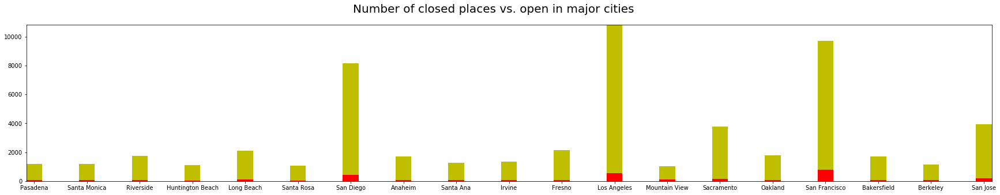

In [16]:
# fig, ax = plt.subplot(1,figsize=(10, 15))
fig, ax = plt.subplots(1, figsize=(30, 5))
w = 0.3
fig.suptitle('Number of closed places vs. open in major cities', fontsize=20)
ax.bar(CityNames, Numbers, width=w, color='y', align='center')
ax.bar(CityNames, Closed, width=w, color='r', align='center')
ax.autoscale(tight=True)

plt.show()

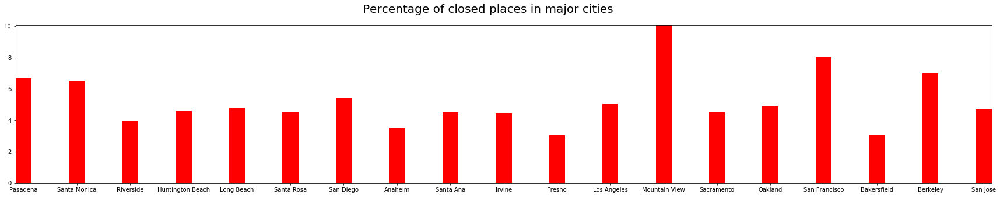

In [17]:
fig, ax = plt.subplots(1, figsize=(30, 5))
w = 0.3
fig.suptitle('Percentage of closed places in major cities', fontsize=20)
ax.bar(CityNames, Percentage, width=w, color='r', align='center')
ax.autoscale(tight=True)
plt.show()

In [18]:
count = 0
minorCities = defaultdict()
for d in placePerCity:
    if  450 < len(placePerCity[d]) < 550:
        minorCities[d] = defaultdict(dict)
        minorCities[d]['Number'] = len(placePerCity[d])
        minorCities[d]['Closed'] = 0
        for p in placePerCity[d]:
            count += 1
            if data_places_dict[p]['closed'] == True:
                minorCities[d]['Closed'] += 1
                
CityNames = [d for d in minorCities]
Numbers = [minorCities[d]['Number'] for d in minorCities]
Closed = [minorCities[d]['Closed'] for d in minorCities]
Percentage = [d/f * 100 for d,f in zip(Closed,Numbers)]

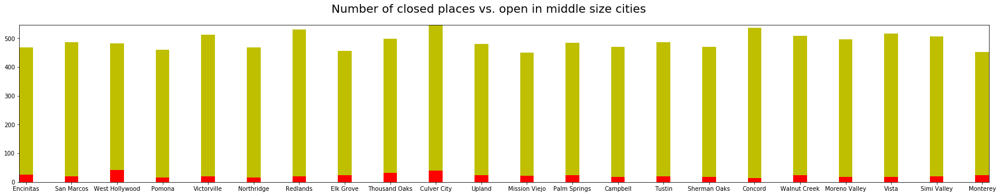

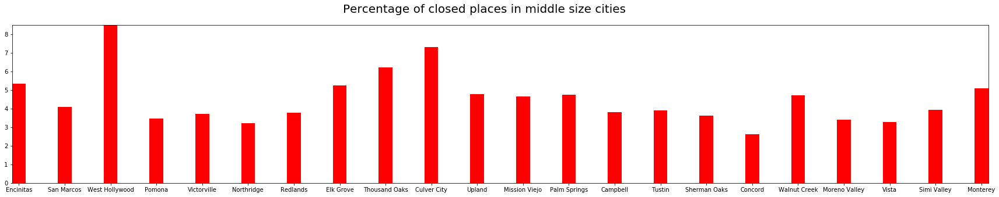

In [19]:
# fig, ax = plt.subplot(1,figsize=(10, 15))
fig, ax = plt.subplots(1, figsize=(30, 5))
w = 0.3
fig.suptitle('Number of closed places vs. open in middle size cities', fontsize=20)
ax.bar(CityNames, Numbers, width=w, color='y', align='center')
ax.bar(CityNames, Closed, width=w, color='r', align='center')
ax.autoscale(tight=True)

plt.show()
fig1, ax1 = plt.subplots(1, figsize=(30, 5))
w = 0.3
fig1.suptitle('Percentage of closed places in middle size cities', fontsize=20)
ax1.bar(CityNames, Percentage, width=w, color='r', align='center')
ax1.autoscale(tight=True)
plt.show()

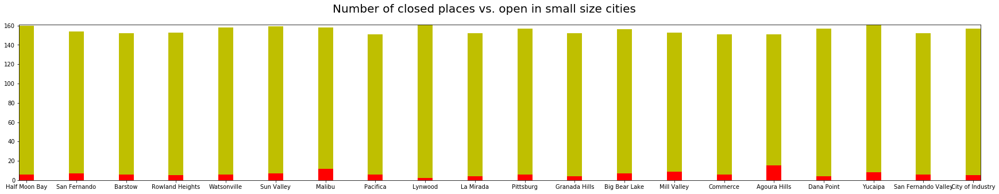

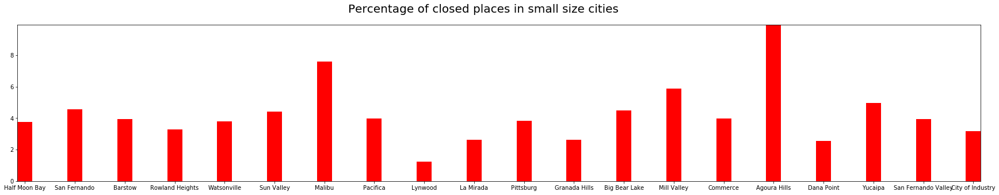

In [20]:
count = 0
smallcities = defaultdict()
for d in placePerCity:
    if  150 < len(placePerCity[d]) < 162:
        smallcities[d] = defaultdict(dict)
        smallcities[d]['Number'] = len(placePerCity[d])
        smallcities[d]['Closed'] = 0
        for p in placePerCity[d]:
            count += 1
            if data_places_dict[p]['closed'] == True:
                smallcities[d]['Closed'] += 1
# len(smallcities)
CityNames = [d for d in smallcities]
Numbers = [smallcities[d]['Number'] for d in smallcities]
Closed = [smallcities[d]['Closed'] for d in smallcities]
Percentage = [d/f * 100 for d,f in zip(Closed,Numbers)]

fig, ax = plt.subplots(1, figsize=(30, 5))
w = 0.3
fig.suptitle('Number of closed places vs. open in small size cities', fontsize=20)
ax.bar(CityNames, Numbers, width=w, color='y', align='center')
ax.bar(CityNames, Closed, width=w, color='r', align='center')
ax.autoscale(tight=True)

plt.show()
fig1, ax1 = plt.subplots(1, figsize=(30, 5))
w = 0.3
fig1.suptitle('Percentage of closed places in small size cities', fontsize=20)
ax1.bar(CityNames, Percentage, width=w, color='r', align='center')
ax1.autoscale(tight=True)
plt.show()

## Find cities with highest closed rate

In [21]:
count = 0
closedRate = defaultdict(float)
for d in placePerCity:
    if len(placePerCity[d]) > 1000:
        num = len(placePerCity[d])
        close = 0
        for p in placePerCity[d]:
            if data_places_dict[p]['closed'] == True:
                close += 1
        closedRate[d] = close/num

In [22]:
closedRate = sorted(closedRate.items(), key=operator.itemgetter(1),reverse=True)

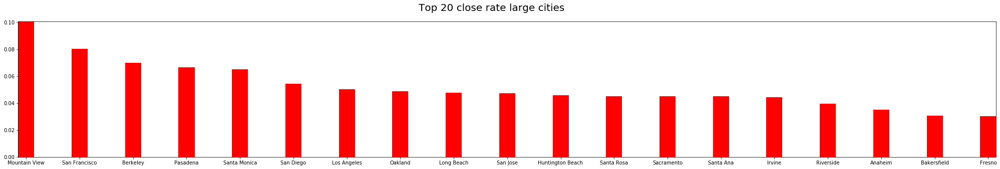

In [23]:
# len(smallcities)
CityNames = [d[0] for d in closedRate[:20]]
close_rate = [d[1] for d in closedRate[:20]]

fig, ax = plt.subplots(1, figsize=(35, 5))
w = 0.3
fig.suptitle('Top 20 close rate large cities', fontsize=20)
ax.bar(CityNames, close_rate, width=w, color='r', align='center')
ax.autoscale(tight=True)

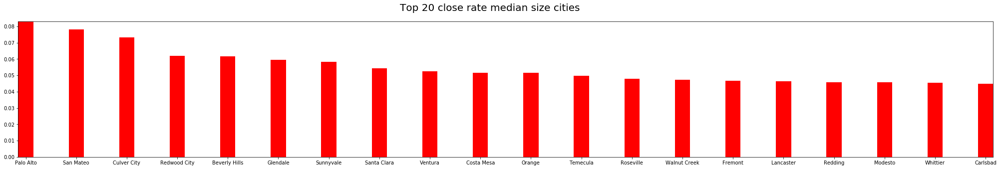

In [24]:
count = 0
closedRate = defaultdict(float)
for d in placePerCity:
    if 500 < len(placePerCity[d]) < 1000:
        num = len(placePerCity[d])
        close = 0
        for p in placePerCity[d]:
            if data_places_dict[p]['closed'] == True:
                close += 1
        closedRate[d] = close/num
closedRate = sorted(closedRate.items(), key=operator.itemgetter(1),reverse=True)
# len(smallcities)
CityNames = [d[0] for d in closedRate[:20]]
close_rate = [d[1] for d in closedRate[:20]]

fig, ax = plt.subplots(1, figsize=(35, 5))
w = 0.3
fig.suptitle('Top 20 close rate median size cities', fontsize=20)
ax.bar(CityNames, close_rate, width=w, color='r', align='center')
ax.autoscale(tight=True)

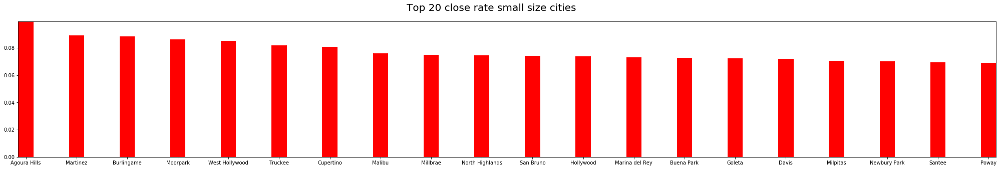

In [25]:
count = 0
closedRate = defaultdict(float)
for d in placePerCity:
    if 100 < len(placePerCity[d]) < 500:
        num = len(placePerCity[d])
        close = 0
        for p in placePerCity[d]:
            if data_places_dict[p]['closed'] == True:
                close += 1
        closedRate[d] = close/num
closedRate = sorted(closedRate.items(), key=operator.itemgetter(1),reverse=True)
# len(smallcities)
CityNames = [d[0] for d in closedRate[:20]]
close_rate = [d[1] for d in closedRate[:20]]

fig, ax = plt.subplots(1, figsize=(35, 5))
w = 0.3
fig.suptitle('Top 20 close rate small size cities', fontsize=20)
ax.bar(CityNames, close_rate, width=w, color='r', align='center')
ax.autoscale(tight=True)

## EDA: Prices, closed vs. opening

In [26]:
closed_places = []
opening_places = []
for d in data_places:
    if d['closed'] == True:
        closed_places.append(d)
    else: opening_places.append(d)

In [27]:
price_closed = {0:0,1:0,2:0,3:0}
price_open = {0:0,1:0,2:0,3:0}

In [28]:
for d in closed_places:
    p = d['price']
    if p == None:     price_closed[0] += 1
    elif p == '$':    price_closed[1] += 1
    elif p == '$$':   price_closed[2] += 1
    elif p == '$$$':  price_closed[3] += 1

for d in opening_places:
    p = d['price']
    if p == None:     price_open[0] += 1
    elif p == '$':    price_open[1] += 1
    elif p == '$$':   price_open[2] += 1
    elif p == '$$$':  price_open[3] += 1

In [29]:
price_closed

{0: 5171, 1: 160, 2: 1269, 3: 1219}

In [30]:
for p in price_closed:
    price_closed[p] = price_closed[p]/len(closed_places)
price_closed

{0: 0.6609151329243353,
 1: 0.02044989775051125,
 2: 0.16219325153374234,
 3: 0.15580265848670757}

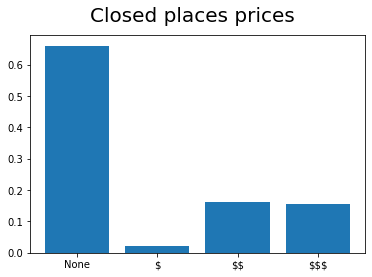

In [31]:
lists = sorted(price_closed.items()) # sorted by key, return a list of tuples
fig = plt.figure()
x, y = zip(*lists) # unpack a list of pairs into two tuples
plt.bar(x, y)
labels = ["None","\$","\$\$","\$\$\$"]
fig.suptitle('Closed places prices', fontsize=20)
plt.xticks(x, labels)
plt.show()

In [32]:
for p in price_open:
    price_open[p] = price_open[p]/len(opening_places)
price_open

{0: 0.7261245263671264,
 1: 0.011648555028949441,
 2: 0.14045793889979616,
 3: 0.12060599997498968}

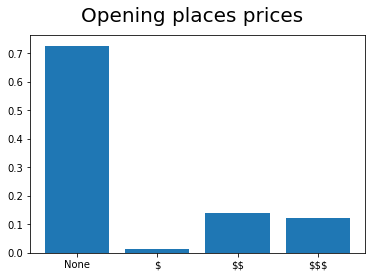

In [33]:
lists = sorted(price_open.items()) # sorted by key, return a list of tuples
fig = plt.figure()
x, y = zip(*lists) # unpack a list of pairs into two tuples
plt.bar(x, y)
labels = ["None","$","\$\$","$$$"]
fig.suptitle('Opening places prices', fontsize=20)
plt.xticks(x, labels)
plt.show()

## Baseline Model: Use average rating to predict if closed

In [118]:
avg_ratings_open = 0
avg_ratings_close = 0

num_open = 0
num_close = 0

for p in jdt(data_reviews):
    rating = p['rating'];
    pid = p['gPlusPlaceId']
    if (pid in data_places_dict):
        p_info = data_places_dict[p['gPlusPlaceId']]
        open_or_close = p_info['closed']
        if (open_or_close == False):
            avg_ratings_open += rating
            num_open += 1
        else:
            avg_ratings_close += rating
            num_close += 1
    else:
        continue
        
avg_ratings_open /= num_open
avg_ratings_close /=  num_close

<BarContainer object of 2 artists>

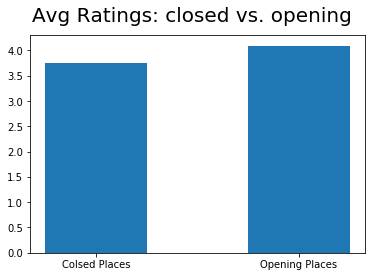

In [119]:
labels = ['Colsed Places','Opening Places']
avg_rating = [avg_ratings_close,avg_ratings_open]
fig = plt.figure()
fig.suptitle('Avg Ratings: closed vs. opening', fontsize=20)
plt.bar(labels,avg_rating,width=0.5)

In [120]:
avg_ratings_open

4.08975990304216

In [121]:
avg_ratings_close

3.754328181741407

In [163]:
reviewPerPlace = defaultdict(list)
for d in data_reviews:
    reviewPerPlace[d['gPlusPlaceId']].append(d)

In [164]:
avg_Ratings = defaultdict(int)
for d in data_reviews:
    avg_Ratings[d['gPlusPlaceId']] += d['rating']
for d in avg_Ratings:
    avg_Ratings[d] /= len(reviewPerPlace[d])

In [165]:
len_train = int(0.8 * len(data_places))
len_vali = len_train + int(0.1 * len(data_places))
data_Train = data_places[:len_train]
data_vali = data_places[len_train:len_vali]
data_test = data_places[len_vali:]
def feat(datum):
    feat = [1]
    feat.append(avg_Ratings[datum['gPlusPlaceId']])
#     hours = getTime(datum['hours'])
#     total = getTotalTime(hours)
#     feat.append(total)
    return feat
X_train = [feat(d) for d in data_Train]
y_train = [d['closed'] for d in data_Train]
X_vali = [feat(d) for d in data_vali]
y_vali = [d['closed'] for d in data_vali]

In [141]:
int(0.8 * len(data_places))

134206

In [142]:
int(0.1 * len(data_places))

16775

In [145]:
len(data_vali)

16775

In [166]:
########## Magic! Do not touch!#############
# scaler = StandardScaler()                #
# X_train = scaler.fit_transform(X_train)  #
############################################
model = LogisticRegression(solver='lbfgs', class_weight= "balanced")
model.fit(X_train,y_train)
print('Result on Trian')
pred = model.predict(X_train)
stats(pred,y_train)
a = fbeta_score(y_train, pred, average='weighted', beta=0.5)
print('F: ', a)

print('\nResult on Validation')
pred = model.predict(X_vali)
stats(pred,y_vali)
a = fbeta_score(y_vali, pred, average='weighted', beta=0.5)
print('F: ', a)

Result on Trian
TP:  2853 FP:  41286 TN:  86638 FN:  3429
Precision:  0.0646367158295385
Recall:  0.45415472779369626
pos: 44139
neg: 90067
FPR: 0.3227385009849598
FNR: 0.5458452722063037
Accuarcy: 0.6668181750443348
BER:  0.4342918865956318
F2:  0.07801988645686346
F:  0.8494523584070764

Result on Validation
TP:  377 FP:  5199 TN:  10809 FN:  390
Precision:  0.06761119081779053
Recall:  0.4915254237288136
pos: 5576
neg: 11199
FPR: 0.3247751124437781
FNR: 0.5084745762711864
Accuarcy: 0.6668256333830105
BER:  0.41662484435748226
F2:  0.08170430410472022
F:  0.8519350651637682


## EDA: Service/Open Hours

In [38]:
def readTime(time): # Magic do not touch
    time = time.lower()
    ampm = ''
    start = 0
    end = 0
    if 'closed' in time:
        return (0,0)
    elif time == 'open':
        return 1
    elif 'open 24 hours' in time:
        return (0,24)
    elif time[5] == '-':
        ampm = time[-2:]
        adj = 12 if ampm == 'pm' else 0 #TODO: Add case for 12:00pm
        loc = time.index('-')
        inv = time.rindex('-')
        cons1 = time.index(':')+1
        cons2 = time.rindex(':')+1
        startMin = int(time[cons1:loc])/60
        endMin = int(time[cons2:-3])/60
        start = int(time[:loc-3]) + adj + startMin
        end = int(time[inv+1:-6]) + adj + endMin
        return(start,end)
    else:
        ampmloc = time.index('-')
        ampm = time[ampmloc-2:ampmloc]
        loc = time.index('-')
        adj = 12 if ampm == 'pm' else 0
        cons1 = time.index(':')+1
        startMin = int(time[cons1:loc-3])/60
        start = int(time[:loc-6]) + adj + startMin
        ampm = time[-2:]
        cons2 = time.rindex(':')+1
        endMin = int(time[cons2:-3])/60
        adj = 12 if ampm == 'pm' else 0
        inv = time.rindex('-')+1
        end = int(time[inv:-6]) + adj + endMin
    return (start,end)

def getTimeHelper(hoursPerDay):
    hours = []
    for i in hoursPerDay:
        hours.append(readTime(i[0]))
    return hours

def getTime(hours):
    days = {'Monday':1,'Tuesday':2,'Wednesday':3, 'Thursday':4,'Friday':5,'Saturday':6,'Sunday':7}
    fixed = {1:[],2:[],3:[],4:[],5:[],6:[],7:[]}
    if hours == None:
        return {1:[-1],2:[-1],3:[-1],4:[-1],5:[-1],6:[-1],7:[-1]}
    else:
        for d in hours:
            day = days[d[0]]
            hoursPerDay = d[1]
            try:
                times = getTimeHelper(hoursPerDay)
            except:
                print(hours)
                break
            fixed[day] = times
    return fixed

def getTotalTime(hours):
    total = 0
    for d in hours:
        if hours[d] == [-1]:
            return -1
        elif hours[d] == [0] or hours[d] == [1]: break
        try:
            for t in hours[d]:
                total += t[1] - t[0]
        except: print(hours)
    return total

In [39]:
tests = [d['hours'] for d in opening_places]
res = [(getTime(d)) for d in tests]

In [40]:
t = opening_places[7]['hours']
getTotalTime(getTime(t))

39.0

In [41]:
#Average hours
avg_hours_open = 0
num_open = len(opening_places)
for p in opening_places:
    hours = getTime(p['hours'])
    total = getTotalTime(hours)
    avg_hours_open += total if total != -1 else 0
    if total == -1: num_open -= 1
avg_hours_open /= num_open

avg_hours_close = 0
num_close = len(closed_places)
for p in closed_places:
    hours = getTime(p['hours'])
    total = getTotalTime(hours)
    avg_hours_close += total if total != -1 else 0
    if total == -1: num_close -= 1
avg_hours_close /= num_close

<BarContainer object of 2 artists>

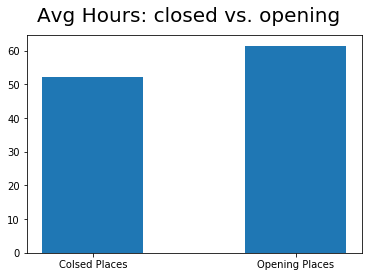

In [42]:
labels = ['Colsed Places','Opening Places']
avg_hours = [avg_hours_close,avg_hours_open]
fig = plt.figure()
fig.suptitle('Avg Hours: closed vs. opening', fontsize=20)
plt.bar(labels,avg_hours,width=0.5)

In [167]:
avg_hours_open

61.422215400751064

In [168]:
avg_hours_close

52.17926958506561

## Logistic regression with hours as only feature

In [43]:
def feat(datum):
    feat = [1]
    hours = getTime(datum['hours'])
    total = getTotalTime(hours)
    feat.append(total)
    return feat

In [44]:
len_train = int(0.8 * len(data_places))
len_vali = len_train + int(0.1 * len(data_places))
data_Train = data_places[:len_train]
data_vali = data_places[len_train:len_vali]
data_test = data_places[len_vali:]
X_train = [feat(d) for d in data_Train]
y_train = [d['closed'] for d in data_Train]
X_vali = [feat(d) for d in data_vali]
y_vali = [d['closed'] for d in data_vali]
model = LogisticRegression(solver='lbfgs', class_weight= "balanced")
model.fit(X_train,y_train)
pred = model.predict(X_vali)
stats(pred,y_vali)

TP:  465 FP:  6825 TN:  9183 FN:  302
Precision:  0.06378600823045268
Recall:  0.60625814863103
pos: 7290
neg: 9485
FPR: 0.42634932533733133
FNR: 0.39374185136897
Accuarcy: 0.5751415797317436
BER:  0.41004558835315064
F2:  0.07768904333879106


### EDA: Number of places for given city

In [45]:
def getPlaceAround(Pid):
    city = getCity(data_places_dict[Pid])
    return len(placePerCity[city])

In [46]:
opening_places[0]

{'name': 'Diamond Valley Lake Marina',
 'price': None,
 'address': ['2615 Angler Ave', 'Hemet, CA 92545'],
 'hours': [['Monday', [['6:30 am--4:15 pm']]],
  ['Tuesday', [['6:30 am--4:15 pm']]],
  ['Wednesday', [['6:30 am--4:15 pm']], 1],
  ['Thursday', [['6:30 am--4:15 pm']]],
  ['Friday', [['6:30 am--4:15 pm']]],
  ['Saturday', [['6:30 am--4:15 pm']]],
  ['Sunday', [['6:30 am--4:15 pm']]]],
 'phone': '(951) 926-7201',
 'closed': False,
 'gPlusPlaceId': '104699454385822125632',
 'gps': [33.703804, -117.003209]}

In [47]:
num_place_around_open = defaultdict()
for p in opening_places:
    Pid = p['gPlusPlaceId']
    num_place_around_open[Pid] = getPlaceAround(Pid)
    
num_place_around_close = defaultdict()
for p in closed_places:
    Pid = p['gPlusPlaceId']
    num_place_around_close[Pid] = getPlaceAround(Pid)

In [48]:
num_place_around = defaultdict()
for p in jdt(data_places):
    pId = p['gPlusPlaceId']
    num_place_around[pId] = getPlaceAround(pId)

In [49]:
avg_around_open = sum([num_place_around_open[n] for n in num_place_around_open])/len(num_place_around_open)
avg_around_close = sum([num_place_around_close[n] for n in num_place_around_close])/len(num_place_around_close)

<BarContainer object of 2 artists>

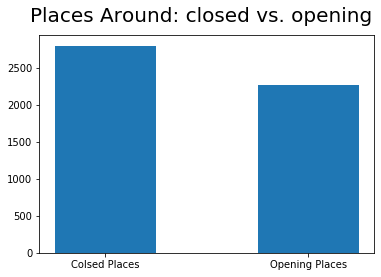

In [50]:
labels = ['Colsed Places','Opening Places']
place_around = [avg_around_close,avg_around_open]
fig = plt.figure()
fig.suptitle('Places Around: closed vs. opening', fontsize=20)
plt.bar(labels,place_around,width=0.5)

In [51]:
def getClosedAround(Pid):
    city = getCity(data_places_dict[Pid])
    num = 0
    for p in placePerCity[city]:
        if placePerCity[city][p]['closed'] == True:
            num += 1
    return num

num_close_around_open = defaultdict()
for p in jdt(opening_places):
    Pid = p['gPlusPlaceId']
    num_close_around_open[Pid] = getClosedAround(Pid)
    
num_close_around_close = defaultdict()
for p in jdt(closed_places):
    Pid = p['gPlusPlaceId']
    num_close_around_close[Pid] = getClosedAround(Pid)

In [52]:
num_close_around = defaultdict()
for p in jdt(data_places):
    pId = p['gPlusPlaceId']
    num_close_around[pId] = getClosedAround(pId)

In [53]:
avg_closed_around_open = sum([num_close_around_open[n] for n in num_close_around_open])/len(num_close_around_open)
avg_closed_around_close = sum([num_close_around_close[n] for n in num_close_around_close])/len(num_close_around_close)

<BarContainer object of 2 artists>

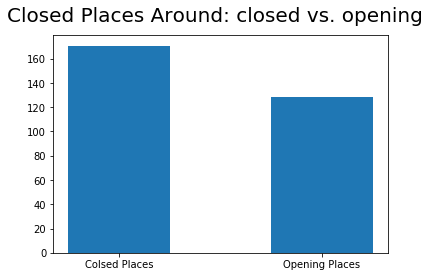

In [54]:
labels = ['Colsed Places','Opening Places']
closed_place_around = [avg_closed_around_close,avg_closed_around_open]
fig = plt.figure()
fig.suptitle('Closed Places Around: closed vs. opening', fontsize=20)
plt.bar(labels,closed_place_around,width=0.5)

In [174]:
avg_closed_around_close

170.62295501022496

In [175]:
avg_closed_around_open

128.53498943314116

## EDA: Number of reviews

In [55]:
avg_reviews_num_open = 0
avg_reviews_num_close = 0
for p in opening_places:
    pId = p['gPlusPlaceId']
    avg_reviews_num_open += len(reviewPerPlace[pId])
for p in closed_places:
    pId = p['gPlusPlaceId']
    avg_reviews_num_close += len(reviewPerPlace[pId])
avg_reviews_num_open /= len(opening_places)
avg_reviews_num_close /= len(closed_places)
    

<BarContainer object of 2 artists>

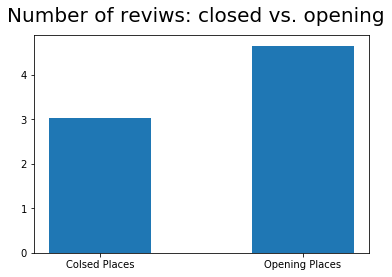

In [56]:
labels = ['Colsed Places','Opening Places']
num_reviews = [avg_reviews_num_close,avg_reviews_num_open]
fig = plt.figure()
fig.suptitle('Number of reviws: closed vs. opening', fontsize=20)
plt.bar(labels,num_reviews,width=0.5)

In [176]:
avg_reviews_num_close

3.026840490797546

In [177]:
avg_reviews_num_open

4.653425788137607

## EDA: Review Time, Time intervals

In [57]:
min = 91394669496
pId = ''
c = True
for d in data_reviews:
    t = int(d['unixReviewTime']) if d['unixReviewTime'] != None else 91394669496
    if t < min: 
        min = t
        pId = d['gPlusPlaceId']
        c = data_places_dict[pId]['closed']
# data_reviews[0]

In [58]:
def getTimeInterval(Pid):
    minTime = 99999999999
    maxTime = 0
    for r in reviewPerPlace[Pid]:
        t =r['unixReviewTime']
        if t != None:
            t = int(t)
            if t > maxTime: maxTime = t
            if t < minTime: minTime = t
    return maxTime - minTime

def getReviewTime(Pid):
    minTime = 99999999999
    maxTime = 0
    for r in reviewPerPlace[Pid]:
        t = r['unixReviewTime']
        if t != None:
            t = int(t)
            if t > maxTime: maxTime = t
            if t < minTime: minTime = t
    return maxTime,minTime

In [59]:
avg_reviews_timeIntv_open = 0
avg_reviews_timeIntv_close = 0
for p in opening_places:
    pId = p['gPlusPlaceId']
    avg_reviews_timeIntv_open += getTimeInterval(pId)
for p in closed_places:
    pId = p['gPlusPlaceId']
    avg_reviews_timeIntv_close += getTimeInterval(pId)
avg_reviews_timeIntv_open /= len(opening_places)
avg_reviews_timeIntv_close /= len(closed_places)

<BarContainer object of 2 artists>

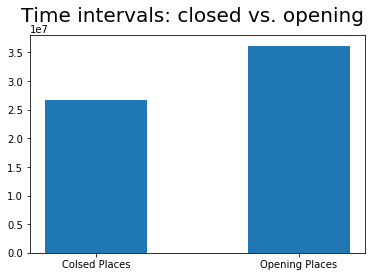

In [60]:
labels = ['Colsed Places','Opening Places']
time_reviews = [avg_reviews_timeIntv_close,avg_reviews_timeIntv_open]
fig = plt.figure()
fig.suptitle('Time intervals: closed vs. opening', fontsize=20)
plt.bar(labels,time_reviews,width=0.5)

In [61]:
avg_minTime_open = 0
avg_maxTime_open = 0
avg_minTime_close = 0
avg_maxTime_close = 0
for p in opening_places:
    pId = p['gPlusPlaceId']
    maxTime,minTime = getReviewTime(pId)
    avg_minTime_open += minTime
    avg_maxTime_open += maxTime
for p in closed_places:
    pId = p['gPlusPlaceId']
    maxTime,minTime = getReviewTime(pId)
    avg_minTime_close += minTime
    avg_maxTime_close += maxTime
    
avg_minTime_open /= len(opening_places)
avg_maxTime_open /= len(opening_places)
avg_minTime_close /= len(closed_places)
avg_maxTime_close /= len(closed_places)

<BarContainer object of 2 artists>

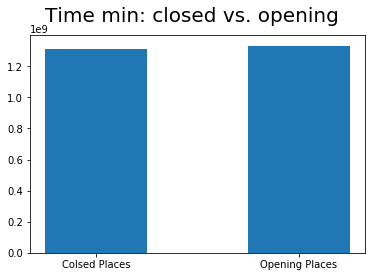

In [62]:
labels = ['Colsed Places','Opening Places']
time_min = [avg_minTime_close,avg_minTime_open]
time_max = [avg_maxTime_close,avg_maxTime_open]

labels = ['Colsed Places','Opening Places']
fig = plt.figure()
fig.suptitle('Time min: closed vs. opening', fontsize=20)
plt.bar(labels,time_min,width=0.5)

<BarContainer object of 2 artists>

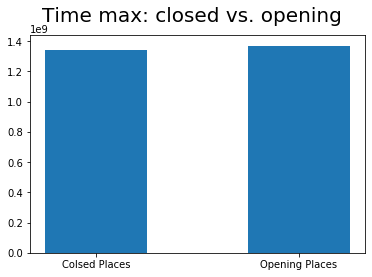

In [63]:
labels = ['Colsed Places','Opening Places']
fig = plt.figure()
fig.suptitle('Time max: closed vs. opening', fontsize=20)
plt.bar(labels,time_max,width=0.5)

In [64]:
min = 91394669496
pId = ''
c = True
for d in data_reviews:
    t = int(d['unixReviewTime']) if d['unixReviewTime'] != None else 91394669496
    if t < min: 
        min = t
        pId = d['gPlusPlaceId']
        c = data_places_dict[pId]['closed']
# data_reviews[0]

## categories

In [65]:
all_category = []
for r in data_reviews:
    if r['categories'] != None:
        for c in r['categories']:
            all_category.append(c)

In [66]:
vectorizer = CountVectorizer(max_features=100)
X = vectorizer.fit(all_category)
print(vectorizer.get_feature_names())

['agency', 'american', 'and', 'animal', 'apartment', 'asian', 'attorney', 'auto', 'bakery', 'bar', 'barbecue', 'beauty', 'breakfast', 'cafe', 'californian', 'car', 'care', 'cell', 'center', 'chicken', 'chinese', 'clinic', 'clothing', 'club', 'cocktail', 'coffee', 'company', 'computer', 'cream', 'dealer', 'deli', 'dental', 'dentist', 'department', 'dessert', 'electronics', 'european', 'facility', 'fast', 'food', 'french', 'grill', 'grocery', 'hair', 'hall', 'hamburger', 'health', 'home', 'hospital', 'hotel', 'house', 'ice', 'indian', 'italian', 'japanese', 'latin', 'lounge', 'medical', 'mediterranean', 'mexican', 'motel', 'movie', 'park', 'parts', 'phone', 'pizza', 'pub', 'public', 'rental', 'repair', 'restaurant', 'salon', 'sandwich', 'school', 'seafood', 'self', 'service', 'services', 'shop', 'shopping', 'south', 'southeast', 'spa', 'sports', 'station', 'steak', 'storage', 'store', 'supermarket', 'supplier', 'supply', 'sushi', 'takeout', 'thai', 'theater', 'tire', 'used', 'venue', 'we

In [67]:
a = vectorizer.transform([' '.join(data_reviews[0]['categories'])]).toarray()[0]
b = vectorizer.transform(['Marina Recreation Fishing Lake']).toarray()[0]

In [68]:
def get_Category(pId):
    acc = [0 for i in range(100)]
    for r in reviewPerPlace[pId]:
        c = r['categories']
        if c == None: c = ['']
        else: c = [' '.join(c)]
        acc += vectorizer.transform(c).toarray()[0]
    acc = acc/len(reviewPerPlace[pId])
    return acc

In [153]:
data_places[3]

{'name': 'Wonderland Smoke Shop and Vape Shop',
 'price': None,
 'address': ['655 S Main St #205', 'Orange, CA 92868'],
 'hours': [['Monday', [['10:00 am--10:00 pm']]],
  ['Tuesday', [['10:00 am--10:00 pm']]],
  ['Wednesday', [['10:00 am--10:00 pm']]],
  ['Thursday', [['10:00 am--10:00 pm']]],
  ['Friday', [['10:00 am--10:00 pm']]],
  ['Saturday', [['10:00 am--9:00 pm']], 1],
  ['Sunday', [['10:00 am--9:00 pm']]]],
 'phone': '(714) 834-9577',
 'closed': False,
 'gPlusPlaceId': '116566210535607411108',
 'gps': [33.777662, -117.866917]}

In [154]:
place_category['105157166151222979897']

array([0., 0., 0., 0., 0., 2., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 3., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [69]:
place_category = defaultdict()
for p in jdt(data_places):
    pId = p['gPlusPlaceId']
    place_category[pId] = get_Category(pId)

## Review Text

In [178]:
all_reviews = []
for r in data_reviews:
    if r['reviewText'] != None:
        all_reviews.append(r['reviewText'])

tfidf_vectorizer = TfidfVectorizer(lowercase=True,max_features=1000)

tfidf_vectorizer.fit(all_reviews)

def get_Review(pId):
    acc = [0 for i in range(1000)]
    for r in reviewPerPlace[pId]:
        c = r['reviewText']
        if c == None: c = ['']
        else: c = [c]
        acc += tfidf_vectorizer.transform(c).toarray()[0]
    acc = acc/len(reviewPerPlace[pId])
    return acc

In [179]:
place_review = defaultdict()
for p in jdt(data_places):
    pId = p['gPlusPlaceId']
    place_review[pId] = get_Review(pId)

In [180]:
concatReviewPerPlace = defaultdict()
for r in jdt(reviewPerPlace):
    review = ''
    for d in reviewPerPlace[r]:
        if d['reviewText'] == None: continue
        review += ' ' + d['reviewText']
    concatReviewPerPlace[r] = review

In [181]:
tfidfAll = TfidfVectorizer(lowercase=True,ngram_range=(1,2))
tfidfAll.fit(all_reviews)

TfidfVectorizer(analyzer='word', binary=False, decode_error='strict',
                dtype=<class 'numpy.float64'>, encoding='utf-8',
                input='content', lowercase=True, max_df=1.0, max_features=None,
                min_df=1, ngram_range=(1, 2), norm='l2', preprocessor=None,
                smooth_idf=True, stop_words=None, strip_accents=None,
                sublinear_tf=False, token_pattern='(?u)\\b\\w\\w+\\b',
                tokenizer=None, use_idf=True, vocabulary=None)

In [182]:
data_Train_Text = [concatReviewPerPlace[d['gPlusPlaceId']] for d in data_Train]
data_vali_Text = [concatReviewPerPlace[d['gPlusPlaceId']] for d in data_vali]

In [183]:
X_train = tfidfAll.transform(data_Train_Text)
X_vali = tfidfAll.transform(data_vali_Text)

In [76]:
model = LogisticRegression(C=0.1,solver='lbfgs', class_weight= "balanced")
model.fit(X_train,y_train)
print('Result on Trian')
pred = model.predict(X_train)
stats(pred,y_train)
print('\nResult on Validation')
pred = model.predict(X_vali)
stats(pred,y_vali)

Result on Trian
TP:  5248 FP:  33345 TN:  94579 FN:  1034
Precision:  0.13598320939030395
Recall:  0.8354027379815345
pos: 38593
neg: 95613
FPR: 0.2606625809074138
FNR: 0.16459726201846545
Accuarcy: 0.743834105777685
BER:  0.21262992146293969
F2:  0.1633323789012412

Result on Validation
TP:  483 FP:  4315 TN:  11693 FN:  284
Precision:  0.10066694456023344
Recall:  0.6297262059973925
pos: 4798
neg: 11977
FPR: 0.2695527236381809
FNR: 0.37027379400260757
Accuarcy: 0.7258420268256334
BER:  0.31991325882039423
F2:  0.1209980459942883


In [184]:
model = LinearSVC(C=10,class_weight='balanced',random_state=0, tol=1e-5)
model.fit(X_train,y_train)
print('Result on Trian')
pred = model.predict(X_train)
stats(pred,y_train)
print('\nResult on Validation')
pred = model.predict(X_vali)
stats(pred,y_vali)
a = fbeta_score(y_vali, pred, average='weighted', beta=0.5)
print('F: ', a)

/Users/zawinglee/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:929: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


Result on Trian
TP:  6273 FP:  15019 TN:  112905 FN:  9
Precision:  0.2946176967875258
Recall:  0.998567335243553
pos: 21292
neg: 112914
FPR: 0.11740564710296739
FNR: 0.0014326647564469914
Accuarcy: 0.8880228901837474
BER:  0.05941915592970726
F2:  0.3429743028977583

Result on Validation
TP:  258 FP:  2241 TN:  13767 FN:  509
Precision:  0.10324129651860744
Recall:  0.3363754889178618
pos: 2499
neg: 14276
FPR: 0.13999250374812594
FNR: 0.6636245110821382
Accuarcy: 0.8360655737704918
BER:  0.4018085074151321
F2:  0.11985505899842054


In [185]:
a = fbeta_score(y_vali, pred, average='weighted', beta=0.5)
print('F: ', a)

F:  0.903932769939943


In [169]:
len_train = int(0.8 * len(data_places))
len_vali = len_train + int(0.1 * len(data_places))
data_Train = data_places[:len_train]
data_vali = data_places[len_train:len_vali]
data_test = data_places[len_vali:]

In [170]:
def feat(datum):
    feat = [1]
    pId = datum['gPlusPlaceId']
    #avergae rating
    feat.append(avg_Ratings[pId])
    #open hours
    hours = getTime(datum['hours'])
    total = getTotalTime(hours)
    feat.append(total)
    #close around
    feat.append(num_close_around[pId])
    #place around
#     feat.append(num_place_around[pId])
    #time interval
#     feat.append(getTimeInterval(pId))
    #number of reviews
    feat.append(len(reviewPerPlace[pId]))
    #categories
    for i in place_category[pId]:
        feat.append(i)
    return feat
X_train = [feat(d) for d in jdt(data_Train)]
y_train = [d['closed'] for d in data_Train]
X_vali = [feat(d) for d in jdt(data_vali)]
y_vali = [d['closed'] for d in data_vali]

In [128]:
########## Magic! Do not touch!#############
# scaler = StandardScaler()                #
# X_train = scaler.fit_transform(X_train)  #
############################################
model = LogisticRegression(C=1,max_iter=500,solver='lbfgs', class_weight= "balanced")
model.fit(X_train,y_train)
print('Result on Trian')
pred = model.predict(X_train)
stats(pred,y_train)
a = fbeta_score(y_train, pred, average='weighted', beta=0.5)
print('F: ', a)

print('\nResult on Validation')
pred = model.predict(X_vali)
stats(pred,y_vali)
a = fbeta_score(y_vali, pred, average='weighted', beta=0.5)
print('F: ', a)

#rating, category, number of review per place 

/Users/zawinglee/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:947: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)


Result on Trian
TP:  4134 FP:  39542 TN:  88382 FN:  2148
Precision:  0.09465152486491436
Recall:  0.6580706781279847
pos: 43676
neg: 90530
FPR: 0.30910540633501143
FNR: 0.3419293218720153
Accuarcy: 0.6893581509023442
BER:  0.3255173641035134
F2:  0.11420772877460134
F:  0.8649111615303271

Result on Validation
TP:  523 FP:  4961 TN:  11047 FN:  244
Precision:  0.09536834427425236
Recall:  0.681877444589309
pos: 5484
neg: 11291
FPR: 0.30990754622688654
FNR: 0.318122555410691
Accuarcy: 0.6897168405365127
BER:  0.3140150508187888
F2:  0.11518301546051182
F:  0.866927070895729


In [173]:
########## Magic! Do not touch!#############
# scaler = StandardScaler()                #
# X_train = scaler.fit_transform(X_train)  #
############################################
clf = LinearSVC(C=10,class_weight='balanced',random_state=0, tol=1e-5)
clf.fit(X_train,y_train)
print('Result on Trian')
pred = model.predict(X_train)
stats(pred,y_train)
a = fbeta_score(y_train, pred, average='weighted', beta=0.5)
print('F: ', a)

print('\nResult on Validation')
pred = clf.predict(X_vali)
stats(pred,y_vali)
a = fbeta_score(y_vali, pred, average='weighted', beta=0.5)
print('F: ', a)

#rating, category, number of review per place 

/Users/zawinglee/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:929: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


Result on Trian
TP:  4015 FP:  38666 TN:  89258 FN:  2267
Precision:  0.09406996087251938
Recall:  0.6391276663482968
pos: 42681
neg: 91525
FPR: 0.3022575904443263
FNR: 0.3608723336517033
Accuarcy: 0.6949987332906129
BER:  0.3315649620480148
F2:  0.11341423454572161
F:  0.8664000754911158

Result on Validation
TP:  41 FP:  198 TN:  15810 FN:  726
Precision:  0.17154811715481172
Recall:  0.05345501955671447
pos: 239
neg: 16536
FPR: 0.012368815592203899
FNR: 0.9465449804432855
Accuarcy: 0.9449180327868852
BER:  0.4794568980177447
F2:  0.11897852582704585
F:  0.9236844141446224


In [ ]:
train_balanced = closed_places[]

In [155]:
def feat(datum):
    feat = [1]
    pId = datum['gPlusPlaceId']
    #avergae rating
    feat.append(avg_Ratings[pId])
    #open hours
    hours = getTime(datum['hours'])
    total = getTotalTime(hours)
#     feat.append(total)
    #close around
#     feat.append(num_close_around[pId])
    #place around
#     feat.append(num_place_around[pId])
    #time interval
#     feat.append(getTimeInterval(pId))
    #number of reviews
#     feat.append(len(reviewPerPlace[pId]))
    #categories
    for i in place_category[pId]:
        feat.append(i)
    #review Text
    for i in place_review[pId]:
        feat.append(i)
    return feat


len_train = int(0.8 * len(data_places))
len_vali = len_train + int(0.1 * len(data_places))
data_Train = data_places[:len_train]
data_vali = data_places[len_train:len_vali]
data_test = data_places[len_vali:]

X_train = [feat(d) for d in jdt(data_Train)]
y_train = [d['closed'] for d in data_Train]
X_vali = [feat(d) for d in jdt(data_vali)]
y_vali = [d['closed'] for d in data_vali]

# sm = SMOTE()
# X_train = [feat(d) for d in jdt(data_Train)]
# y_train = [d['closed'] for d in data_Train]
# X_res, y_res = sm.fit_resample(X_train,y_train)
# X_vali = [feat(d) for d in jdt(data_vali)]
# y_vali = [d['closed'] for d in data_vali]

In [156]:
clf = LinearSVC(C=10,class_weight='balanced',random_state=0, tol=1e-5)
clf.fit(X_train,y_train) 
print('Result on Trian')
pred = clf.predict(X_train)
stats(pred,y_train)
a = fbeta_score(y_train, pred, average='weighted', beta=0.5)
print('F: ', a)

print('\nResult on Validation')
pred = clf.predict(X_vali)
stats(pred,y_vali)
a = fbeta_score(y_vali, pred, average='weighted', beta=0.5)
print('F: ', a)
#rating, category, place_review 

/Users/zawinglee/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:929: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


Result on Trian
TP:  1659 FP:  4658 TN:  123266 FN:  4623
Precision:  0.2626246636061422
Recall:  0.2640878701050621
pos: 6317
neg: 127889
FPR: 0.036412244770332385
FNR: 0.7359121298949379
Accuarcy: 0.9308451186981208
BER:  0.3861621873326351
F2:  0.26291600633914425
F:  0.9309913470019462

Result on Validation
TP:  194 FP:  651 TN:  15357 FN:  573
Precision:  0.22958579881656804
Recall:  0.2529335071707953
pos: 845
neg: 15930
FPR: 0.040667166416791606
FNR: 0.7470664928292047
Accuarcy: 0.9270342771982116
BER:  0.3938668296229981
F2:  0.23390402700747526
F:  0.9297467074367666


In [162]:
clf = LinearSVC(C=0.1,class_weight='balanced',random_state=0, tol=1e-5)
clf.fit(X_train,y_train) 
print('Result on Trian')
pred = clf.predict(X_train)
stats(pred,y_train)
a = fbeta_score(y_train, pred, average='weighted', beta=0.5)
print('F: ', a)

print('\nResult on Validation')
pred = clf.predict(X_vali)
stats(pred,y_vali)
a = fbeta_score(y_vali, pred, average='weighted', beta=0.5)
print('F: ', a)
#rating, category, place_review 

/Users/zawinglee/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:929: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


Result on Trian
TP:  4353 FP:  37893 TN:  90031 FN:  1929
Precision:  0.10303934100269849
Recall:  0.6929321872015282
pos: 42246
neg: 91960
FPR: 0.29621494012069666
FNR: 0.30706781279847184
Accuarcy: 0.7032770516966454
BER:  0.3016413764595842
F2:  0.12418267091164288
F:  0.8713130552027639

Result on Validation
TP:  493 FP:  4776 TN:  11232 FN:  274
Precision:  0.09356614158284304
Recall:  0.6427640156453716
pos: 5269
neg: 11506
FPR: 0.2983508245877061
FNR: 0.35723598435462844
Accuarcy: 0.698956780923994
BER:  0.3277934044711672
F2:  0.11285079888293731
F:  0.8691043906189154


In [161]:
clf = LinearSVC(C=1,class_weight='balanced',random_state=0, tol=1e-5)
clf.fit(X_train,y_train) 
print('Result on Trian')
pred = clf.predict(X_train)
stats(pred,y_train)
a = fbeta_score(y_train, pred, average='weighted', beta=0.5)
print('F: ', a)

print('\nResult on Validation')
pred = clf.predict(X_vali)
stats(pred,y_vali)
a = fbeta_score(y_vali, pred, average='weighted', beta=0.5)
print('F: ', a)
#rating, category, place_review 

/Users/zawinglee/anaconda3/lib/python3.7/site-packages/sklearn/svm/base.py:929: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


Result on Trian
TP:  4256 FP:  35437 TN:  92487 FN:  2026
Precision:  0.10722293603406143
Recall:  0.6774912448264884
pos: 39693
neg: 94513
FPR: 0.27701604077420966
FNR: 0.32250875517351163
Accuarcy: 0.7208545072500484
BER:  0.2997623979738606
F2:  0.12892750251432863
F:  0.8772008411095606

Result on Validation
TP:  481 FP:  4498 TN:  11510 FN:  286
Precision:  0.09660574412532637
Recall:  0.6271186440677966
pos: 4979
neg: 11796
FPR: 0.28098450774612693
FNR: 0.3728813559322034
Accuarcy: 0.7148137108792847
BER:  0.32693293183916516
F2:  0.11627906976744186
F:  0.8743926391210292


In [157]:
# clf = RandomForestClassifier(n_estimators=100, max_depth=2,random_state=0, class_weight='balanced')
# clf.fit(X_train, y_train)  
# print('Result on Trian')
# pred = clf.predict(X_train)
# stats(pred,y_train)
# print('\nResult on Validation')
# pred = clf.predict(X_vali)
# stats(pred,y_vali)

In [160]:
model = LogisticRegression(C=1,solver='lbfgs',class_weight='balanced',n_jobs = -1)
model.fit(X_train,y_train)
print('Result on Trian')
pred = model.predict(X_train)
stats(pred,y_train)
a = fbeta_score(y_train, pred, average='weighted', beta=0.5)
print('F: ', a)

print('\nResult on Validation')
pred = model.predict(X_vali)
stats(pred,y_vali)
a = fbeta_score(y_vali, pred, average='weighted', beta=0.5)
print('F: ', a)

Result on Trian
TP:  4297 FP:  37383 TN:  90541 FN:  1985
Precision:  0.10309500959692898
Recall:  0.6840178287169691
pos: 41680
neg: 92526
FPR: 0.29222819799255806
FNR: 0.31598217128303085
Accuarcy: 0.706659910883269
BER:  0.30410518463779446
F2:  0.12418931573045397
F:  0.8722593882397176

Result on Validation
TP:  494 FP:  4727 TN:  11281 FN:  273
Precision:  0.09461788929323885
Recall:  0.6440677966101694
pos: 5221
neg: 11554
FPR: 0.29528985507246375
FNR: 0.3559322033898305
Accuarcy: 0.7019374068554396
BER:  0.32561102923114715
F2:  0.11408249041614706
F:  0.8702522562910664


In [141]:
from sklearn.ensemble import GradientBoostingClassifier

In [159]:
# clf = GradientBoostingClassifier()
# clf.fit(X_train,y_train)
# print('Result on Trian')
# pred = model.predict(X_train)
# stats(pred,y_train)
# print('\nResult on Validation')
# pred = model.predict(X_vali)
# stats(pred,y_vali)

In [169]:
X_res.shape

(255848, 3633737)

In [170]:
len(X_train)

TypeError: sparse matrix length is ambiguous; use getnnz() or shape[0]